In [1]:
import os

# Change to the parent directory
os.chdir('../..')

# Verify the path using getcwd()
cwd = os.getcwd()
print("Current working directory:", cwd)

Current working directory: c:\Users\onyer\OneDrive\Desktop\Research work\Battery_Analysis1


In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import src.file_loader as fl
import src.sysid_util as sid
import src.data_processing as dp
import src.plotting as plot
import scipy as sp
import control as ct

Columns: Index(['flags', 'Ns', 'time/s', 'control/mA', 'Ewe/V', 'I/mA', 'dQ/C',
       '(Q-Qo)/C', 'half cycle', 'Q charge/discharge/mA.h', 'I Range'],
      dtype='object')
Data: 0     0.000000
1    10.000000
2    19.999999
3    29.999999
4    39.999999
Name: time/s, dtype: float64
Columns: Index(['control/mA', 'Ewe/V'], dtype='object')
Data:            control/mA     Ewe/V
time/s                         
0.000000         0.01  0.407403
10.000000        0.01  0.729420
19.999999        0.01  0.746633
29.999999        0.01  0.757071
39.999999        0.01  0.764113


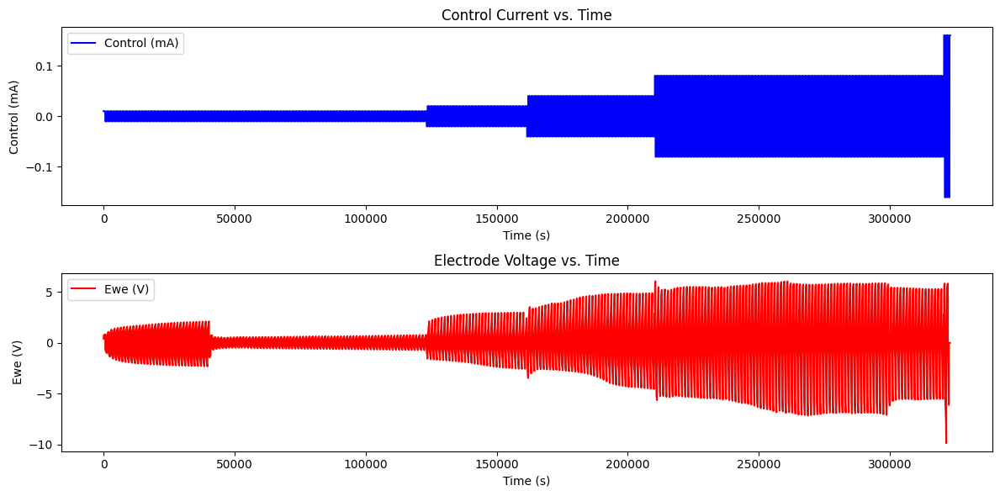

In [3]:
# Load data
mpr_file4 = fl.load_mpr("12to1-25%CNC-3%GQDs _C01.mpr")
df4 = pd.DataFrame(mpr_file4.data)

# Get columns
print("Columns:", df4.columns)
print("Data:", df4['time/s'].head())

df4 = df4.set_index('time/s')[['control/mA', 'Ewe/V']]

print("Columns:", df4.columns)
print("Data:", df4.head())

# Plotting
plt.figure(figsize=(12, 6))

# Plot 'control/mA'
plt.subplot(2, 1, 1)
plt.plot(df4.index, df4['control/mA'], color='blue', label='Control (mA)')
plt.xlabel('Time (s)')
plt.ylabel('Control (mA)')
plt.title('Control Current vs. Time')
plt.legend()

# Plot 'Ewe/V'
plt.subplot(2, 1, 2)
plt.plot(df4.index, df4['Ewe/V'], color='red', label='Ewe (V)')
plt.xlabel('Time (s)')
plt.ylabel('Ewe (V)')
plt.title('Electrode Voltage vs. Time')
plt.legend()

# Adjust layout
plt.tight_layout()
plt.show()


In [4]:
print(df4['control/mA'].unique())

[ 0.01 -0.01  0.   -0.02  0.02 -0.04  0.04  0.08 -0.08  0.16 -0.16]


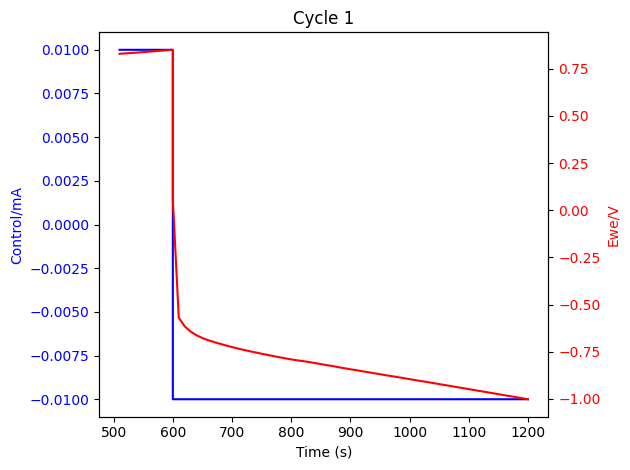

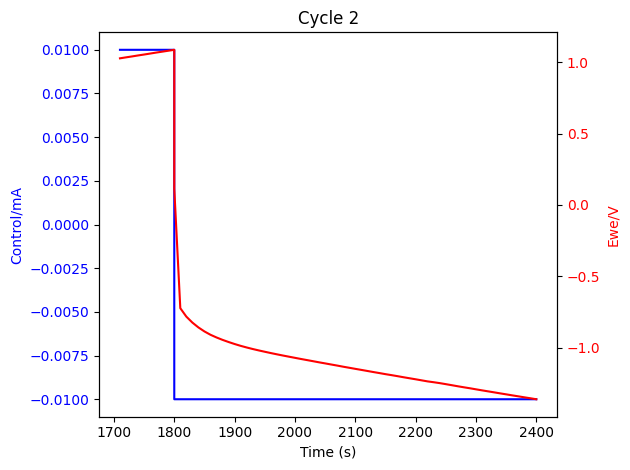

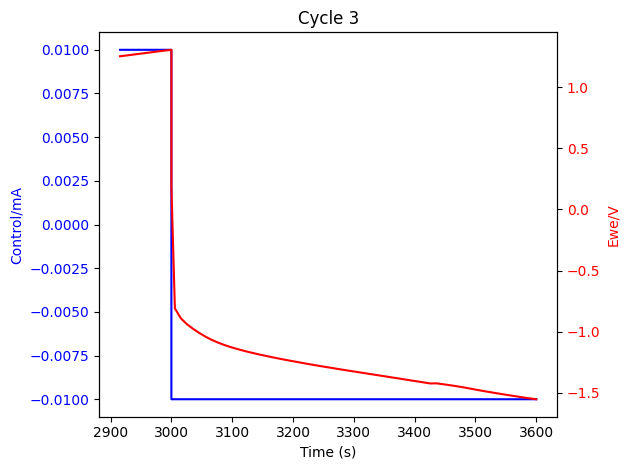

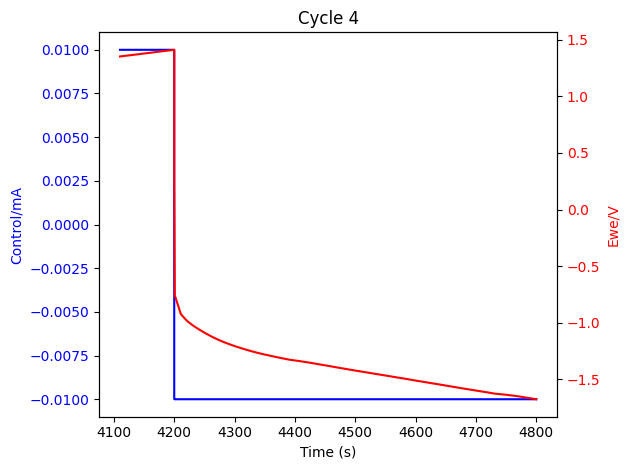

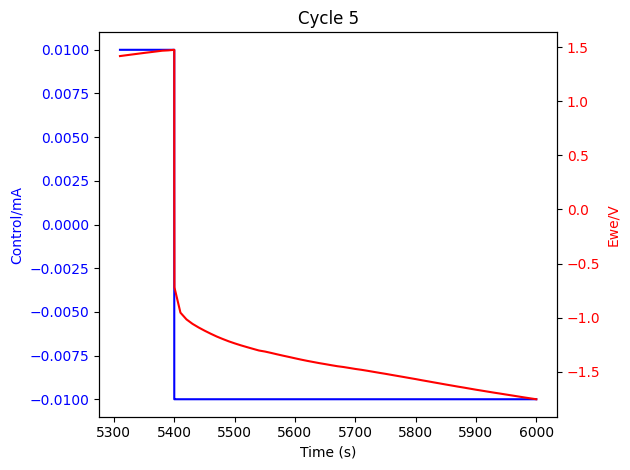

...

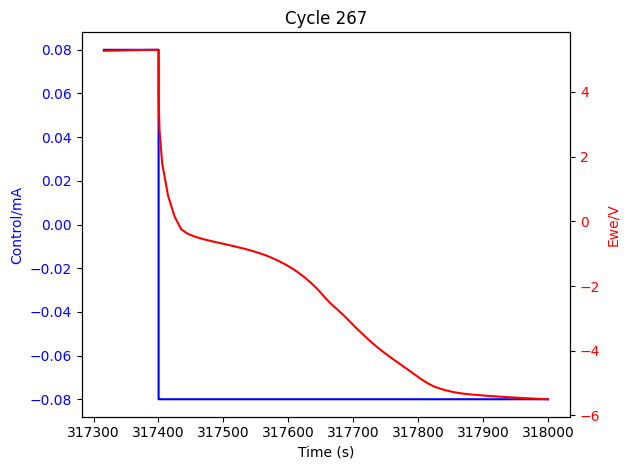

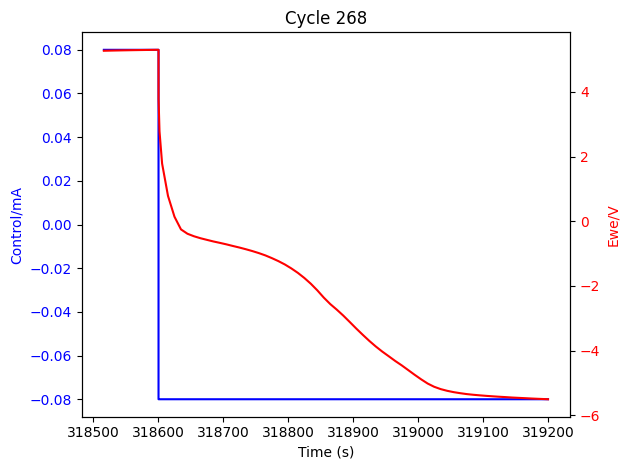

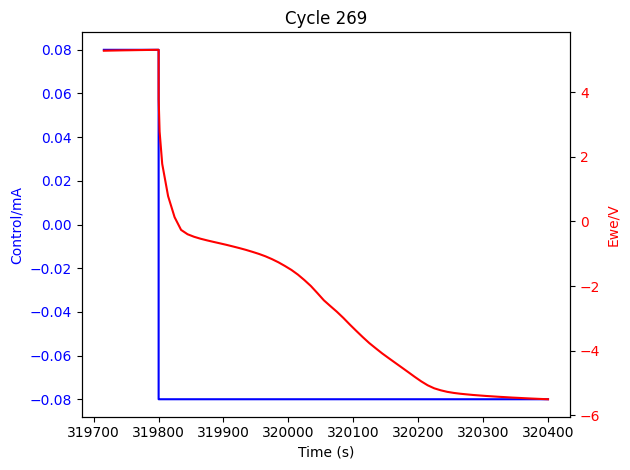

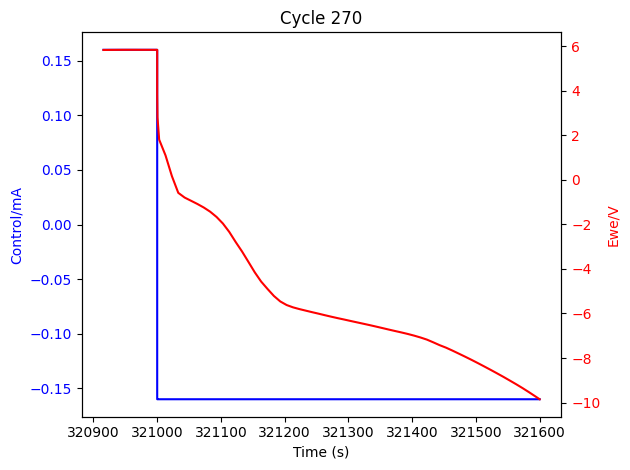

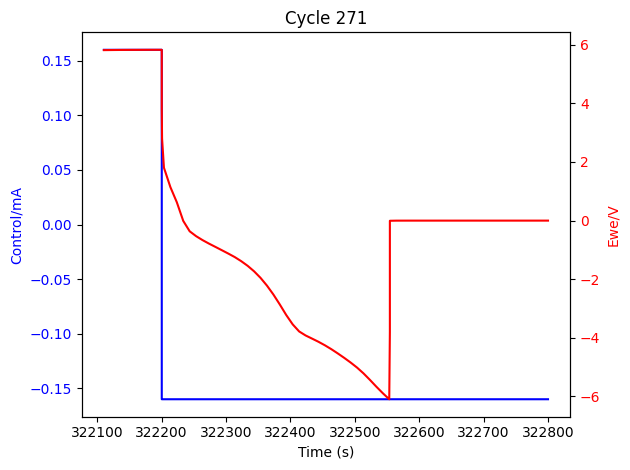

In [5]:
cycles = dp.find_discharging_cycles(df4)

# Plot the cycles
plot.plot_cycles(cycles)


In [6]:
df4.columns

Index(['control/mA', 'Ewe/V'], dtype='object')

In [7]:
# Run the find_charging_cycles function
charging_cycles = dp.find_discharging_cycles(df4)

# Extracting 'Ewe/V' and 'control/mA' for each cycle
yy = [cycle['Ewe/V'].values for cycle in charging_cycles]
uu = [cycle['control/mA'].values for cycle in charging_cycles]

In [8]:
nf = 2
nb = 2
nc = 0
nd = 0
na = nf
nk = 0

# Initialize lists to store results
theta_arx_list = []
theta_bj_list = []
optimization_results_list = []

# Iterate through all arrays in yy and uu
for i in range(1, len(yy)): # Skip the first cycle
    uu[i] = uu[i] - uu[i][0] * np.ones(len(uu[i]))
    yy[i] = yy[i] - yy[i][0] * np.ones(len(yy[i]))

    # Calculate the ARX model parameters
    n_arx = [nf, nb, nk]
    theta_arx = sid.V_arx_lin_reg(n_arx, yy[i], uu[i])
    
    # Store theta_arx in the list
    theta_arx_list.append(theta_arx)
    
    # Prepare initial guess for Box-Jenkins model
    theta_box_jenkins = np.concatenate((
        theta_arx[n_arx[0]:np.sum(n_arx)], 
        np.zeros(nc + nd), 
        theta_arx[0:n_arx[0]]
    ))

    # Define the structure for the Box-Jenkins model
    n_bj = [nb, nc, nd, nf, nk]
    
    # Perform optimization
    optimization_results = sp.optimize.least_squares(
        sid.V_box_jenkins, 
        theta_box_jenkins, 
        jac=sid.jac_V_bj, 
        args=(n_bj, yy[i], uu[i])
    )
    
    # Store the optimization results in the list
    optimization_results_list.append(optimization_results)

In [9]:
print(optimization_results_list)

[     message: `ftol` termination condition is satisfied.
     success: True
      status: 2
         fun: [ 0.000e+00  6.755e-03 ... -3.321e-03 -4.209e-03]
           x: [ 5.414e+01 -5.341e+01 -1.426e+00  4.304e-01]
        cost: 0.041677090365700505
         jac: [[ 0.000e+00  0.000e+00  0.000e+00  0.000e+00]
               [ 0.000e+00  0.000e+00  0.000e+00  0.000e+00]
               ...
               [ 1.659e+00  1.638e+00 -1.762e+02 -1.735e+02]
               [ 1.681e+00  1.659e+00 -1.790e+02 -1.762e+02]]
        grad: [-7.215e-11 -6.950e-11  2.218e-06  4.479e-06]
  optimality: 4.479363992837548e-06
 active_mask: [ 0.000e+00  0.000e+00  0.000e+00  0.000e+00]
        nfev: 12
        njev: 10,      message: `ftol` termination condition is satisfied.
     success: True
      status: 2
         fun: [ 0.000e+00  6.202e-03 ... -9.627e-03 -6.444e-03]
           x: [ 6.348e+01 -6.239e+01 -1.429e+00  4.359e-01]
        cost: 0.05784277051057697
         jac: [[ 0.000e+00  0.000e+00  0.00

In [10]:
# Lists to store x and cost values
x_values = []
cost_values = []

# Iterate through the optimization results
for result in optimization_results_list:
    x_values.append(result.x)
    cost_values.append(result.cost)
    
    # Print x and cost
    print("x:", result.x)
    print("cost:", result.cost)
    print()


x: [ 54.13840693 -53.40704332  -1.42575577   0.43044605]
cost: 0.041677090365700505

x: [ 63.47734233 -62.39111919  -1.42933669   0.43590537]
cost: 0.05784277051057697

x: [ 65.481164   -64.27730344  -1.44709136   0.45387336]
cost: 0.0515130877631496

x: [ 66.88583697 -65.8017741   -1.4585132    0.46407647]
cost: 0.049123374372626816

x: [ 67.89324564 -66.42004513  -1.45835305   0.46617985]
cost: 0.049457758725157425

x: [ 68.20564314 -66.90335649  -1.46912839   0.47560305]
cost: 0.0524158414127804

x: [ 68.79173981 -67.24728806  -1.47300505   0.48085379]
cost: 0.05534285748394867

x: [ 69.24018522 -67.90466674  -1.4810567    0.48739704]
cost: 0.05751836690692784

x: [ 69.63193747 -68.25711898  -1.48574058   0.49217649]
cost: 0.061351041631319235

x: [ 69.73793863 -68.44201331  -1.49637112   0.50228897]
cost: 0.06525457381920906

x: [ 70.12917199 -68.84417832  -1.49712441   0.50291399]
cost: 0.06599898977502128

x: [ 70.50049067 -69.22291515  -1.49760377   0.50321773]
cost: 0.066611654

Outlier detected - Cycle: 270, Cost: 46.90, Z-Score: 12.26


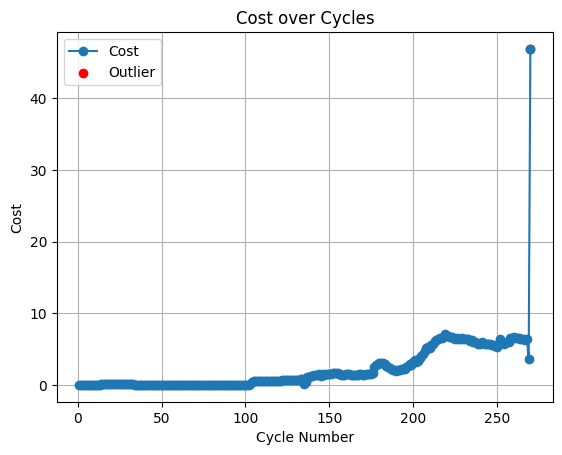

In [11]:
# Calculate mean and standard deviation of the cost values
mean_cost = np.mean(cost_values)
std_cost = np.std(cost_values)

# Calculate Z-scores
z_scores = [(cost - mean_cost) / std_cost for cost in cost_values]

# Threshold for identifying outliers (e.g., Z-score > 2)
threshold = 2
outliers = [(i + 1, cost_values[i], z_scores[i]) for i in range(len(z_scores)) if abs(z_scores[i]) > threshold]

# Print outliers
for cycle, cost, z_score in outliers:
    print(f"Outlier detected - Cycle: {cycle}, Cost: {cost:.2f}, Z-Score: {z_score:.2f}")

# Plot cost over cycles
plt.plot(range(1, len(cost_values) + 1), cost_values, marker='o', label='Cost')

# Highlight outliers
for cycle, cost, _ in outliers:
    plt.scatter(cycle, cost, color='red', label='Outlier' if cycle == outliers[0][0] else "")
    
plt.xlabel('Cycle Number')
plt.ylabel('Cost')
plt.title('Cost over Cycles')
plt.legend()
plt.grid(True)
plt.show()


Cycle 1: G_hat_box_jenkins
<TransferFunction>: sys[209160]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 54.14 z^2 - 53.41 z
----------------------
z^2 - 1.426 z + 0.4304

dt = 0.005

Cycle 1: Zeros
[0.98649085+0.j 0.        +0.j]
Cycle 1: Poles
[0.99171265+0.j 0.43404312+0.j]


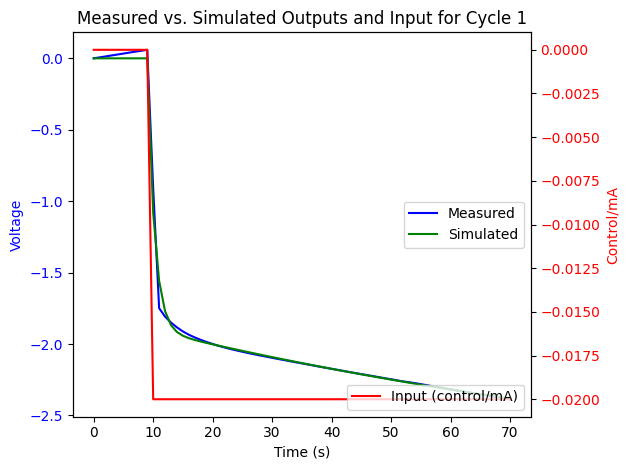

Cycle 2: G_hat_box_jenkins
<TransferFunction>: sys[209164]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 63.48 z^2 - 62.39 z
----------------------
z^2 - 1.429 z + 0.4359

dt = 0.005

Cycle 2: Zeros
[0.98288802+0.j 0.        +0.j]
Cycle 2: Poles
[0.98824735+0.j 0.44108934+0.j]


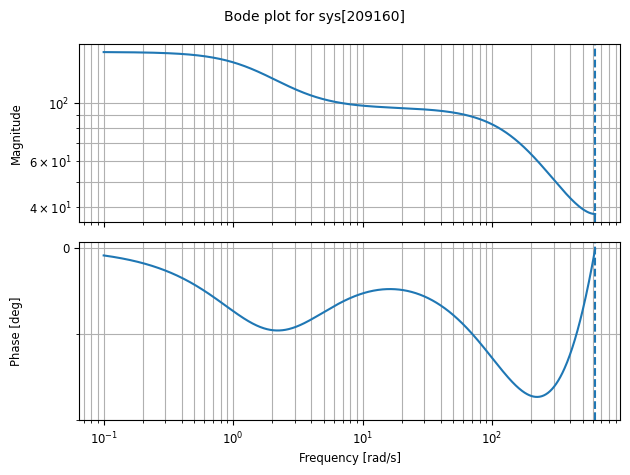

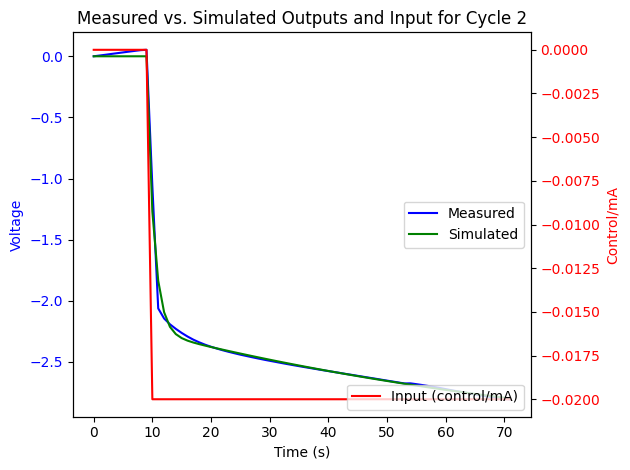

Cycle 3: G_hat_box_jenkins
<TransferFunction>: sys[209168]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 65.48 z^2 - 64.28 z
----------------------
z^2 - 1.447 z + 0.4539

dt = 0.005

Cycle 3: Zeros
[0.98161516+0.j 0.        +0.j]
Cycle 3: Poles
[0.98744904+0.j 0.45964231+0.j]


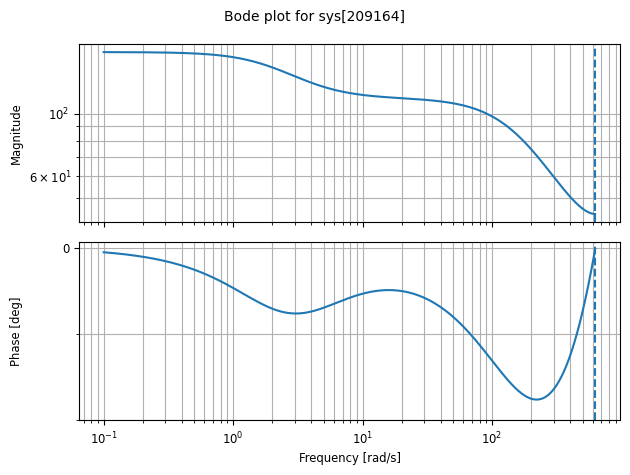

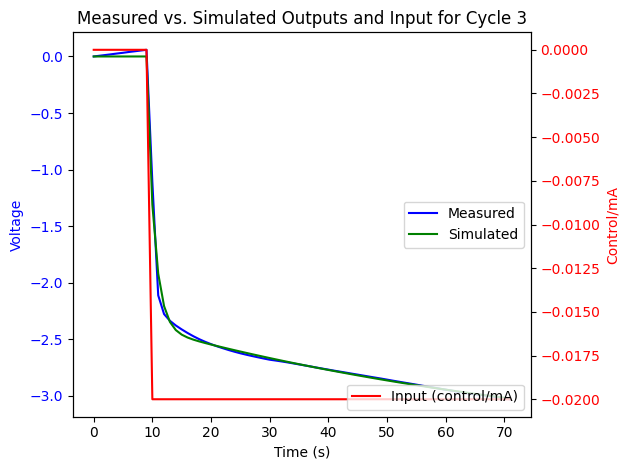

Cycle 4: G_hat_box_jenkins
<TransferFunction>: sys[209172]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  66.89 z^2 - 65.8 z
----------------------
z^2 - 1.459 z + 0.4641

dt = 0.005

Cycle 4: Zeros
[0.98379234+0.j 0.        +0.j]
Cycle 4: Poles
[0.98952323+0.j 0.46898997+0.j]


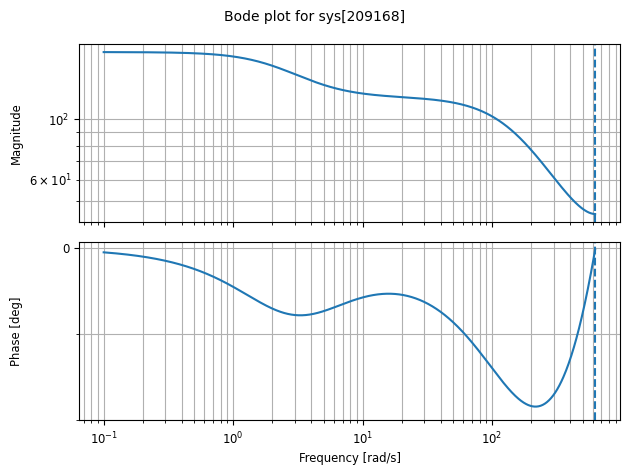

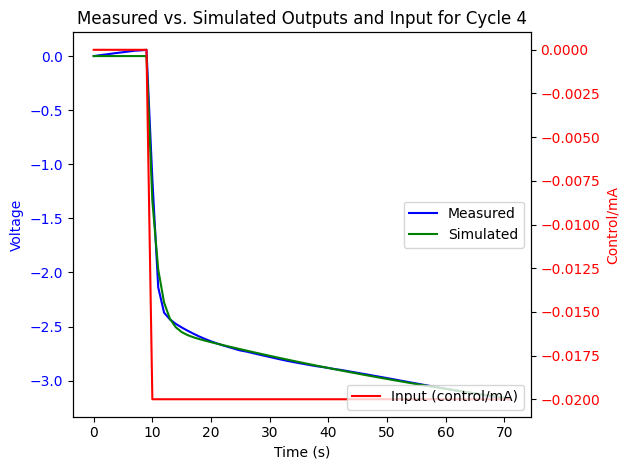

Cycle 5: G_hat_box_jenkins
<TransferFunction>: sys[209176]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 67.89 z^2 - 66.42 z
----------------------
z^2 - 1.458 z + 0.4662

dt = 0.005

Cycle 5: Zeros
[0.97830122+0.j 0.        +0.j]
Cycle 5: Poles
[0.98514246+0.j 0.4732106 +0.j]


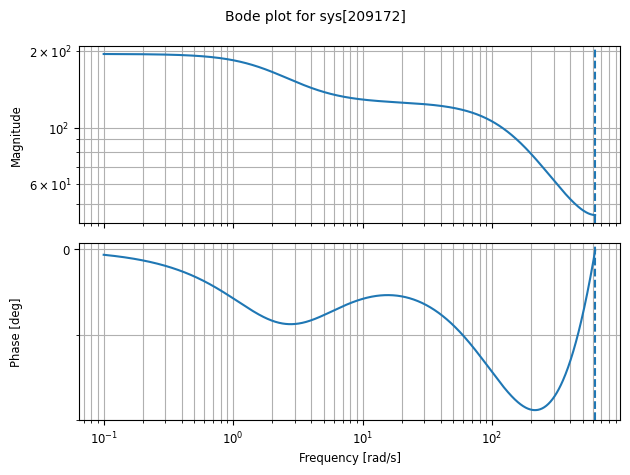

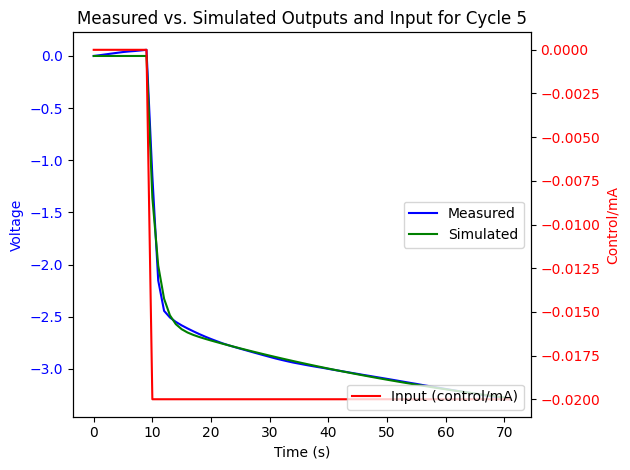

Cycle 6: G_hat_box_jenkins
<TransferFunction>: sys[209180]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  68.21 z^2 - 66.9 z
----------------------
z^2 - 1.469 z + 0.4756

dt = 0.005

Cycle 6: Zeros
[0.98090647+0.j 0.        +0.j]
Cycle 6: Poles
[0.98750986+0.j 0.48161853+0.j]


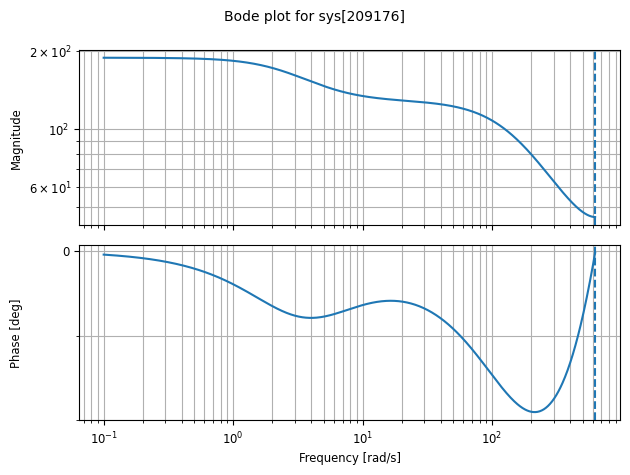

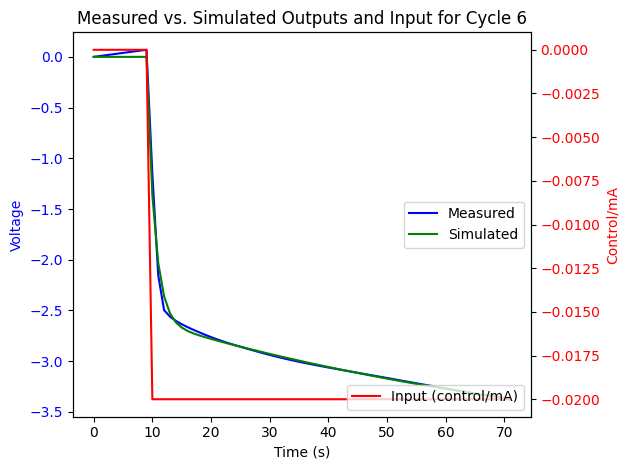

Cycle 7: G_hat_box_jenkins
<TransferFunction>: sys[209184]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 68.79 z^2 - 67.25 z
----------------------
z^2 - 1.473 z + 0.4809

dt = 0.005

Cycle 7: Zeros
[0.97754888+0.j 0.        +0.j]
Cycle 7: Poles
[0.98466009+0.j 0.48834496+0.j]


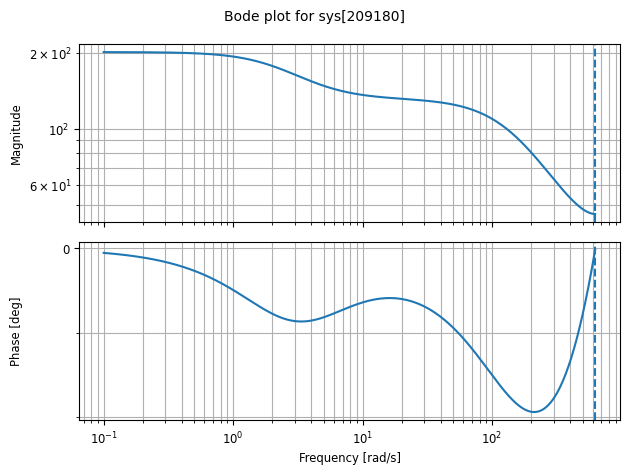

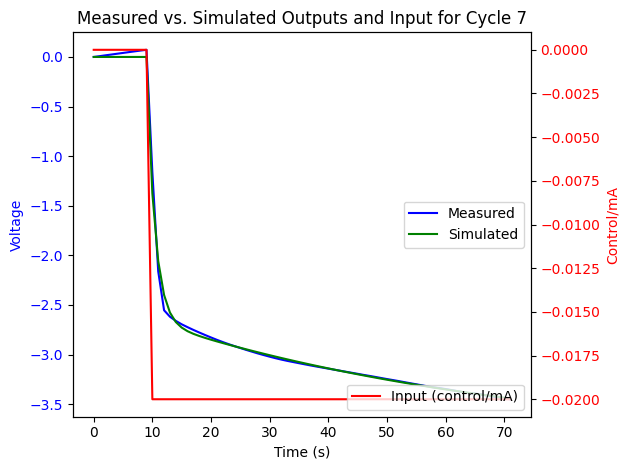

Cycle 8: G_hat_box_jenkins
<TransferFunction>: sys[209188]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  69.24 z^2 - 67.9 z
----------------------
z^2 - 1.481 z + 0.4874

dt = 0.005

Cycle 8: Zeros
[0.9807118+0.j 0.       +0.j]
Cycle 8: Poles
[0.98748016+0.j 0.49357654+0.j]


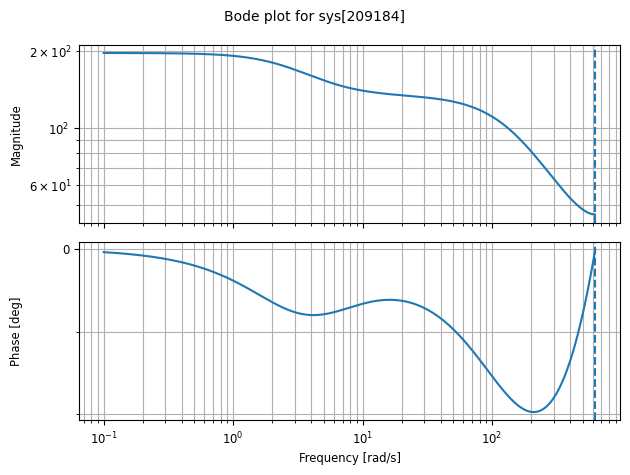

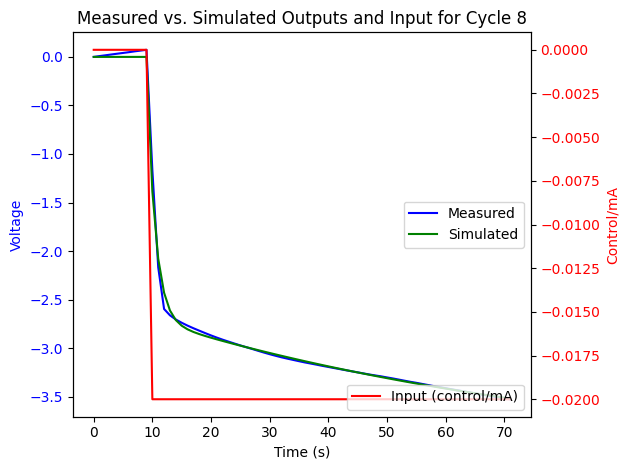

Cycle 9: G_hat_box_jenkins
<TransferFunction>: sys[209192]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 69.63 z^2 - 68.26 z
----------------------
z^2 - 1.486 z + 0.4922

dt = 0.005

Cycle 9: Zeros
[0.98025592+0.j 0.        +0.j]
Cycle 9: Poles
[0.98716475+0.j 0.49857583+0.j]


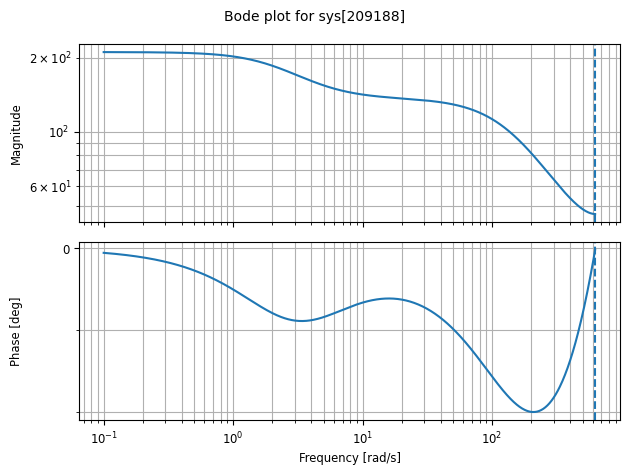

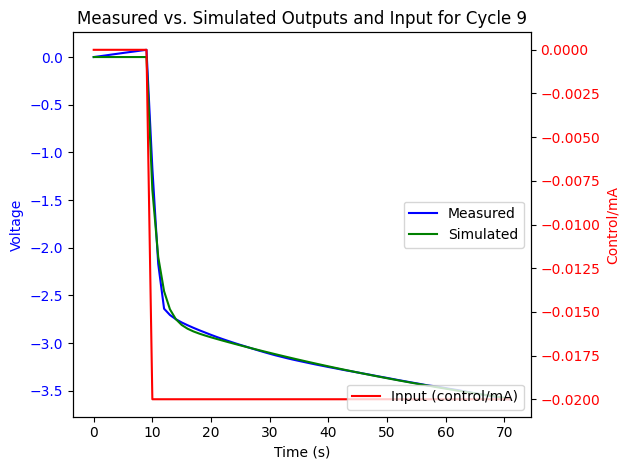

Cycle 10: G_hat_box_jenkins
<TransferFunction>: sys[209196]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 69.74 z^2 - 68.44 z
----------------------
z^2 - 1.496 z + 0.5023

dt = 0.005

Cycle 10: Zeros
[0.98141721+0.j 0.        +0.j]
Cycle 10: Poles
[0.98796184+0.j 0.50840929+0.j]


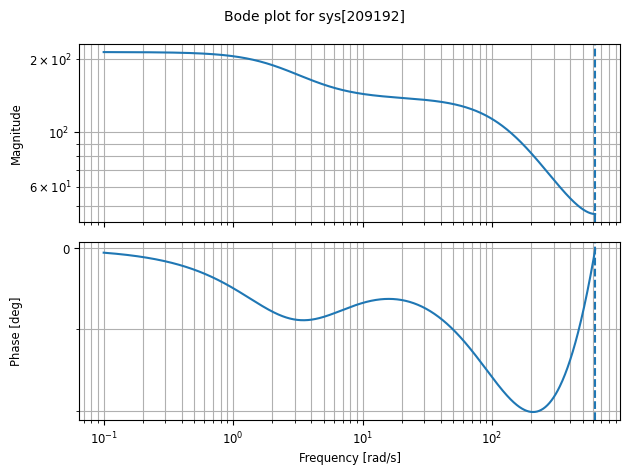

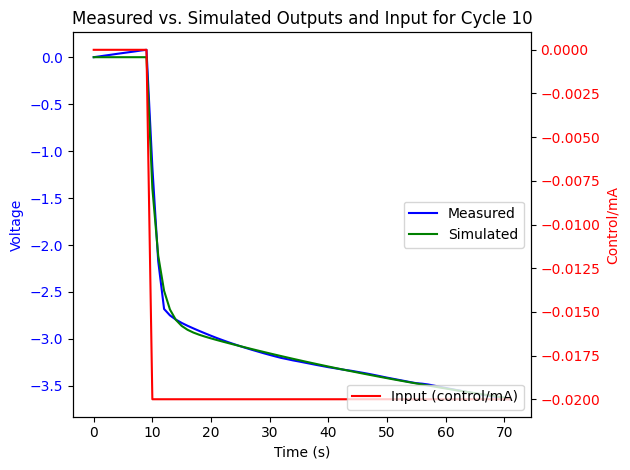

Cycle 11: G_hat_box_jenkins
<TransferFunction>: sys[209200]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 70.13 z^2 - 68.84 z
----------------------
z^2 - 1.497 z + 0.5029

dt = 0.005

Cycle 11: Zeros
[0.98167676+0.j 0.        +0.j]
Cycle 11: Poles
[0.98821067+0.j 0.50891375+0.j]


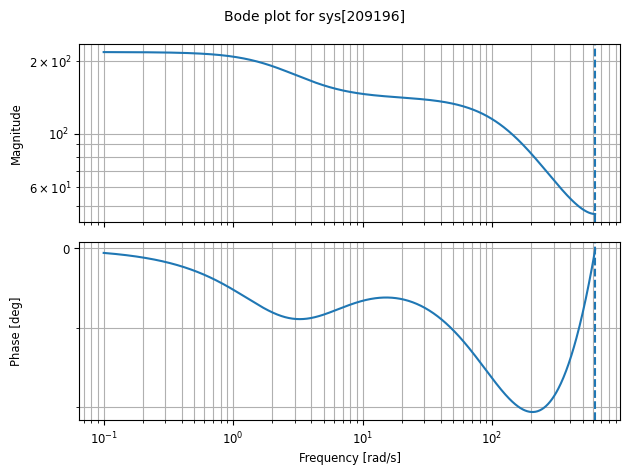

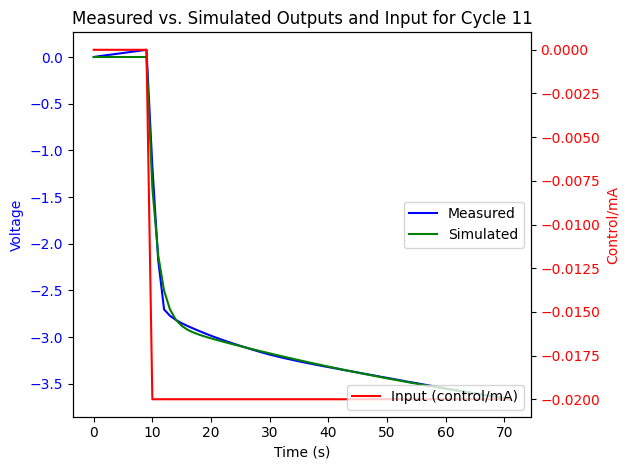

Cycle 12: G_hat_box_jenkins
<TransferFunction>: sys[209204]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  70.5 z^2 - 69.22 z
----------------------
z^2 - 1.498 z + 0.5032

dt = 0.005

Cycle 12: Zeros
[0.98187849+0.j 0.        +0.j]
Cycle 12: Poles
[0.98856538+0.j 0.50903839+0.j]


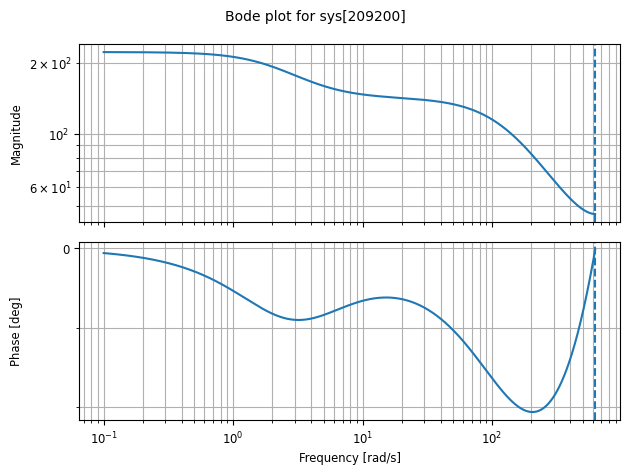

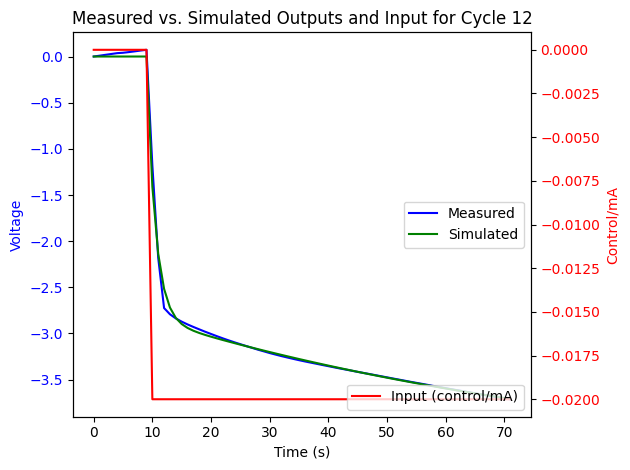

Cycle 13: G_hat_box_jenkins
<TransferFunction>: sys[209208]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 70.76 z^2 - 69.57 z
----------------------
z^2 - 1.503 z + 0.5076

dt = 0.005

Cycle 13: Zeros
[0.98310963+0.j 0.        +0.j]
Cycle 13: Poles
[0.98967446+0.j 0.51292736+0.j]


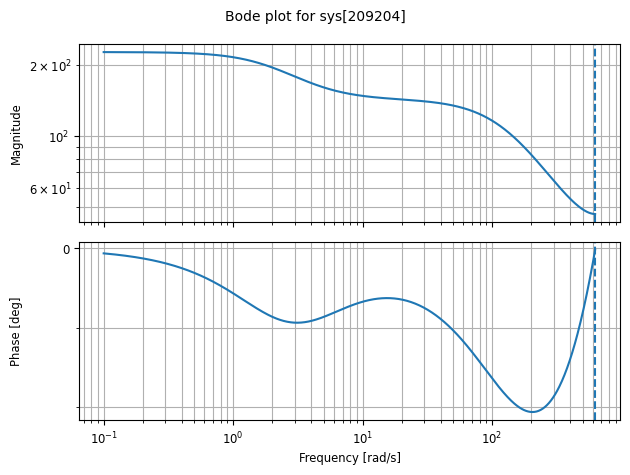

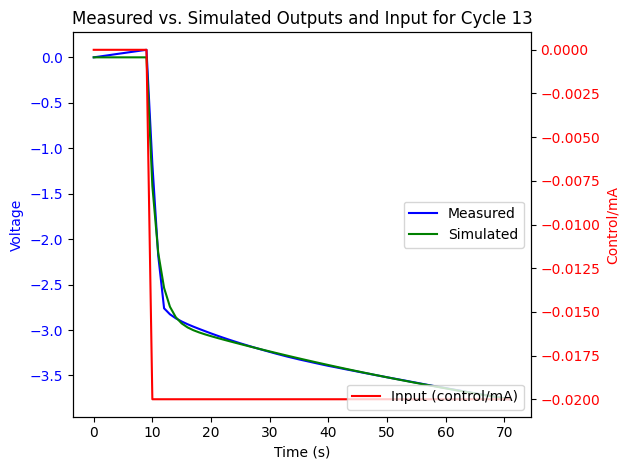

Cycle 14: G_hat_box_jenkins
<TransferFunction>: sys[209212]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 71.07 z^2 - 69.87 z
----------------------
z^2 - 1.507 z + 0.5118

dt = 0.005

Cycle 14: Zeros
[0.98302048+0.j 0.        +0.j]
Cycle 14: Poles
[0.98962769+0.j 0.517173  +0.j]


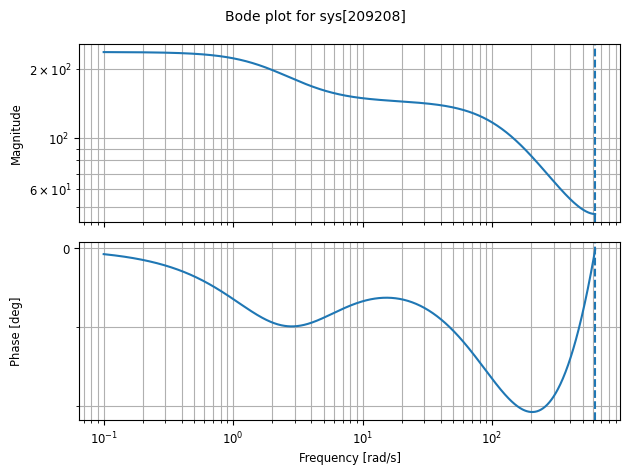

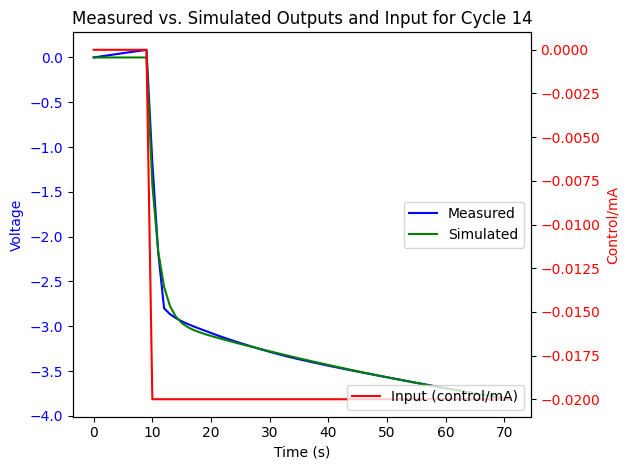

Cycle 15: G_hat_box_jenkins
<TransferFunction>: sys[209216]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 71.52 z^2 - 70.37 z
---------------------
z^2 - 1.51 z + 0.5144

dt = 0.005

Cycle 15: Zeros
[0.98388392+0.j 0.        +0.j]
Cycle 15: Poles
[0.99042666+0.j 0.51939751+0.j]


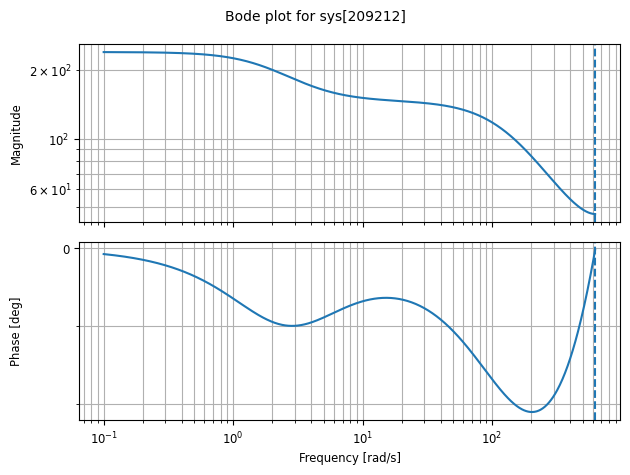

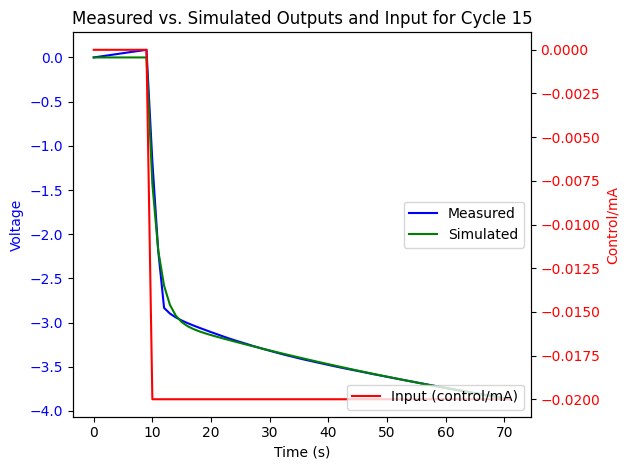

Cycle 16: G_hat_box_jenkins
<TransferFunction>: sys[209220]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  71.8 z^2 - 70.67 z
----------------------
z^2 - 1.513 z + 0.5175

dt = 0.005

Cycle 16: Zeros
[0.98426478+0.j 0.        +0.j]
Cycle 16: Poles
[0.99076058+0.j 0.52231352+0.j]


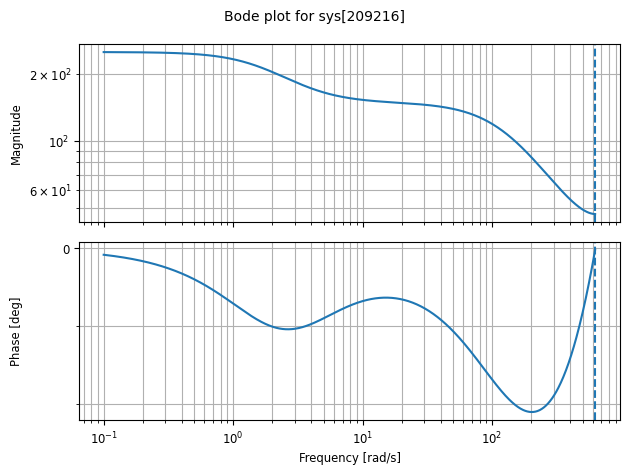

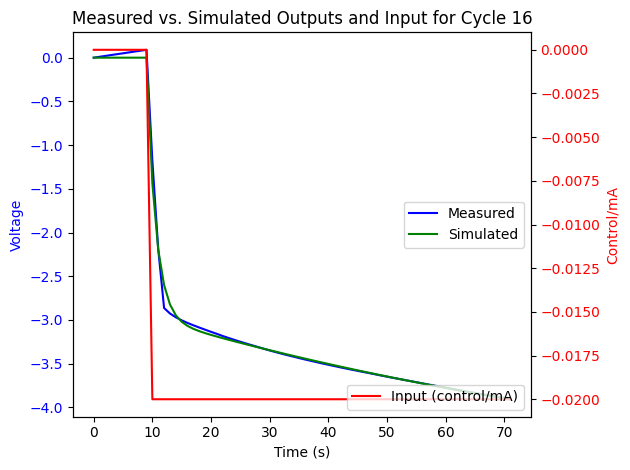

Cycle 17: G_hat_box_jenkins
<TransferFunction>: sys[209224]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 72.05 z^2 - 70.97 z
----------------------
z^2 - 1.517 z + 0.5209

dt = 0.005

Cycle 17: Zeros
[0.98506847+0.j 0.        +0.j]
Cycle 17: Poles
[0.99146458+0.j 0.52539277+0.j]


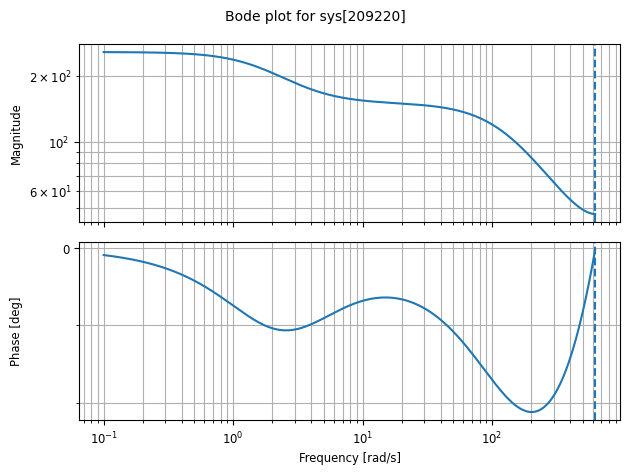

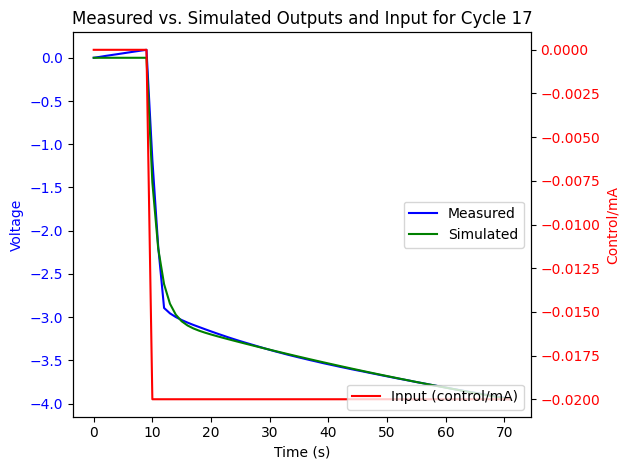

Cycle 18: G_hat_box_jenkins
<TransferFunction>: sys[209228]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  72.37 z^2 - 71.3 z
----------------------
z^2 - 1.519 z + 0.5225

dt = 0.005

Cycle 18: Zeros
[0.98517823+0.j 0.        +0.j]
Cycle 18: Poles
[0.99161206+0.j 0.5268984 +0.j]


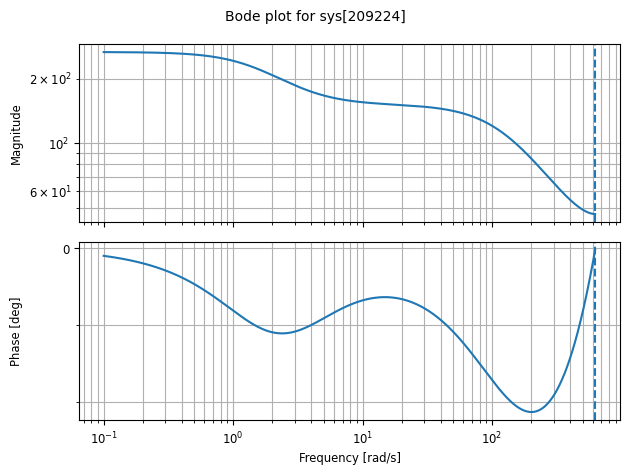

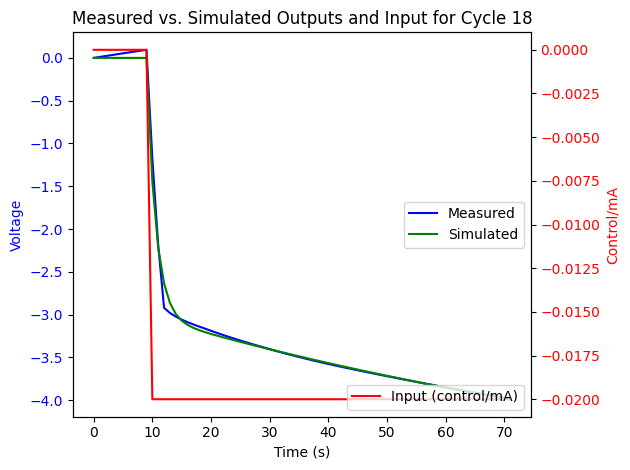

Cycle 19: G_hat_box_jenkins
<TransferFunction>: sys[209232]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 72.52 z^2 - 71.5 z
--------------------
z^2 - 1.52 z + 0.524

dt = 0.005

Cycle 19: Zeros
[0.98592534+0.j 0.        +0.j]
Cycle 19: Poles
[0.99230943+0.j 0.52803375+0.j]


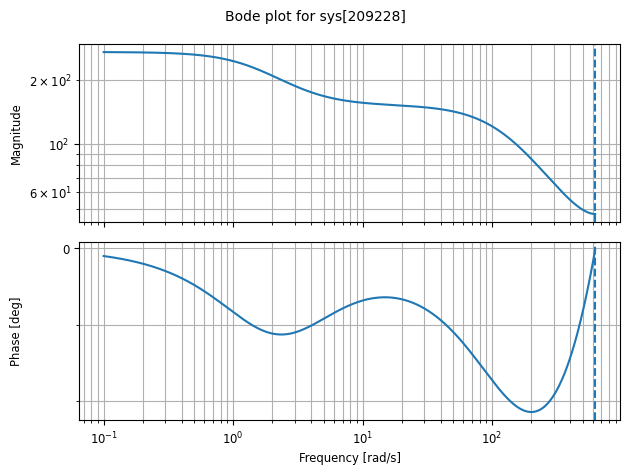

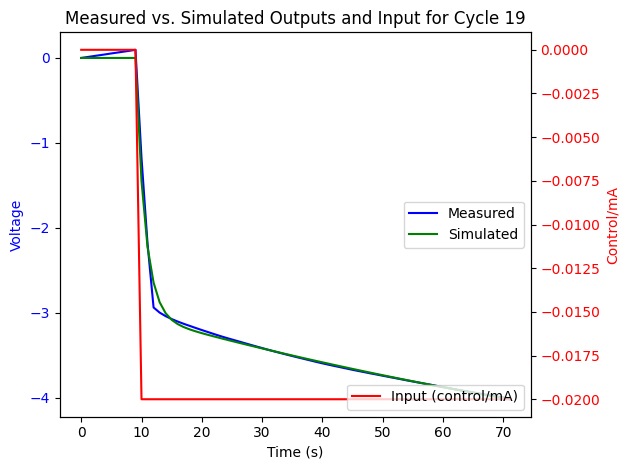

Cycle 20: G_hat_box_jenkins
<TransferFunction>: sys[209236]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 72.69 z^2 - 71.68 z
----------------------
z^2 - 1.523 z + 0.5269

dt = 0.005

Cycle 20: Zeros
[0.98605901+0.j 0.        +0.j]
Cycle 20: Poles
[0.99242582+0.j 0.53088842+0.j]


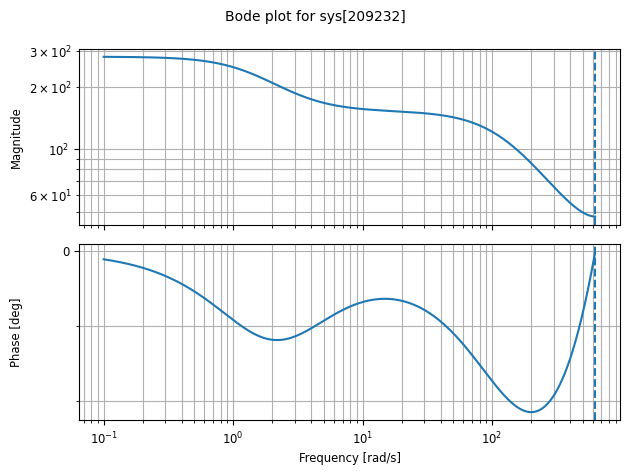

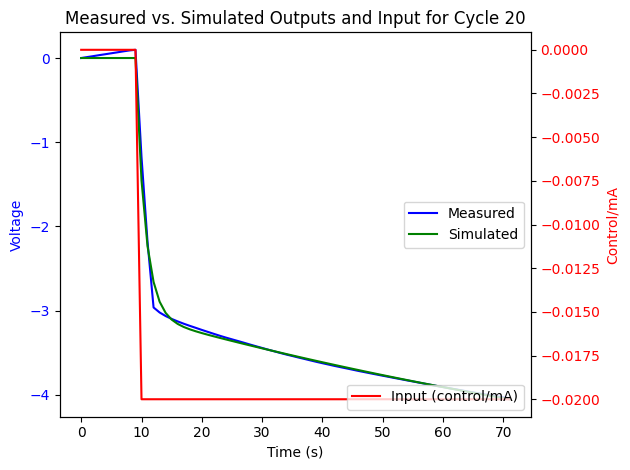

Cycle 21: G_hat_box_jenkins
<TransferFunction>: sys[209240]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 72.95 z^2 - 71.96 z
----------------------
z^2 - 1.525 z + 0.5287

dt = 0.005

Cycle 21: Zeros
[0.98642858+0.j 0.        +0.j]
Cycle 21: Poles
[0.99276273+0.j 0.53258465+0.j]


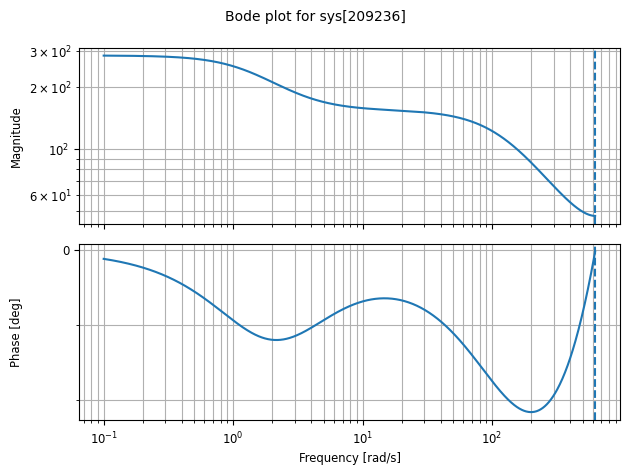

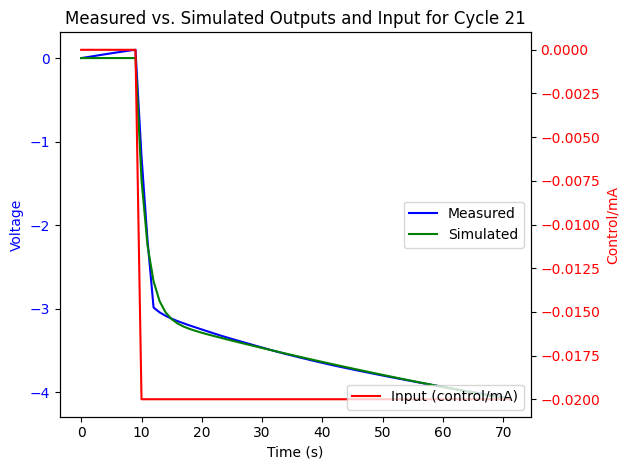

Cycle 22: G_hat_box_jenkins
<TransferFunction>: sys[209244]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


   72.95 z^2 - 72 z
----------------------
z^2 - 1.528 z + 0.5313

dt = 0.005

Cycle 22: Zeros
[0.98689923+0.j 0.        +0.j]
Cycle 22: Poles
[0.9932132 +0.j 0.53496954+0.j]


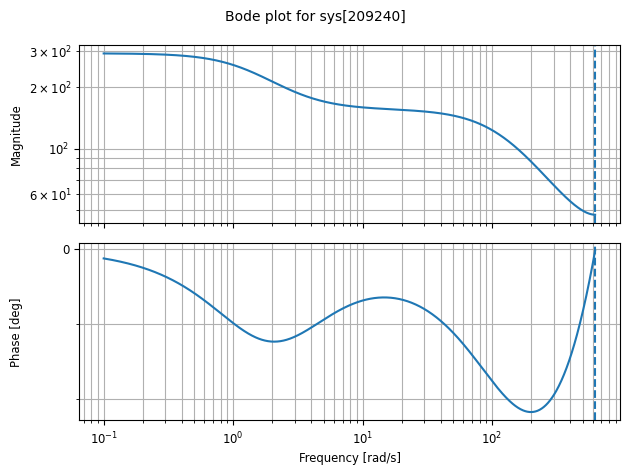

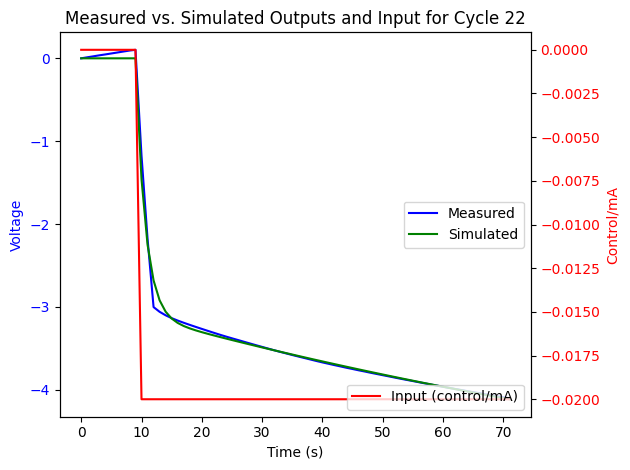

Cycle 23: G_hat_box_jenkins
<TransferFunction>: sys[209248]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 73.3 z^2 - 72.35 z
---------------------
z^2 - 1.528 z + 0.531

dt = 0.005

Cycle 23: Zeros
[0.98695663+0.j 0.        +0.j]
Cycle 23: Poles
[0.99329974+0.j 0.5345666 +0.j]


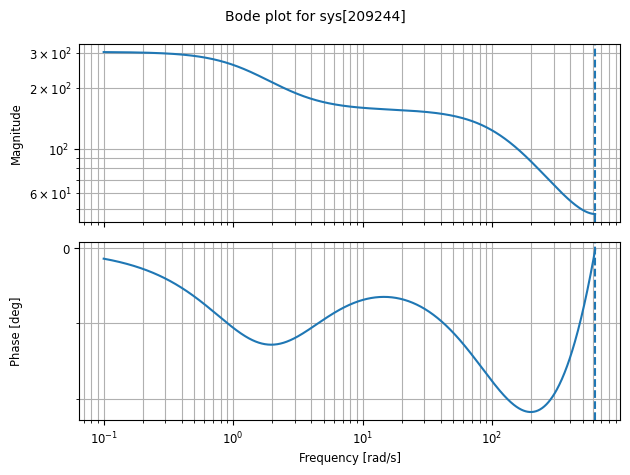

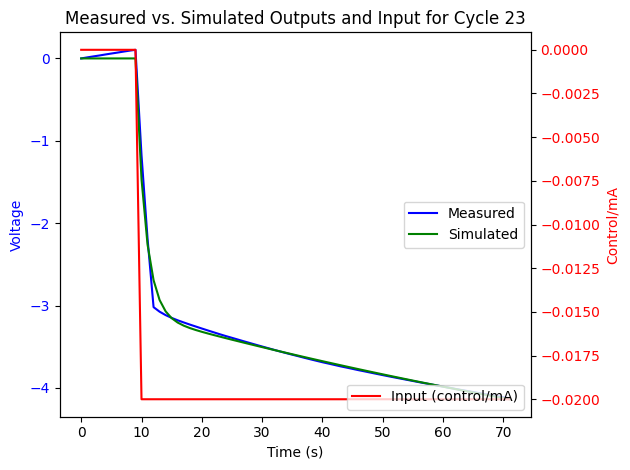

Cycle 24: G_hat_box_jenkins
<TransferFunction>: sys[209252]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 73.37 z^2 - 72.45 z
----------------------
z^2 - 1.531 z + 0.5334

dt = 0.005

Cycle 24: Zeros
[0.98751835+0.j 0.        +0.j]
Cycle 24: Poles
[0.99379884+0.j 0.53677498+0.j]


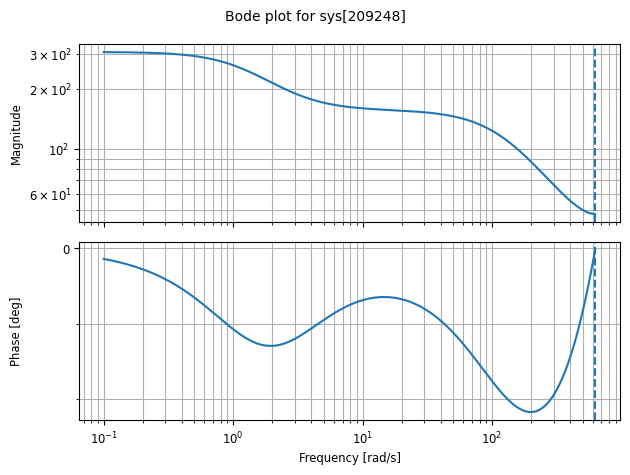

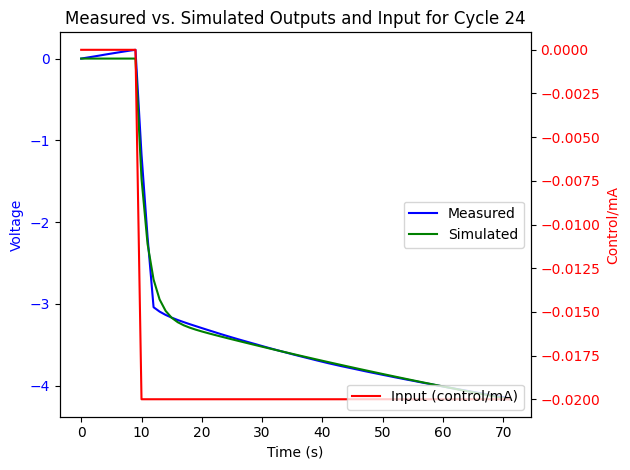

Cycle 25: G_hat_box_jenkins
<TransferFunction>: sys[209256]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  73.49 z^2 - 72.6 z
----------------------
z^2 - 1.531 z + 0.5339

dt = 0.005

Cycle 25: Zeros
[0.9877859+0.j 0.       +0.j]
Cycle 25: Poles
[0.99405032+0.j 0.53707456+0.j]


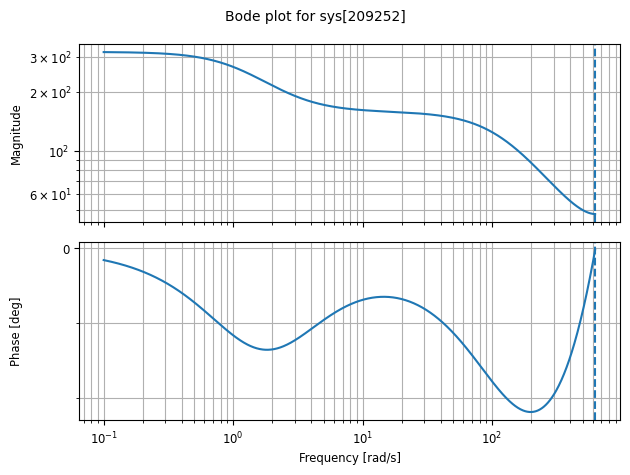

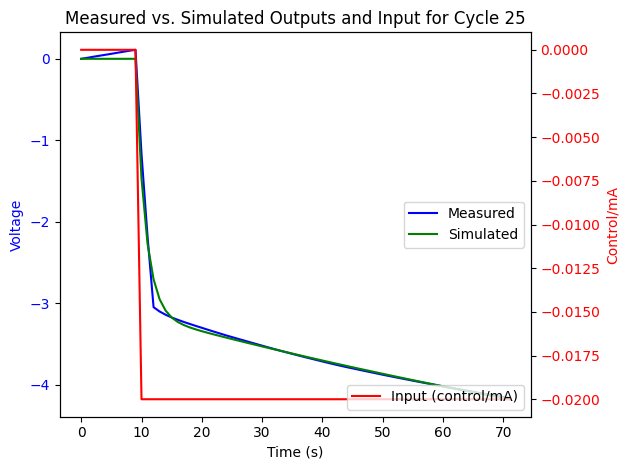

Cycle 26: G_hat_box_jenkins
<TransferFunction>: sys[209260]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  73.8 z^2 - 72.91 z
----------------------
z^2 - 1.531 z + 0.5339

dt = 0.005

Cycle 26: Zeros
[0.98800772+0.j 0.        +0.j]
Cycle 26: Poles
[0.99426497+0.j 0.5369835 +0.j]


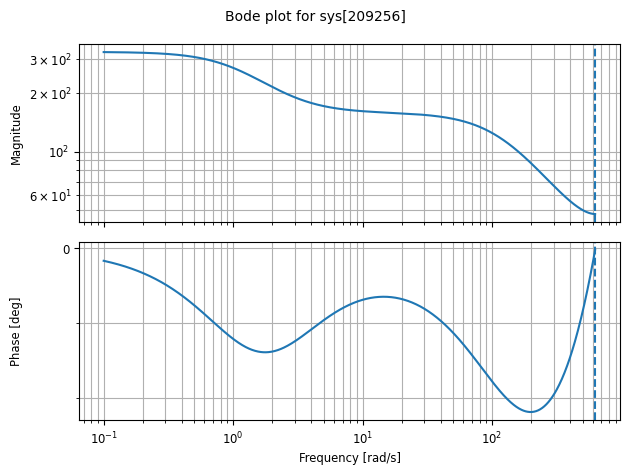

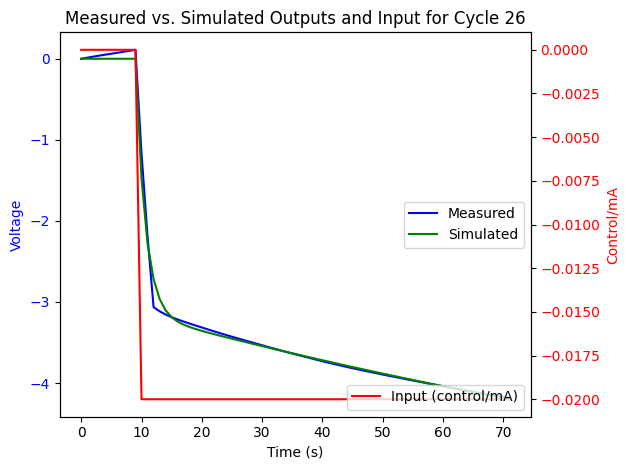

Cycle 27: G_hat_box_jenkins
<TransferFunction>: sys[209264]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  73.6 z^2 - 72.76 z
----------------------
z^2 - 1.534 z + 0.5367

dt = 0.005

Cycle 27: Zeros
[0.98854863+0.j 0.        +0.j]
Cycle 27: Poles
[0.99476278+0.j 0.53956726+0.j]


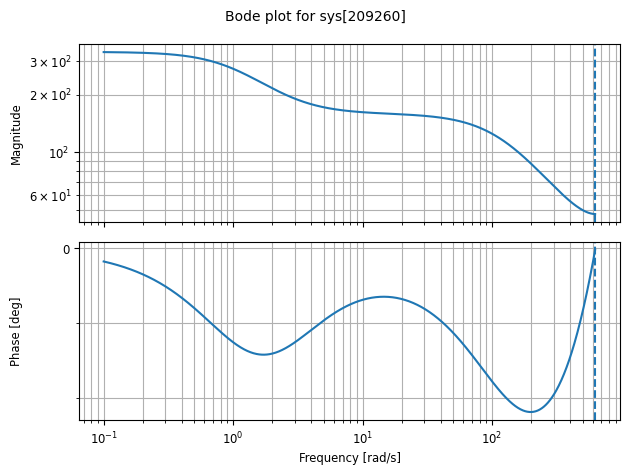

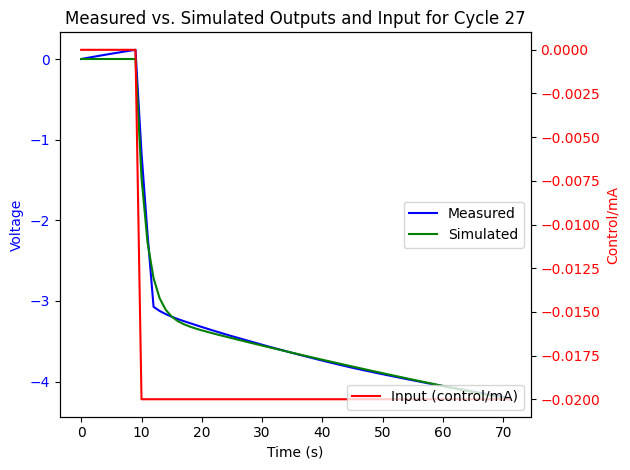

Cycle 28: G_hat_box_jenkins
<TransferFunction>: sys[209268]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 73.83 z^2 - 73.05 z
----------------------
z^2 - 1.535 z + 0.5375

dt = 0.005

Cycle 28: Zeros
[0.98952836+0.j 0.        +0.j]
Cycle 28: Poles
[0.99560658+0.j 0.53988376+0.j]


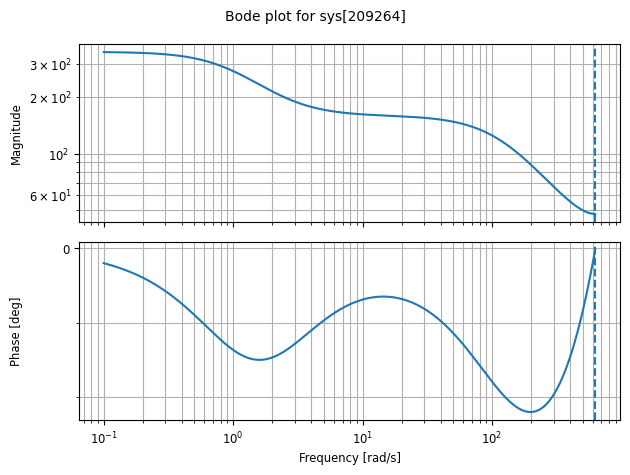

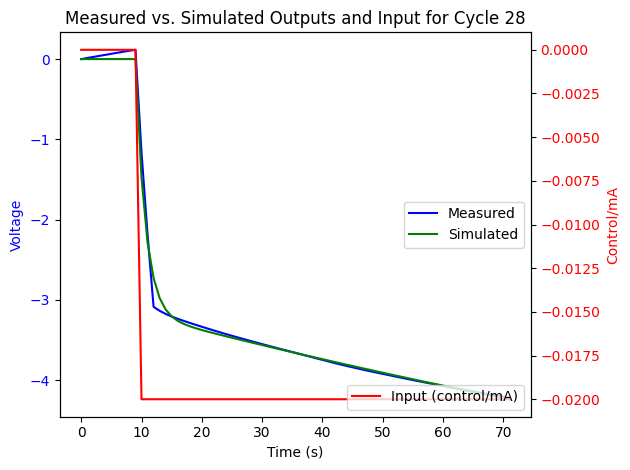

Cycle 29: G_hat_box_jenkins
<TransferFunction>: sys[209272]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  74.08 z^2 - 73.3 z
----------------------
z^2 - 1.535 z + 0.5368

dt = 0.005

Cycle 29: Zeros
[0.98935826+0.j 0.        +0.j]
Cycle 29: Poles
[0.99548424+0.j 0.53922978+0.j]


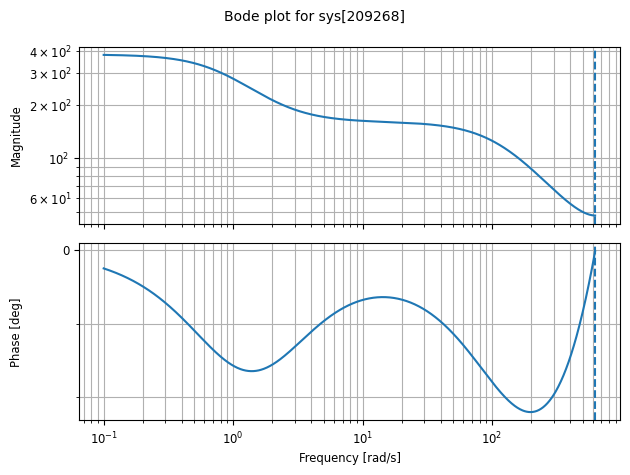

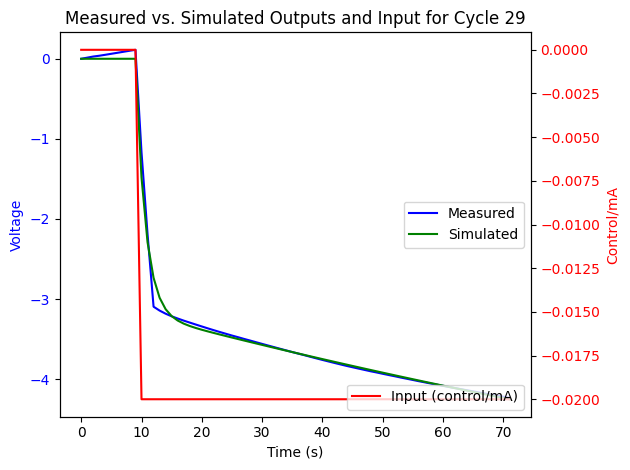

Cycle 30: G_hat_box_jenkins
<TransferFunction>: sys[209276]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 73.73 z^2 - 73.02 z
---------------------
z^2 - 1.539 z + 0.541

dt = 0.005

Cycle 30: Zeros
[0.9903996+0.j 0.       +0.j]
Cycle 30: Poles
[0.9963862 +0.j 0.54298363+0.j]


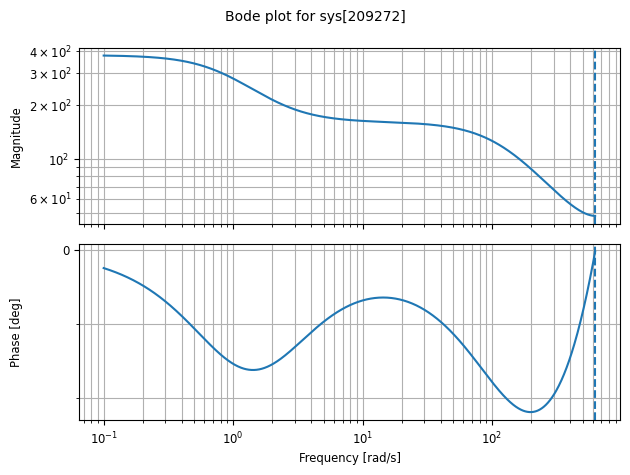

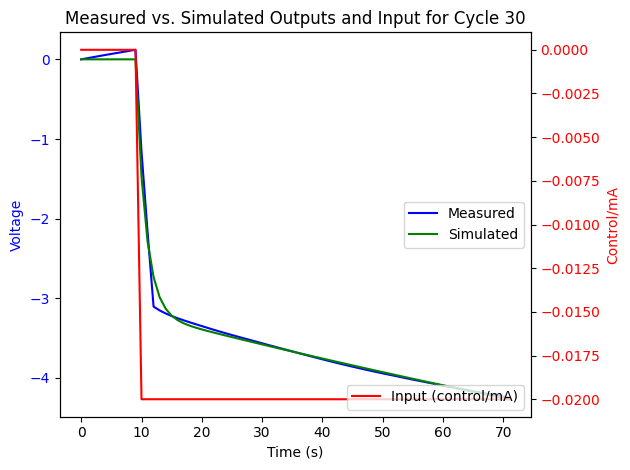

Cycle 31: G_hat_box_jenkins
<TransferFunction>: sys[209280]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 73.98 z^2 - 73.27 z
----------------------
z^2 - 1.539 z + 0.5409

dt = 0.005

Cycle 31: Zeros
[0.99041866+0.j 0.        +0.j]
Cycle 31: Poles
[0.99646164+0.j 0.54286193+0.j]


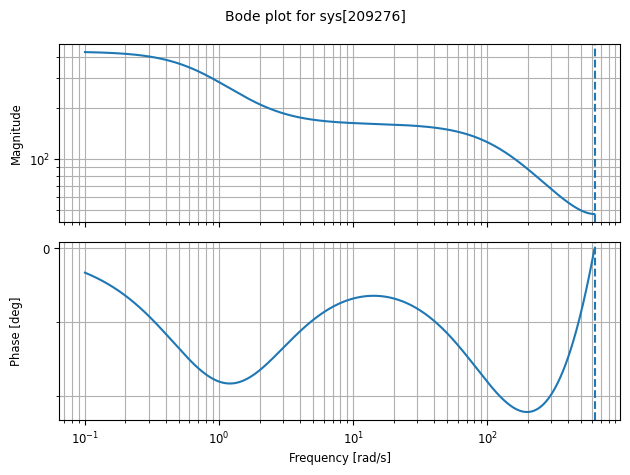

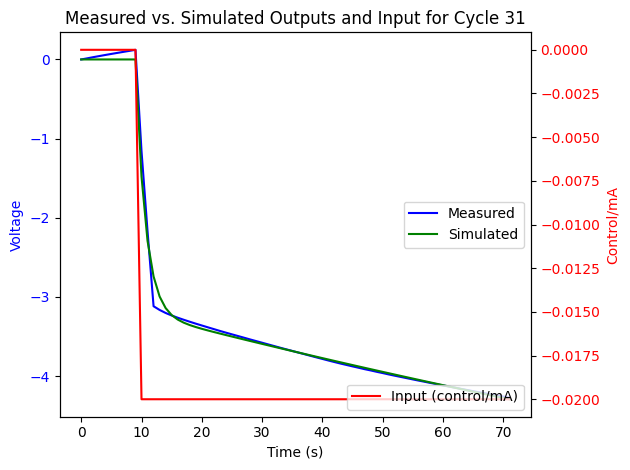

Cycle 32: G_hat_box_jenkins
<TransferFunction>: sys[209284]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


74.32 z^2 - 73.64 z
--------------------
z^2 - 1.54 z + 0.541

dt = 0.005

Cycle 32: Zeros
[0.99079781+0.j 0.        +0.j]
Cycle 32: Poles
[0.99680696+0.j 0.54276969+0.j]


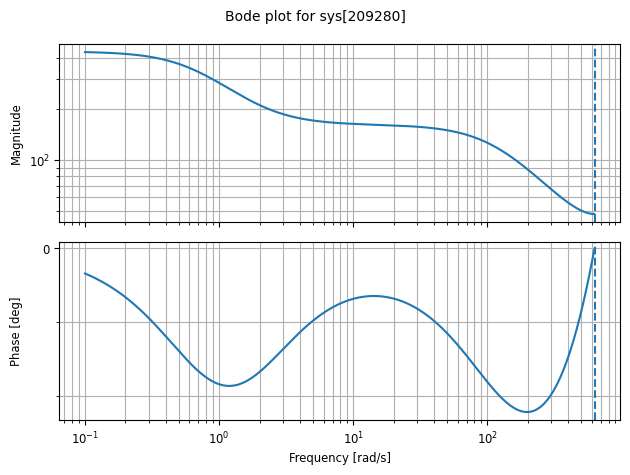

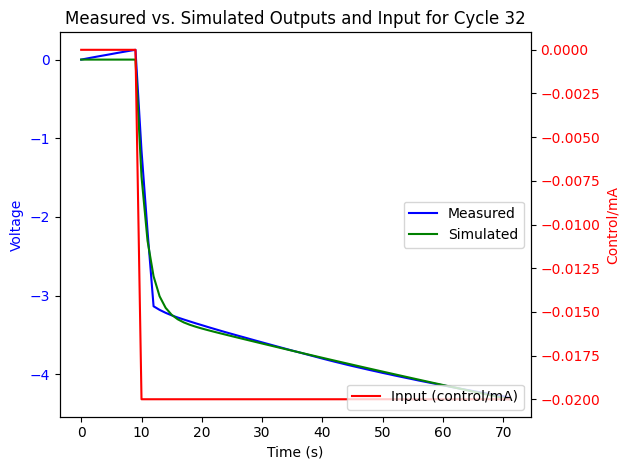

Cycle 33: G_hat_box_jenkins
<TransferFunction>: sys[209288]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  55.79 z^2 + 23.27 z
-----------------------
z^2 - 0.6468 z + 0.1192

dt = 0.005

Cycle 33: Zeros
[-0.41702584+0.j  0.        +0.j]
Cycle 33: Poles
[0.32341376+0.12078234j 0.32341376-0.12078234j]


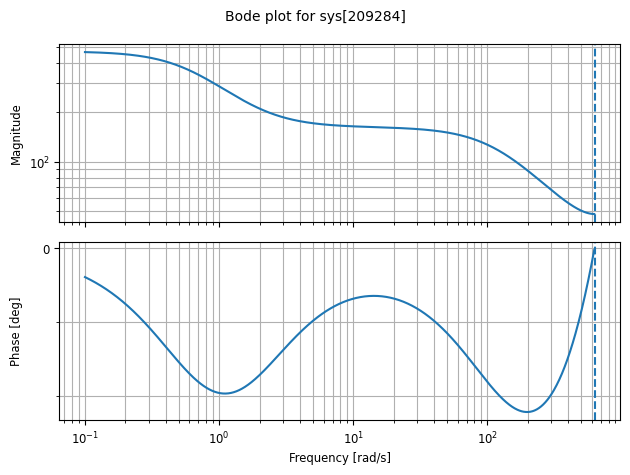

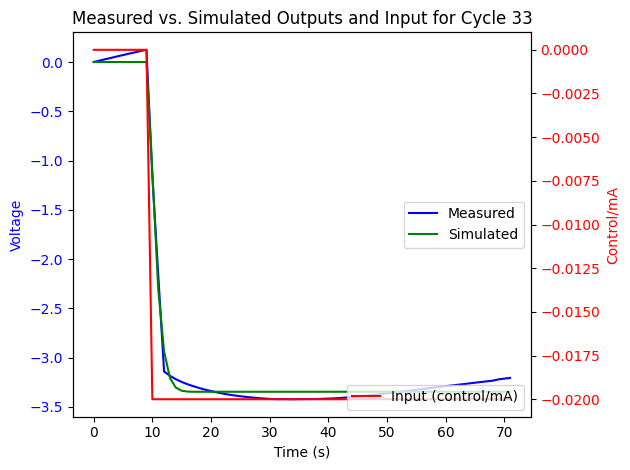

Cycle 34: G_hat_box_jenkins
<TransferFunction>: sys[209292]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 31.38 z^2 - 28.74 z
----------------------
z^2 - 1.426 z + 0.4637

dt = 0.005

Cycle 34: Zeros
[0.9160639+0.j 0.       +0.j]
Cycle 34: Poles
[0.924784  +0.j 0.50143968+0.j]


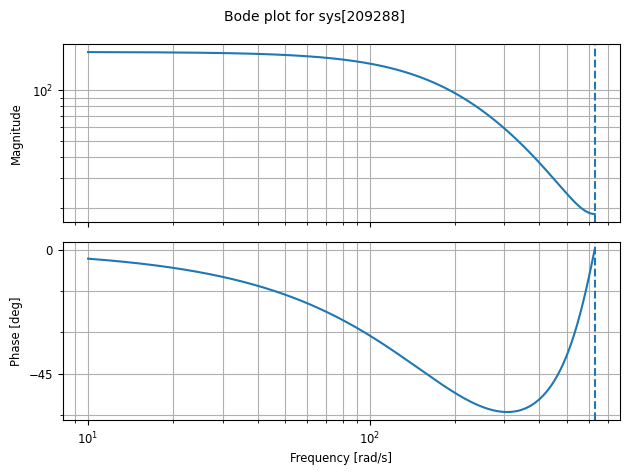

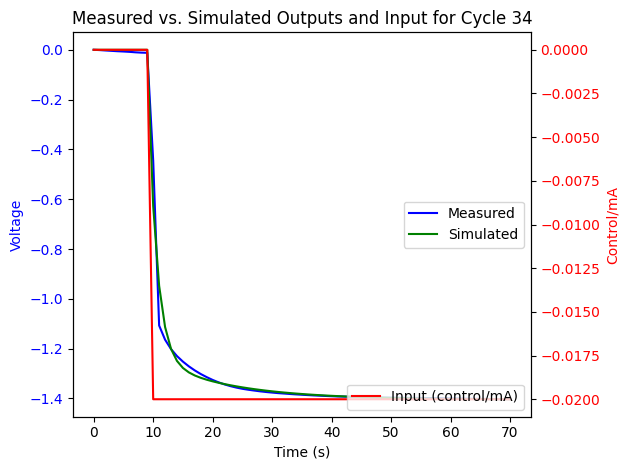

Cycle 35: G_hat_box_jenkins
<TransferFunction>: sys[209296]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


   23.41 z^2 - 22 z
----------------------
z^2 - 1.474 z + 0.4991

dt = 0.005

Cycle 35: Zeros
[0.93994388+0.j 0.        +0.j]
Cycle 35: Poles
[0.94799394+0.j 0.52645788+0.j]


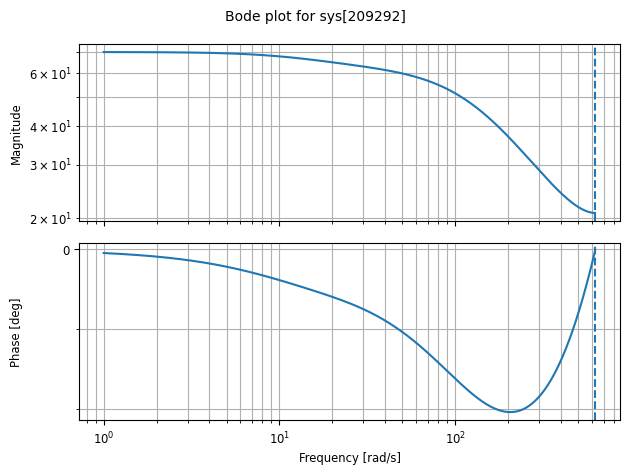

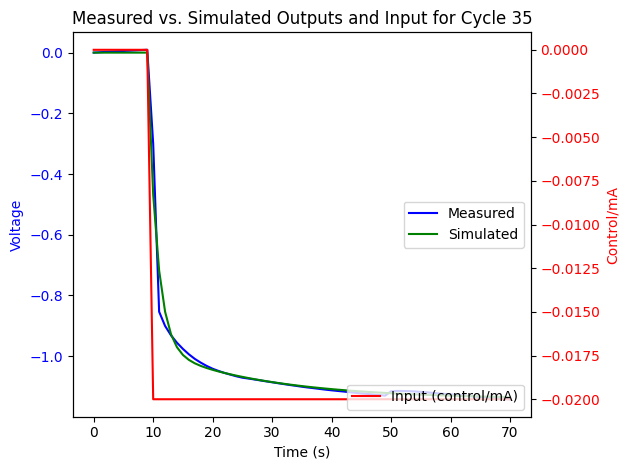

Cycle 36: G_hat_box_jenkins
<TransferFunction>: sys[209300]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 21.48 z^2 - 20.63 z
----------------------
z^2 - 1.507 z + 0.5225

dt = 0.005

Cycle 36: Zeros
[0.96053324+0.j 0.        +0.j]
Cycle 36: Poles
[0.9663761 +0.j 0.54066055+0.j]


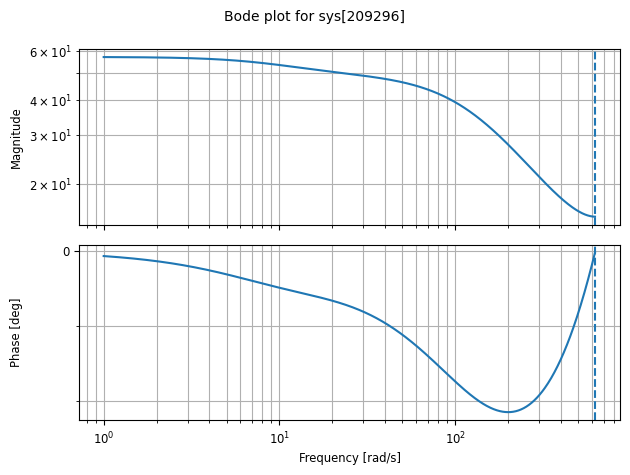

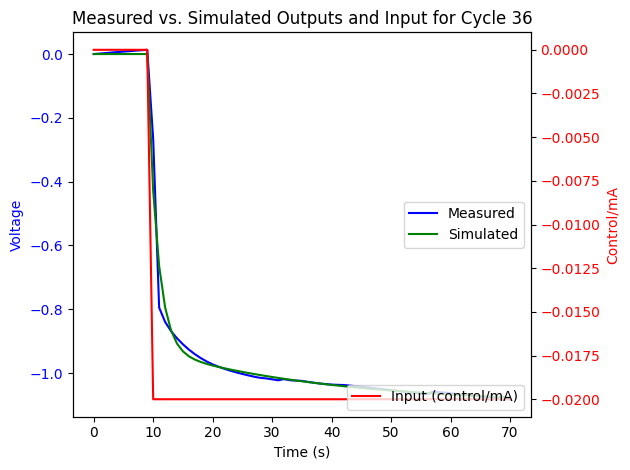

Cycle 37: G_hat_box_jenkins
<TransferFunction>: sys[209304]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 20.58 z^2 - 19.65 z
---------------------
z^2 - 1.489 z + 0.506

dt = 0.005

Cycle 37: Zeros
[0.95503775+0.j 0.        +0.j]
Cycle 37: Poles
[0.9634931 +0.j 0.52521403+0.j]


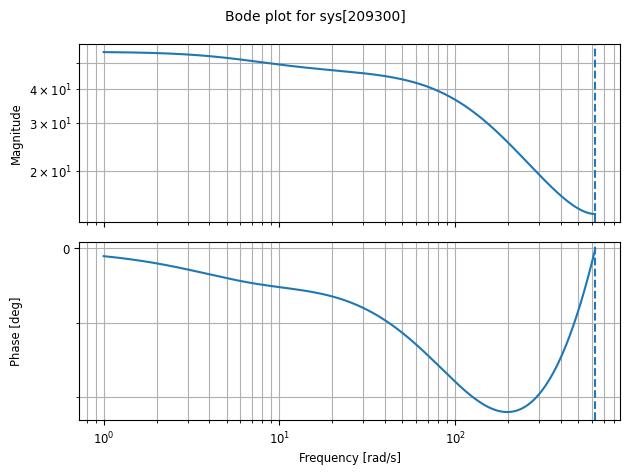

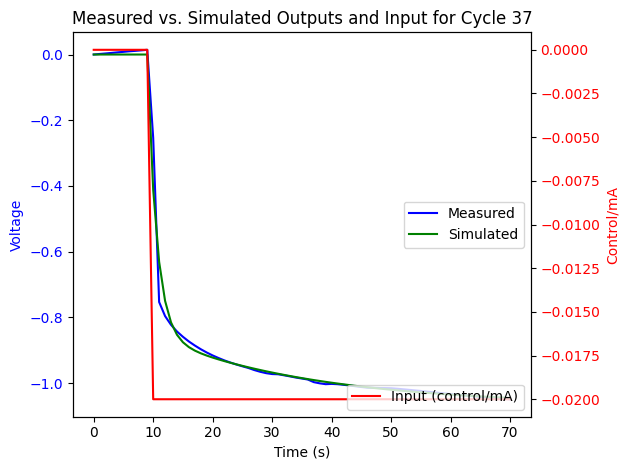

Cycle 38: G_hat_box_jenkins
<TransferFunction>: sys[209308]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  19.24 z^2 - 18.1 z
----------------------
z^2 - 1.479 z + 0.5012

dt = 0.005

Cycle 38: Zeros
[0.94067767+0.j 0.        +0.j]
Cycle 38: Poles
[0.95268899+0.j 0.5261248 +0.j]


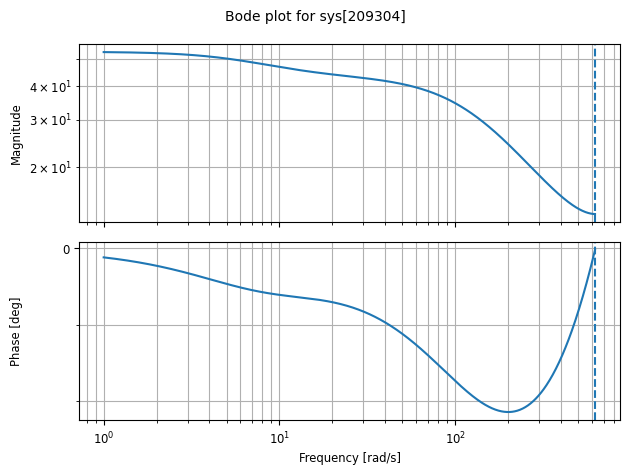

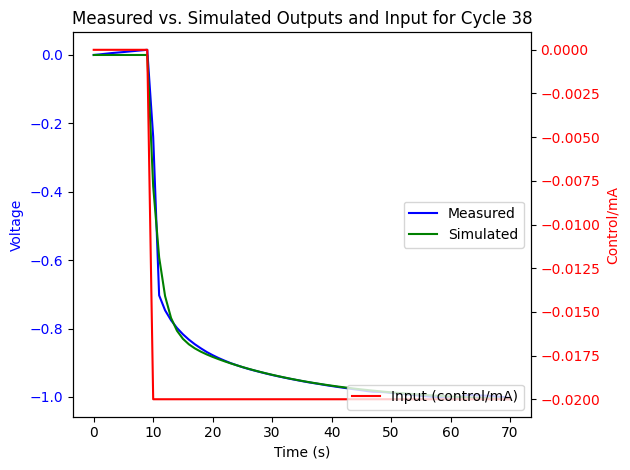

Cycle 39: G_hat_box_jenkins
<TransferFunction>: sys[209312]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  19.26 z^2 - 18.5 z
----------------------
z^2 - 1.503 z + 0.5183

dt = 0.005

Cycle 39: Zeros
[0.96053713+0.j 0.        +0.j]
Cycle 39: Poles
[0.96743997+0.j 0.53570493+0.j]


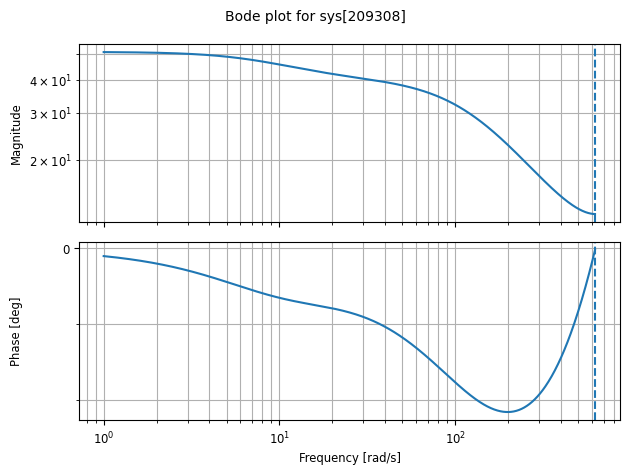

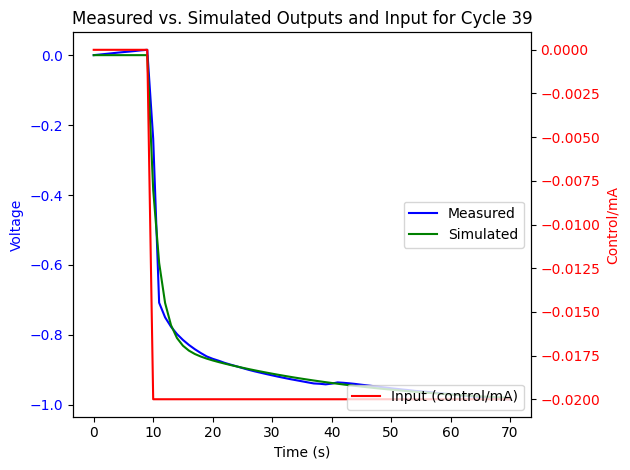

Cycle 40: G_hat_box_jenkins
<TransferFunction>: sys[209316]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 19.24 z^2 - 18.53 z
----------------------
z^2 - 1.492 z + 0.5059

dt = 0.005

Cycle 40: Zeros
[0.96325539+0.j 0.        +0.j]
Cycle 40: Poles
[0.97204345+0.j 0.52045227+0.j]


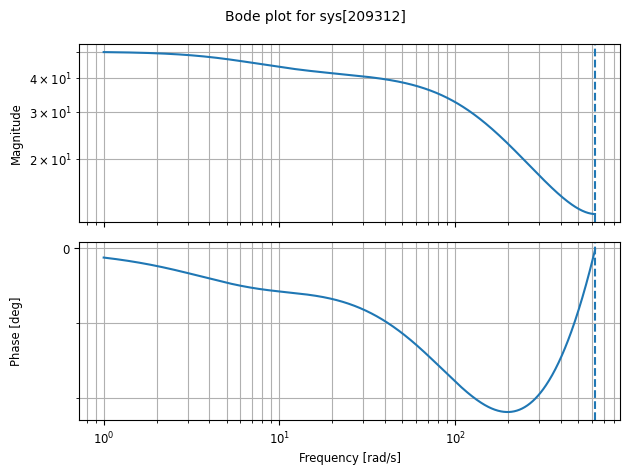

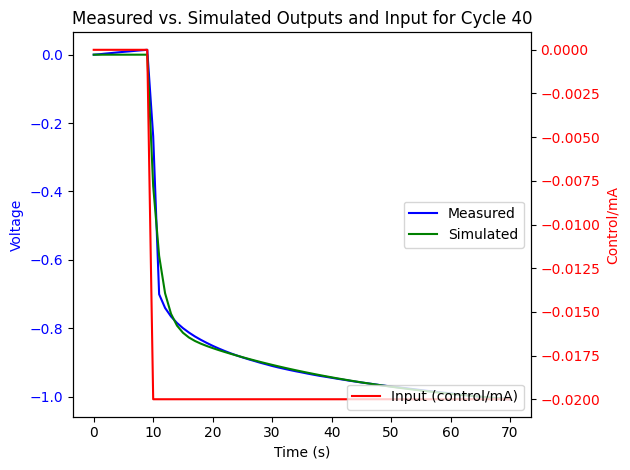

Cycle 41: G_hat_box_jenkins
<TransferFunction>: sys[209320]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 19.37 z^2 - 18.65 z
----------------------
z^2 - 1.495 z + 0.5087

dt = 0.005

Cycle 41: Zeros
[0.96323961+0.j 0.        +0.j]
Cycle 41: Poles
[0.97193301+0.j 0.523364  +0.j]


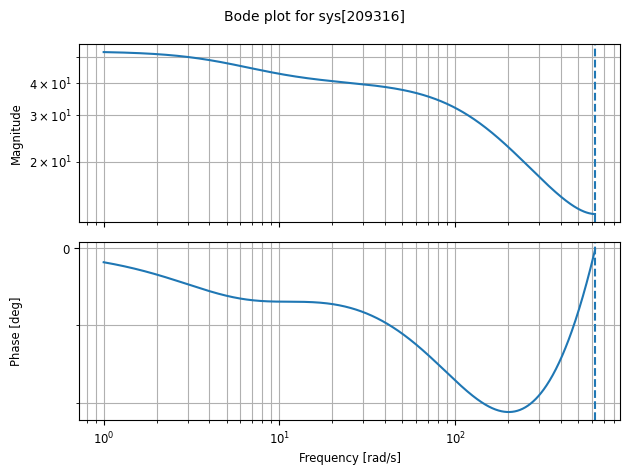

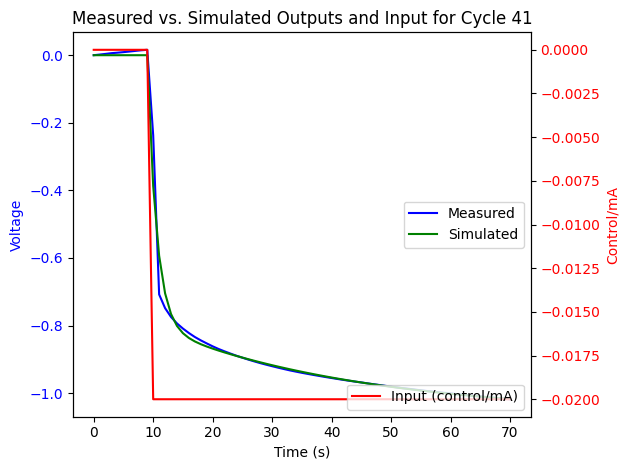

Cycle 42: G_hat_box_jenkins
<TransferFunction>: sys[209324]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 19.43 z^2 - 18.75 z
----------------------
z^2 - 1.494 z + 0.5066

dt = 0.005

Cycle 42: Zeros
[0.9650201+0.j 0.       +0.j]
Cycle 42: Poles
[0.97382204+0.j 0.52017894+0.j]


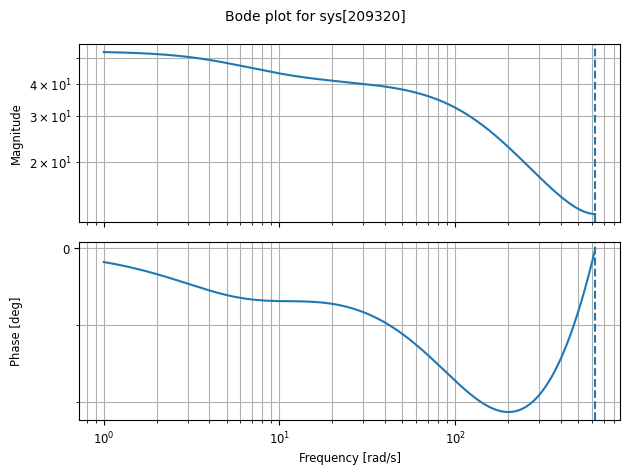

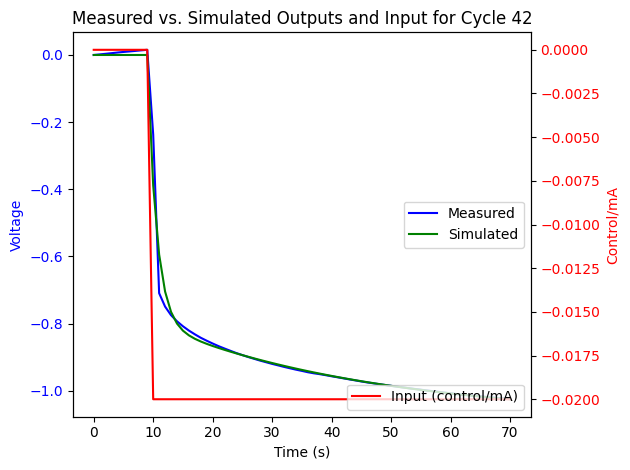

Cycle 43: G_hat_box_jenkins
<TransferFunction>: sys[209328]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 19.62 z^2 - 18.94 z
----------------------
z^2 - 1.494 z + 0.5067

dt = 0.005

Cycle 43: Zeros
[0.96562367+0.j 0.        +0.j]
Cycle 43: Poles
[0.97445855+0.j 0.5199956 +0.j]


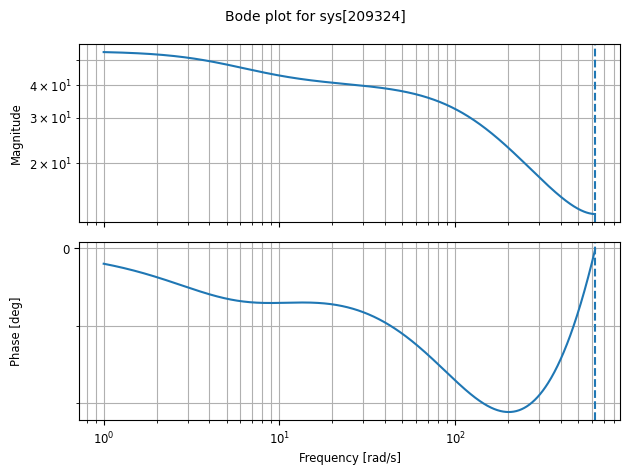

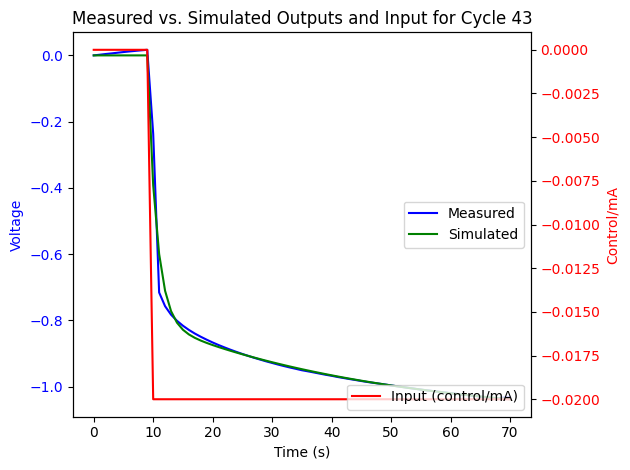

Cycle 44: G_hat_box_jenkins
<TransferFunction>: sys[209332]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 19.67 z^2 - 19.12 z
----------------------
z^2 - 1.501 z + 0.5111

dt = 0.005

Cycle 44: Zeros
[0.97161895+0.j 0.        +0.j]
Cycle 44: Poles
[0.97941003+0.j 0.52180289+0.j]


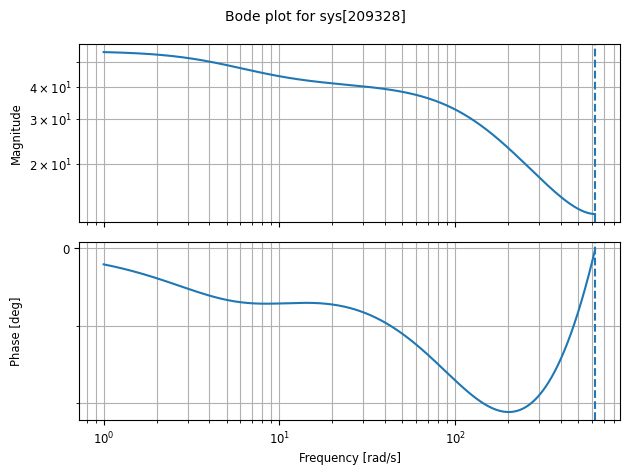

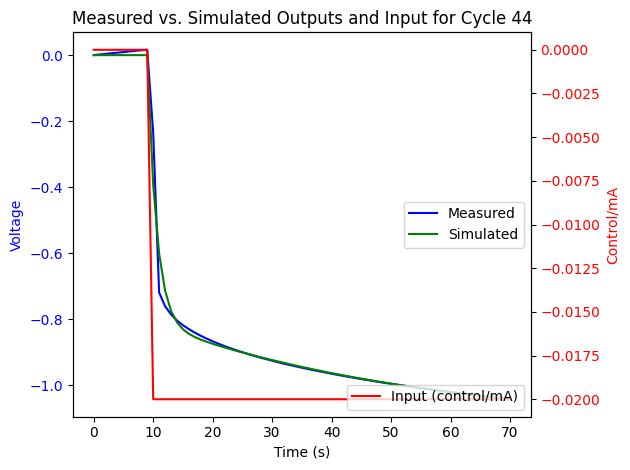

Cycle 45: G_hat_box_jenkins
<TransferFunction>: sys[209336]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 19.33 z^2 - 18.74 z
----------------------
z^2 - 1.501 z + 0.5116

dt = 0.005

Cycle 45: Zeros
[0.96906732+0.j 0.        +0.j]
Cycle 45: Poles
[0.97766017+0.j 0.5232995 +0.j]


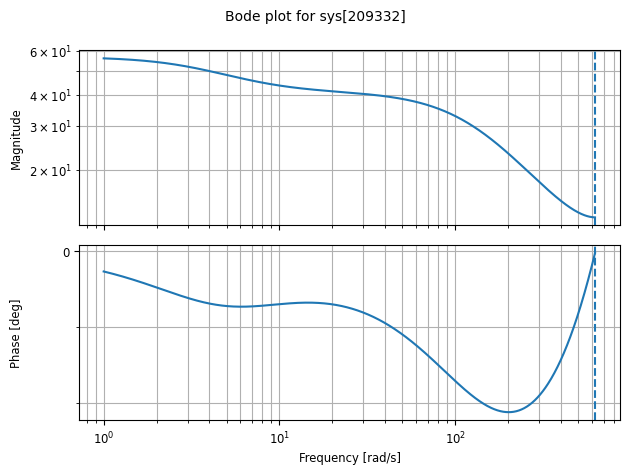

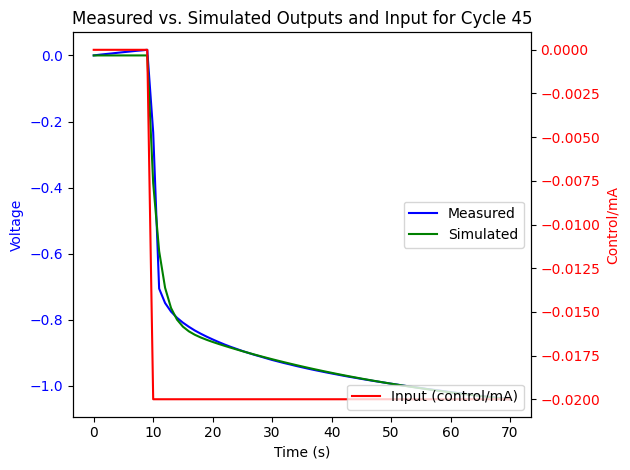

Cycle 46: G_hat_box_jenkins
<TransferFunction>: sys[209340]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 19.38 z^2 - 18.76 z
----------------------
z^2 - 1.501 z + 0.5123

dt = 0.005

Cycle 46: Zeros
[0.96827992+0.j 0.        +0.j]
Cycle 46: Poles
[0.97730595+0.j 0.52418287+0.j]


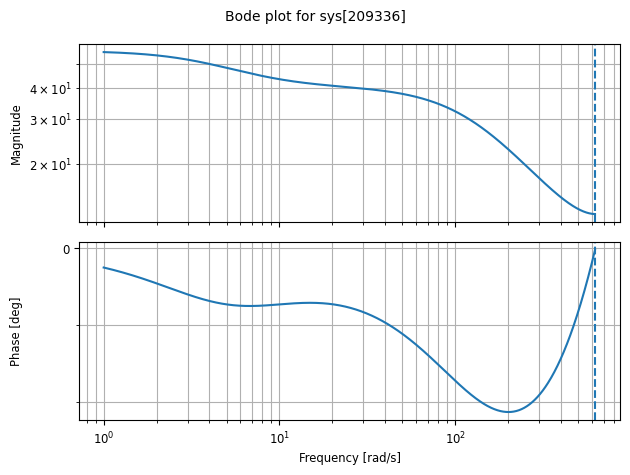

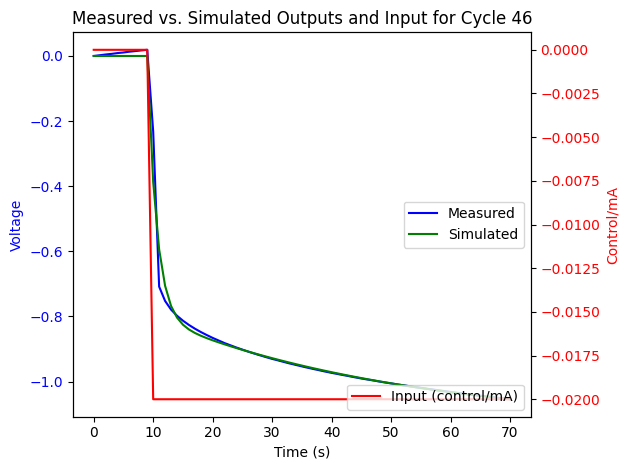

Cycle 47: G_hat_box_jenkins
<TransferFunction>: sys[209344]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 19.58 z^2 - 18.96 z
----------------------
z^2 - 1.502 z + 0.5129

dt = 0.005

Cycle 47: Zeros
[0.96863808+0.j 0.        +0.j]
Cycle 47: Poles
[0.97763567+0.j 0.52466265+0.j]


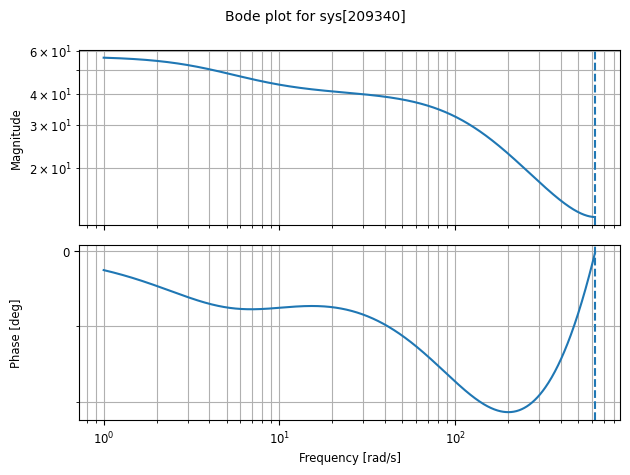

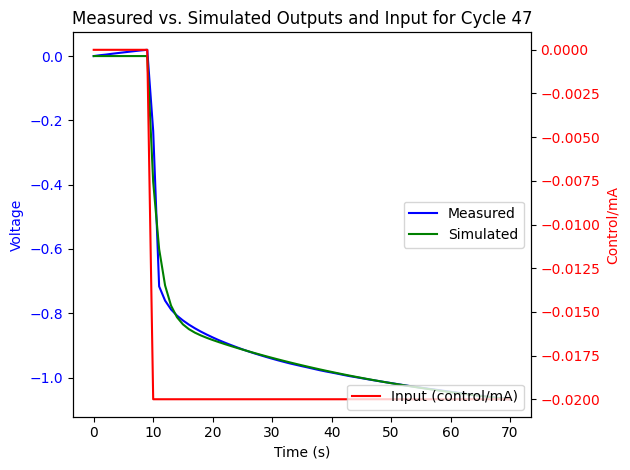

Cycle 48: G_hat_box_jenkins
<TransferFunction>: sys[209348]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 19.71 z^2 - 19.08 z
----------------------
z^2 - 1.502 z + 0.5129

dt = 0.005

Cycle 48: Zeros
[0.96832102+0.j 0.        +0.j]
Cycle 48: Poles
[0.9774843 +0.j 0.52468087+0.j]


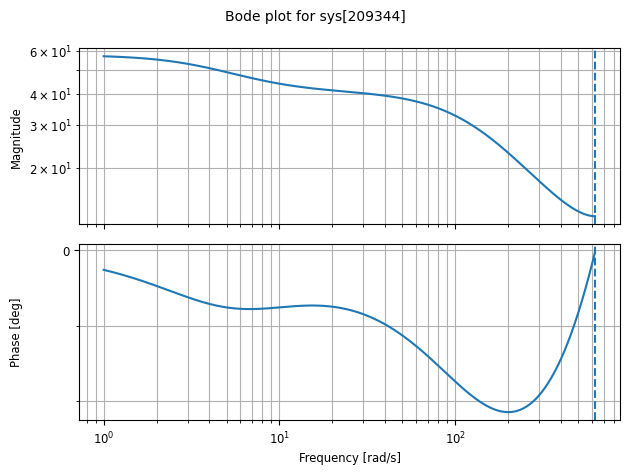

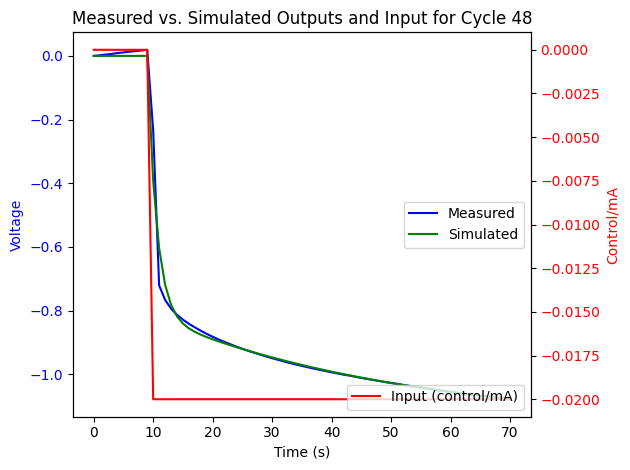

Cycle 49: G_hat_box_jenkins
<TransferFunction>: sys[209352]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


19.81 z^2 - 19.17 z
--------------------
z^2 - 1.5 z + 0.5113

dt = 0.005

Cycle 49: Zeros
[0.96744496+0.j 0.        +0.j]
Cycle 49: Poles
[0.97696167+0.j 0.52338183+0.j]


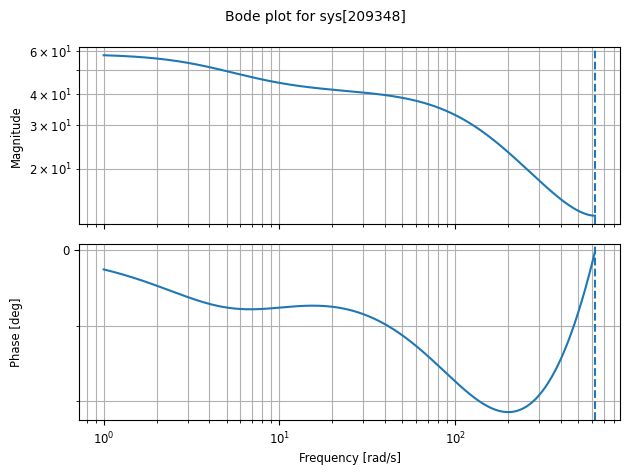

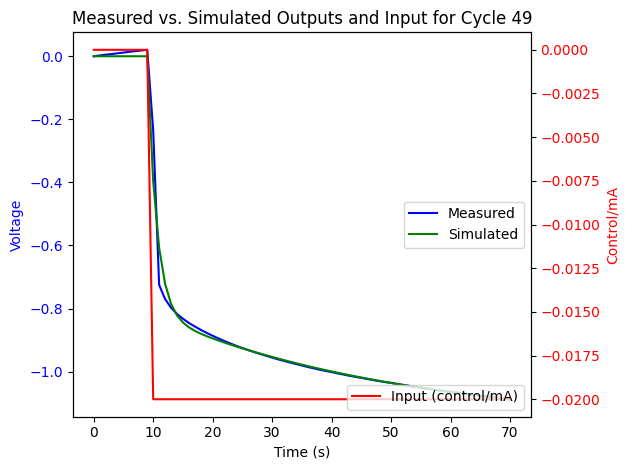

Cycle 50: G_hat_box_jenkins
<TransferFunction>: sys[209356]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 19.86 z^2 - 19.15 z
---------------------
z^2 - 1.496 z + 0.508

dt = 0.005

Cycle 50: Zeros
[0.96428189+0.j 0.        +0.j]
Cycle 50: Poles
[0.97434203+0.j 0.52139625+0.j]


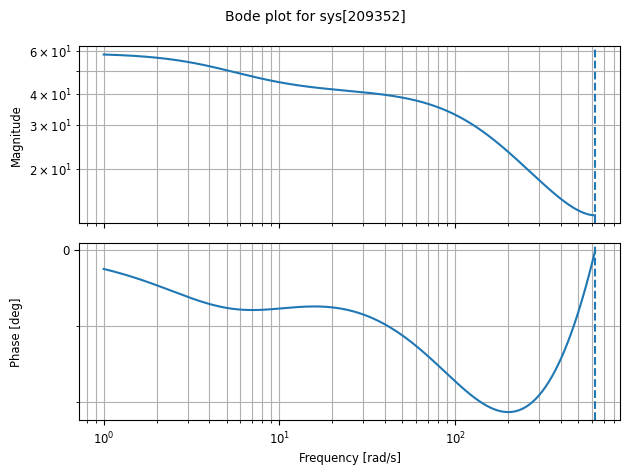

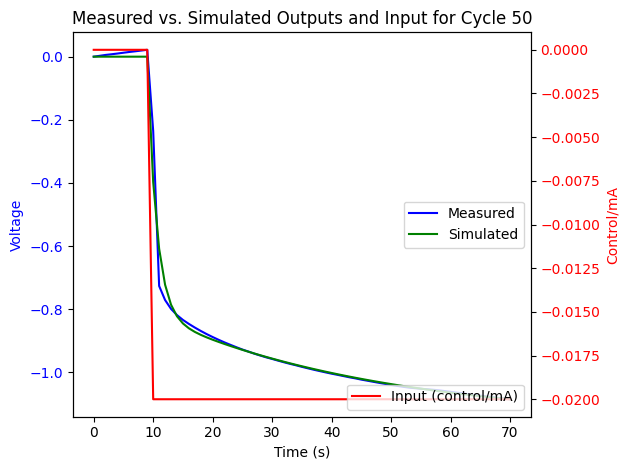

Cycle 51: G_hat_box_jenkins
<TransferFunction>: sys[209360]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 19.92 z^2 - 19.31 z
----------------------
z^2 - 1.502 z + 0.5118

dt = 0.005

Cycle 51: Zeros
[0.96935858+0.j 0.        +0.j]
Cycle 51: Poles
[0.97854707+0.j 0.52304405+0.j]


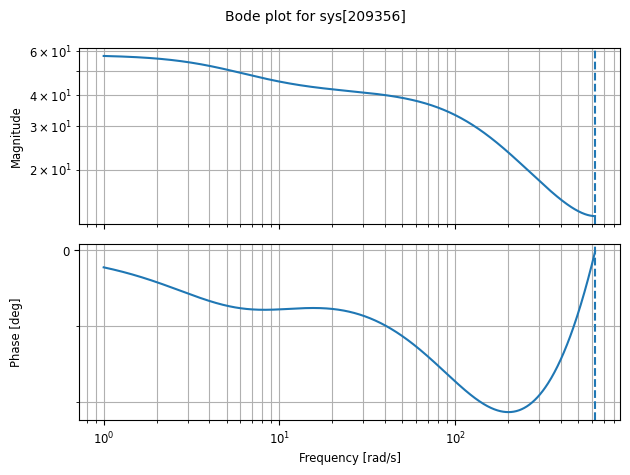

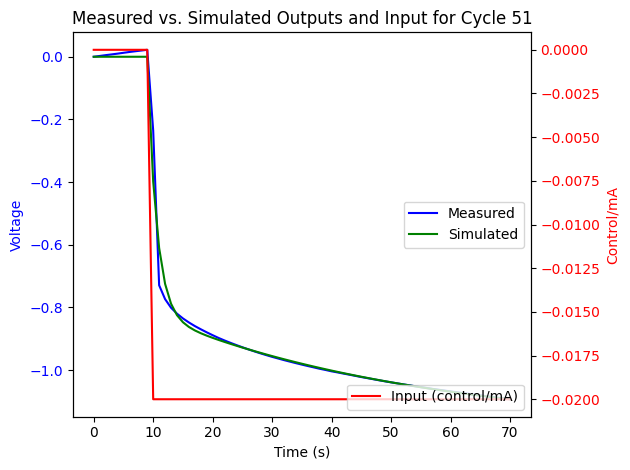

Cycle 52: G_hat_box_jenkins
<TransferFunction>: sys[209364]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 20.03 z^2 - 19.42 z
----------------------
z^2 - 1.501 z + 0.5113

dt = 0.005

Cycle 52: Zeros
[0.9696411+0.j 0.       +0.j]
Cycle 52: Poles
[0.97893466+0.j 0.52234765+0.j]


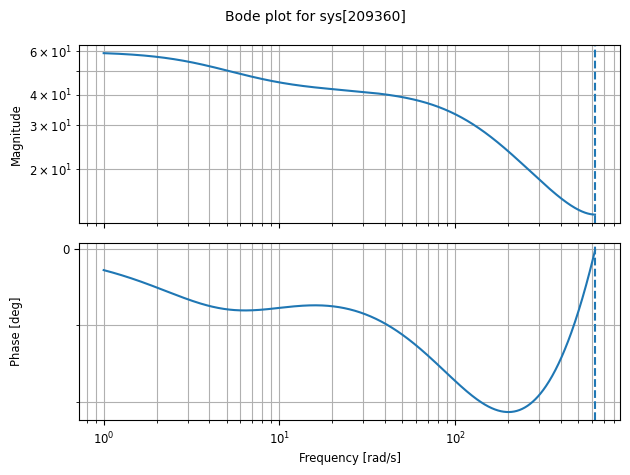

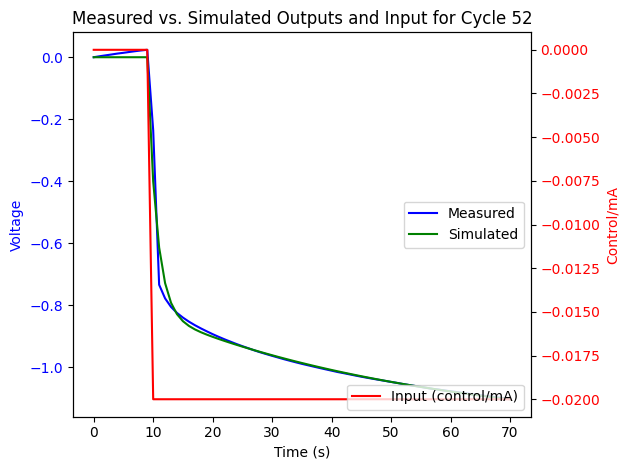

Cycle 53: G_hat_box_jenkins
<TransferFunction>: sys[209368]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 20.13 z^2 - 19.51 z
---------------------
z^2 - 1.501 z + 0.511

dt = 0.005

Cycle 53: Zeros
[0.96918017+0.j 0.        +0.j]
Cycle 53: Poles
[0.9785967 +0.j 0.52221497+0.j]


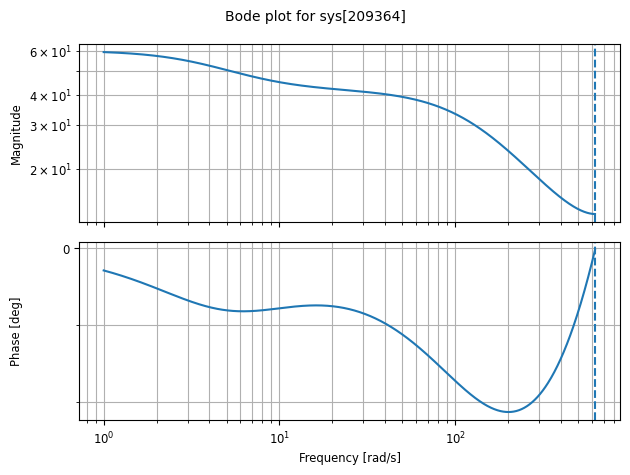

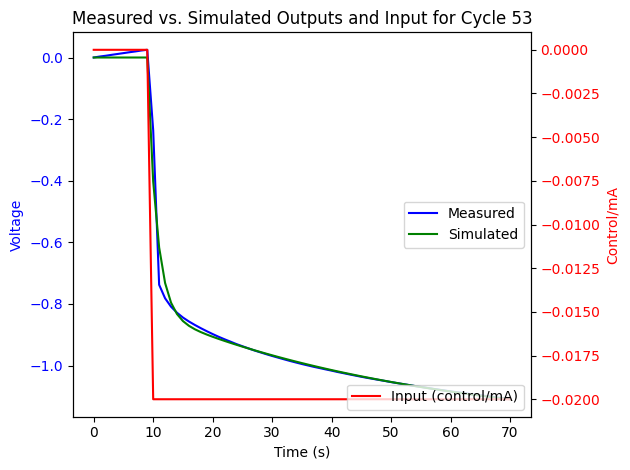

Cycle 54: G_hat_box_jenkins
<TransferFunction>: sys[209372]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 20.21 z^2 - 19.62 z
----------------------
z^2 - 1.502 z + 0.5116

dt = 0.005

Cycle 54: Zeros
[0.97059751+0.j 0.        +0.j]
Cycle 54: Poles
[0.97968908+0.j 0.52221121+0.j]


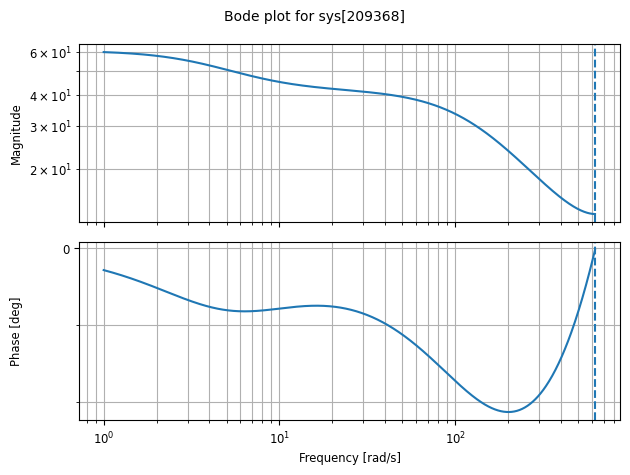

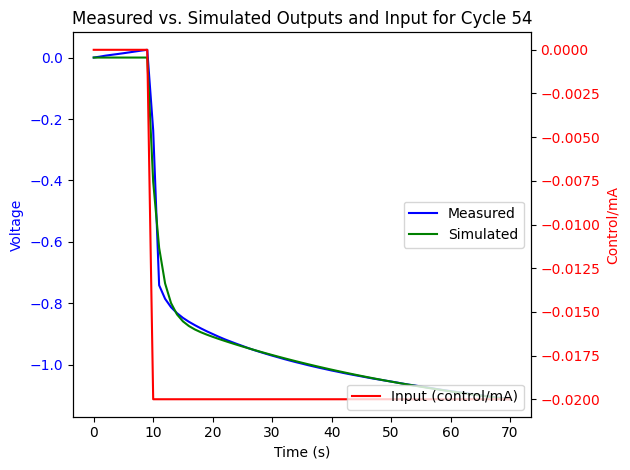

Cycle 55: G_hat_box_jenkins
<TransferFunction>: sys[209376]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 20.32 z^2 - 19.72 z
----------------------
z^2 - 1.502 z + 0.5114

dt = 0.005

Cycle 55: Zeros
[0.97073975+0.j 0.        +0.j]
Cycle 55: Poles
[0.97993108+0.j 0.52191959+0.j]


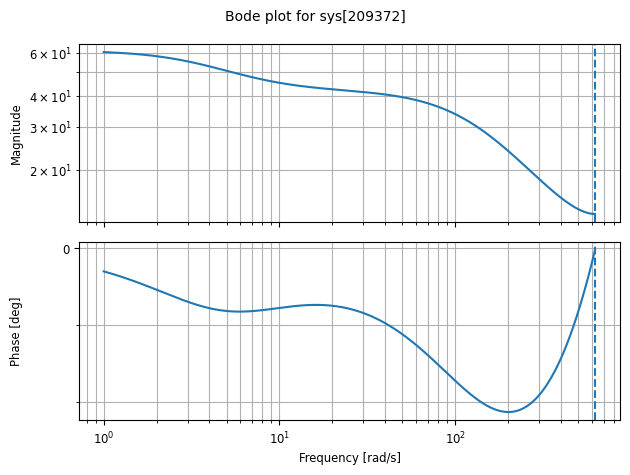

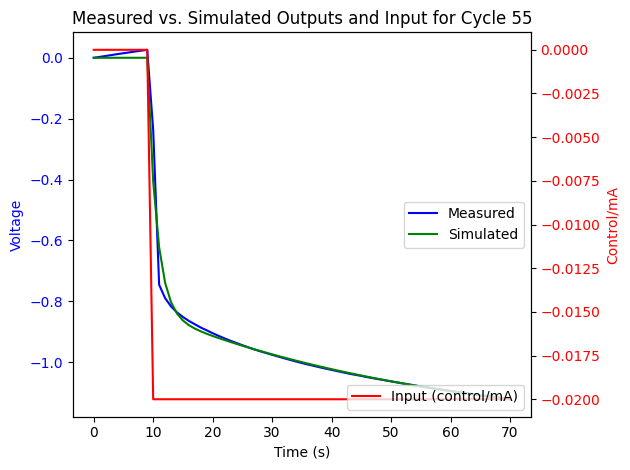

Cycle 56: G_hat_box_jenkins
<TransferFunction>: sys[209380]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 20.45 z^2 - 19.87 z
----------------------
z^2 - 1.502 z + 0.5116

dt = 0.005

Cycle 56: Zeros
[0.97152025+0.j 0.        +0.j]
Cycle 56: Poles
[0.98060224+0.j 0.52169052+0.j]


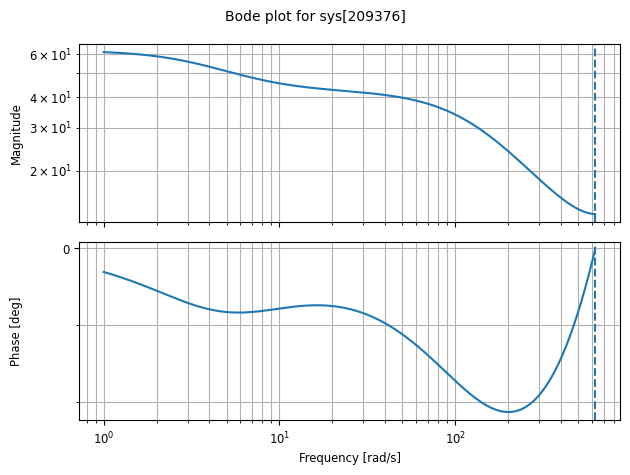

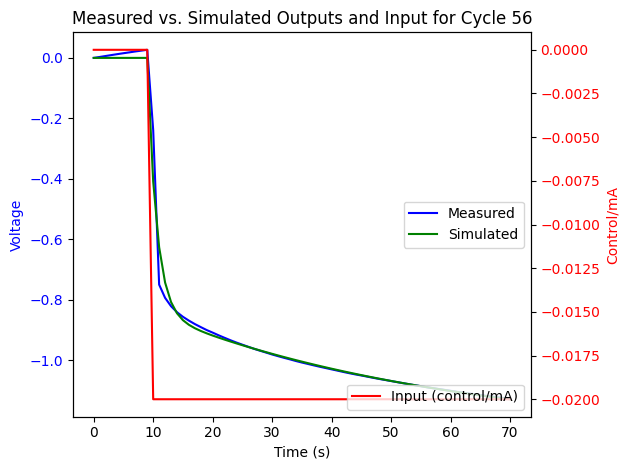

Cycle 57: G_hat_box_jenkins
<TransferFunction>: sys[209384]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 20.55 z^2 - 19.99 z
----------------------
z^2 - 1.502 z + 0.5113

dt = 0.005

Cycle 57: Zeros
[0.97248738+0.j 0.        +0.j]
Cycle 57: Poles
[0.98148836+0.j 0.52097459+0.j]


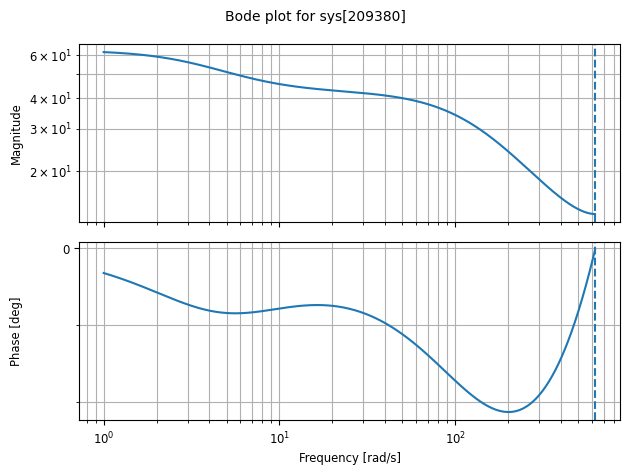

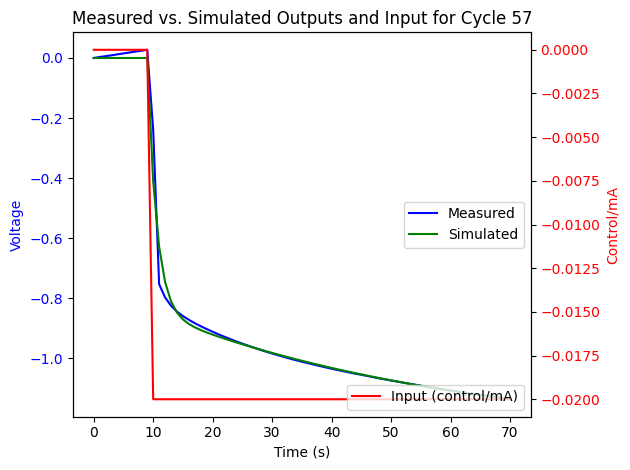

Cycle 58: G_hat_box_jenkins
<TransferFunction>: sys[209388]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 20.63 z^2 - 20.05 z
----------------------
z^2 - 1.501 z + 0.5101

dt = 0.005

Cycle 58: Zeros
[0.97212065+0.j 0.        +0.j]
Cycle 58: Poles
[0.9813215 +0.j 0.51981553+0.j]


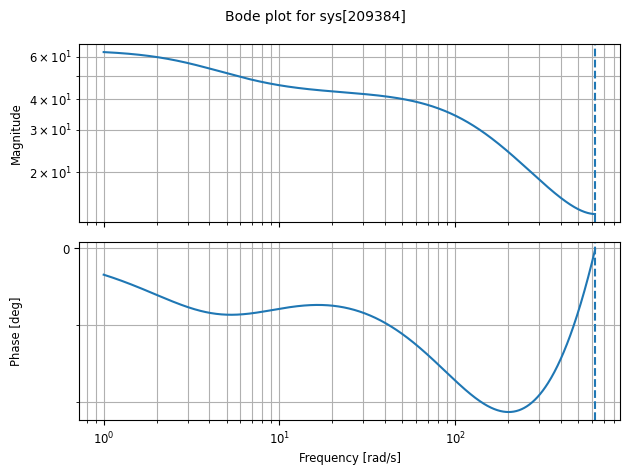

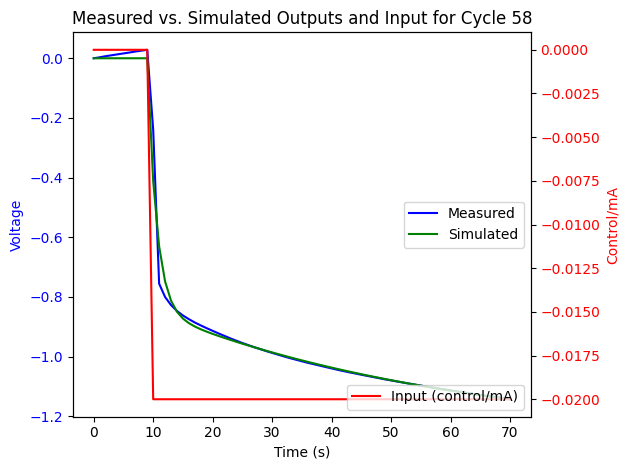

Cycle 59: G_hat_box_jenkins
<TransferFunction>: sys[209392]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 20.69 z^2 - 20.12 z
---------------------
z^2 - 1.502 z + 0.511

dt = 0.005

Cycle 59: Zeros
[0.97278324+0.j 0.        +0.j]
Cycle 59: Poles
[0.98190526+0.j 0.52041369+0.j]


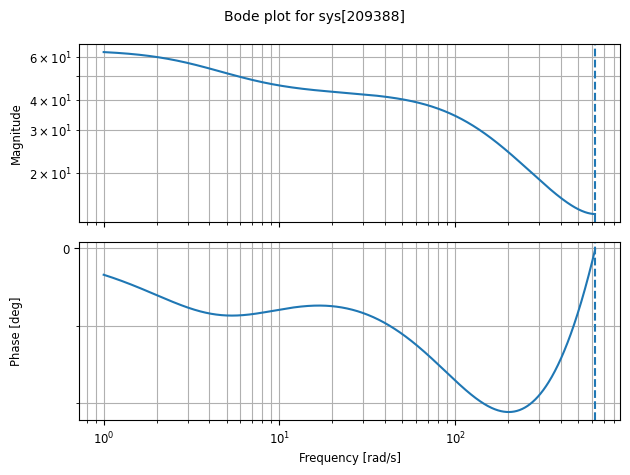

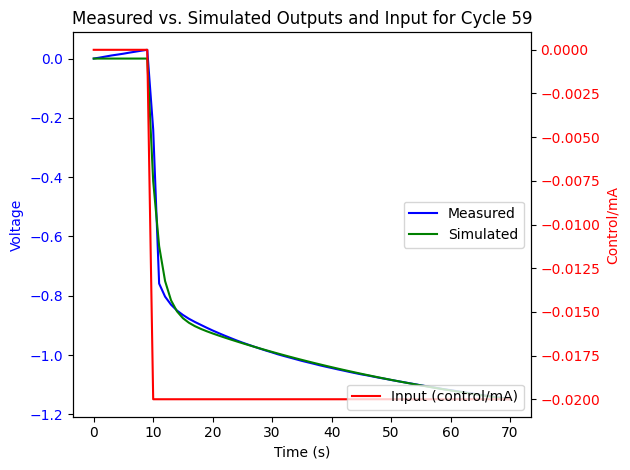

Cycle 60: G_hat_box_jenkins
<TransferFunction>: sys[209396]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 20.76 z^2 - 20.19 z
----------------------
z^2 - 1.502 z + 0.5103

dt = 0.005

Cycle 60: Zeros
[0.97271052+0.j 0.        +0.j]
Cycle 60: Poles
[0.98193144+0.j 0.51965312+0.j]


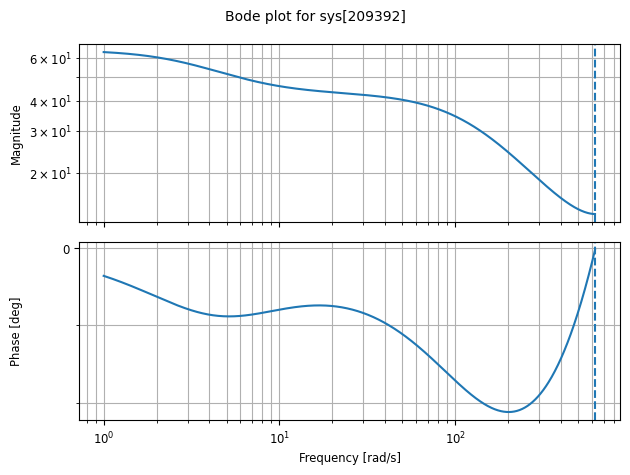

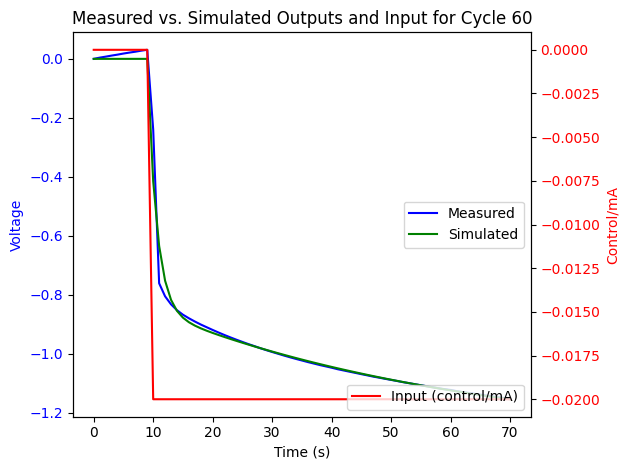

Cycle 61: G_hat_box_jenkins
<TransferFunction>: sys[209400]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 20.88 z^2 - 20.33 z
----------------------
z^2 - 1.503 z + 0.5113

dt = 0.005

Cycle 61: Zeros
[0.97382615+0.j 0.        +0.j]
Cycle 61: Poles
[0.98290266+0.j 0.52020463+0.j]


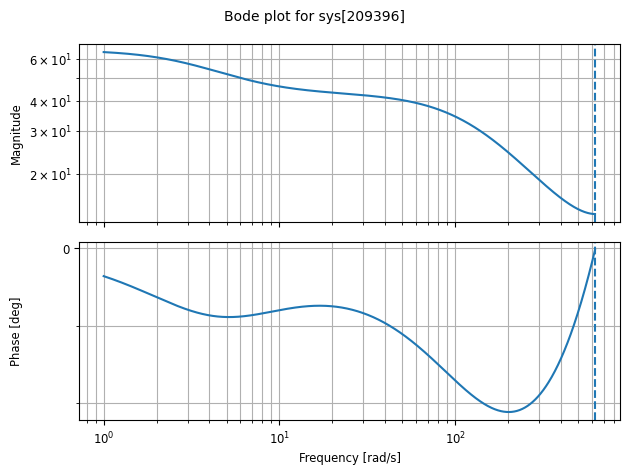

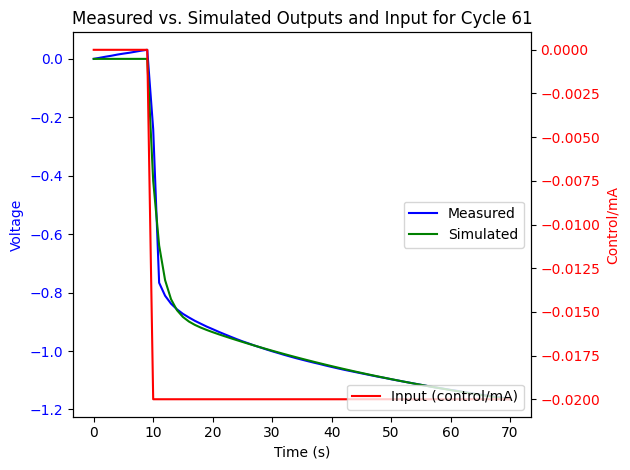

Cycle 62: G_hat_box_jenkins
<TransferFunction>: sys[209404]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 21.05 z^2 - 20.49 z
----------------------
z^2 - 1.503 z + 0.5117

dt = 0.005

Cycle 62: Zeros
[0.97352167+0.j 0.        +0.j]
Cycle 62: Poles
[0.98264551+0.j 0.52074493+0.j]


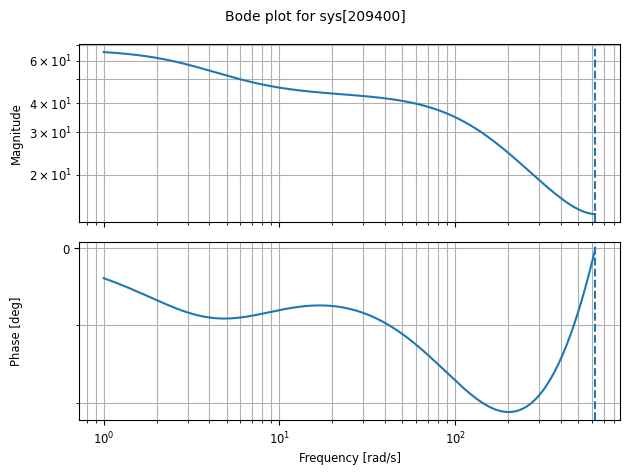

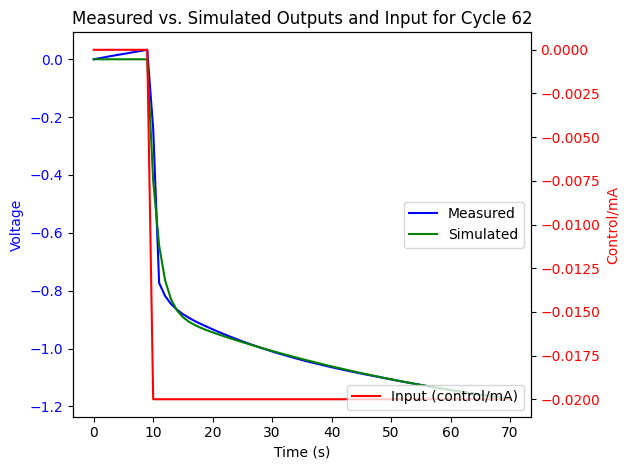

Cycle 63: G_hat_box_jenkins
<TransferFunction>: sys[209408]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  21.2 z^2 - 20.63 z
----------------------
z^2 - 1.502 z + 0.5104

dt = 0.005

Cycle 63: Zeros
[0.97344452+0.j 0.        +0.j]
Cycle 63: Poles
[0.98261125+0.j 0.51946023+0.j]


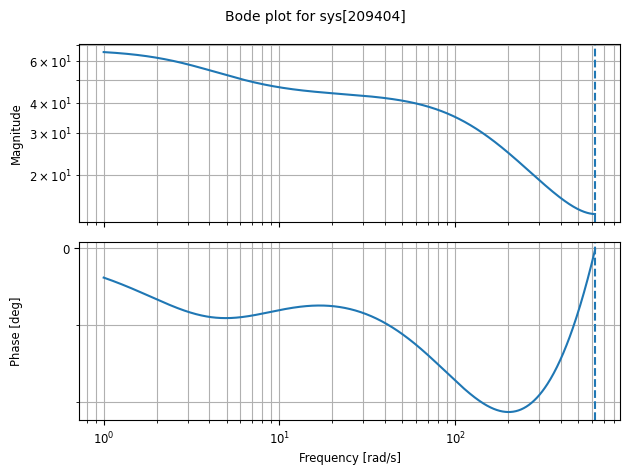

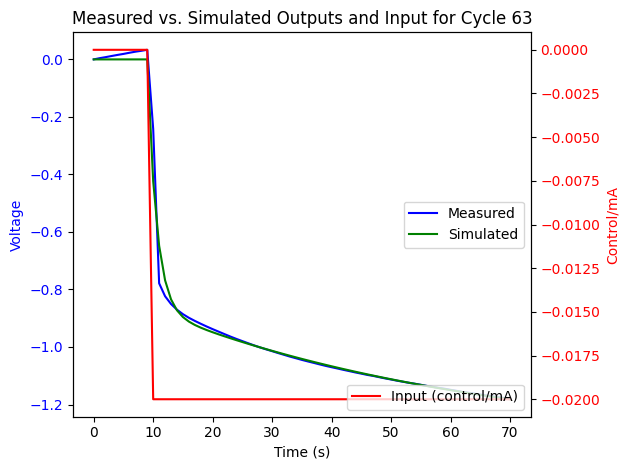

Cycle 64: G_hat_box_jenkins
<TransferFunction>: sys[209412]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 21.33 z^2 - 20.77 z
----------------------
z^2 - 1.501 z + 0.5092

dt = 0.005

Cycle 64: Zeros
[0.97384067+0.j 0.        +0.j]
Cycle 64: Poles
[0.98296819+0.j 0.51802078+0.j]


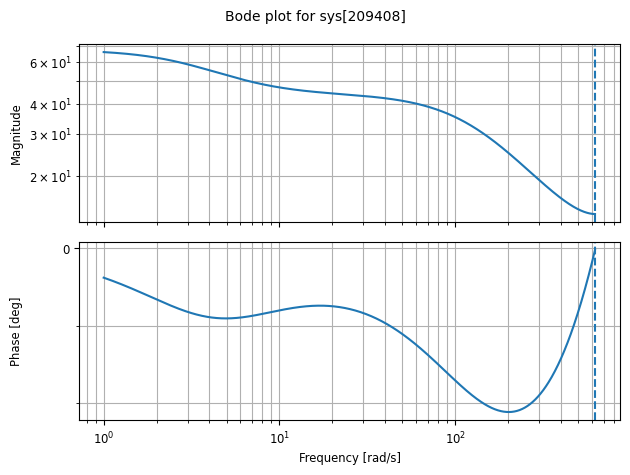

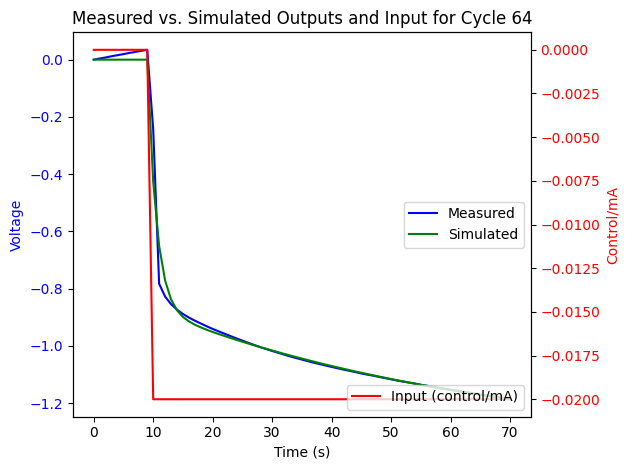

Cycle 65: G_hat_box_jenkins
<TransferFunction>: sys[209416]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 21.57 z^2 - 21.02 z
---------------------
z^2 - 1.501 z + 0.509

dt = 0.005

Cycle 65: Zeros
[0.974404+0.j 0.      +0.j]
Cycle 65: Poles
[0.98338477+0.j 0.51755195+0.j]


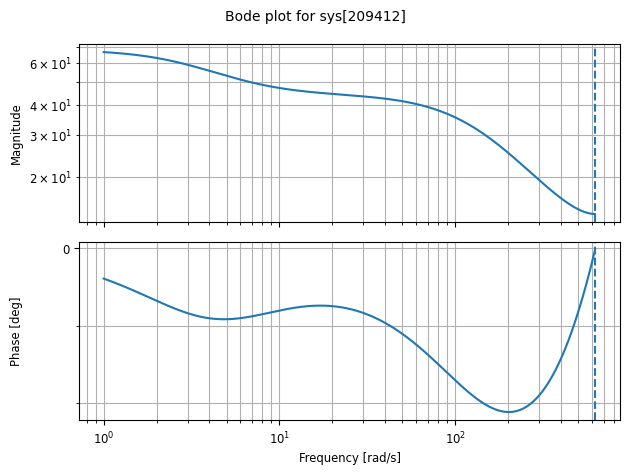

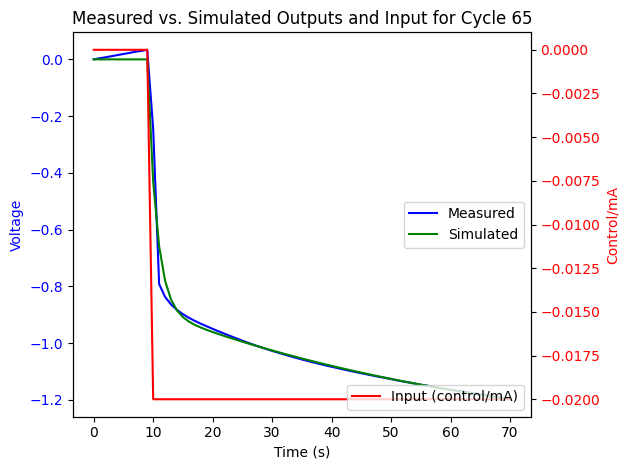

Cycle 66: G_hat_box_jenkins
<TransferFunction>: sys[209420]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 21.66 z^2 - 21.11 z
----------------------
z^2 - 1.502 z + 0.5099

dt = 0.005

Cycle 66: Zeros
[0.97472084+0.j 0.        +0.j]
Cycle 66: Poles
[0.98362145+0.j 0.5183831 +0.j]


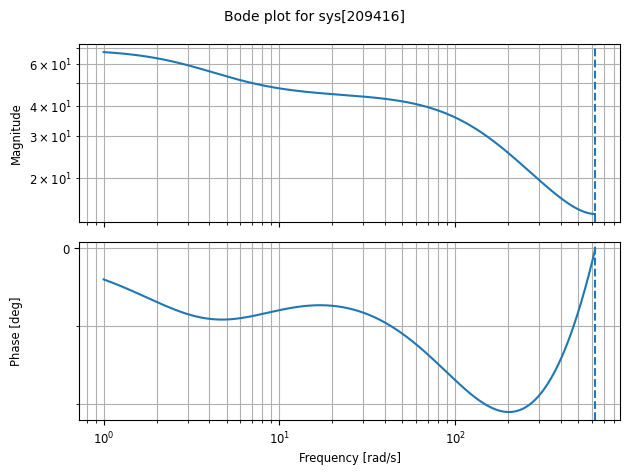

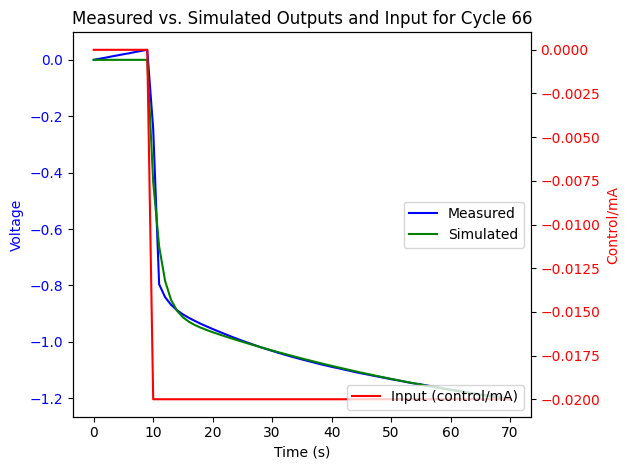

Cycle 67: G_hat_box_jenkins
<TransferFunction>: sys[209424]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 21.68 z^2 - 21.15 z
----------------------
z^2 - 1.502 z + 0.5098

dt = 0.005

Cycle 67: Zeros
[0.97562973+0.j 0.        +0.j]
Cycle 67: Poles
[0.98444766+0.j 0.51783526+0.j]


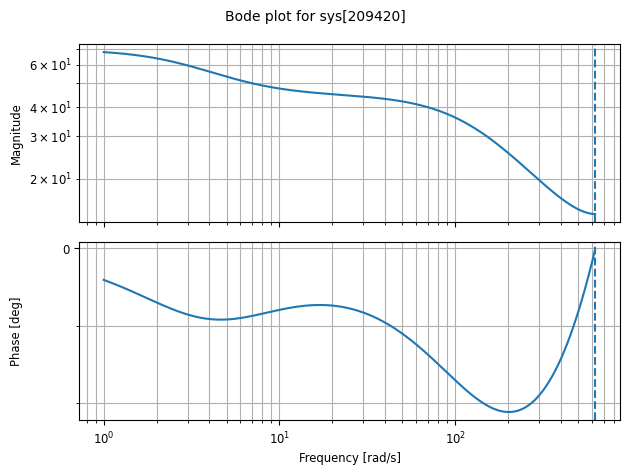

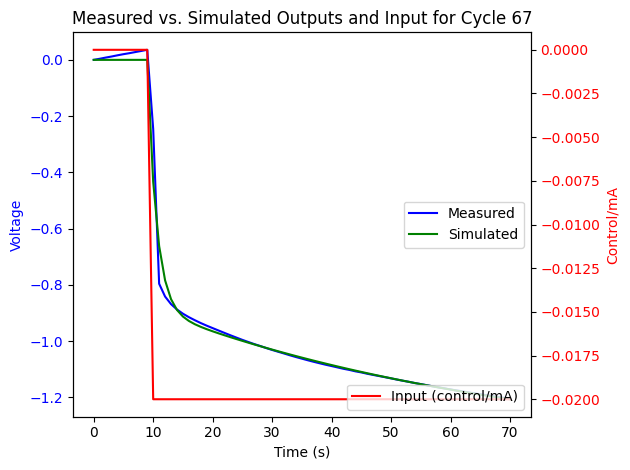

Cycle 68: G_hat_box_jenkins
<TransferFunction>: sys[209428]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


21.76 z^2 - 21.21 z
--------------------
z^2 - 1.5 z + 0.5084

dt = 0.005

Cycle 68: Zeros
[0.97464512+0.j 0.        +0.j]
Cycle 68: Poles
[0.98369018+0.j 0.51678013+0.j]


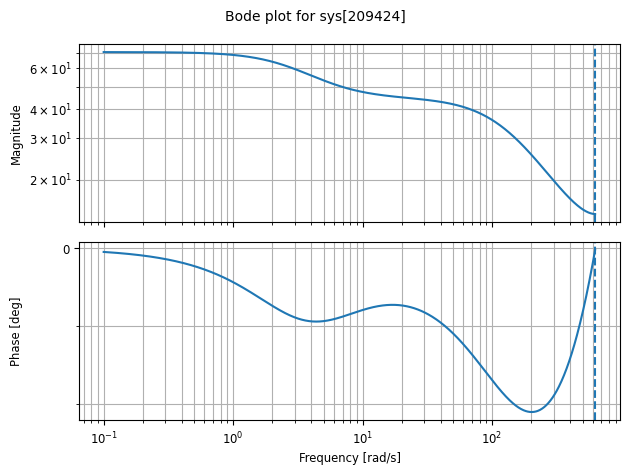

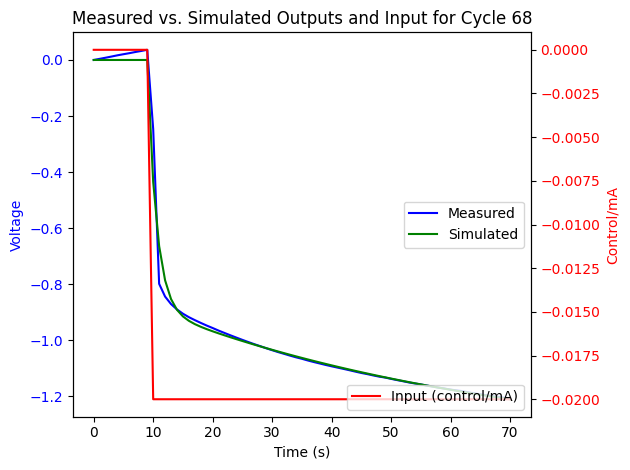

Cycle 69: G_hat_box_jenkins
<TransferFunction>: sys[209432]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  21.74 z^2 - 21.2 z
----------------------
z^2 - 1.502 z + 0.5101

dt = 0.005

Cycle 69: Zeros
[0.9751375+0.j 0.       +0.j]
Cycle 69: Poles
[0.98410348+0.j 0.51833877+0.j]


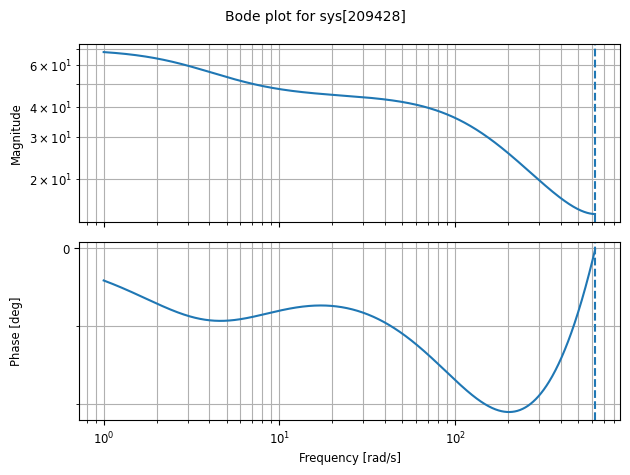

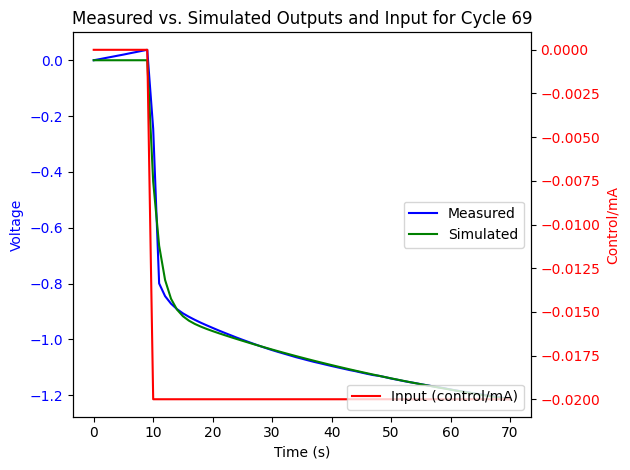

Cycle 70: G_hat_box_jenkins
<TransferFunction>: sys[209436]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  21.94 z^2 - 21.4 z
----------------------
z^2 - 1.503 z + 0.5108

dt = 0.005

Cycle 70: Zeros
[0.9753363+0.j 0.       +0.j]
Cycle 70: Poles
[0.98421257+0.j 0.51897321+0.j]


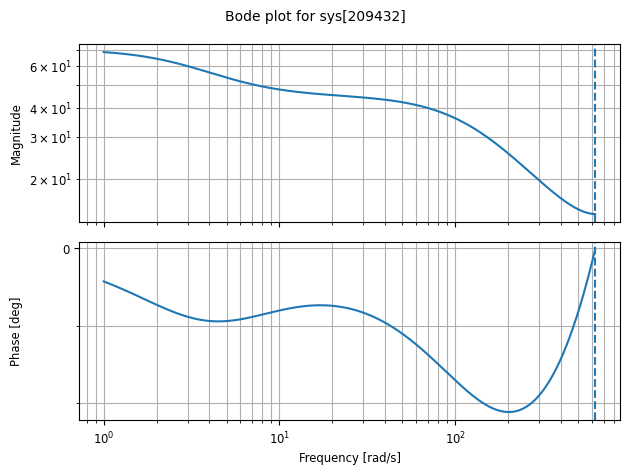

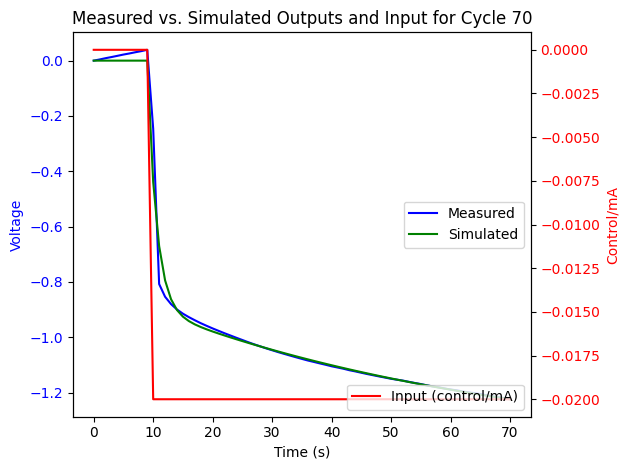

Cycle 71: G_hat_box_jenkins
<TransferFunction>: sys[209440]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 21.71 z^2 - 21.16 z
----------------------
z^2 - 1.501 z + 0.5084

dt = 0.005

Cycle 71: Zeros
[0.9747978+0.j 0.       +0.j]
Cycle 71: Poles
[0.98399214+0.j 0.51662987+0.j]


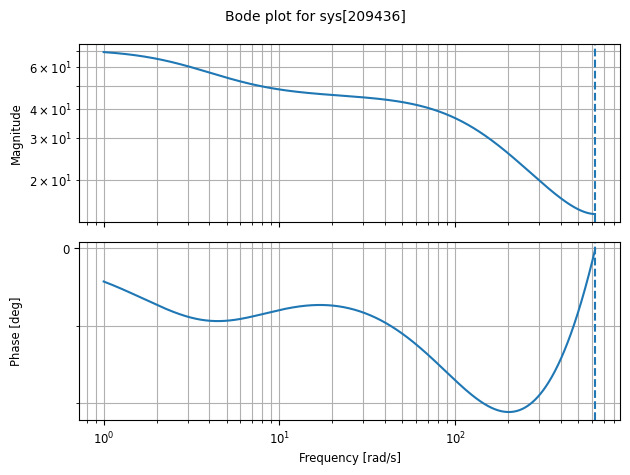

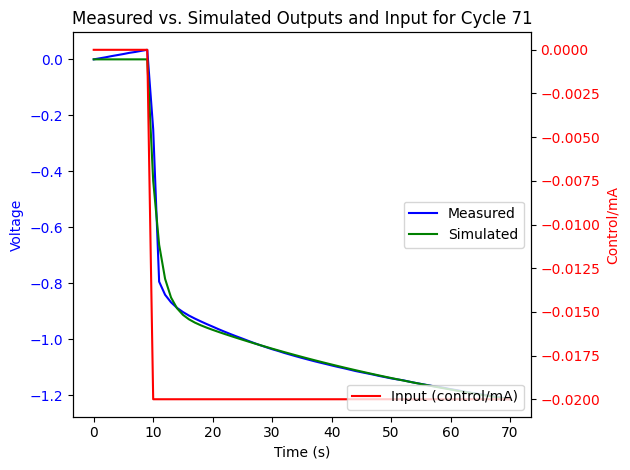

Cycle 72: G_hat_box_jenkins
<TransferFunction>: sys[209444]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 21.67 z^2 - 21.12 z
----------------------
z^2 - 1.503 z + 0.5108

dt = 0.005

Cycle 72: Zeros
[0.97479635+0.j 0.        +0.j]
Cycle 72: Poles
[0.98402088+0.j 0.51904442+0.j]


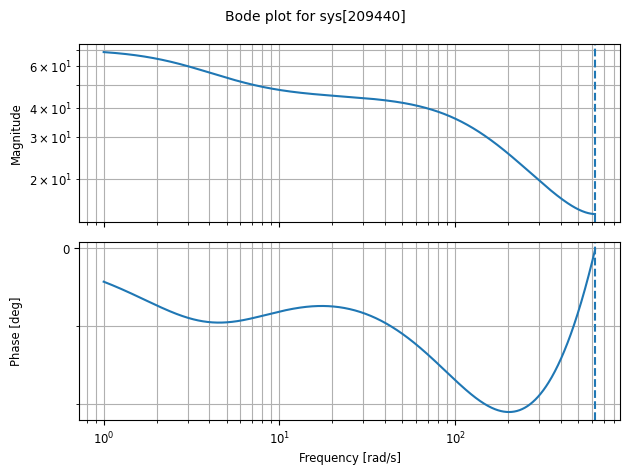

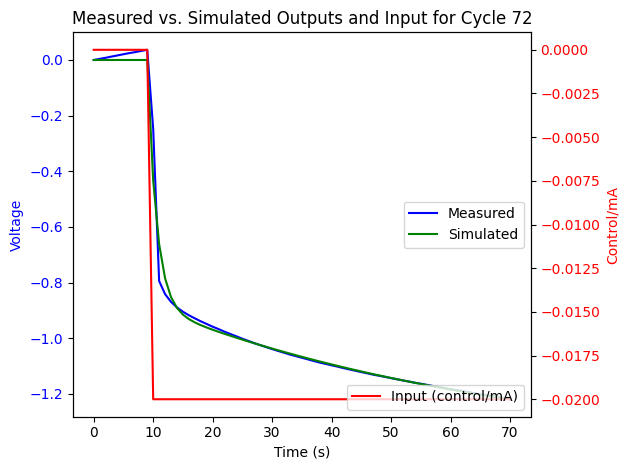

Cycle 73: G_hat_box_jenkins
<TransferFunction>: sys[209448]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 21.68 z^2 - 21.14 z
----------------------
z^2 - 1.504 z + 0.5116

dt = 0.005

Cycle 73: Zeros
[0.97511918+0.j 0.        +0.j]
Cycle 73: Poles
[0.98432719+0.j 0.51970328+0.j]


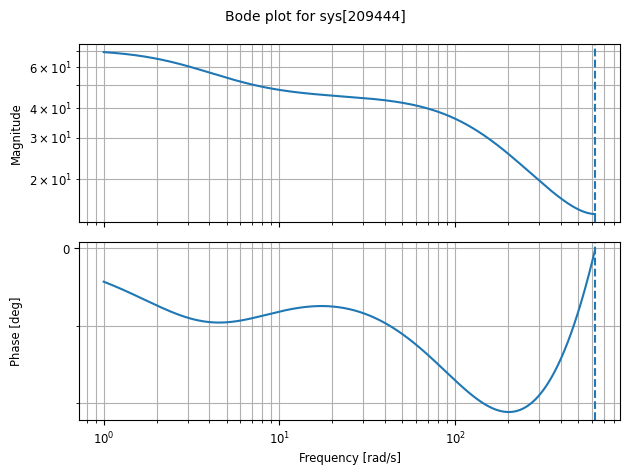

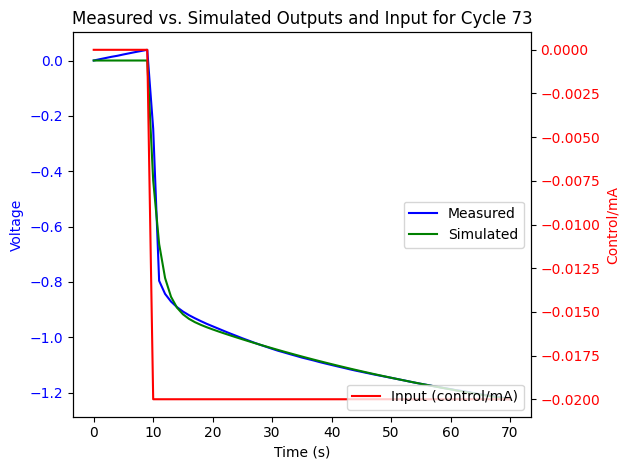

Cycle 74: G_hat_box_jenkins
<TransferFunction>: sys[209452]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 21.81 z^2 - 21.27 z
----------------------
z^2 - 1.504 z + 0.5118

dt = 0.005

Cycle 74: Zeros
[0.97509438+0.j 0.        +0.j]
Cycle 74: Poles
[0.98430962+0.j 0.51994695+0.j]


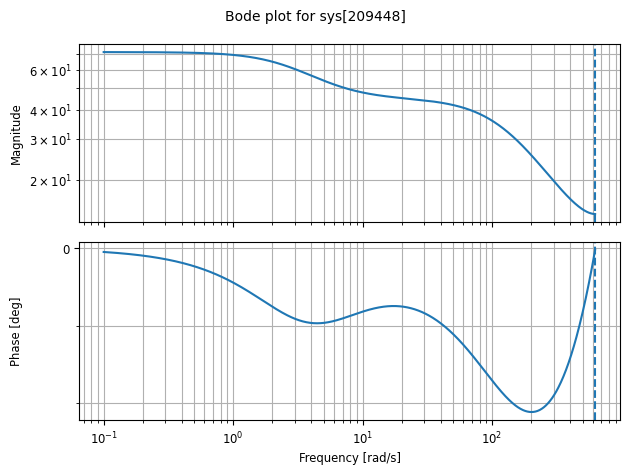

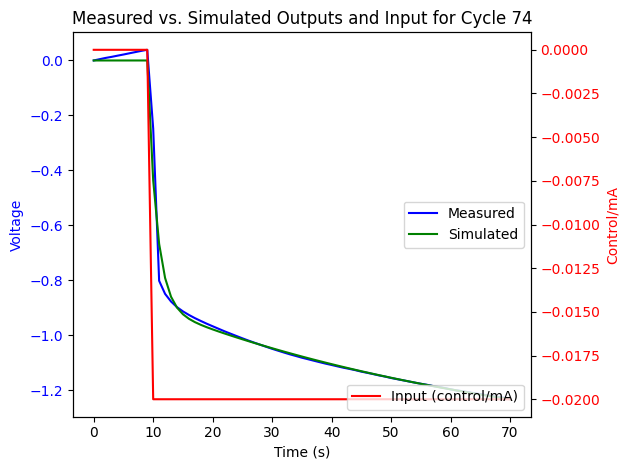

Cycle 75: G_hat_box_jenkins
<TransferFunction>: sys[209456]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 21.93 z^2 - 21.37 z
----------------------
z^2 - 1.506 z + 0.5131

dt = 0.005

Cycle 75: Zeros
[0.97486143+0.j 0.        +0.j]
Cycle 75: Poles
[0.98405793+0.j 0.52145542+0.j]


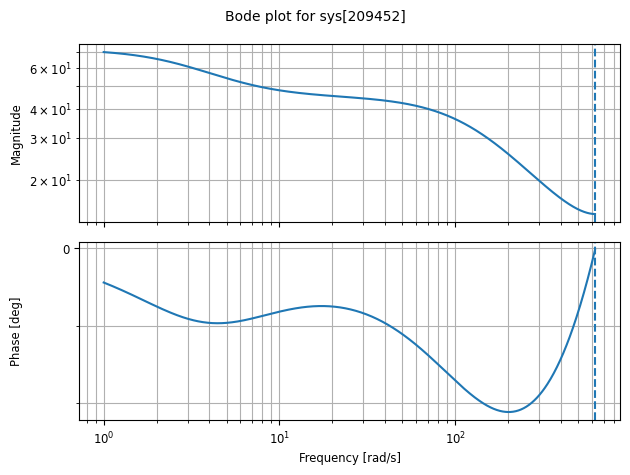

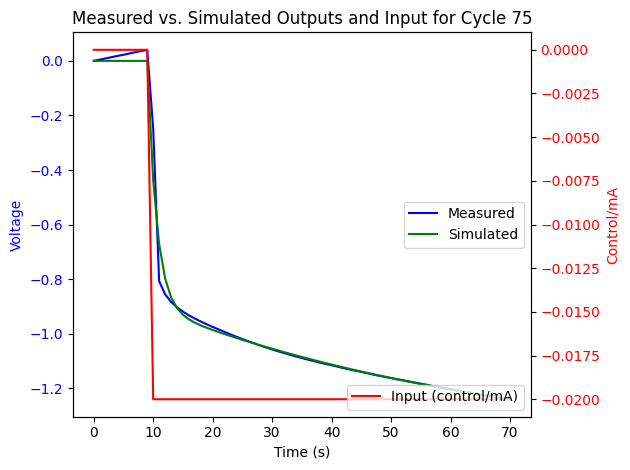

Cycle 76: G_hat_box_jenkins
<TransferFunction>: sys[209460]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 22.12 z^2 - 21.55 z
----------------------
z^2 - 1.503 z + 0.5114

dt = 0.005

Cycle 76: Zeros
[0.9742097+0.j 0.       +0.j]
Cycle 76: Poles
[0.98342434+0.j 0.52005929+0.j]


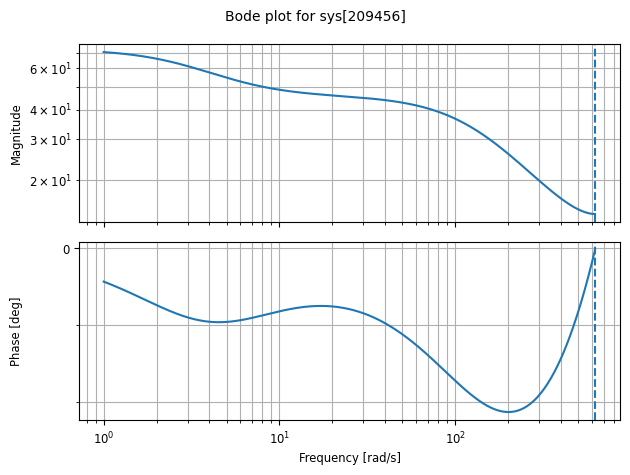

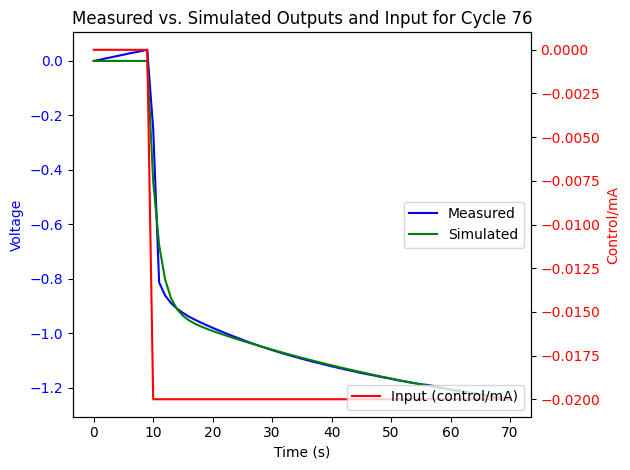

Cycle 77: G_hat_box_jenkins
<TransferFunction>: sys[209464]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 22.19 z^2 - 21.67 z
----------------------
z^2 - 1.506 z + 0.5134

dt = 0.005

Cycle 77: Zeros
[0.97642752+0.j 0.        +0.j]
Cycle 77: Poles
[0.98529531+0.j 0.52105332+0.j]


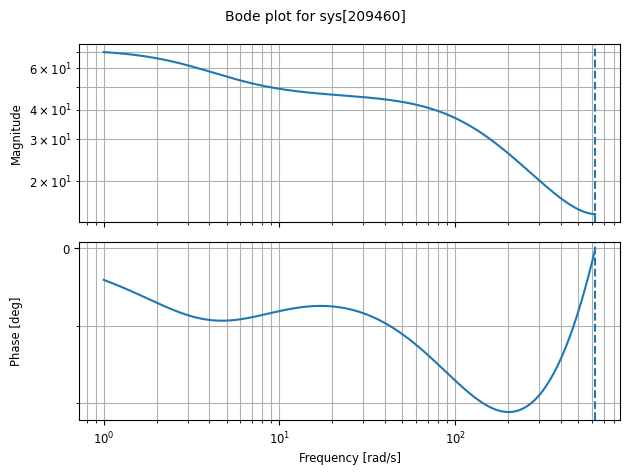

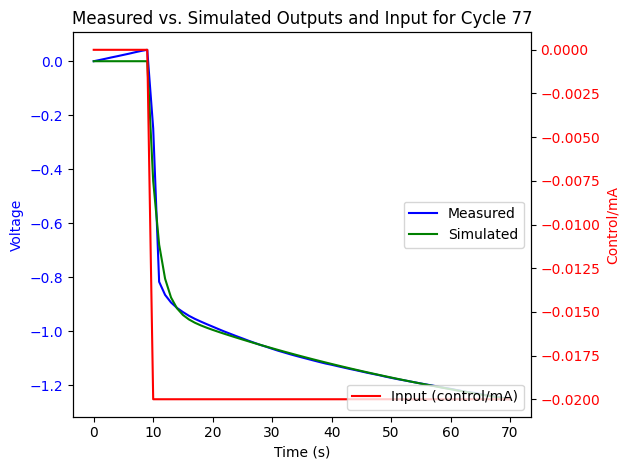

Cycle 78: G_hat_box_jenkins
<TransferFunction>: sys[209468]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 22.31 z^2 - 21.78 z
----------------------
z^2 - 1.508 z + 0.5152

dt = 0.005

Cycle 78: Zeros
[0.97596728+0.j 0.        +0.j]
Cycle 78: Poles
[0.98485266+0.j 0.52310229+0.j]


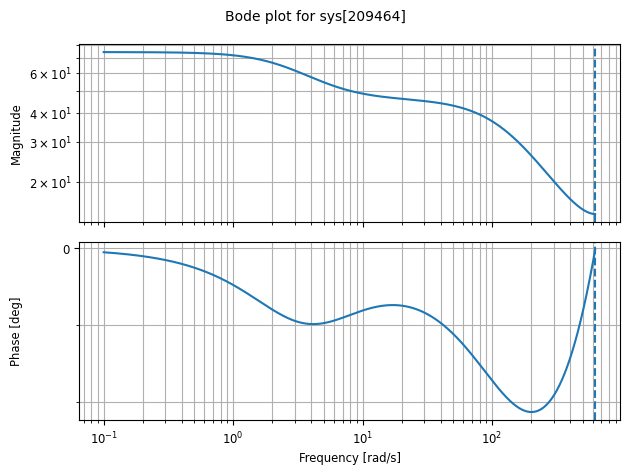

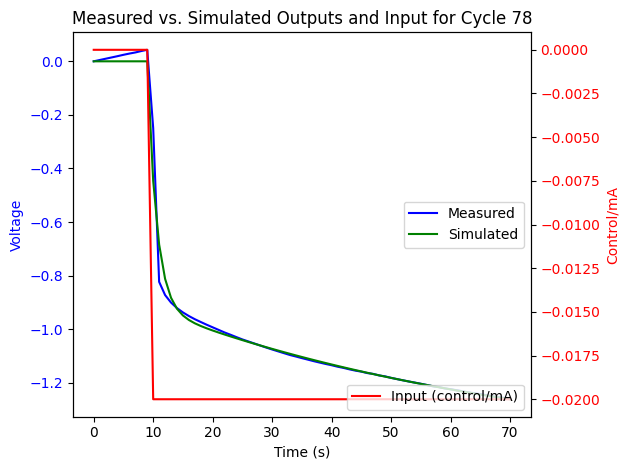

Cycle 79: G_hat_box_jenkins
<TransferFunction>: sys[209472]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 22.38 z^2 - 21.84 z
----------------------
z^2 - 1.506 z + 0.5137

dt = 0.005

Cycle 79: Zeros
[0.97568086+0.j 0.        +0.j]
Cycle 79: Poles
[0.9847854 +0.j 0.52164717+0.j]


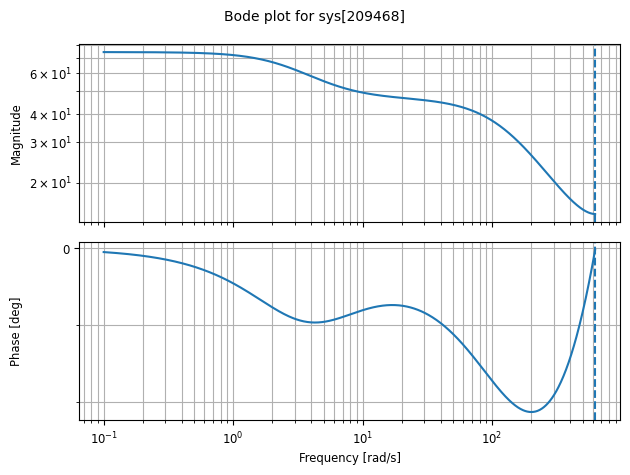

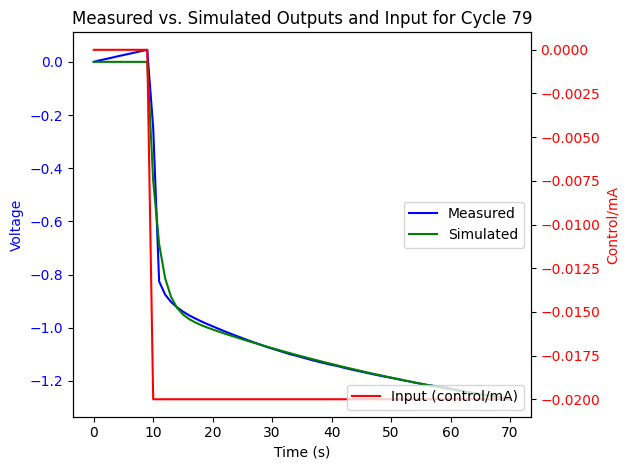

Cycle 80: G_hat_box_jenkins
<TransferFunction>: sys[209476]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  22.5 z^2 - 21.94 z
----------------------
z^2 - 1.505 z + 0.5121

dt = 0.005

Cycle 80: Zeros
[0.97517387+0.j 0.        +0.j]
Cycle 80: Poles
[0.9843694 +0.j 0.52024479+0.j]


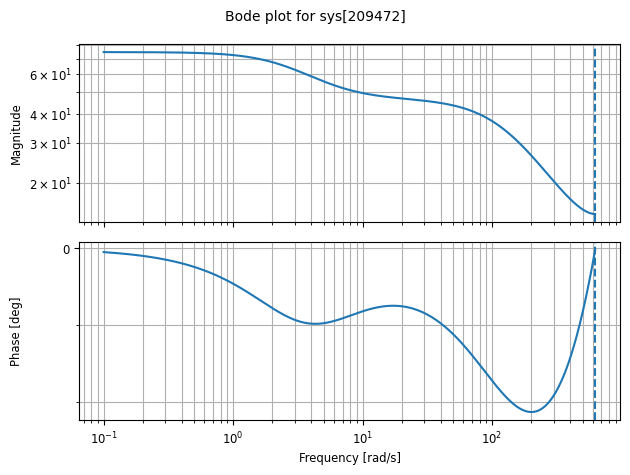

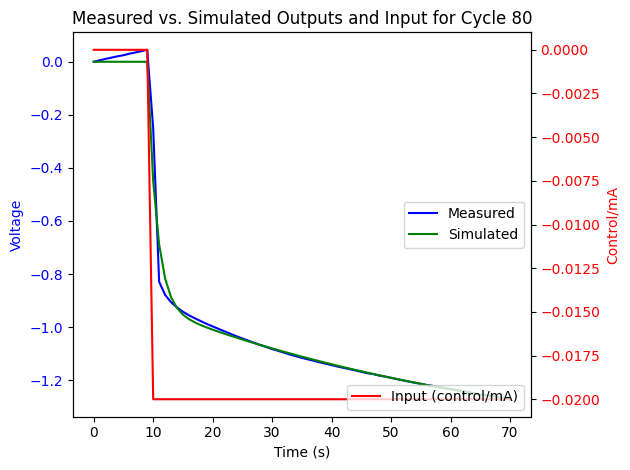

Cycle 81: G_hat_box_jenkins
<TransferFunction>: sys[209480]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 22.48 z^2 - 21.94 z
----------------------
z^2 - 1.505 z + 0.5116

dt = 0.005

Cycle 81: Zeros
[0.97617636+0.j 0.        +0.j]
Cycle 81: Poles
[0.98532035+0.j 0.51919127+0.j]


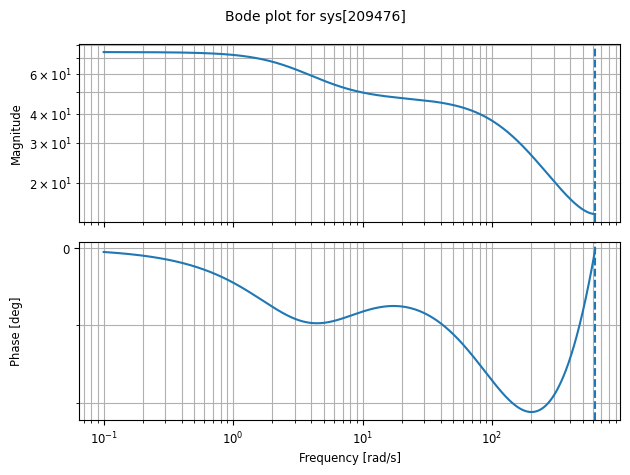

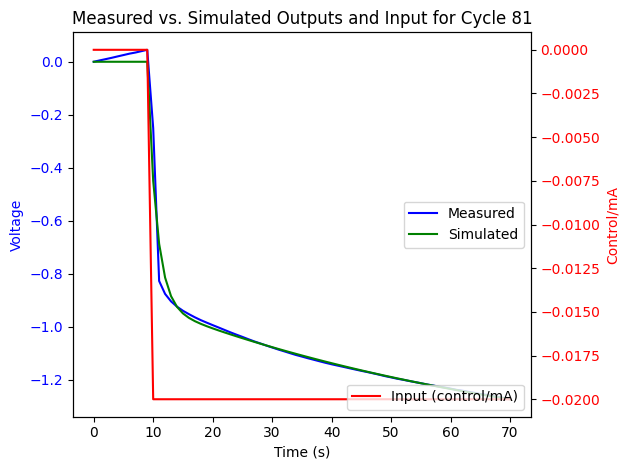

Cycle 82: G_hat_box_jenkins
<TransferFunction>: sys[209484]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 22.56 z^2 - 22.02 z
----------------------
z^2 - 1.506 z + 0.5132

dt = 0.005

Cycle 82: Zeros
[0.97632674+0.j 0.        +0.j]
Cycle 82: Poles
[0.9853737 +0.j 0.52079374+0.j]


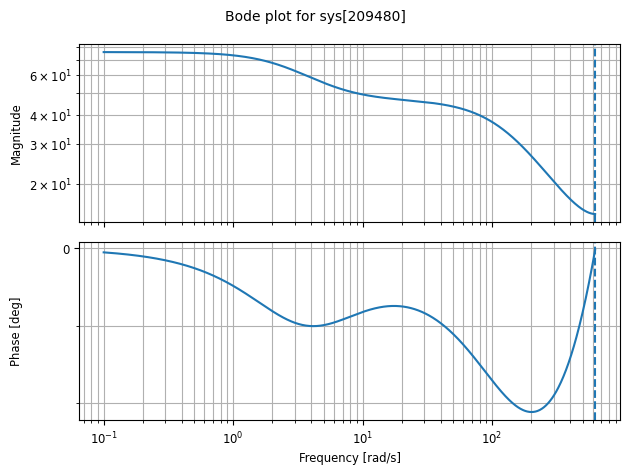

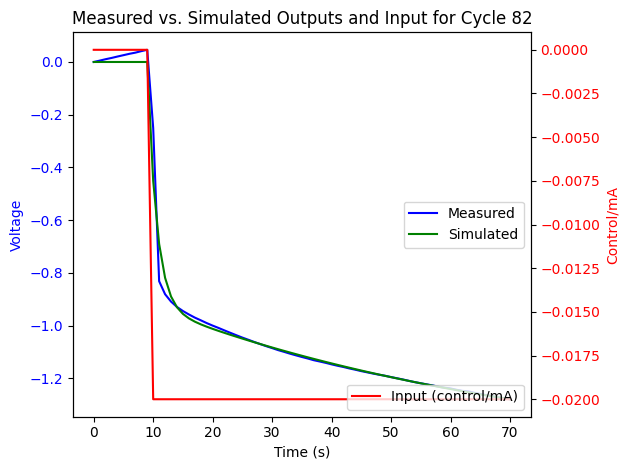

Cycle 83: G_hat_box_jenkins
<TransferFunction>: sys[209488]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 22.69 z^2 - 22.17 z
----------------------
z^2 - 1.507 z + 0.5143

dt = 0.005

Cycle 83: Zeros
[0.97685017+0.j 0.        +0.j]
Cycle 83: Poles
[0.98580301+0.j 0.52169389+0.j]


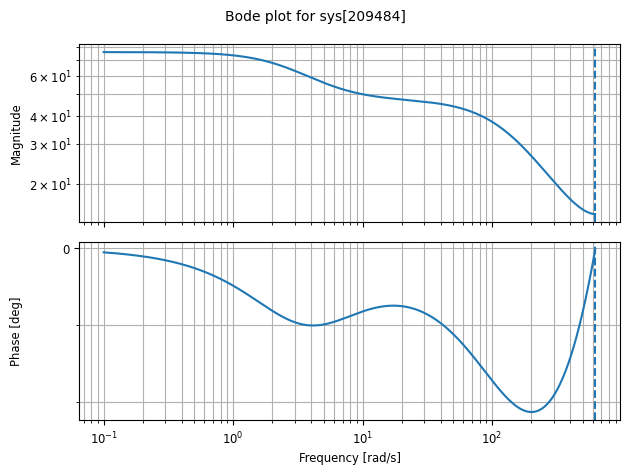

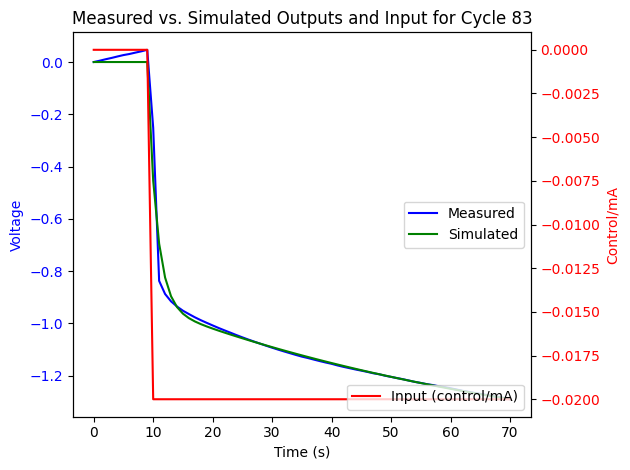

Cycle 84: G_hat_box_jenkins
<TransferFunction>: sys[209492]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 22.79 z^2 - 22.27 z
---------------------
z^2 - 1.508 z + 0.515

dt = 0.005

Cycle 84: Zeros
[0.9771417+0.j 0.       +0.j]
Cycle 84: Poles
[0.98608521+0.j 0.52227853+0.j]


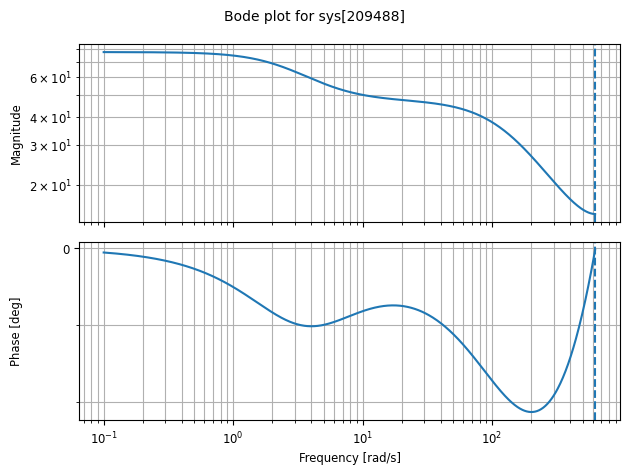

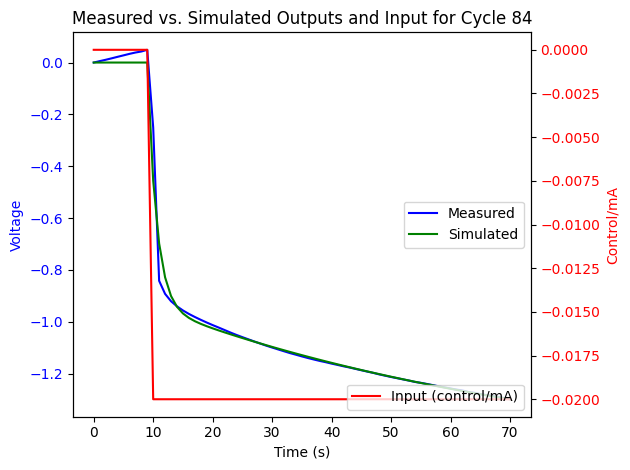

Cycle 85: G_hat_box_jenkins
<TransferFunction>: sys[209496]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 22.94 z^2 - 22.41 z
----------------------
z^2 - 1.507 z + 0.5142

dt = 0.005

Cycle 85: Zeros
[0.97685653+0.j 0.        +0.j]
Cycle 85: Poles
[0.98588751+0.j 0.52161109+0.j]


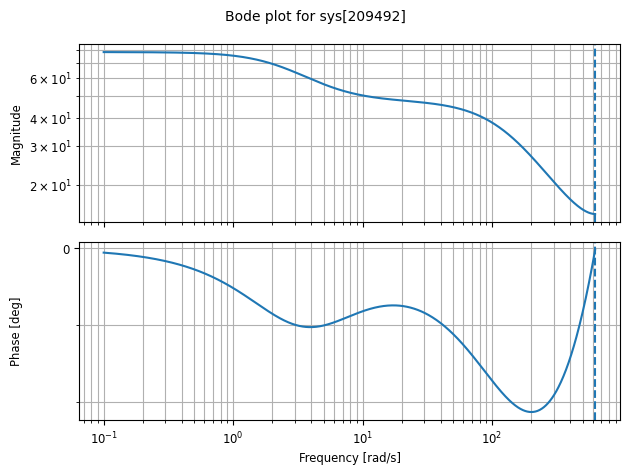

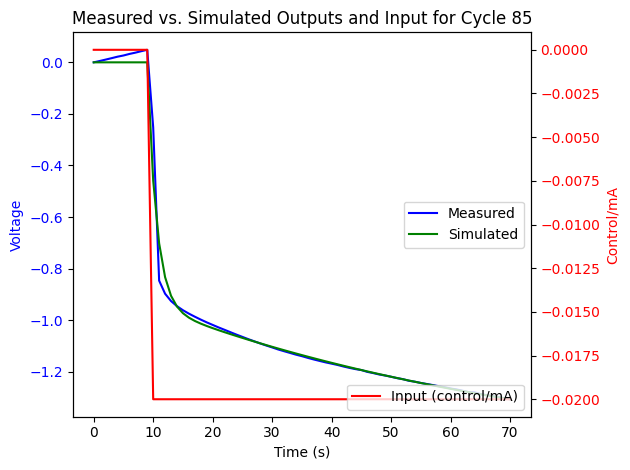

Cycle 86: G_hat_box_jenkins
<TransferFunction>: sys[209500]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 22.96 z^2 - 22.43 z
----------------------
z^2 - 1.507 z + 0.5142

dt = 0.005

Cycle 86: Zeros
[0.97690358+0.j 0.        +0.j]
Cycle 86: Poles
[0.98598011+0.j 0.52149785+0.j]


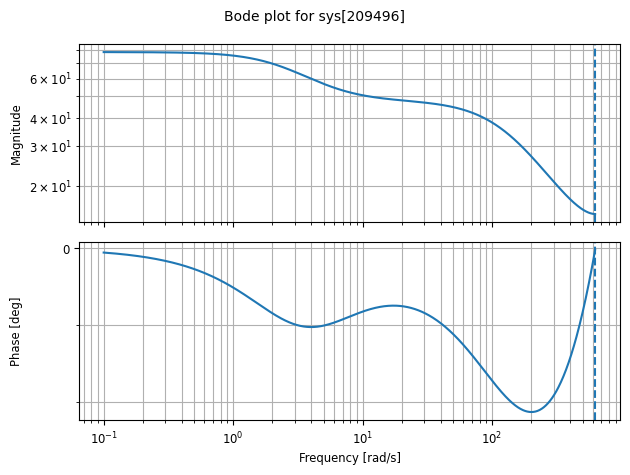

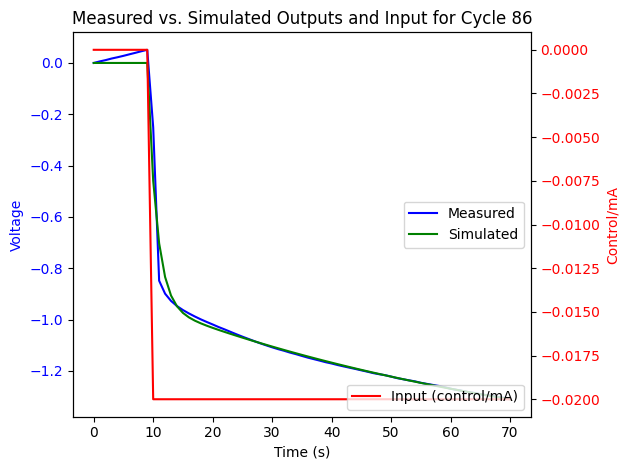

Cycle 87: G_hat_box_jenkins
<TransferFunction>: sys[209504]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 23.15 z^2 - 22.61 z
----------------------
z^2 - 1.507 z + 0.5139

dt = 0.005

Cycle 87: Zeros
[0.9767266+0.j 0.       +0.j]
Cycle 87: Poles
[0.9857814 +0.j 0.52133115+0.j]


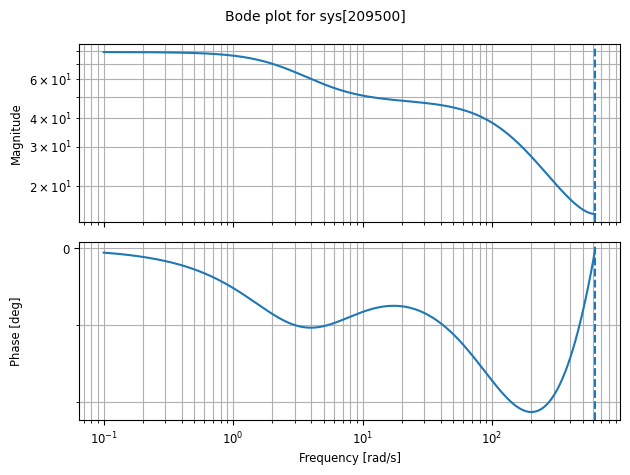

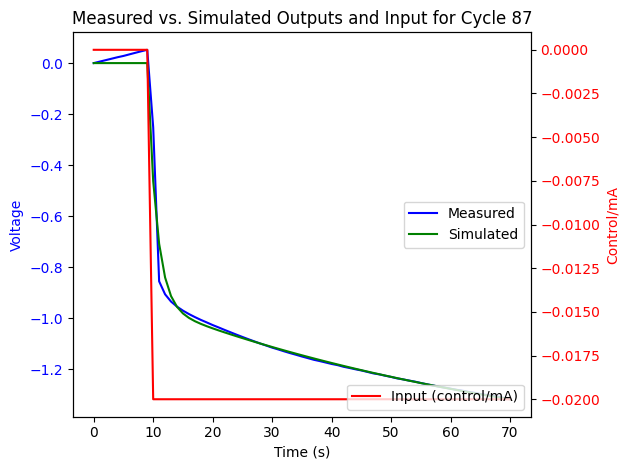

Cycle 88: G_hat_box_jenkins
<TransferFunction>: sys[209508]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  23.3 z^2 - 22.76 z
----------------------
z^2 - 1.507 z + 0.5138

dt = 0.005

Cycle 88: Zeros
[0.97685926+0.j 0.        +0.j]
Cycle 88: Poles
[0.98595153+0.j 0.52114288+0.j]


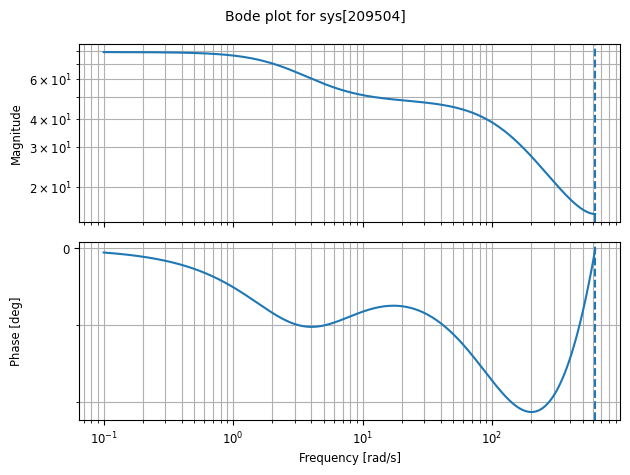

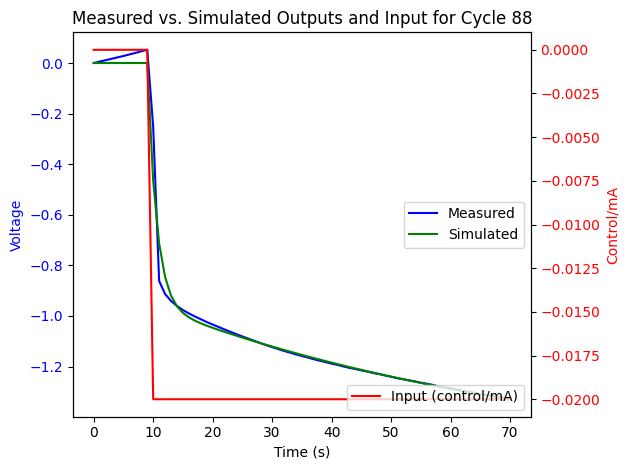

Cycle 89: G_hat_box_jenkins
<TransferFunction>: sys[209512]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 23.37 z^2 - 22.85 z
----------------------
z^2 - 1.509 z + 0.5157

dt = 0.005

Cycle 89: Zeros
[0.97785562+0.j 0.        +0.j]
Cycle 89: Poles
[0.98672925+0.j 0.52265594+0.j]


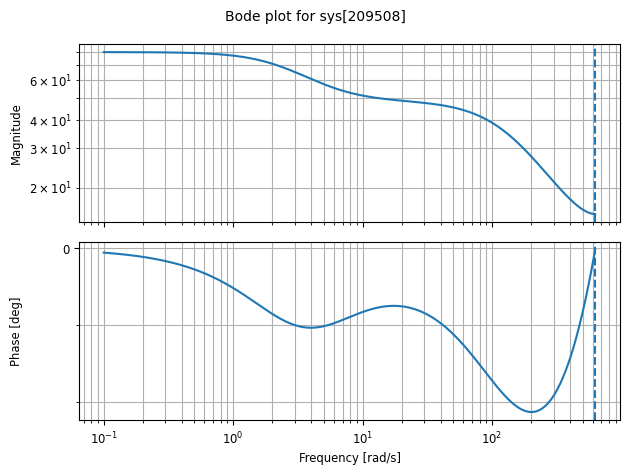

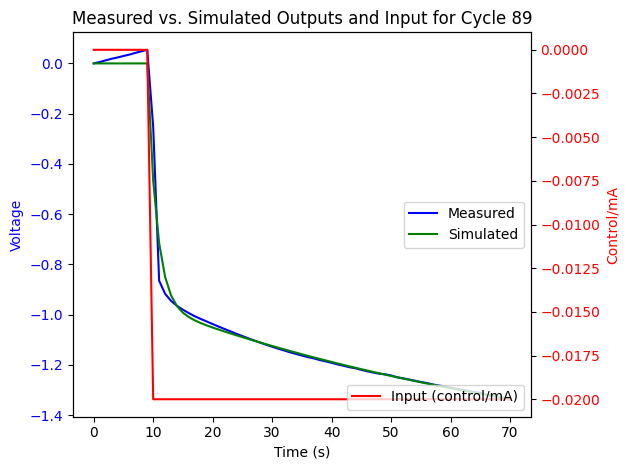

Cycle 90: G_hat_box_jenkins
<TransferFunction>: sys[209516]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 23.48 z^2 - 22.95 z
----------------------
z^2 - 1.509 z + 0.5158

dt = 0.005

Cycle 90: Zeros
[0.97730986+0.j 0.        +0.j]
Cycle 90: Poles
[0.98631968+0.j 0.52297483+0.j]


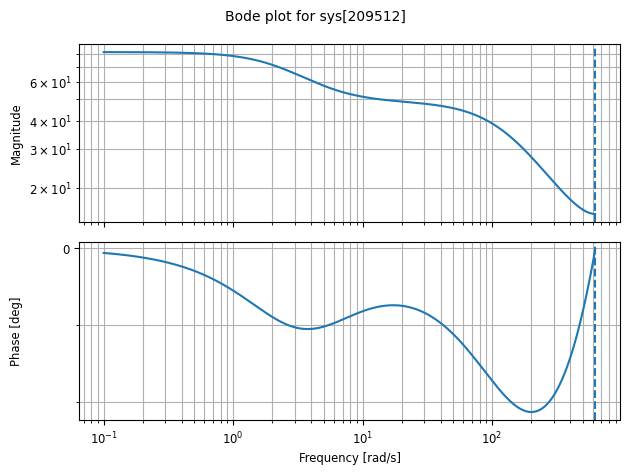

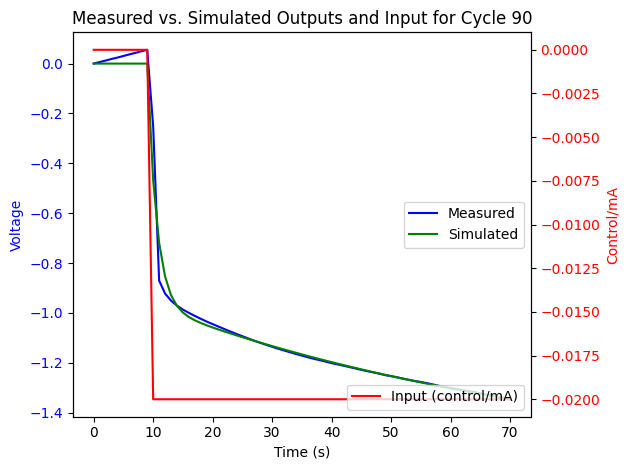

Cycle 91: G_hat_box_jenkins
<TransferFunction>: sys[209520]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 23.51 z^2 - 22.99 z
----------------------
z^2 - 1.512 z + 0.5178

dt = 0.005

Cycle 91: Zeros
[0.97792575+0.j 0.        +0.j]
Cycle 91: Poles
[0.98686118+0.j 0.52471205+0.j]


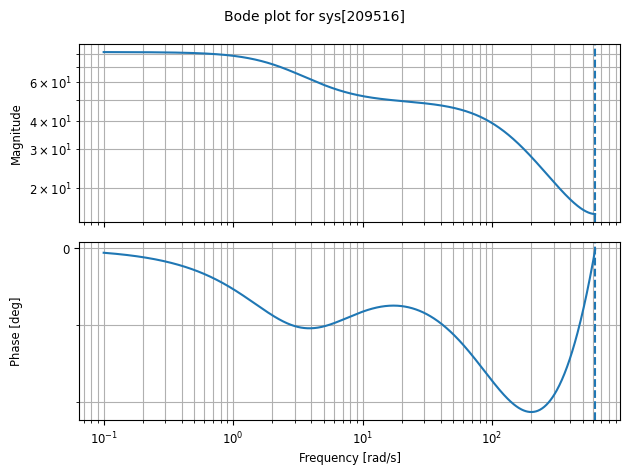

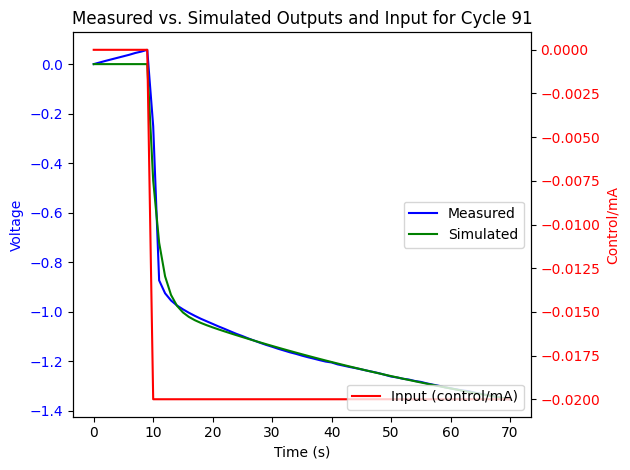

Cycle 92: G_hat_box_jenkins
<TransferFunction>: sys[209524]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 23.72 z^2 - 23.22 z
----------------------
z^2 - 1.512 z + 0.5176

dt = 0.005

Cycle 92: Zeros
[0.97896059+0.j 0.        +0.j]
Cycle 92: Poles
[0.98768808+0.j 0.52403398+0.j]


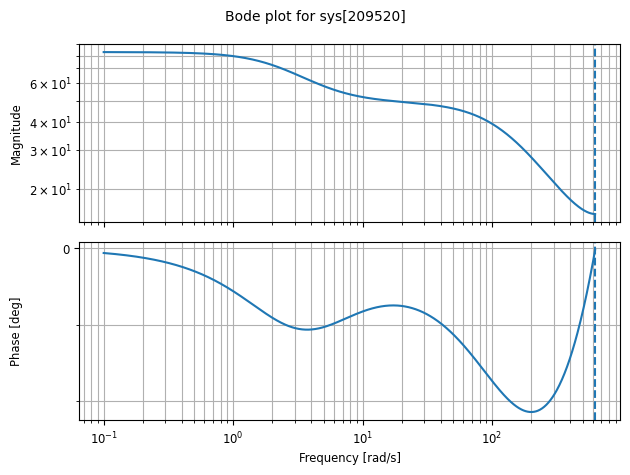

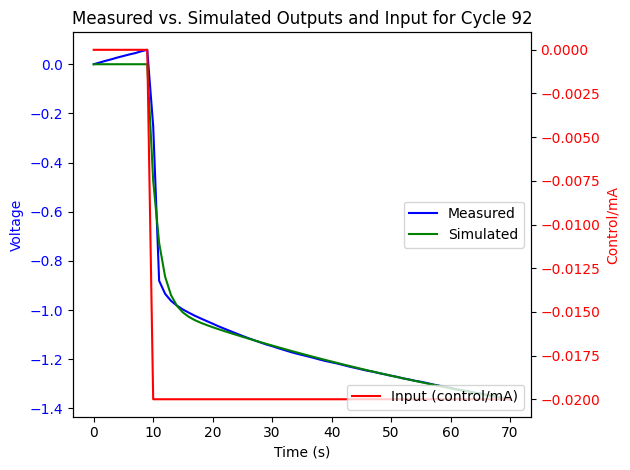

Cycle 93: G_hat_box_jenkins
<TransferFunction>: sys[209528]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 23.84 z^2 - 23.33 z
----------------------
z^2 - 1.512 z + 0.5183

dt = 0.005

Cycle 93: Zeros
[0.97874575+0.j 0.        +0.j]
Cycle 93: Poles
[0.98746366+0.j 0.52486908+0.j]


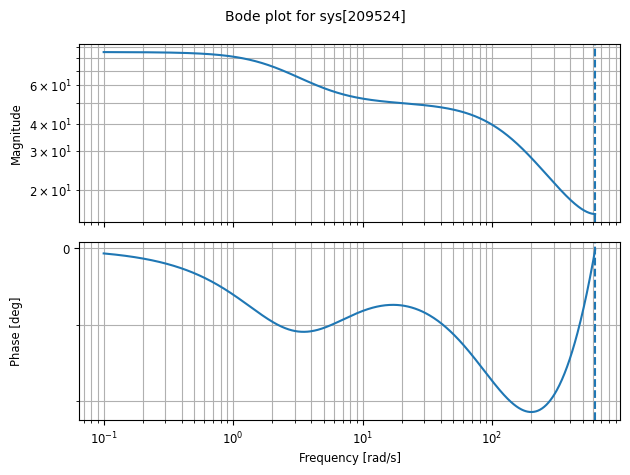

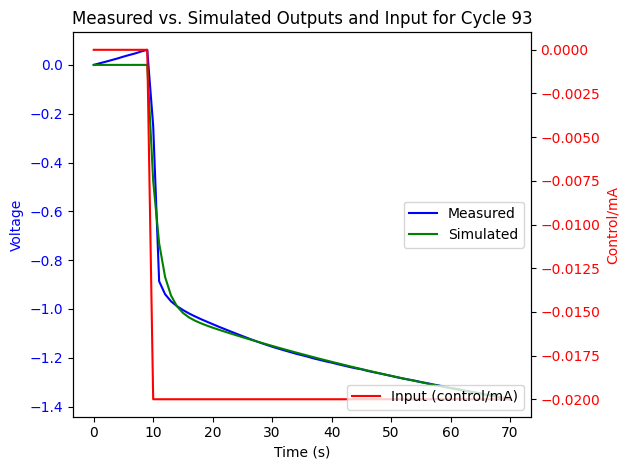

Cycle 94: G_hat_box_jenkins
<TransferFunction>: sys[209532]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 23.99 z^2 - 23.47 z
---------------------
z^2 - 1.511 z + 0.517

dt = 0.005

Cycle 94: Zeros
[0.97823248+0.j 0.        +0.j]
Cycle 94: Poles
[0.98713264+0.j 0.52375643+0.j]


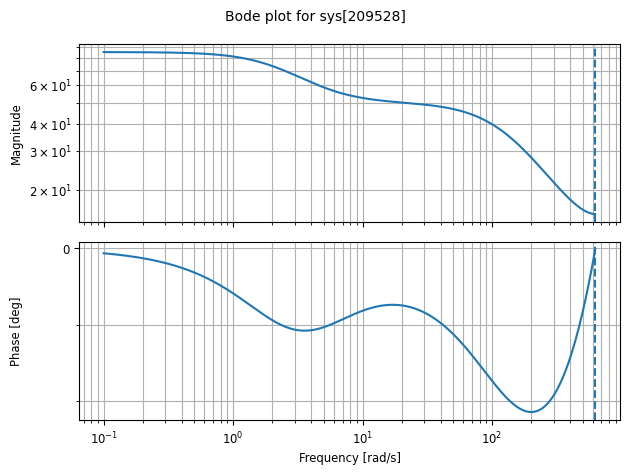

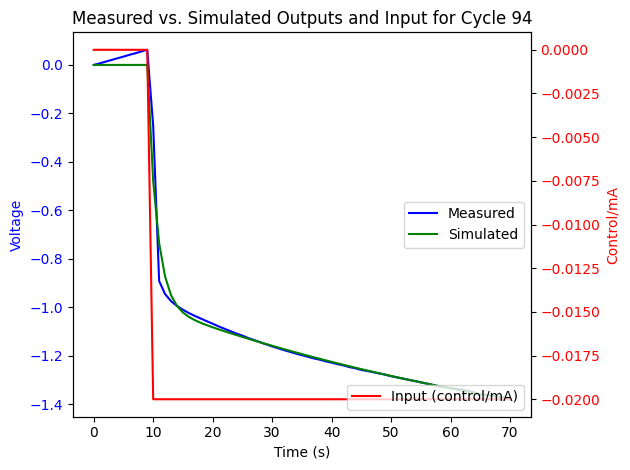

Cycle 95: G_hat_box_jenkins
<TransferFunction>: sys[209536]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 24.11 z^2 - 23.59 z
----------------------
z^2 - 1.512 z + 0.5182

dt = 0.005

Cycle 95: Zeros
[0.97859476+0.j 0.        +0.j]
Cycle 95: Poles
[0.98730597+0.j 0.52491241+0.j]


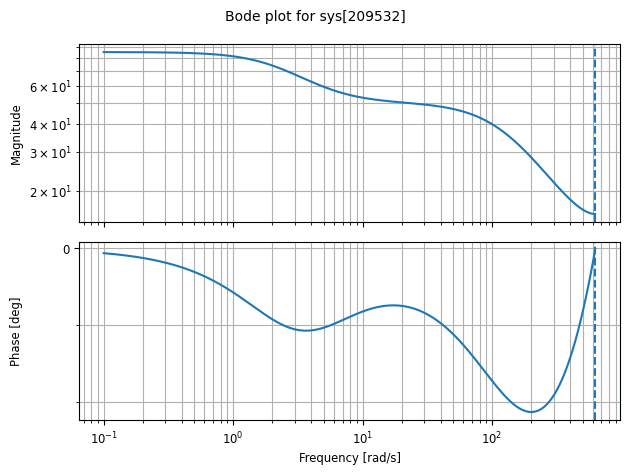

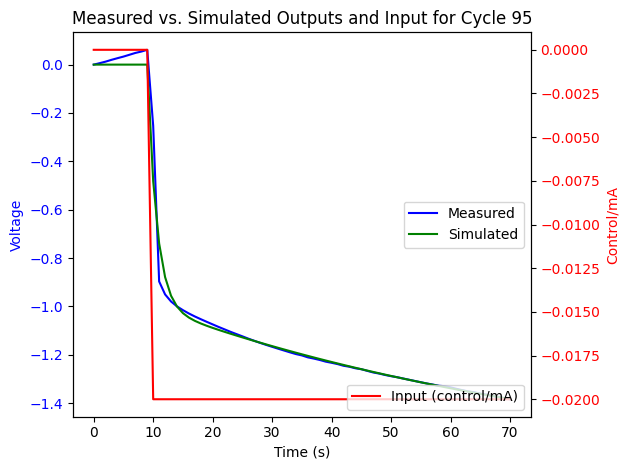

Cycle 96: G_hat_box_jenkins
<TransferFunction>: sys[209540]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 24.16 z^2 - 23.69 z
----------------------
z^2 - 1.514 z + 0.5197

dt = 0.005

Cycle 96: Zeros
[0.98037227+0.j 0.        +0.j]
Cycle 96: Poles
[0.98884699+0.j 0.52556034+0.j]


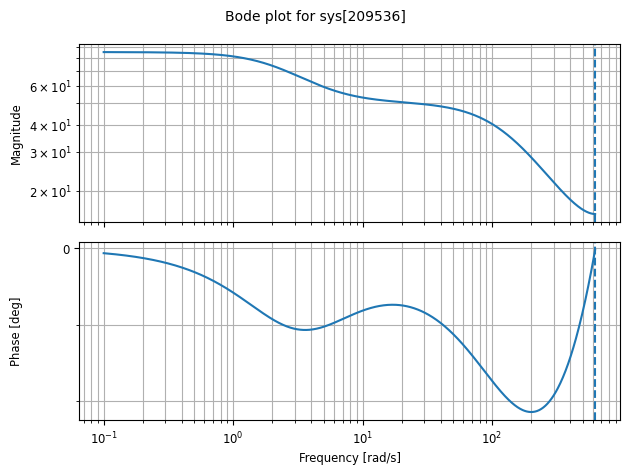

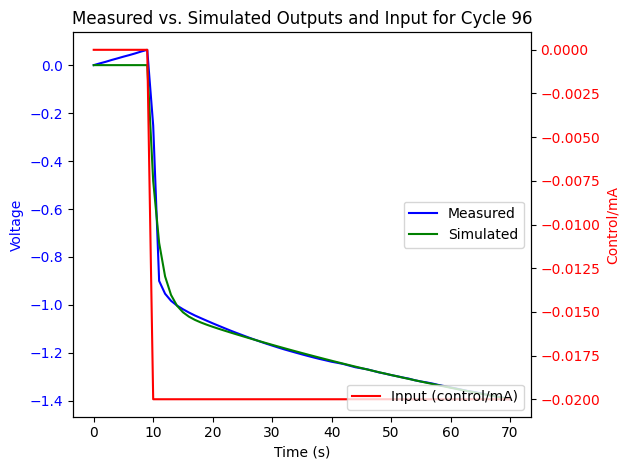

Cycle 97: G_hat_box_jenkins
<TransferFunction>: sys[209544]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 24.22 z^2 - 23.74 z
----------------------
z^2 - 1.514 z + 0.5196

dt = 0.005

Cycle 97: Zeros
[0.98000101+0.j 0.        +0.j]
Cycle 97: Poles
[0.98860631+0.j 0.52554767+0.j]


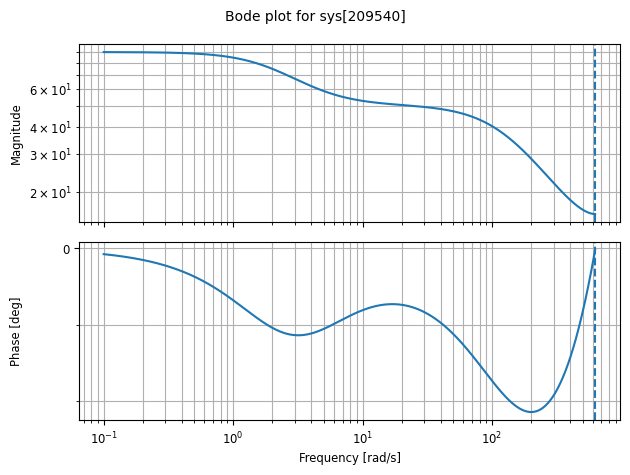

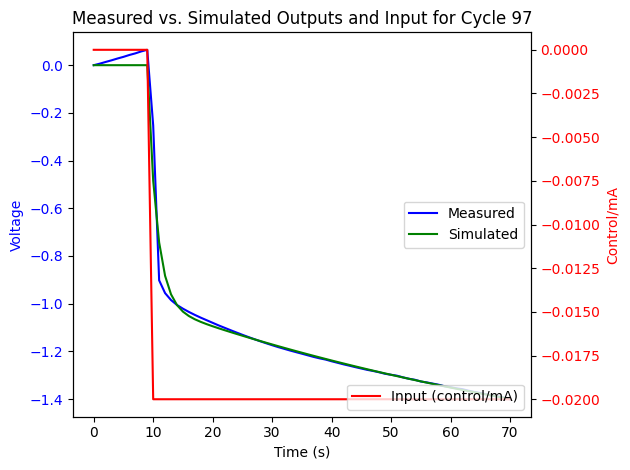

Cycle 98: G_hat_box_jenkins
<TransferFunction>: sys[209548]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  24.29 z^2 - 23.8 z
----------------------
z^2 - 1.515 z + 0.5201

dt = 0.005

Cycle 98: Zeros
[0.97991026+0.j 0.        +0.j]
Cycle 98: Poles
[0.98855023+0.j 0.52617449+0.j]


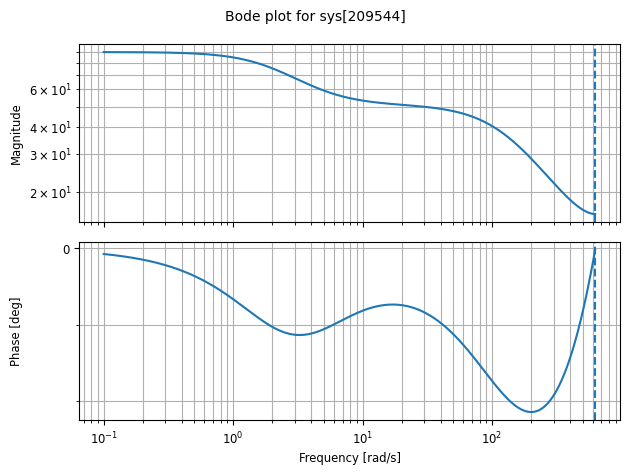

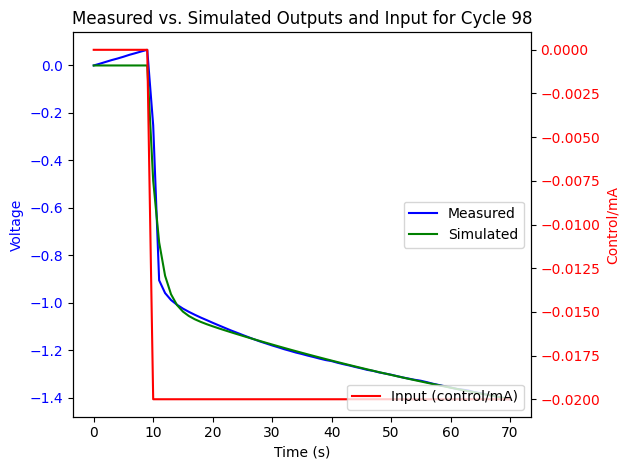

Cycle 99: G_hat_box_jenkins
<TransferFunction>: sys[209552]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 24.44 z^2 - 23.94 z
----------------------
z^2 - 1.513 z + 0.5186

dt = 0.005

Cycle 99: Zeros
[0.97961141+0.j 0.        +0.j]
Cycle 99: Poles
[0.98827288+0.j 0.52471013+0.j]


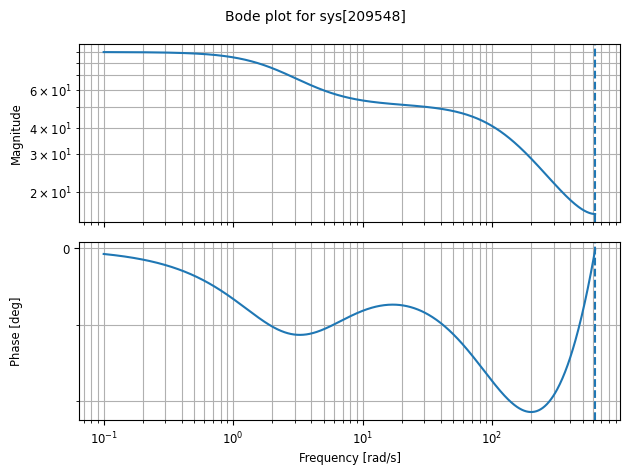

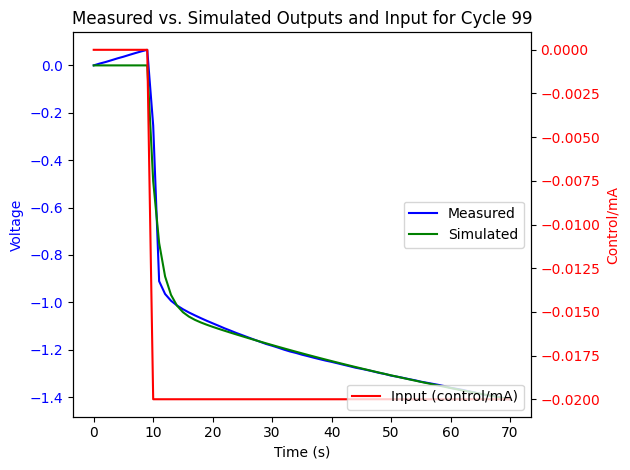

Cycle 100: G_hat_box_jenkins
<TransferFunction>: sys[209556]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 24.53 z^2 - 24.04 z
----------------------
z^2 - 1.515 z + 0.5202

dt = 0.005

Cycle 100: Zeros
[0.9802268+0.j 0.       +0.j]
Cycle 100: Poles
[0.98882221+0.j 0.52611573+0.j]


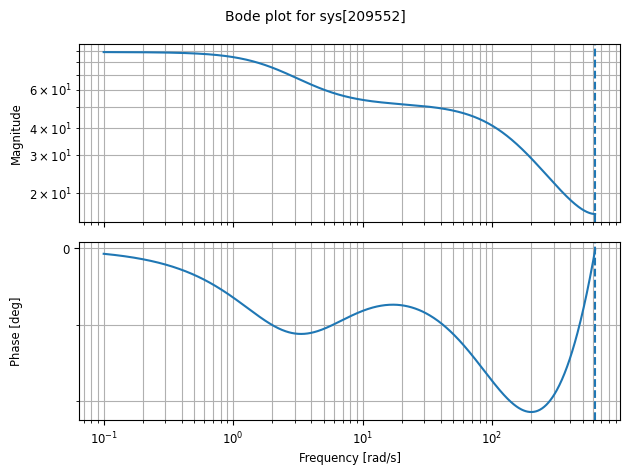

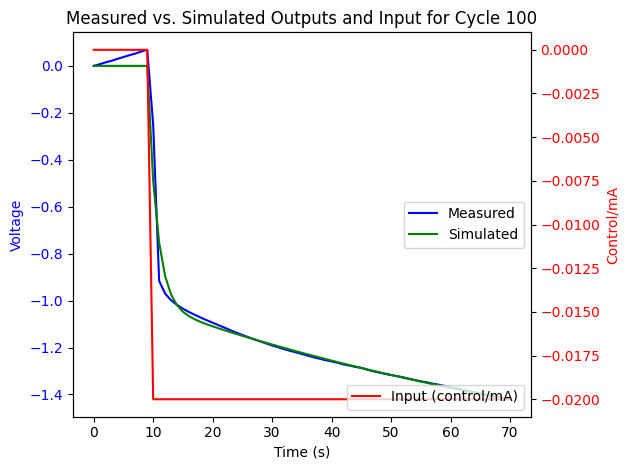

Cycle 101: G_hat_box_jenkins
<TransferFunction>: sys[209560]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  24.6 z^2 - 24.11 z
----------------------
z^2 - 1.515 z + 0.5204

dt = 0.005

Cycle 101: Zeros
[0.980135+0.j 0.      +0.j]
Cycle 101: Poles
[0.9887499 +0.j 0.52627458+0.j]


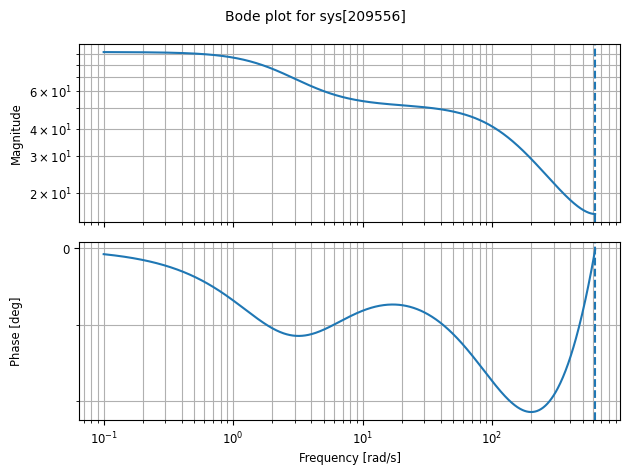

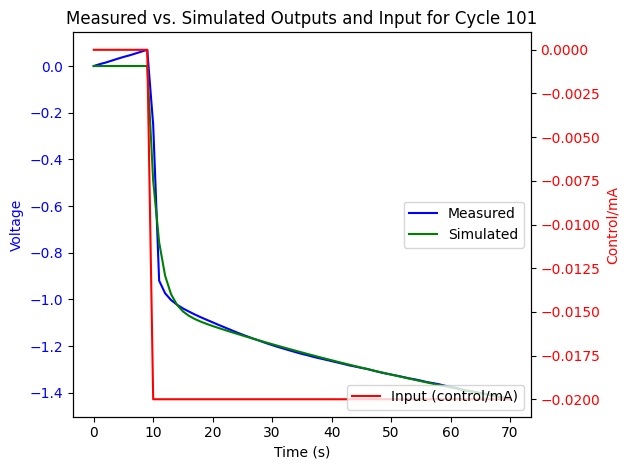

Cycle 102: G_hat_box_jenkins
<TransferFunction>: sys[209564]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 24.59 z^2 - 26.24 z
---------------------
z^2 - 1.615 z + 0.583

dt = 0.005

Cycle 102: Zeros
[1.06710021+0.j 0.        +0.j]
Cycle 102: Poles
[1.06996813+0.j 0.54489075+0.j]


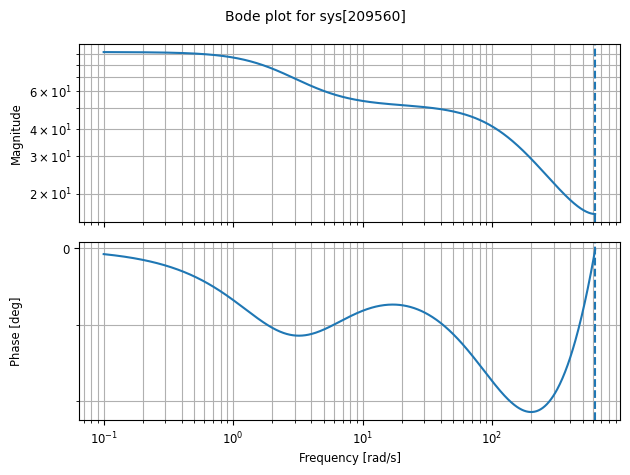

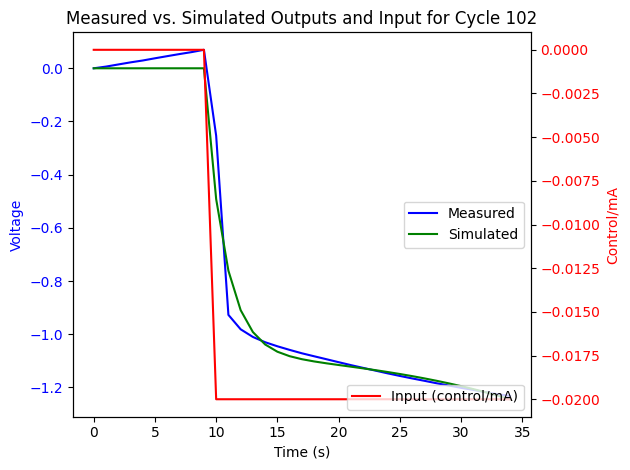

Cycle 103: G_hat_box_jenkins
<TransferFunction>: sys[209568]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 26.06 z^2 - 25.67 z
----------------------
z^2 - 1.476 z + 0.4659

dt = 0.005

Cycle 103: Zeros
[0.98505663+0.j 0.        +0.j]
Cycle 103: Poles
[1.01841908+0.j 0.45744886+0.j]


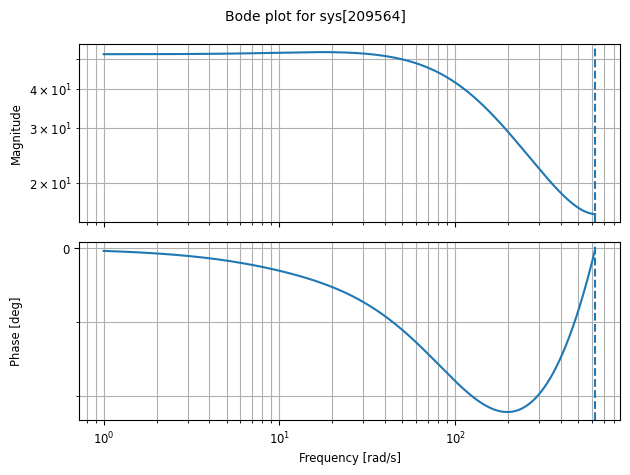

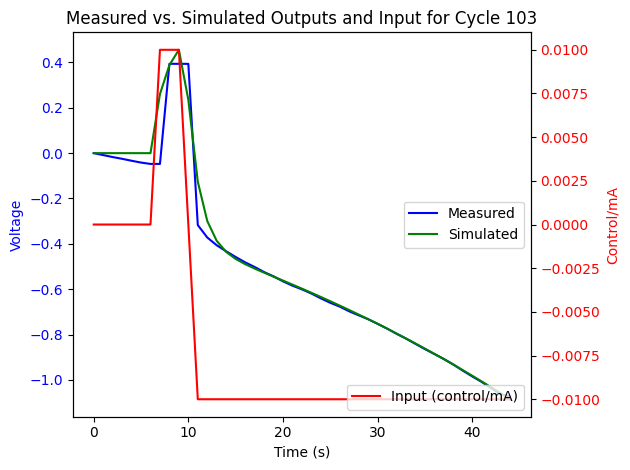

Cycle 104: G_hat_box_jenkins
<TransferFunction>: sys[209572]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 22.91 z^2 - 23.55 z
----------------------
z^2 - 1.651 z + 0.6392

dt = 0.005

Cycle 104: Zeros
[1.02815475+0.j 0.        +0.j]
Cycle 104: Poles
[1.03067794+0.j 0.62013097+0.j]


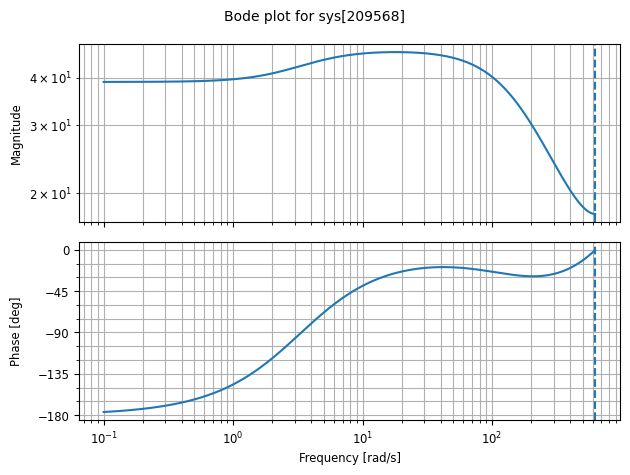

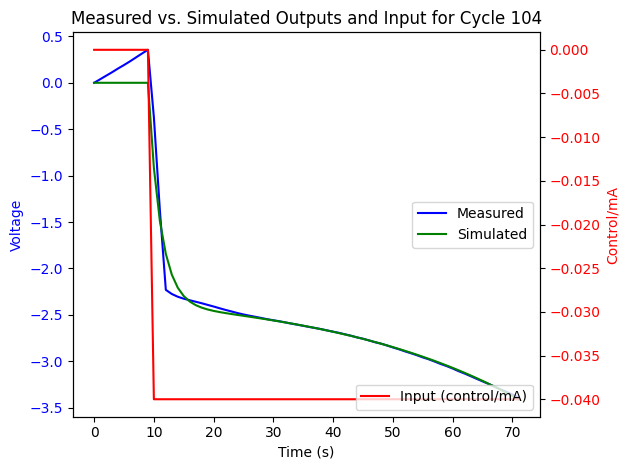

Cycle 105: G_hat_box_jenkins
<TransferFunction>: sys[209576]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 23.29 z^2 - 24.01 z
----------------------
z^2 - 1.665 z + 0.6527

dt = 0.005

Cycle 105: Zeros
[1.03102932+0.j 0.        +0.j]
Cycle 105: Poles
[1.03325073+0.j 0.63166323+0.j]


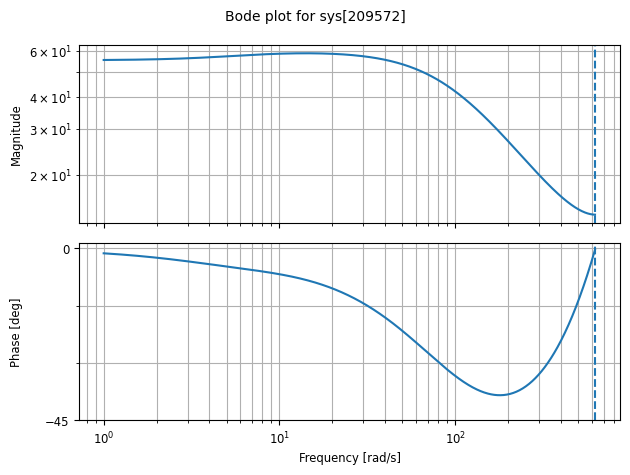

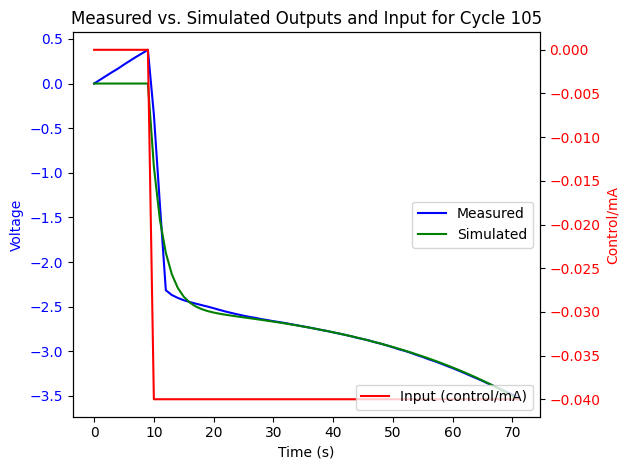

Cycle 106: G_hat_box_jenkins
<TransferFunction>: sys[209580]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 23.84 z^2 - 24.57 z
----------------------
z^2 - 1.671 z + 0.6591

dt = 0.005

Cycle 106: Zeros
[1.0308983+0.j 0.       +0.j]
Cycle 106: Poles
[1.03309078+0.j 0.63801122+0.j]


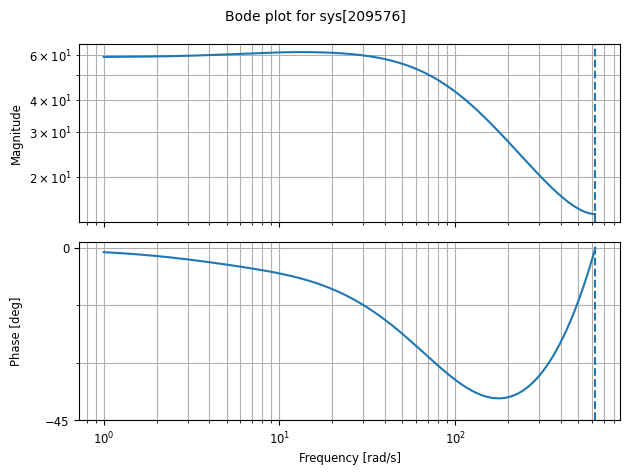

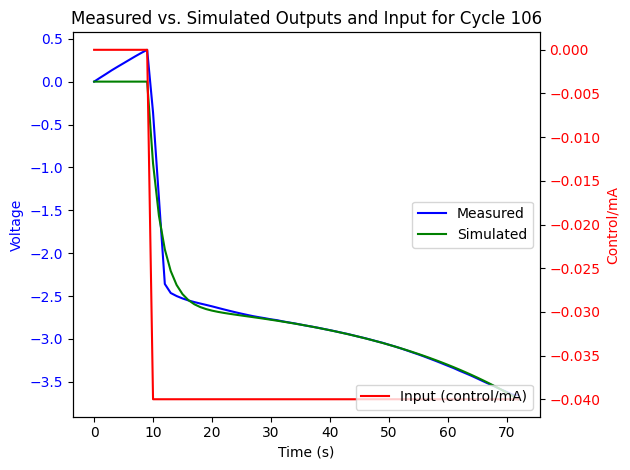

Cycle 107: G_hat_box_jenkins
<TransferFunction>: sys[209584]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 24.34 z^2 - 25.09 z
----------------------
z^2 - 1.677 z + 0.6654

dt = 0.005

Cycle 107: Zeros
[1.03091874+0.j 0.        +0.j]
Cycle 107: Poles
[1.03307352+0.j 0.64409545+0.j]


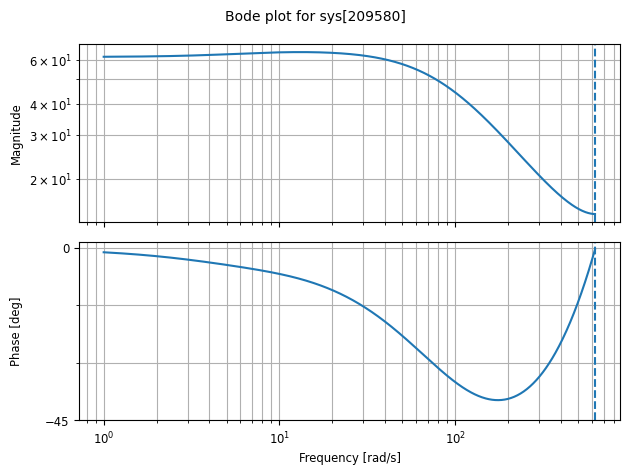

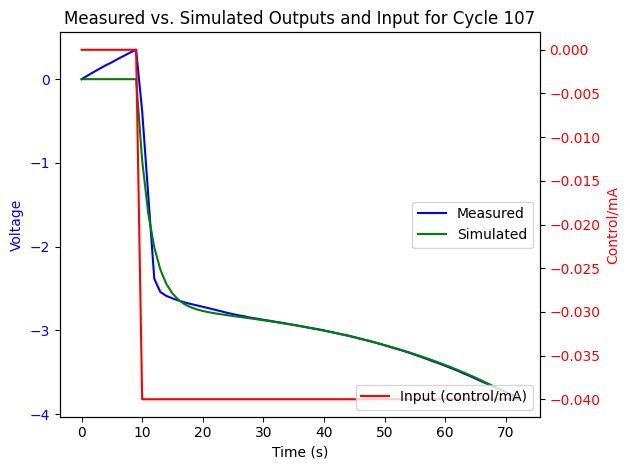

Cycle 108: G_hat_box_jenkins
<TransferFunction>: sys[209588]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 24.66 z^2 - 25.43 z
----------------------
z^2 - 1.682 z + 0.6703

dt = 0.005

Cycle 108: Zeros
[1.03140787+0.j 0.        +0.j]
Cycle 108: Poles
[1.03354109+0.j 0.64858432+0.j]


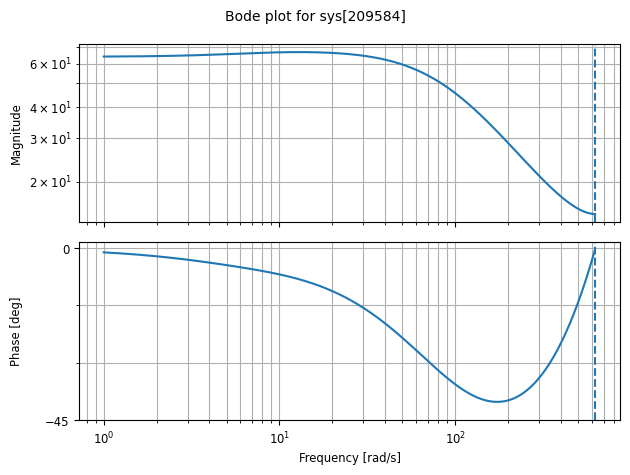

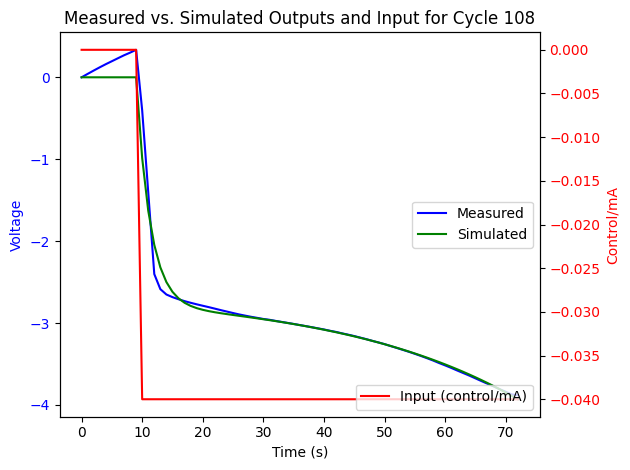

Cycle 109: G_hat_box_jenkins
<TransferFunction>: sys[209592]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 24.73 z^2 - 25.51 z
----------------------
z^2 - 1.687 z + 0.6758

dt = 0.005

Cycle 109: Zeros
[1.03124985+0.j 0.        +0.j]
Cycle 109: Poles
[1.03339763+0.j 0.6539313 +0.j]


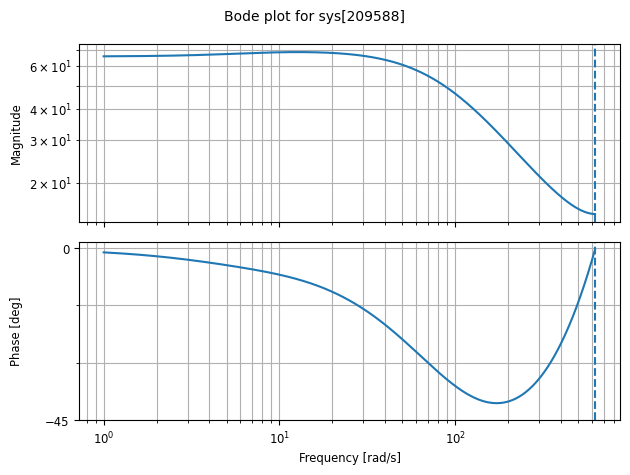

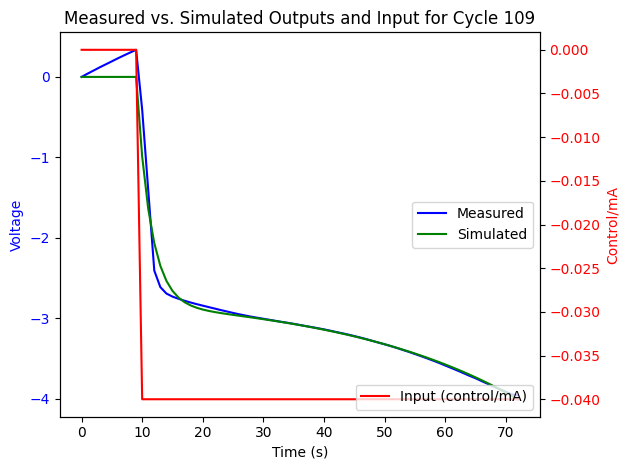

Cycle 110: G_hat_box_jenkins
<TransferFunction>: sys[209596]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 24.92 z^2 - 25.69 z
----------------------
z^2 - 1.691 z + 0.6796

dt = 0.005

Cycle 110: Zeros
[1.03106895+0.j 0.        +0.j]
Cycle 110: Poles
[1.03324868+0.j 0.65777877+0.j]


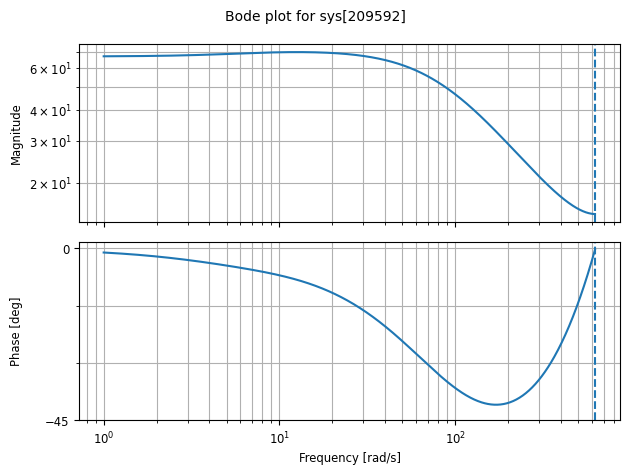

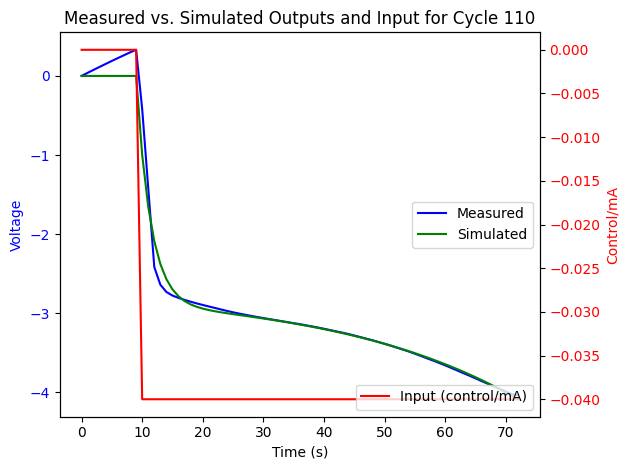

Cycle 111: G_hat_box_jenkins
<TransferFunction>: sys[209600]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 24.94 z^2 - 25.71 z
----------------------
z^2 - 1.696 z + 0.6847

dt = 0.005

Cycle 111: Zeros
[1.03092274+0.j 0.        +0.j]
Cycle 111: Poles
[1.03313029+0.j 0.66276128+0.j]


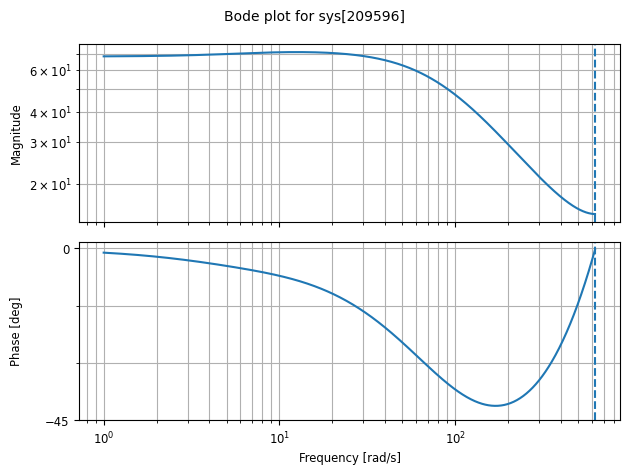

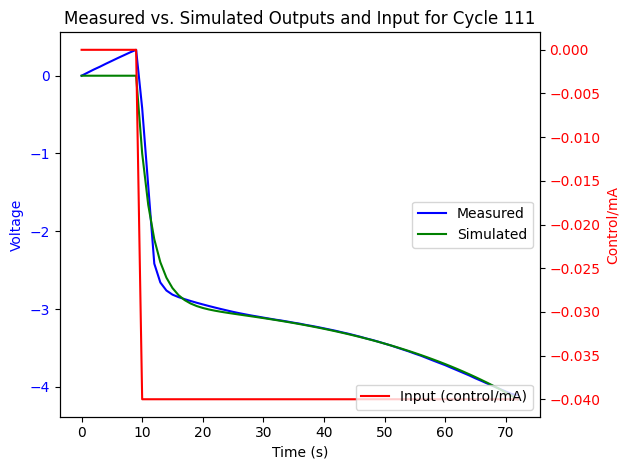

Cycle 112: G_hat_box_jenkins
<TransferFunction>: sys[209604]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


24.92 z^2 - 25.69 z
--------------------
z^2 - 1.7 z + 0.6891

dt = 0.005

Cycle 112: Zeros
[1.03091766+0.j 0.        +0.j]
Cycle 112: Poles
[1.0331545 +0.j 0.66701003+0.j]


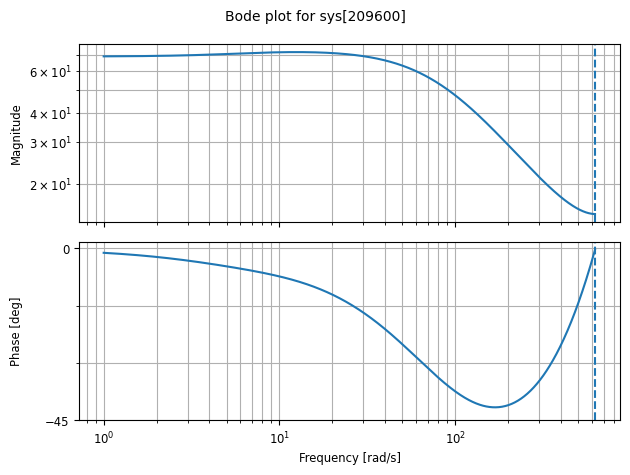

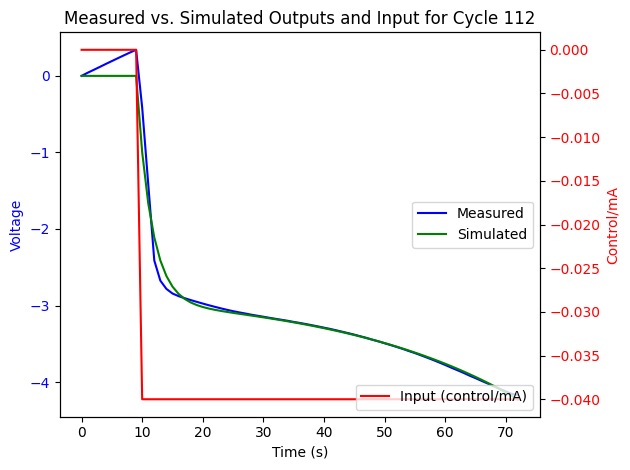

Cycle 113: G_hat_box_jenkins
<TransferFunction>: sys[209608]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 24.96 z^2 - 25.72 z
----------------------
z^2 - 1.702 z + 0.6913

dt = 0.005

Cycle 113: Zeros
[1.0304241+0.j 0.       +0.j]
Cycle 113: Poles
[1.03274001+0.j 0.66934549+0.j]


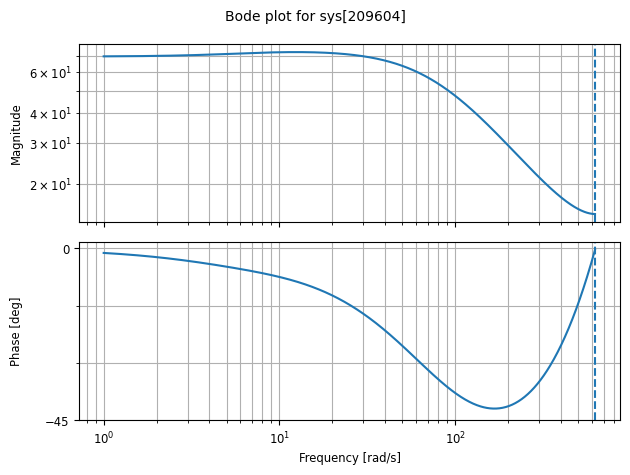

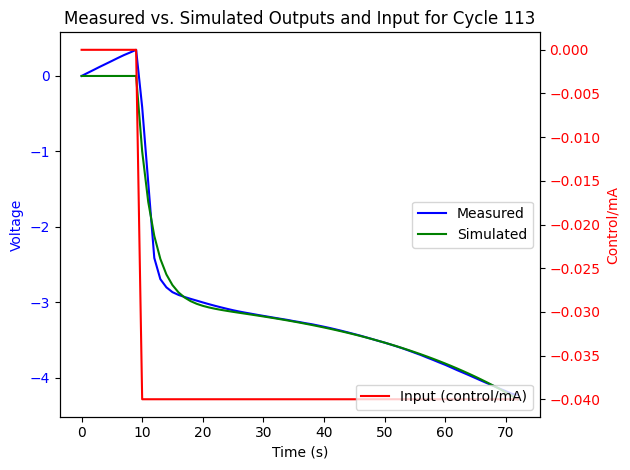

Cycle 114: G_hat_box_jenkins
<TransferFunction>: sys[209612]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 24.98 z^2 - 25.72 z
----------------------
z^2 - 1.704 z + 0.6932

dt = 0.005

Cycle 114: Zeros
[1.02973929+0.j 0.        +0.j]
Cycle 114: Poles
[1.03215178+0.j 0.6715772 +0.j]


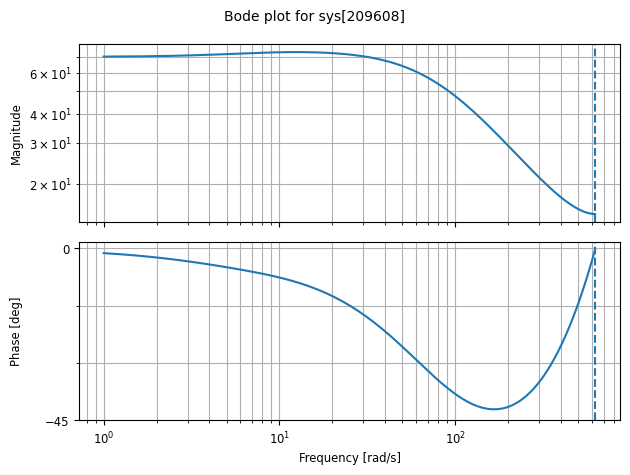

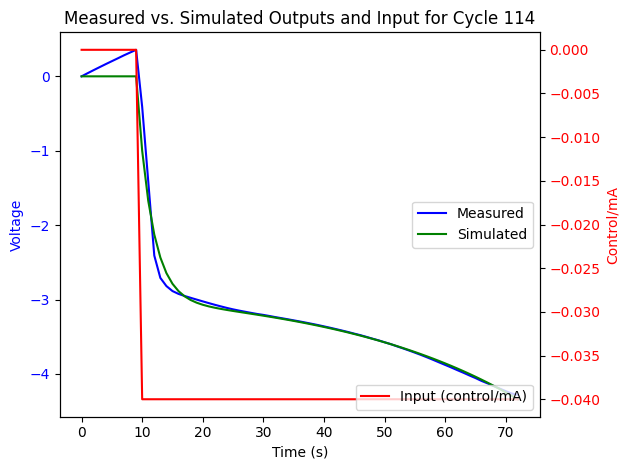

Cycle 115: G_hat_box_jenkins
<TransferFunction>: sys[209616]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 25.03 z^2 - 25.78 z
----------------------
z^2 - 1.705 z + 0.6949

dt = 0.005

Cycle 115: Zeros
[1.02991353+0.j 0.        +0.j]
Cycle 115: Poles
[1.0323649 +0.j 0.67310805+0.j]


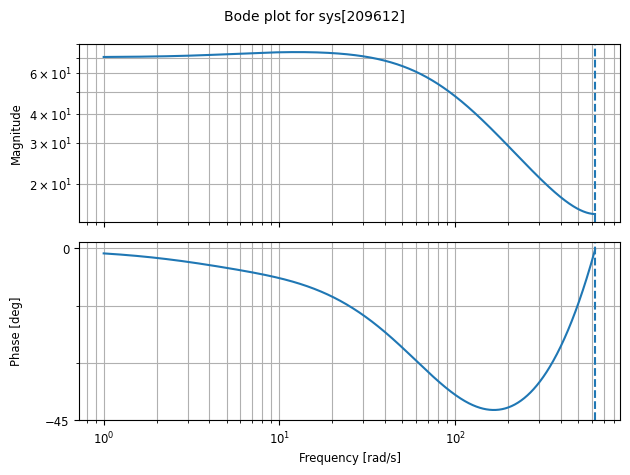

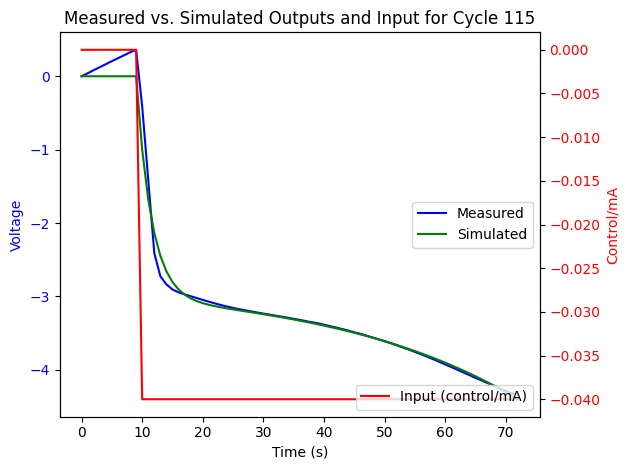

Cycle 116: G_hat_box_jenkins
<TransferFunction>: sys[209620]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


   25 z^2 - 25.74 z
----------------------
z^2 - 1.707 z + 0.6961

dt = 0.005

Cycle 116: Zeros
[1.02942659+0.j 0.        +0.j]
Cycle 116: Poles
[1.03199158+0.j 0.67455065+0.j]


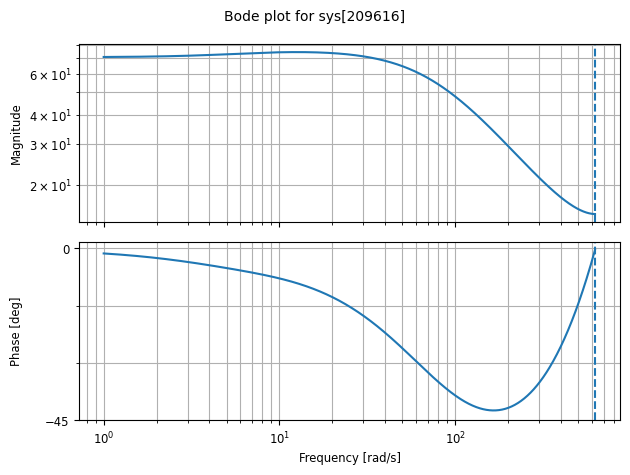

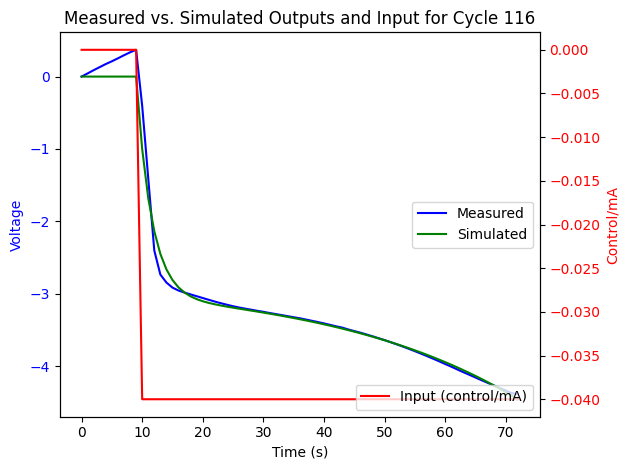

Cycle 117: G_hat_box_jenkins
<TransferFunction>: sys[209624]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 25.15 z^2 - 25.86 z
----------------------
z^2 - 1.705 z + 0.6946

dt = 0.005

Cycle 117: Zeros
[1.02842345+0.j 0.        +0.j]
Cycle 117: Poles
[1.03115252+0.j 0.6736194 +0.j]


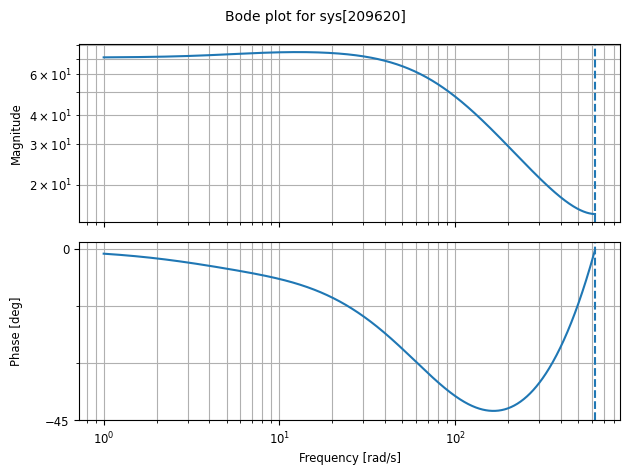

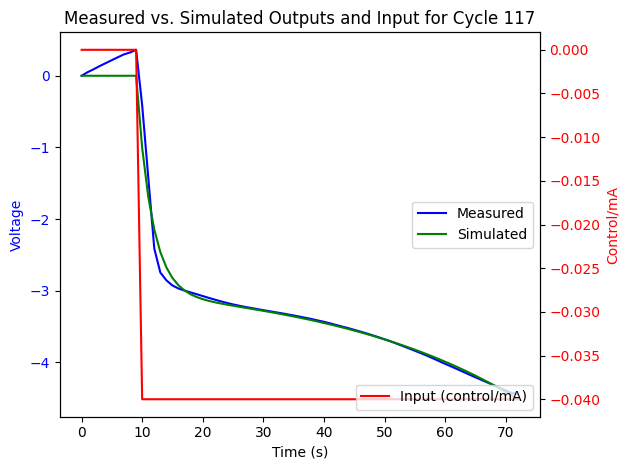

Cycle 118: G_hat_box_jenkins
<TransferFunction>: sys[209628]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 24.95 z^2 - 25.66 z
----------------------
z^2 - 1.708 z + 0.6981

dt = 0.005

Cycle 118: Zeros
[1.02856603+0.j 0.        +0.j]
Cycle 118: Poles
[1.03137658+0.j 0.67685258+0.j]


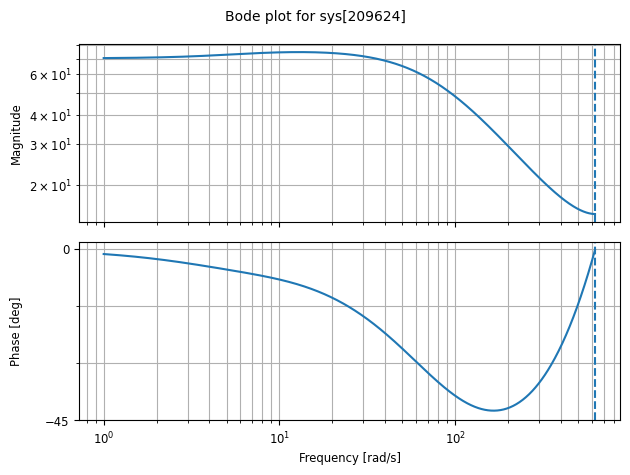

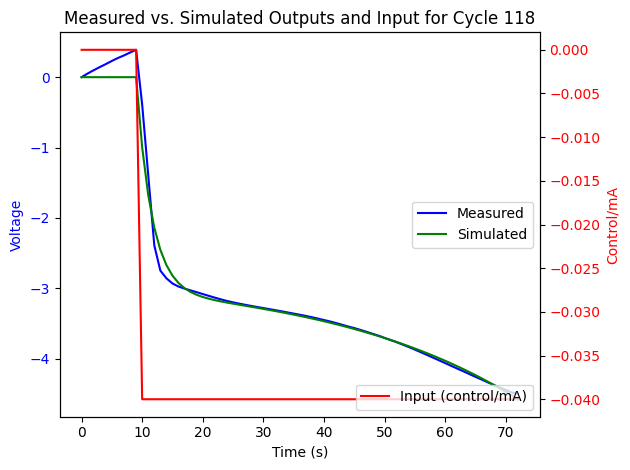

Cycle 119: G_hat_box_jenkins
<TransferFunction>: sys[209632]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 25.25 z^2 - 25.97 z
----------------------
z^2 - 1.707 z + 0.6964

dt = 0.005

Cycle 119: Zeros
[1.02837+0.j 0.     +0.j]
Cycle 119: Poles
[1.03129552+0.j 0.67522139+0.j]


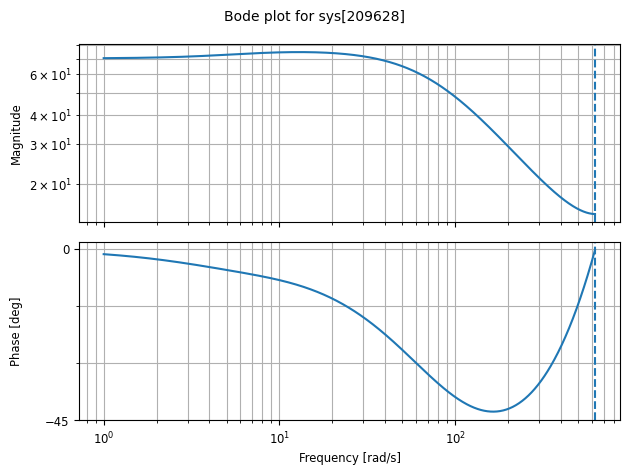

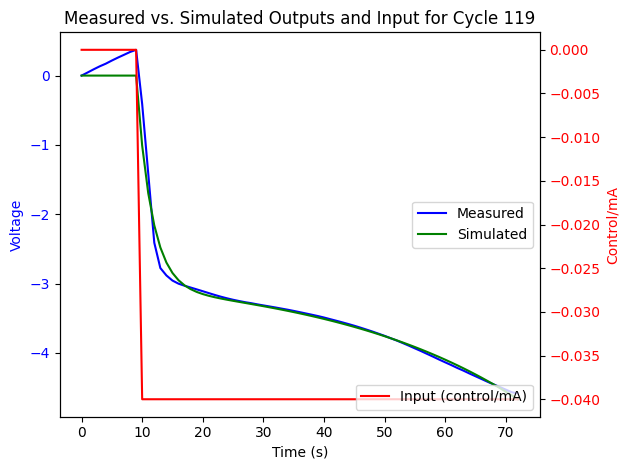

Cycle 120: G_hat_box_jenkins
<TransferFunction>: sys[209636]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 25.25 z^2 - 25.96 z
----------------------
z^2 - 1.708 z + 0.6977

dt = 0.005

Cycle 120: Zeros
[1.02784255+0.j 0.        +0.j]
Cycle 120: Poles
[1.03091525+0.j 0.67675779+0.j]


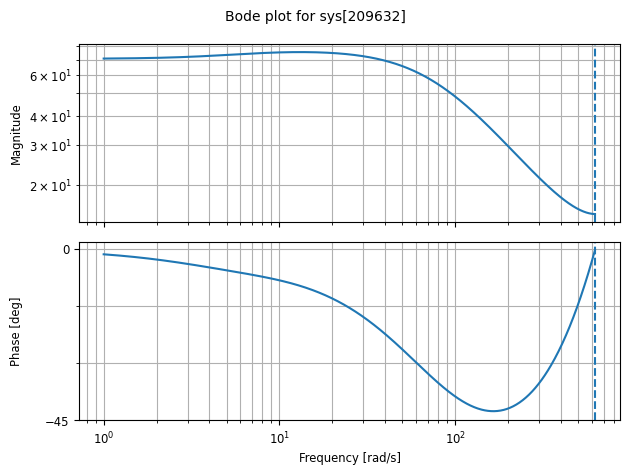

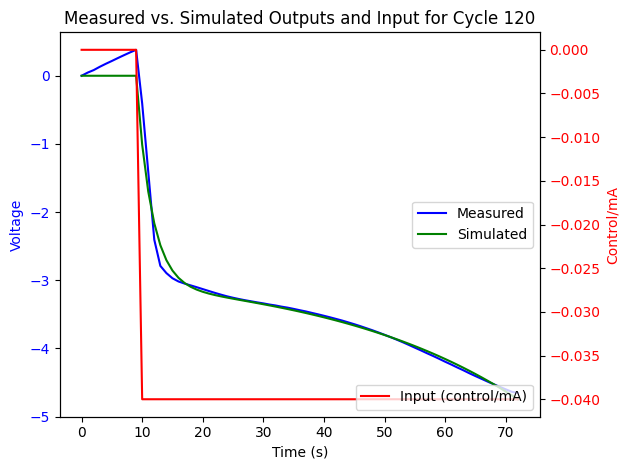

Cycle 121: G_hat_box_jenkins
<TransferFunction>: sys[209640]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  25.32 z^2 - 26 z
---------------------
z^2 - 1.707 z + 0.697

dt = 0.005

Cycle 121: Zeros
[1.0270118+0.j 0.       +0.j]
Cycle 121: Poles
[1.03028686+0.j 0.67647704+0.j]


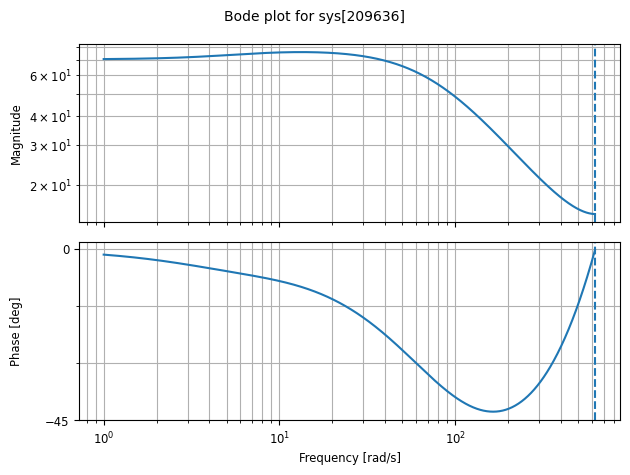

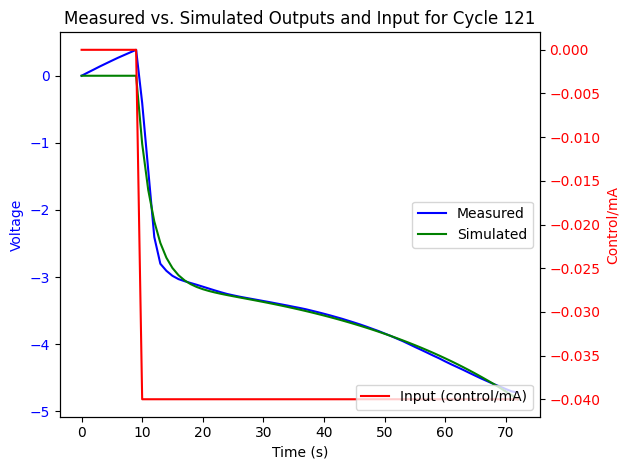

Cycle 122: G_hat_box_jenkins
<TransferFunction>: sys[209644]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 25.34 z^2 - 25.99 z
----------------------
z^2 - 1.706 z + 0.6965

dt = 0.005

Cycle 122: Zeros
[1.0259341+0.j 0.       +0.j]
Cycle 122: Poles
[1.02943345+0.j 0.67661723+0.j]


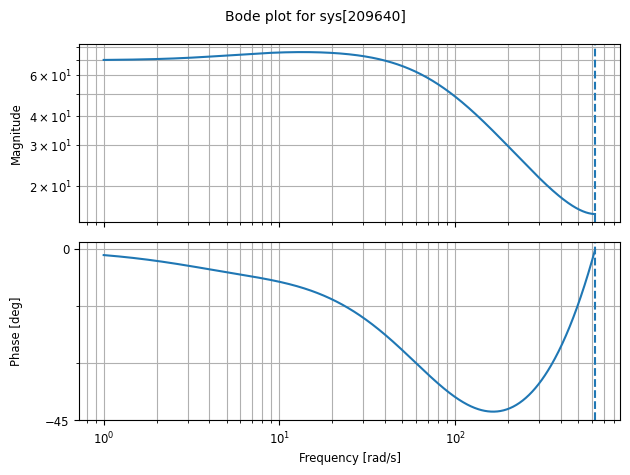

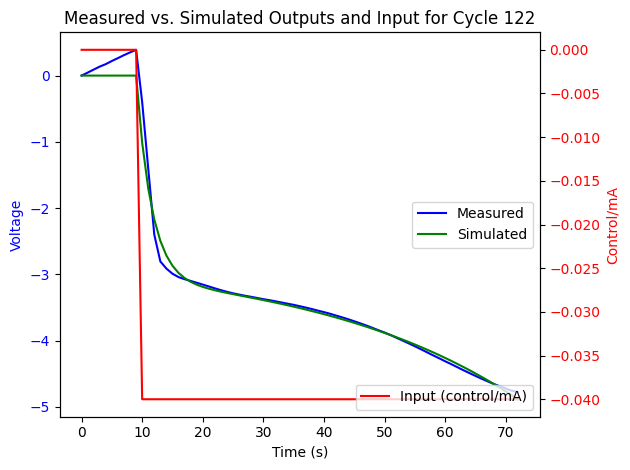

Cycle 123: G_hat_box_jenkins
<TransferFunction>: sys[209648]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 25.44 z^2 - 26.06 z
---------------------
z^2 - 1.703 z + 0.694

dt = 0.005

Cycle 123: Zeros
[1.02435582+0.j 0.        +0.j]
Cycle 123: Poles
[1.02817935+0.j 0.67502405+0.j]


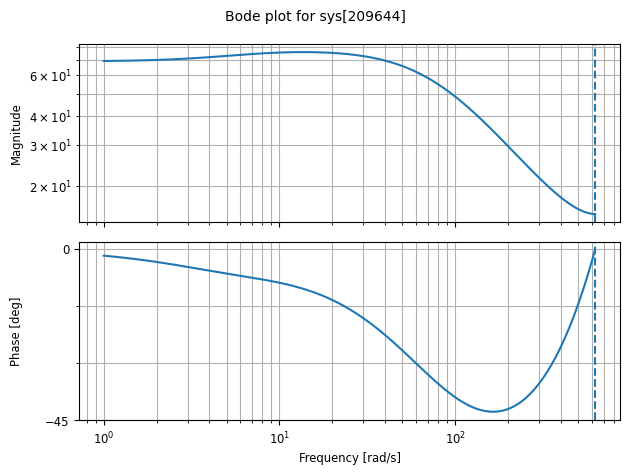

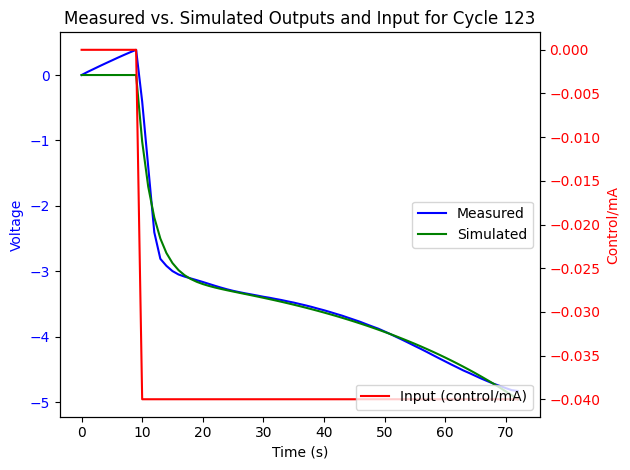

Cycle 124: G_hat_box_jenkins
<TransferFunction>: sys[209652]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


25.55 z^2 - 26.14 z
--------------------
z^2 - 1.7 z + 0.6909

dt = 0.005

Cycle 124: Zeros
[1.02302221+0.j 0.        +0.j]
Cycle 124: Poles
[1.02715451+0.j 0.67262967+0.j]


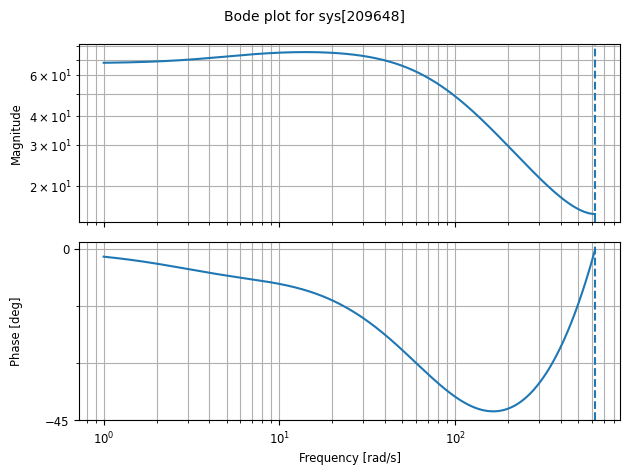

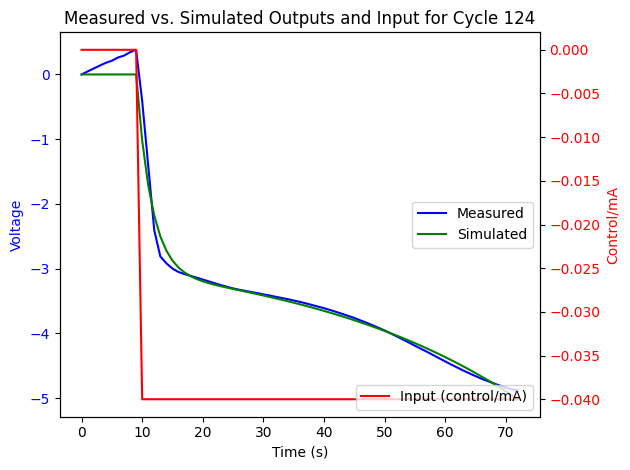

Cycle 125: G_hat_box_jenkins
<TransferFunction>: sys[209656]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 25.58 z^2 - 26.12 z
---------------------
z^2 - 1.696 z + 0.688

dt = 0.005

Cycle 125: Zeros
[1.02113309+0.j 0.        +0.j]
Cycle 125: Poles
[1.02565775+0.j 0.67078651+0.j]


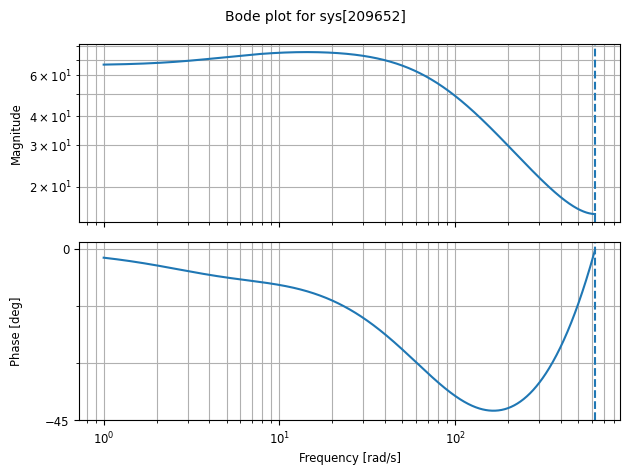

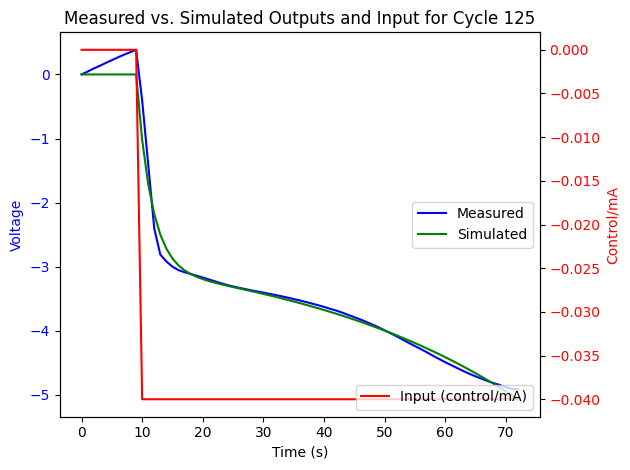

Cycle 126: G_hat_box_jenkins
<TransferFunction>: sys[209660]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 26.23 z^2 - 26.74 z
---------------------
z^2 - 1.69 z + 0.6815

dt = 0.005

Cycle 126: Zeros
[1.01941876+0.j 0.        +0.j]
Cycle 126: Poles
[1.02426736+0.j 0.66539852+0.j]


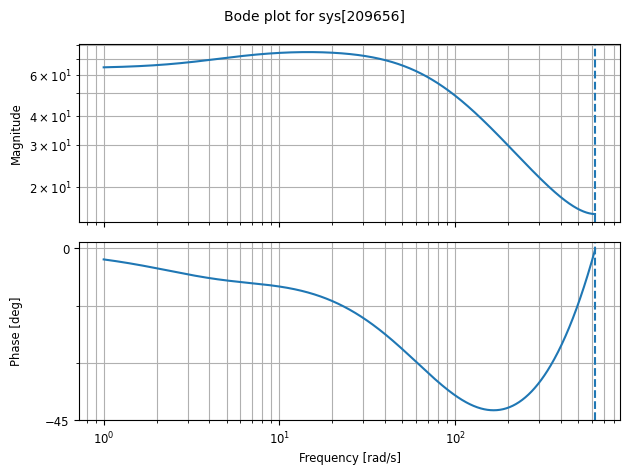

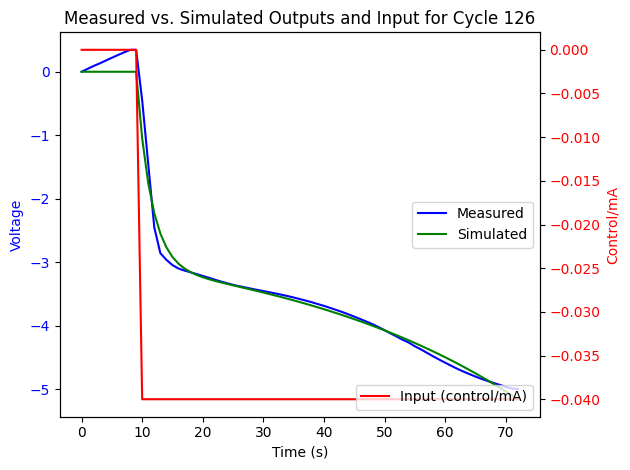

Cycle 127: G_hat_box_jenkins
<TransferFunction>: sys[209664]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 26.25 z^2 - 26.73 z
----------------------
z^2 - 1.687 z + 0.6797

dt = 0.005

Cycle 127: Zeros
[1.01808955+0.j 0.        +0.j]
Cycle 127: Poles
[1.02325998+0.j 0.66423338+0.j]


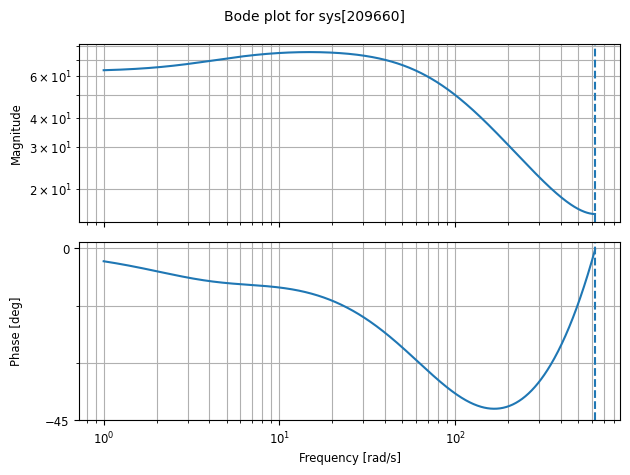

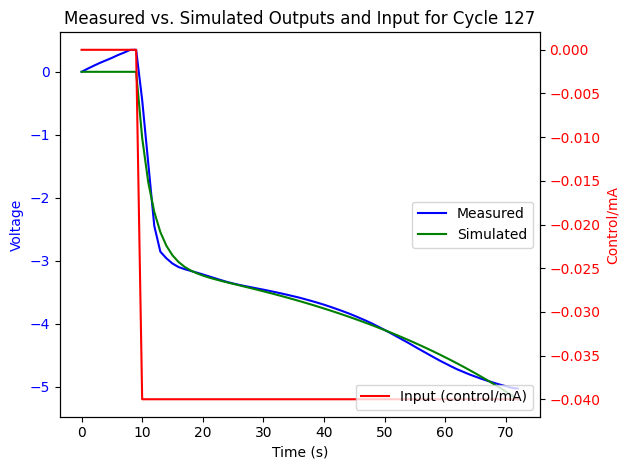

Cycle 128: G_hat_box_jenkins
<TransferFunction>: sys[209668]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 26.24 z^2 - 26.68 z
----------------------
z^2 - 1.687 z + 0.6791

dt = 0.005

Cycle 128: Zeros
[1.01689341+0.j 0.        +0.j]
Cycle 128: Poles
[1.0223408 +0.j 0.66422454+0.j]


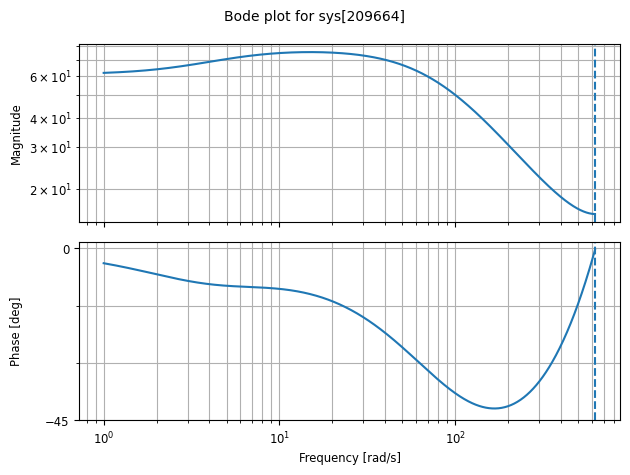

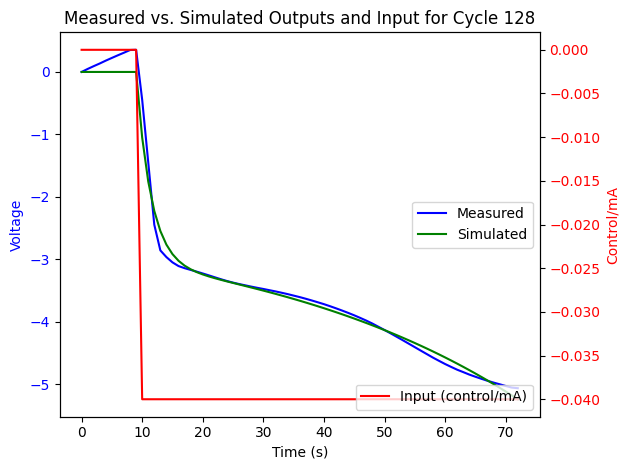

Cycle 129: G_hat_box_jenkins
<TransferFunction>: sys[209672]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 26.41 z^2 - 26.84 z
---------------------
z^2 - 1.684 z + 0.677

dt = 0.005

Cycle 129: Zeros
[1.01621482+0.j 0.        +0.j]
Cycle 129: Poles
[1.02184726+0.j 0.66251758+0.j]


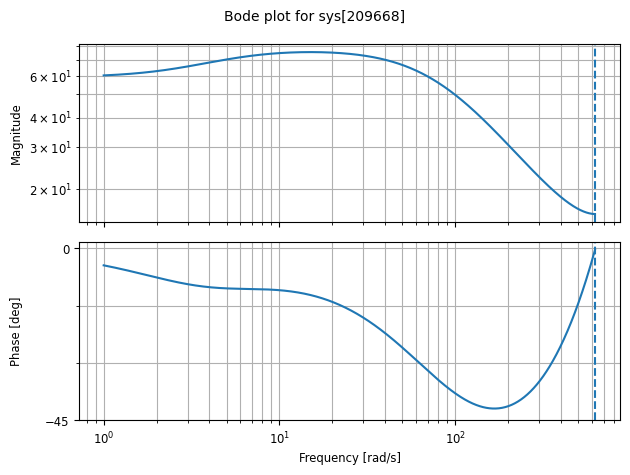

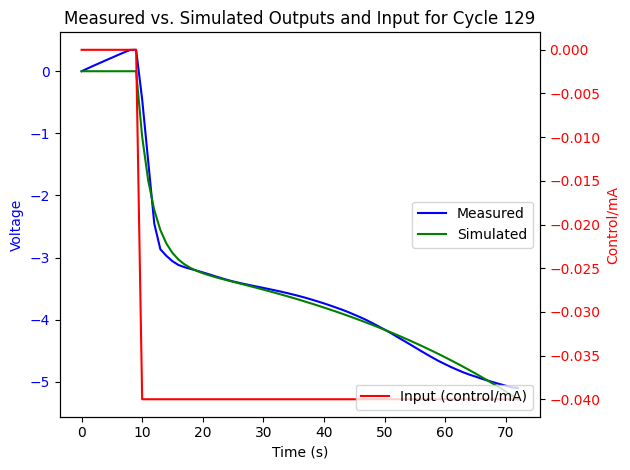

Cycle 130: G_hat_box_jenkins
<TransferFunction>: sys[209676]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 26.51 z^2 - 26.91 z
----------------------
z^2 - 1.681 z + 0.6743

dt = 0.005

Cycle 130: Zeros
[1.01492754+0.j 0.        +0.j]
Cycle 130: Poles
[1.02086665+0.j 0.66053167+0.j]


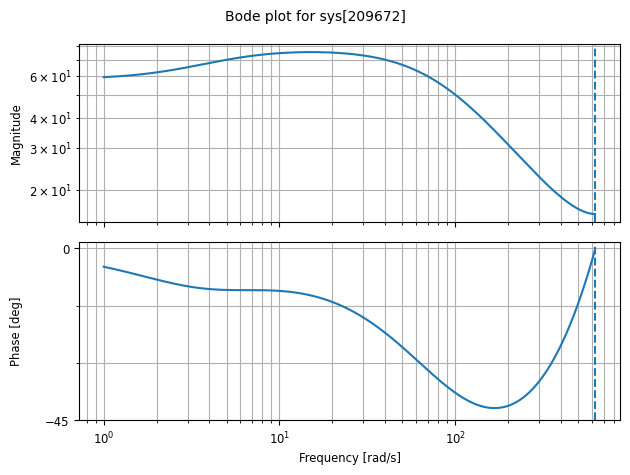

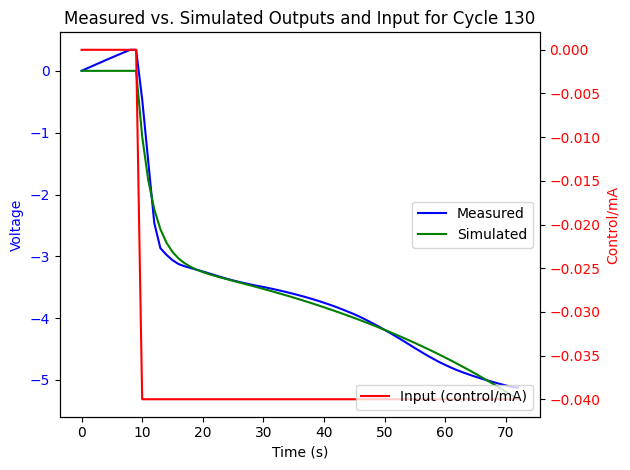

Cycle 131: G_hat_box_jenkins
<TransferFunction>: sys[209680]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  25.94 z^2 - 26.3 z
----------------------
z^2 - 1.683 z + 0.6765

dt = 0.005

Cycle 131: Zeros
[1.01384109+0.j 0.        +0.j]
Cycle 131: Poles
[1.02013172+0.j 0.66315914+0.j]


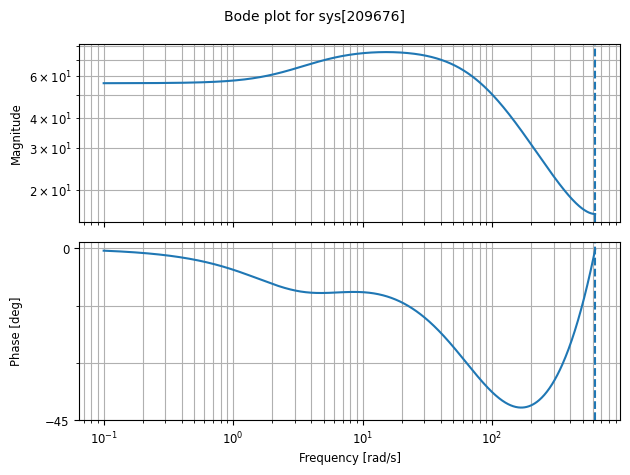

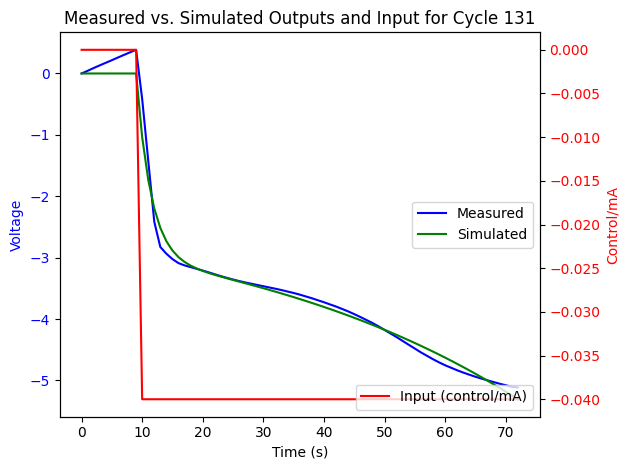

Cycle 132: G_hat_box_jenkins
<TransferFunction>: sys[209684]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 26.02 z^2 - 26.35 z
----------------------
z^2 - 1.681 z + 0.6745

dt = 0.005

Cycle 132: Zeros
[1.01273797+0.j 0.        +0.j]
Cycle 132: Poles
[1.01932039+0.j 0.66170718+0.j]


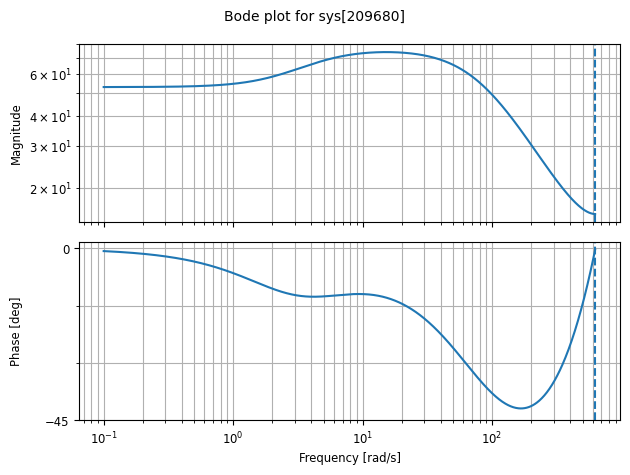

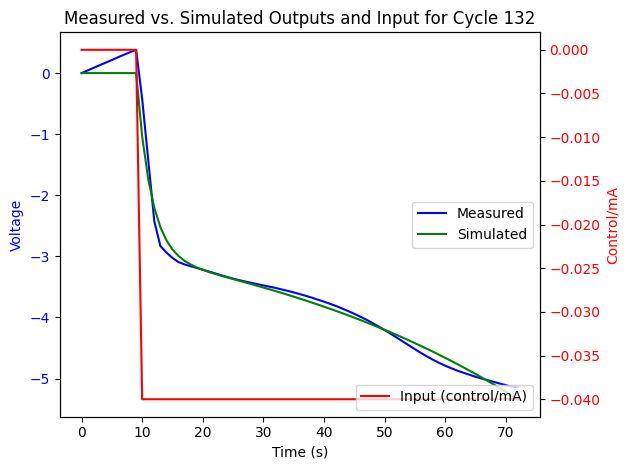

Cycle 133: G_hat_box_jenkins
<TransferFunction>: sys[209688]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 26.02 z^2 - 26.33 z
----------------------
z^2 - 1.679 z + 0.6731

dt = 0.005

Cycle 133: Zeros
[1.01175826+0.j 0.        +0.j]
Cycle 133: Poles
[1.01860206+0.j 0.66083437+0.j]


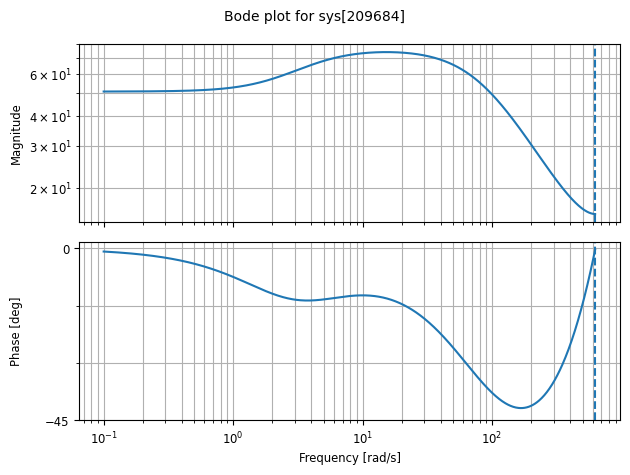

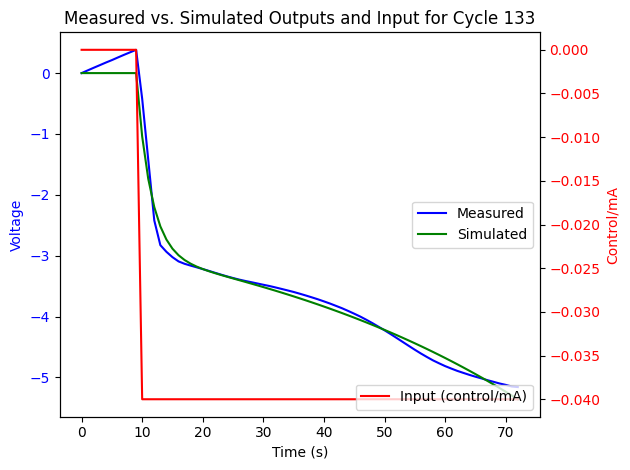

Cycle 134: G_hat_box_jenkins
<TransferFunction>: sys[209692]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 26.17 z^2 - 26.43 z
----------------------
z^2 - 1.675 z + 0.6695

dt = 0.005

Cycle 134: Zeros
[1.01002333+0.j 0.        +0.j]
Cycle 134: Poles
[1.0172571 +0.j 0.65816337+0.j]


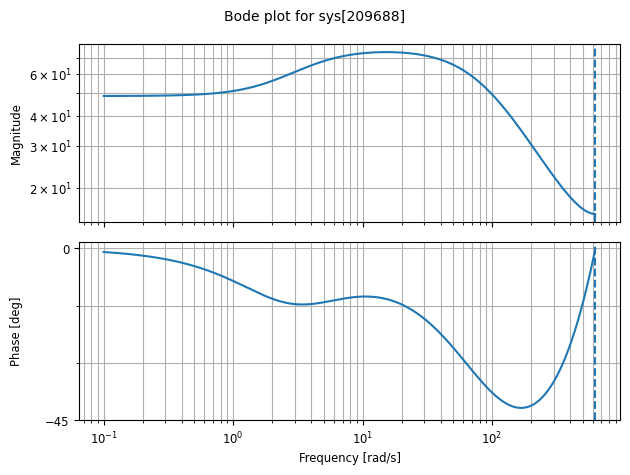

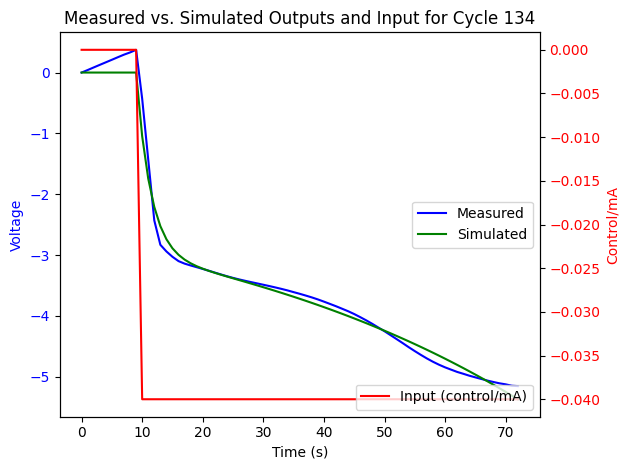

Cycle 135: G_hat_box_jenkins
<TransferFunction>: sys[209696]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


   7.533 z^2 + 23.2 z
------------------------
z^2 - 0.6054 z + 0.06171

dt = 0.005

Cycle 135: Zeros
[-3.07957986+0.j  0.        +0.j]
Cycle 135: Poles
[0.47571692+0.j 0.12971979+0.j]


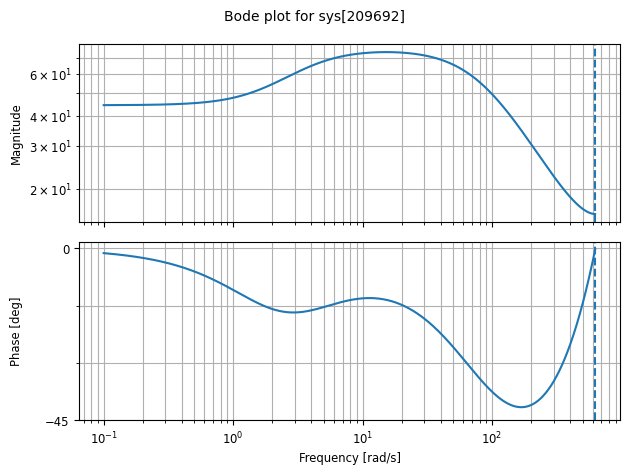

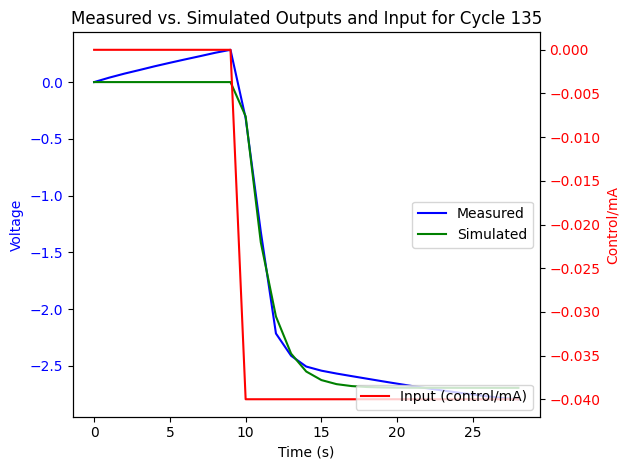

Cycle 136: G_hat_box_jenkins
<TransferFunction>: sys[209700]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 21.86 z^2 - 14.63 z
---------------------
z^2 - 1.126 z + 0.171

dt = 0.005

Cycle 136: Zeros
[0.66902565+0.j 0.        +0.j]
Cycle 136: Poles
[0.94465794+0.j 0.18101771+0.j]


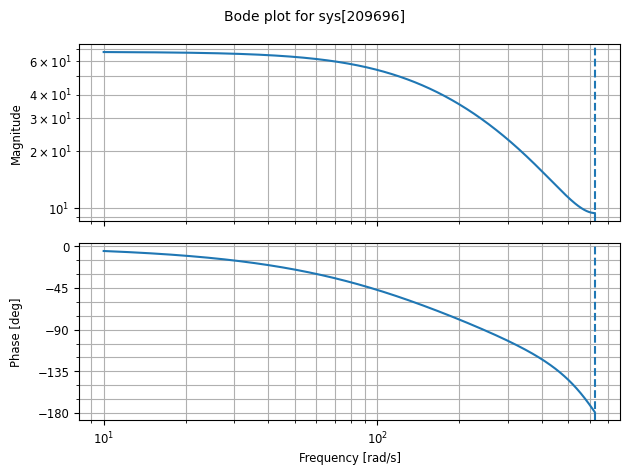

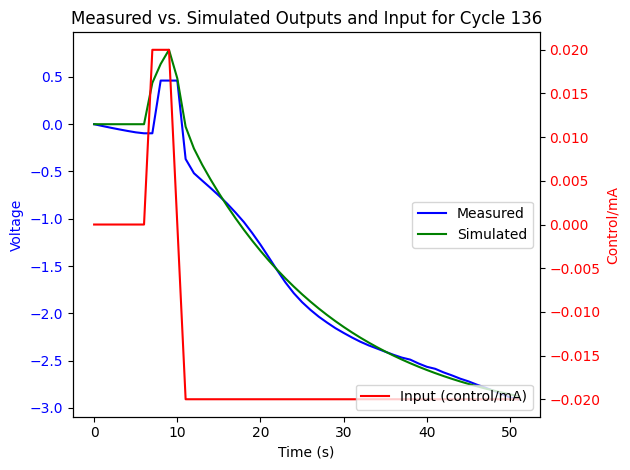

Cycle 137: G_hat_box_jenkins
<TransferFunction>: sys[209704]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 15.09 z^2 - 14.63 z
---------------------
z^2 - 1.63 z + 0.6335

dt = 0.005

Cycle 137: Zeros
[0.96926058+0.j 0.        +0.j]
Cycle 137: Poles
[0.98920108+0.j 0.64043135+0.j]


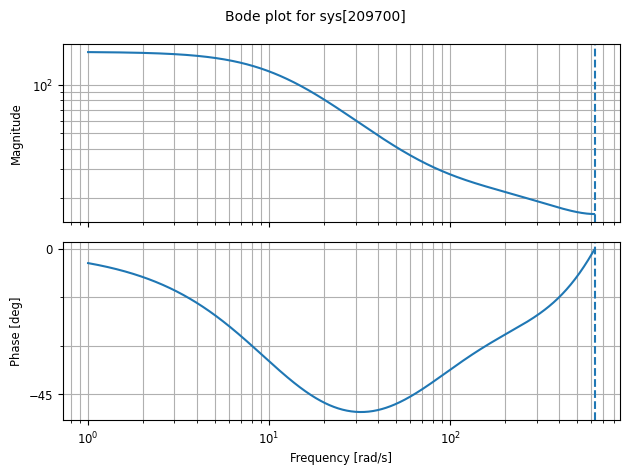

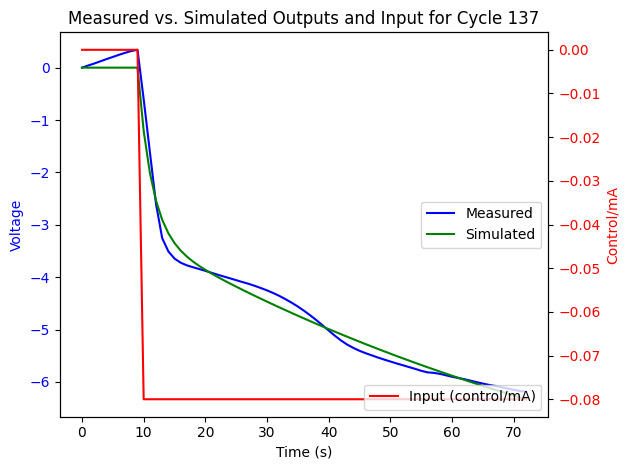

Cycle 138: G_hat_box_jenkins
<TransferFunction>: sys[209708]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.27 z^2 - 13.79 z
----------------------
z^2 - 1.633 z + 0.6378

dt = 0.005

Cycle 138: Zeros
[0.96662431+0.j 0.        +0.j]
Cycle 138: Poles
[0.98710796+0.j 0.64610388+0.j]


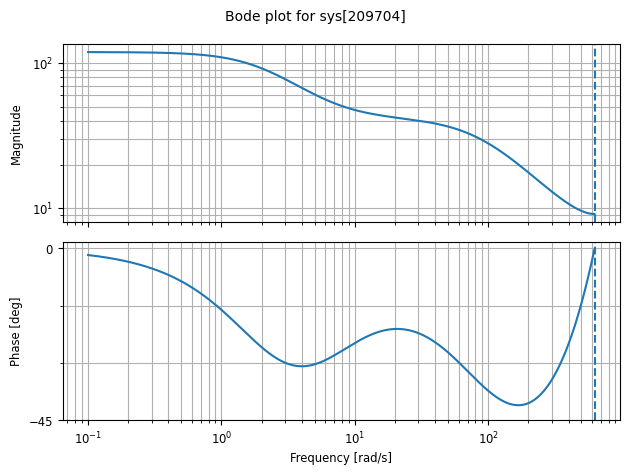

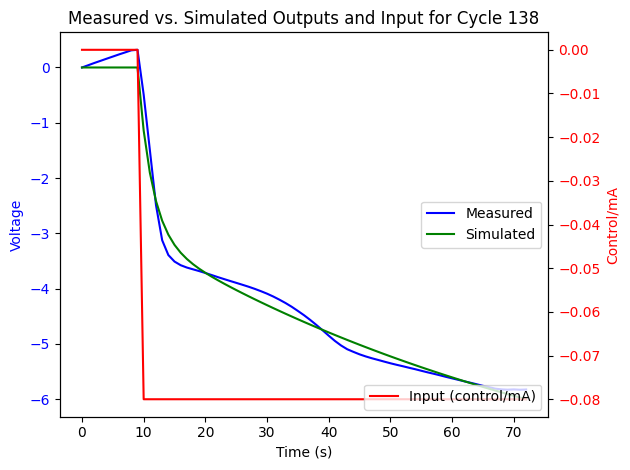

Cycle 139: G_hat_box_jenkins
<TransferFunction>: sys[209712]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 13.88 z^2 - 13.29 z
----------------------
z^2 - 1.636 z + 0.6426

dt = 0.005

Cycle 139: Zeros
[0.95765512+0.j 0.        +0.j]
Cycle 139: Poles
[0.98020472+0.j 0.65558343+0.j]


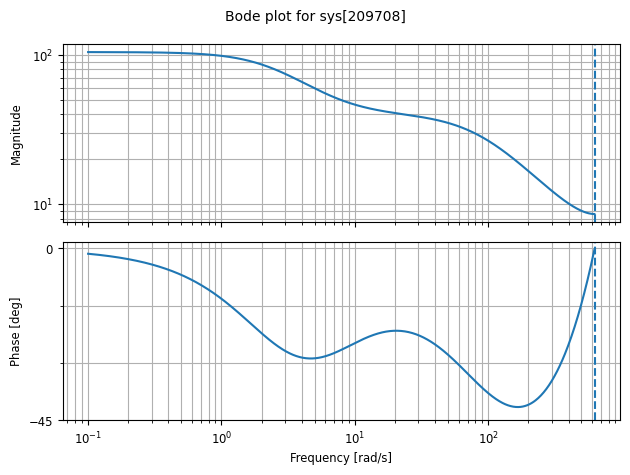

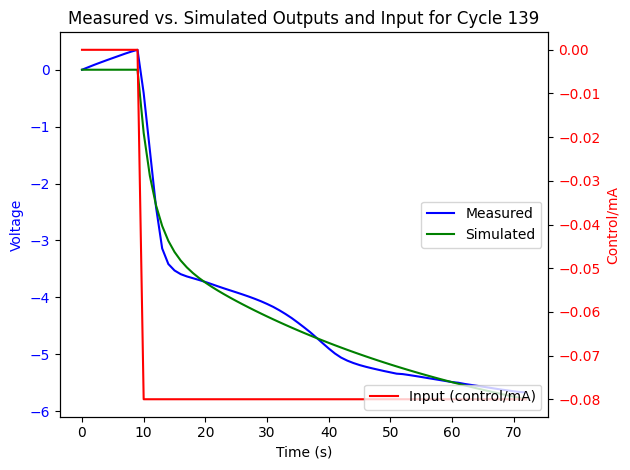

Cycle 140: G_hat_box_jenkins
<TransferFunction>: sys[209716]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.01 z^2 - 13.45 z
---------------------
z^2 - 1.65 z + 0.6566

dt = 0.005

Cycle 140: Zeros
[0.95937385+0.j 0.        +0.j]
Cycle 140: Poles
[0.98017225+0.j 0.66983342+0.j]


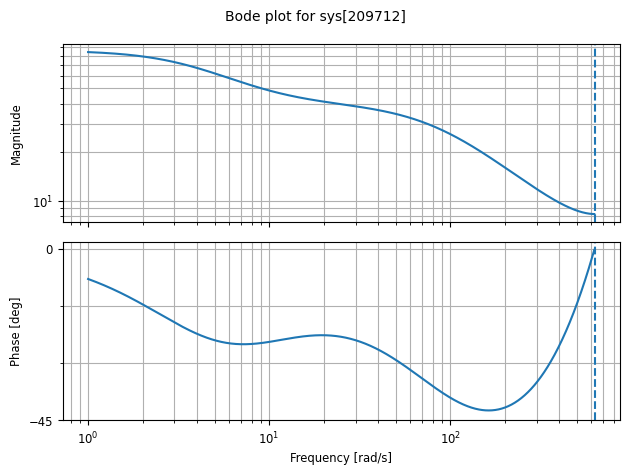

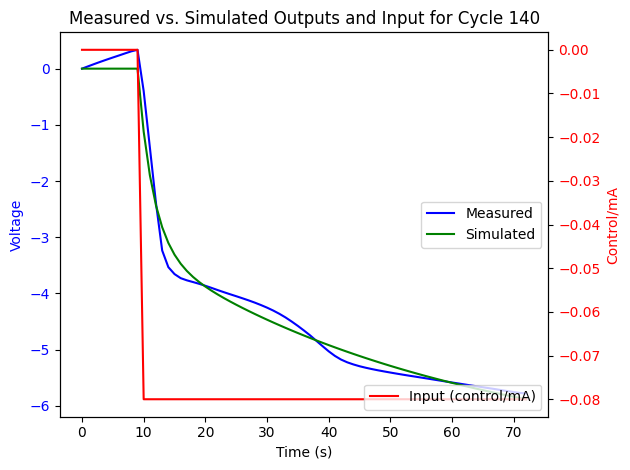

Cycle 141: G_hat_box_jenkins
<TransferFunction>: sys[209720]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.09 z^2 - 13.51 z
----------------------
z^2 - 1.658 z + 0.6646

dt = 0.005

Cycle 141: Zeros
[0.95867416+0.j 0.        +0.j]
Cycle 141: Poles
[0.97911491+0.j 0.67878164+0.j]


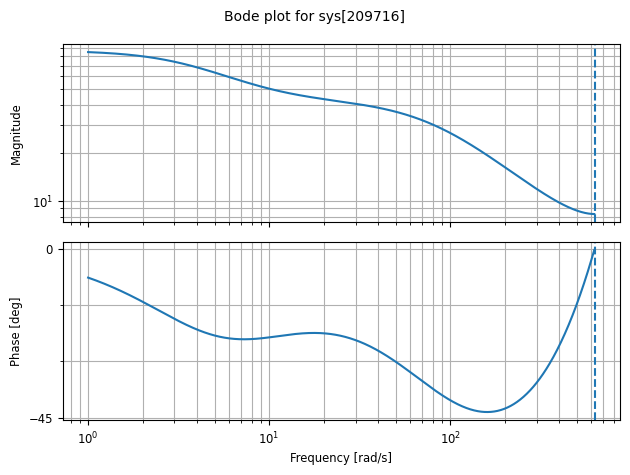

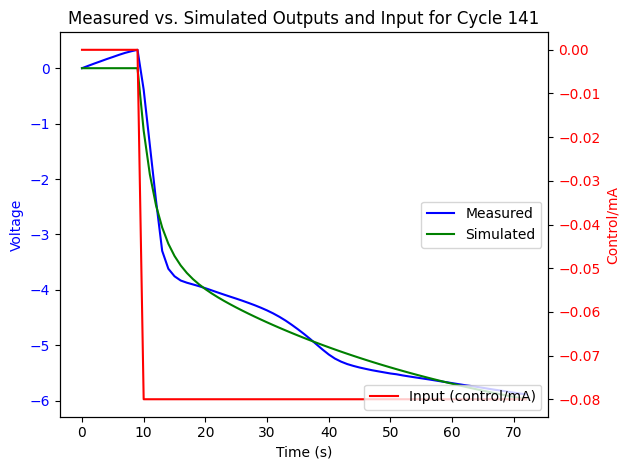

Cycle 142: G_hat_box_jenkins
<TransferFunction>: sys[209724]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.15 z^2 - 13.57 z
----------------------
z^2 - 1.666 z + 0.6723

dt = 0.005

Cycle 142: Zeros
[0.95893962+0.j 0.        +0.j]
Cycle 142: Poles
[0.97879294+0.j 0.68686071+0.j]


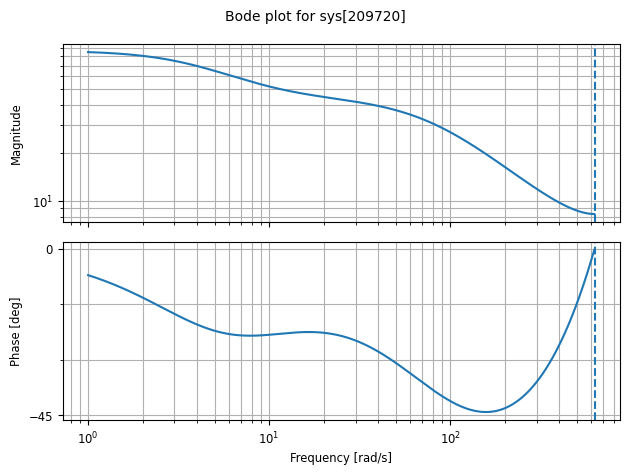

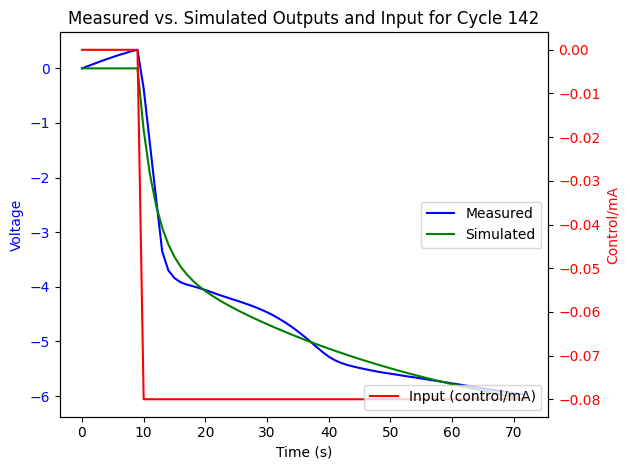

Cycle 143: G_hat_box_jenkins
<TransferFunction>: sys[209728]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.09 z^2 - 13.52 z
----------------------
z^2 - 1.674 z + 0.6807

dt = 0.005

Cycle 143: Zeros
[0.95915282+0.j 0.        +0.j]
Cycle 143: Poles
[0.97852998+0.j 0.69568112+0.j]


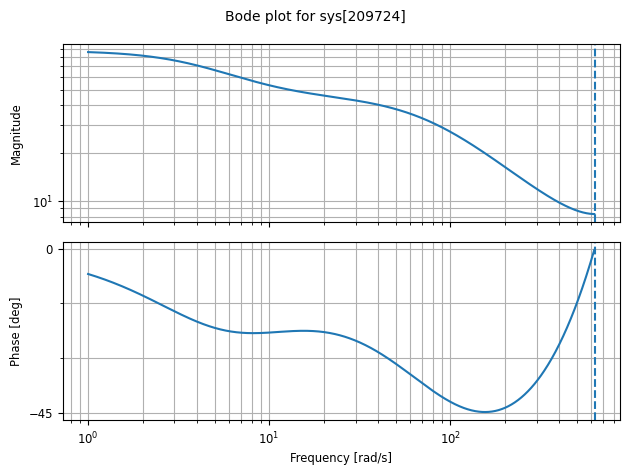

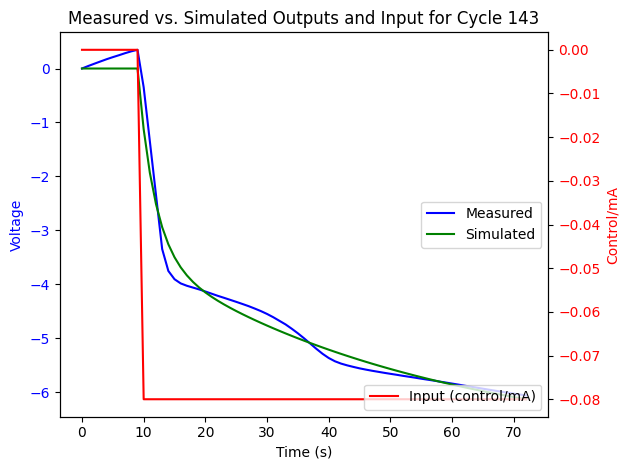

Cycle 144: G_hat_box_jenkins
<TransferFunction>: sys[209732]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.22 z^2 - 13.65 z
----------------------
z^2 - 1.681 z + 0.6877

dt = 0.005

Cycle 144: Zeros
[0.95987575+0.j 0.        +0.j]
Cycle 144: Poles
[0.97861799+0.j 0.70267886+0.j]


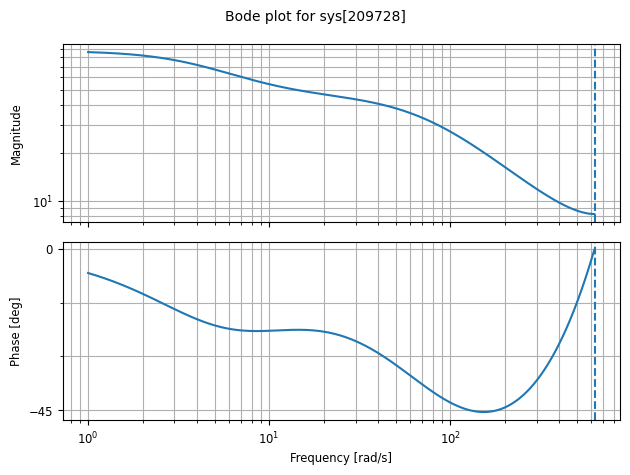

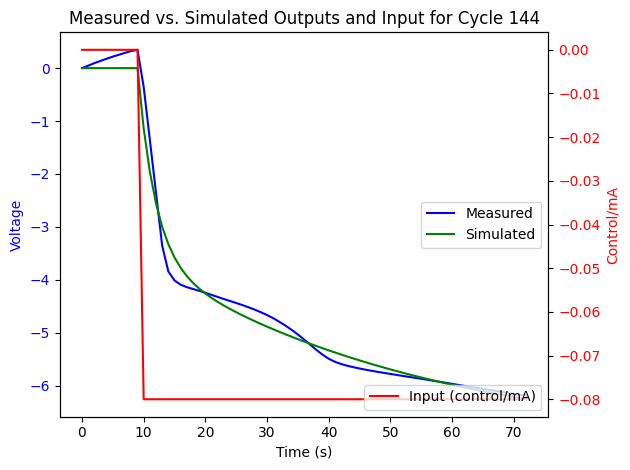

Cycle 145: G_hat_box_jenkins
<TransferFunction>: sys[209736]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


   14.61 z^2 - 14 z
----------------------
z^2 - 1.679 z + 0.6859

dt = 0.005

Cycle 145: Zeros
[0.95862442+0.j 0.        +0.j]
Cycle 145: Poles
[0.97719674+0.j 0.70190858+0.j]


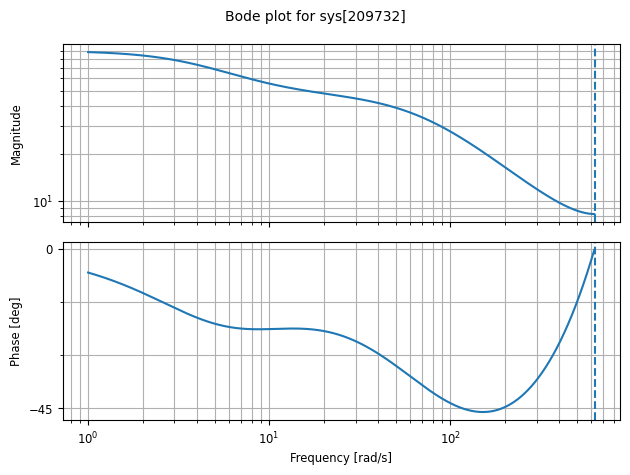

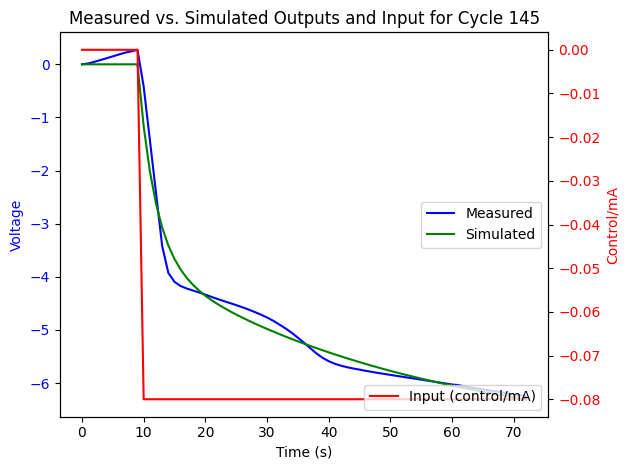

Cycle 146: G_hat_box_jenkins
<TransferFunction>: sys[209740]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  13.9 z^2 - 13.3 z
---------------------
z^2 - 1.69 z + 0.6967

dt = 0.005

Cycle 146: Zeros
[0.95701933+0.j 0.        +0.j]
Cycle 146: Poles
[0.97608224+0.j 0.71380139+0.j]


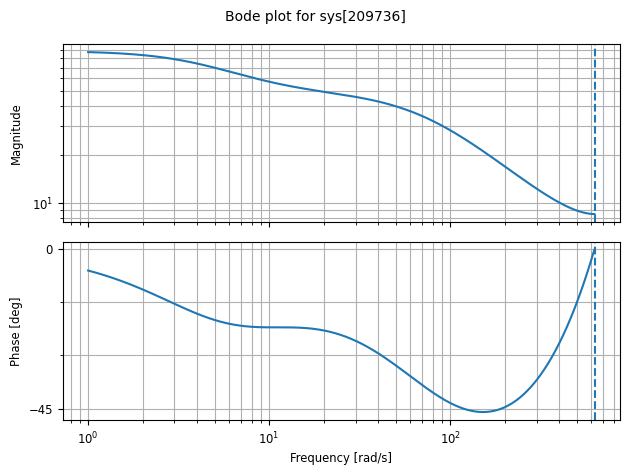

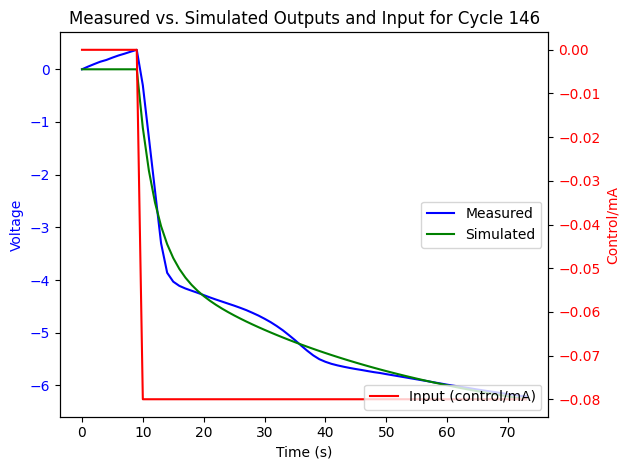

Cycle 147: G_hat_box_jenkins
<TransferFunction>: sys[209744]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.24 z^2 - 13.64 z
----------------------
z^2 - 1.693 z + 0.7002

dt = 0.005

Cycle 147: Zeros
[0.95834134+0.j 0.        +0.j]
Cycle 147: Poles
[0.97631436+0.j 0.71715587+0.j]


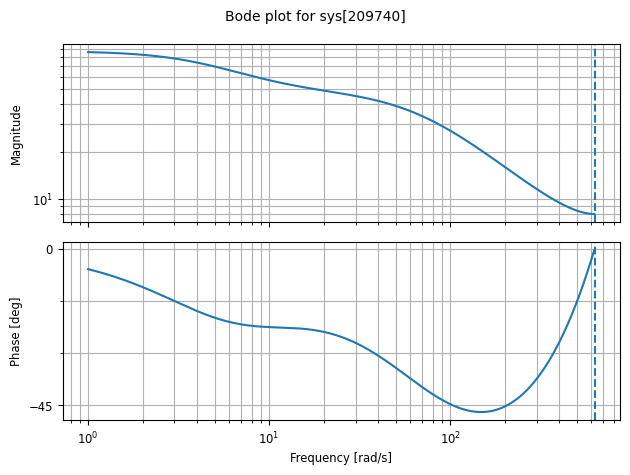

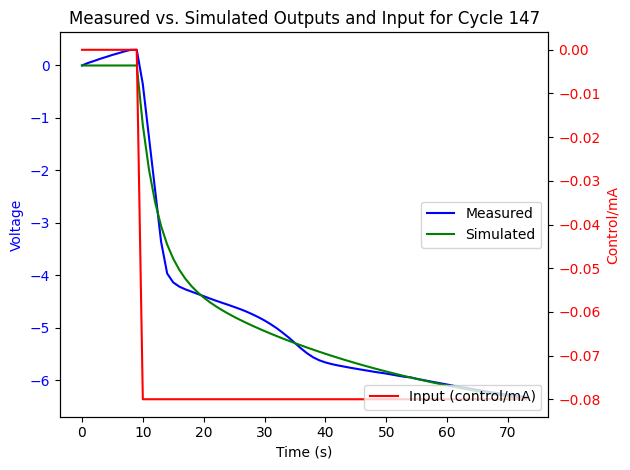

Cycle 148: G_hat_box_jenkins
<TransferFunction>: sys[209748]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.09 z^2 - 13.52 z
----------------------
z^2 - 1.704 z + 0.7104

dt = 0.005

Cycle 148: Zeros
[0.9593246+0.j 0.       +0.j]
Cycle 148: Poles
[0.97658881+0.j 0.72747389+0.j]


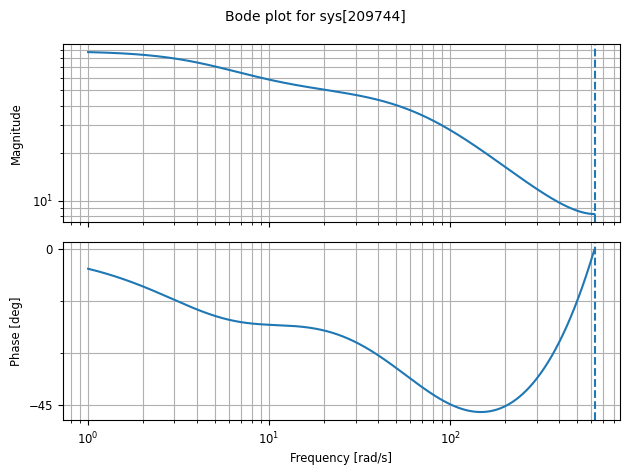

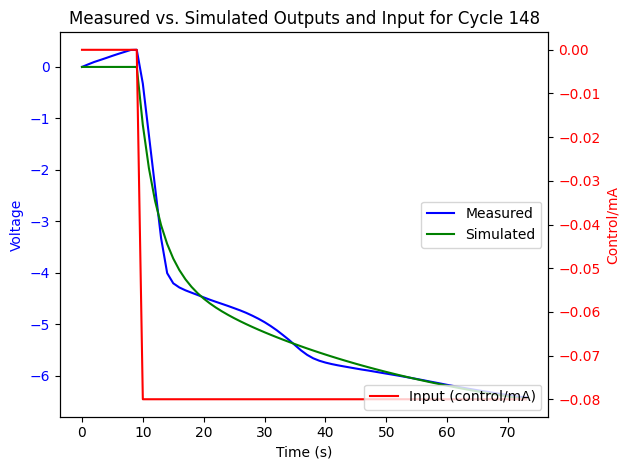

Cycle 149: G_hat_box_jenkins
<TransferFunction>: sys[209752]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  14.04 z^2 - 13.5 z
----------------------
z^2 - 1.716 z + 0.7214

dt = 0.005

Cycle 149: Zeros
[0.9617281+0.j 0.       +0.j]
Cycle 149: Poles
[0.97775019+0.j 0.73776941+0.j]


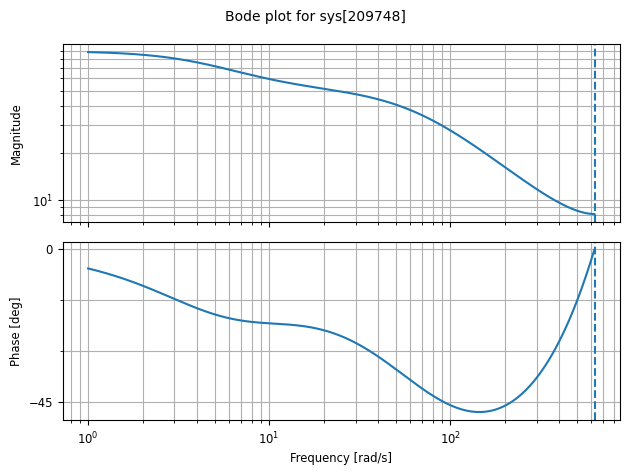

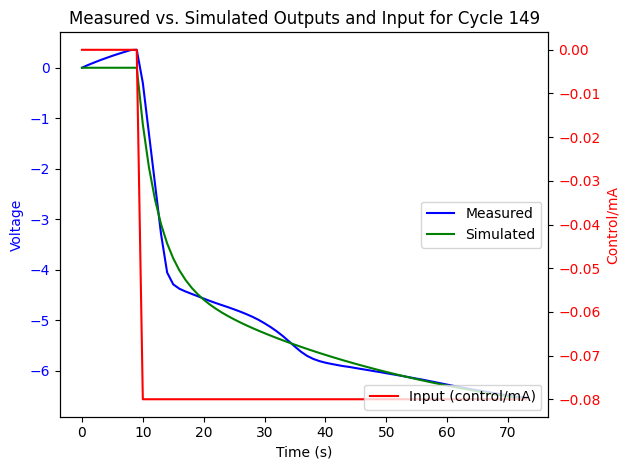

Cycle 150: G_hat_box_jenkins
<TransferFunction>: sys[209756]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.26 z^2 - 13.73 z
----------------------
z^2 - 1.721 z + 0.7267

dt = 0.005

Cycle 150: Zeros
[0.96265257+0.j 0.        +0.j]
Cycle 150: Poles
[0.97782642+0.j 0.7432169 +0.j]


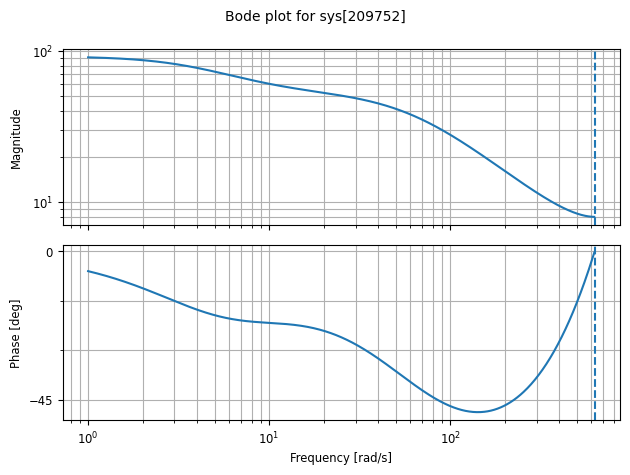

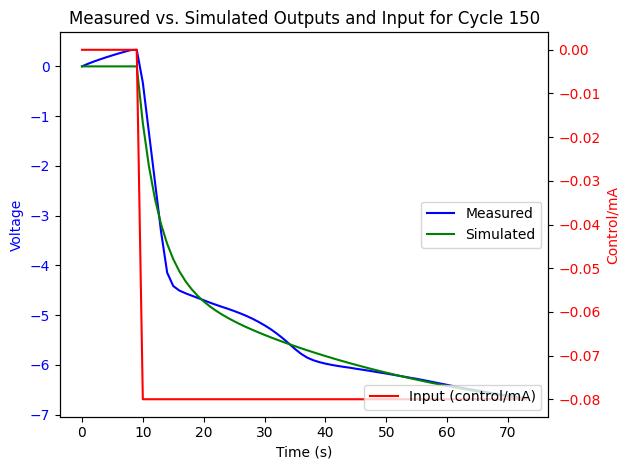

Cycle 151: G_hat_box_jenkins
<TransferFunction>: sys[209760]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.35 z^2 - 13.86 z
----------------------
z^2 - 1.729 z + 0.7341

dt = 0.005

Cycle 151: Zeros
[0.96536065+0.j 0.        +0.j]
Cycle 151: Poles
[0.97932311+0.j 0.74955804+0.j]


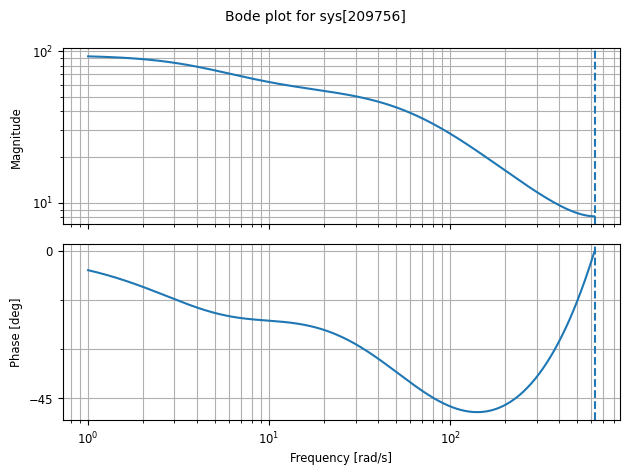

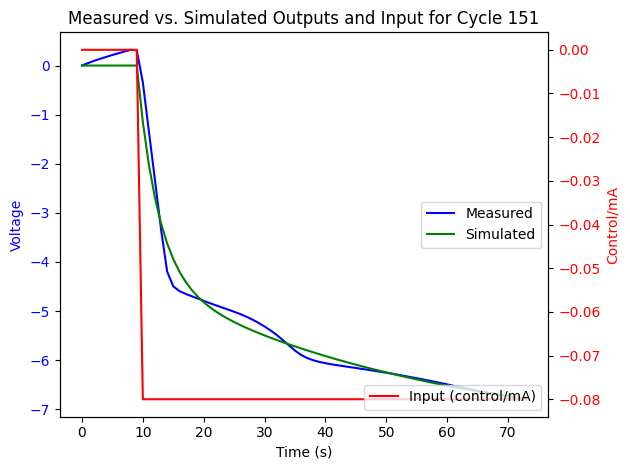

Cycle 152: G_hat_box_jenkins
<TransferFunction>: sys[209764]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.52 z^2 - 14.07 z
----------------------
z^2 - 1.738 z + 0.7427

dt = 0.005

Cycle 152: Zeros
[0.96886858+0.j 0.        +0.j]
Cycle 152: Poles
[0.98141168+0.j 0.75671903+0.j]


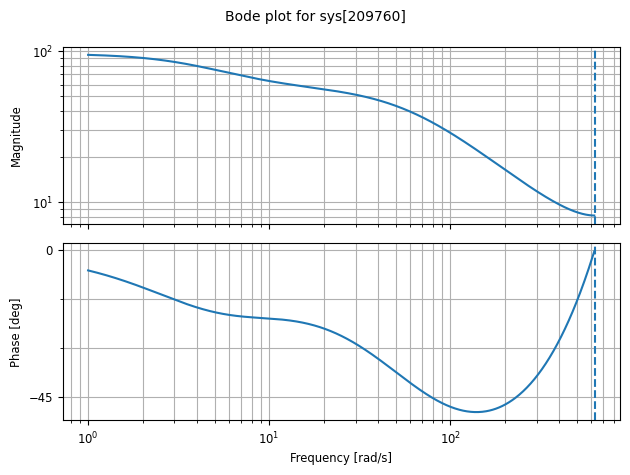

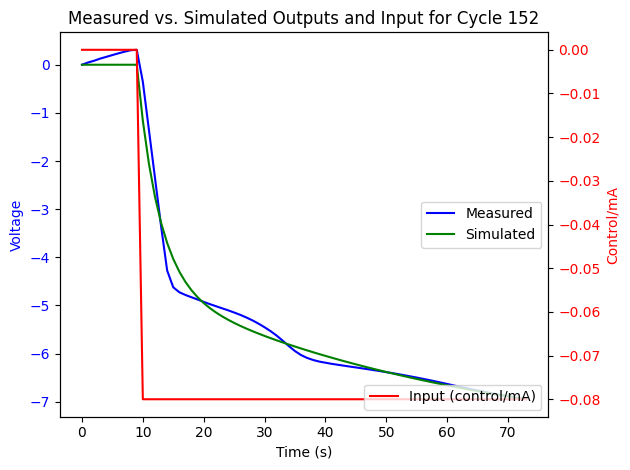

Cycle 153: G_hat_box_jenkins
<TransferFunction>: sys[209768]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.69 z^2 - 14.28 z
----------------------
z^2 - 1.746 z + 0.7499

dt = 0.005

Cycle 153: Zeros
[0.97213531+0.j 0.        +0.j]
Cycle 153: Poles
[0.98347572+0.j 0.76254702+0.j]


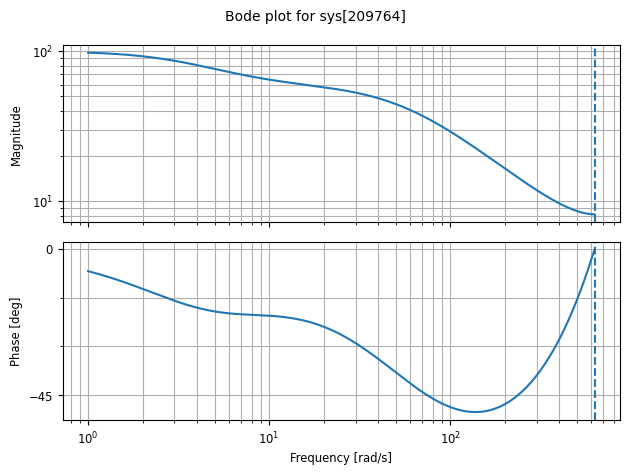

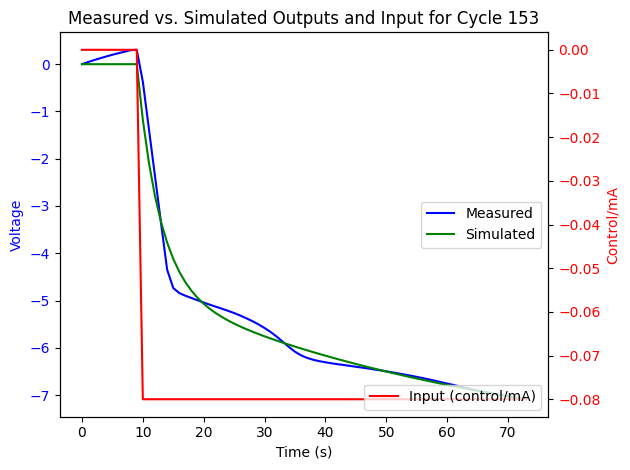

Cycle 154: G_hat_box_jenkins
<TransferFunction>: sys[209772]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.79 z^2 - 14.44 z
---------------------
z^2 - 1.755 z + 0.758

dt = 0.005

Cycle 154: Zeros
[0.97607998+0.j 0.        +0.j]
Cycle 154: Poles
[0.98619881+0.j 0.7685602 +0.j]


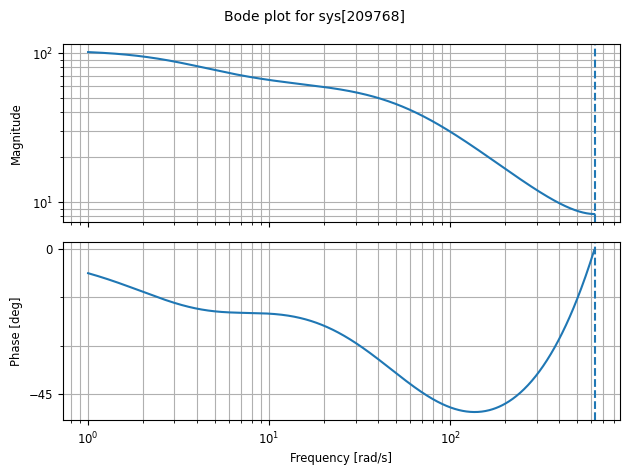

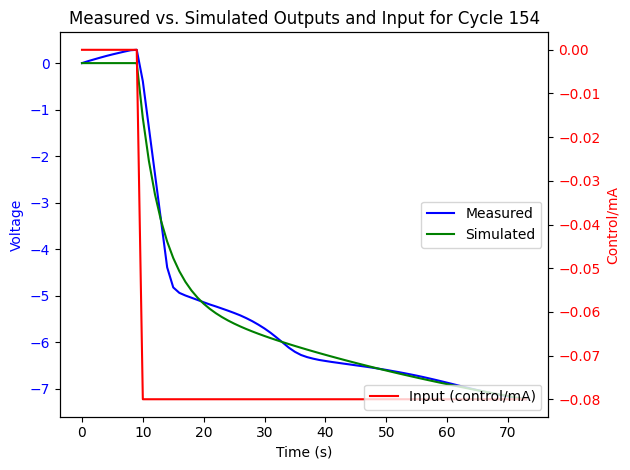

Cycle 155: G_hat_box_jenkins
<TransferFunction>: sys[209776]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.81 z^2 - 14.54 z
----------------------
z^2 - 1.765 z + 0.7674

dt = 0.005

Cycle 155: Zeros
[0.98136586+0.j 0.        +0.j]
Cycle 155: Poles
[0.99013248+0.j 0.77504281+0.j]


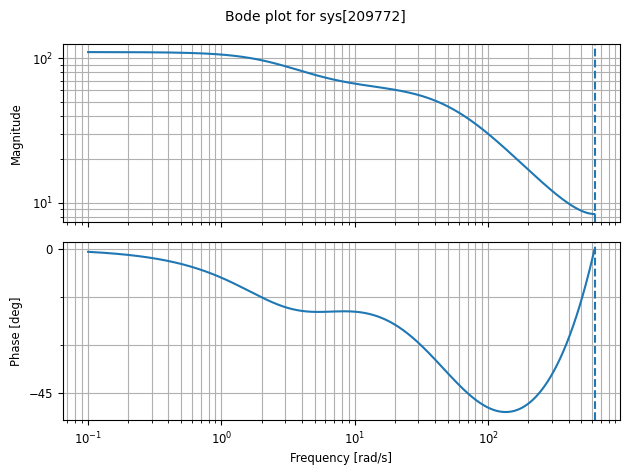

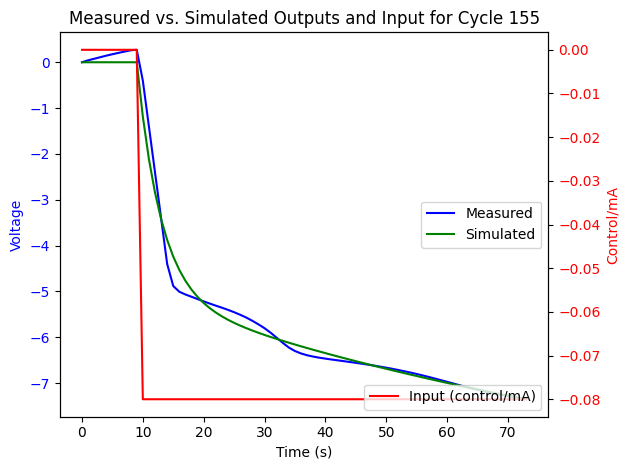

Cycle 156: G_hat_box_jenkins
<TransferFunction>: sys[209780]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  15.01 z^2 - 14.8 z
----------------------
z^2 - 1.773 z + 0.7744

dt = 0.005

Cycle 156: Zeros
[0.98595854+0.j 0.        +0.j]
Cycle 156: Poles
[0.99372207+0.j 0.77933532+0.j]


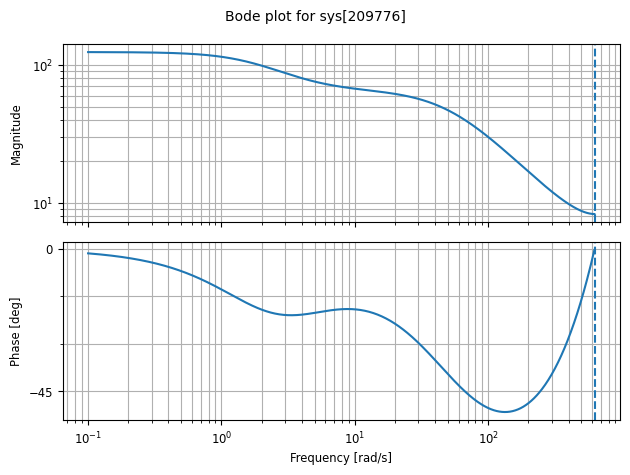

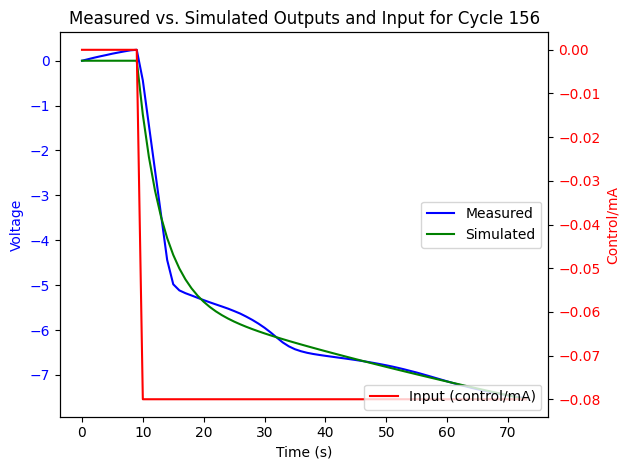

Cycle 157: G_hat_box_jenkins
<TransferFunction>: sys[209784]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 15.19 z^2 - 15.02 z
----------------------
z^2 - 1.776 z + 0.7767

dt = 0.005

Cycle 157: Zeros
[0.98859126+0.j 0.        +0.j]
Cycle 157: Poles
[0.9960458 +0.j 0.77980596+0.j]


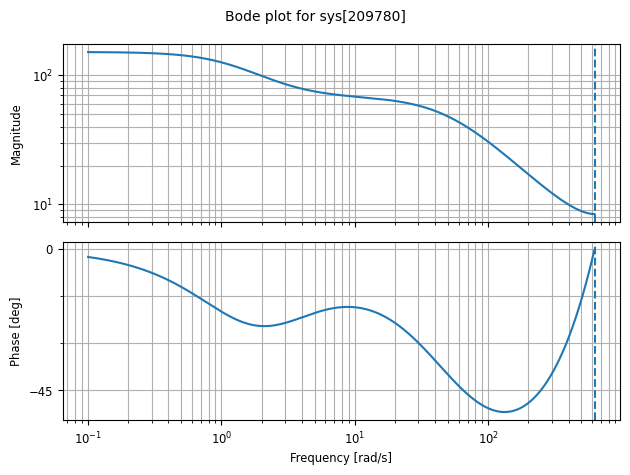

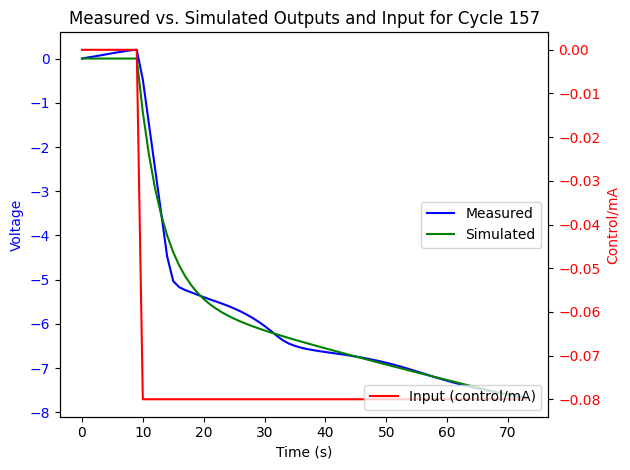

Cycle 158: G_hat_box_jenkins
<TransferFunction>: sys[209788]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


15.24 z^2 - 15.09 z
--------------------
z^2 - 1.779 z + 0.78

dt = 0.005

Cycle 158: Zeros
[0.99033992+0.j 0.        +0.j]
Cycle 158: Poles
[0.99768858+0.j 0.78180008+0.j]


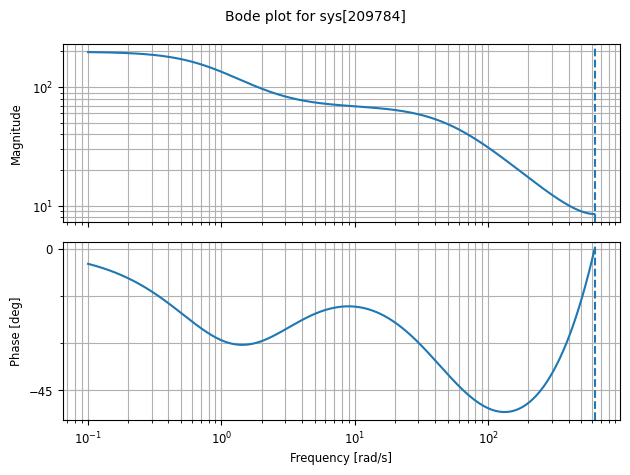

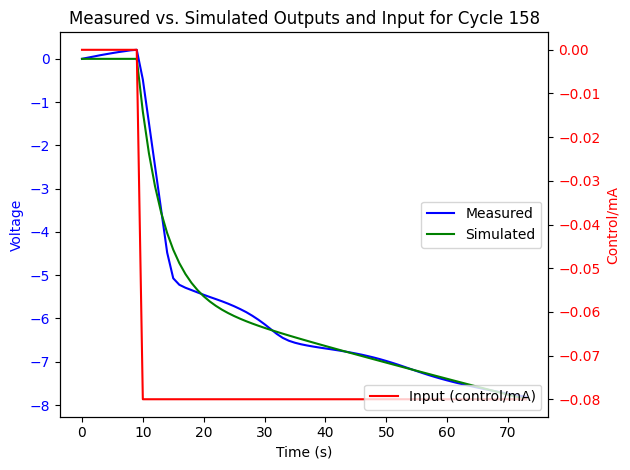

Cycle 159: G_hat_box_jenkins
<TransferFunction>: sys[209792]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 15.35 z^2 - 15.23 z
----------------------
z^2 - 1.782 z + 0.7824

dt = 0.005

Cycle 159: Zeros
[0.99206958+0.j 0.        +0.j]
Cycle 159: Poles
[0.99936538+0.j 0.78291223+0.j]


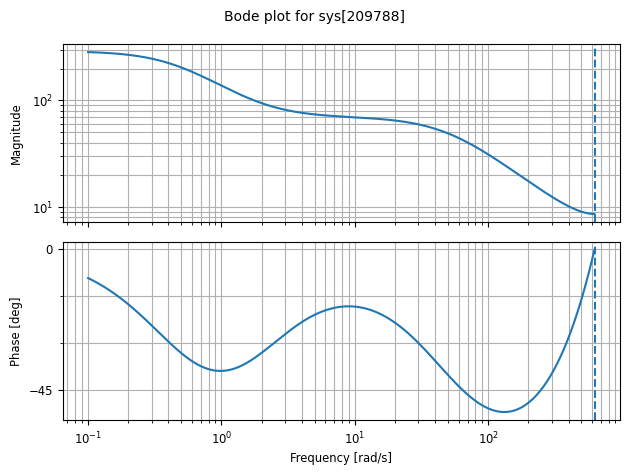

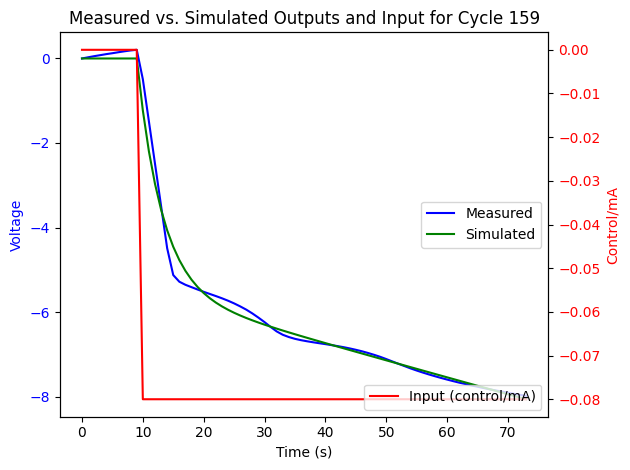

Cycle 160: G_hat_box_jenkins
<TransferFunction>: sys[209796]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 15.36 z^2 - 15.27 z
---------------------
z^2 - 1.786 z + 0.786

dt = 0.005

Cycle 160: Zeros
[0.99399445+0.j 0.        +0.j]
Cycle 160: Poles
[1.00122915+0.j 0.78498741+0.j]


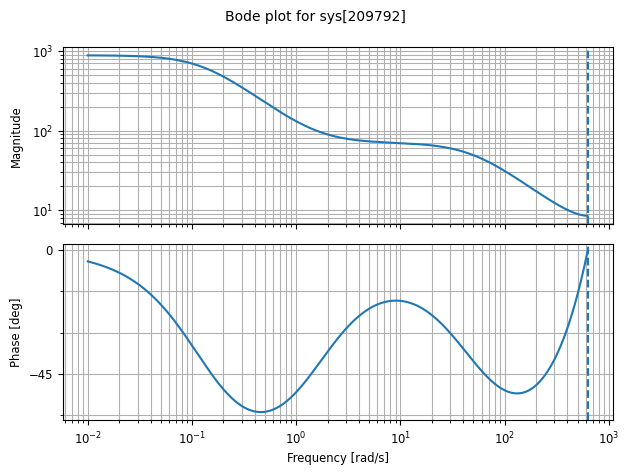

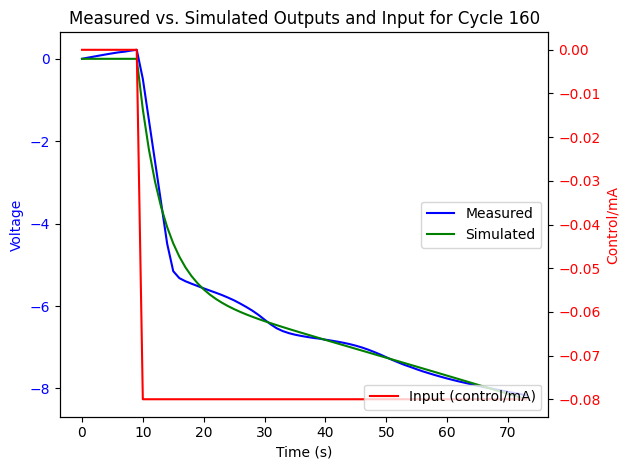

Cycle 161: G_hat_box_jenkins
<TransferFunction>: sys[209800]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 15.25 z^2 - 15.24 z
----------------------
z^2 - 1.795 z + 0.7941

dt = 0.005

Cycle 161: Zeros
[0.99941825+0.j 0.        +0.j]
Cycle 161: Poles
[1.00590284+0.j 0.78941451+0.j]


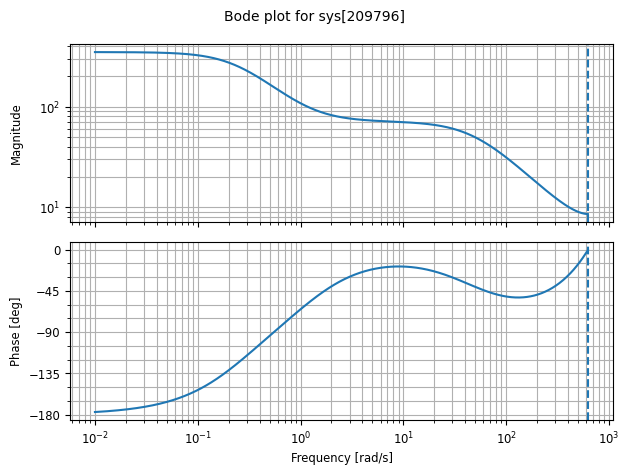

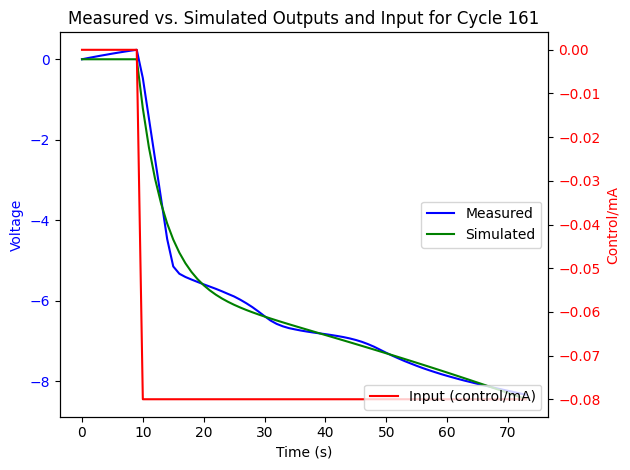

Cycle 162: G_hat_box_jenkins
<TransferFunction>: sys[209804]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 15.32 z^2 - 15.44 z
---------------------
z^2 - 1.806 z + 0.803

dt = 0.005

Cycle 162: Zeros
[1.00734091+0.j 0.        +0.j]
Cycle 162: Poles
[1.01271808+0.j 0.79292759+0.j]


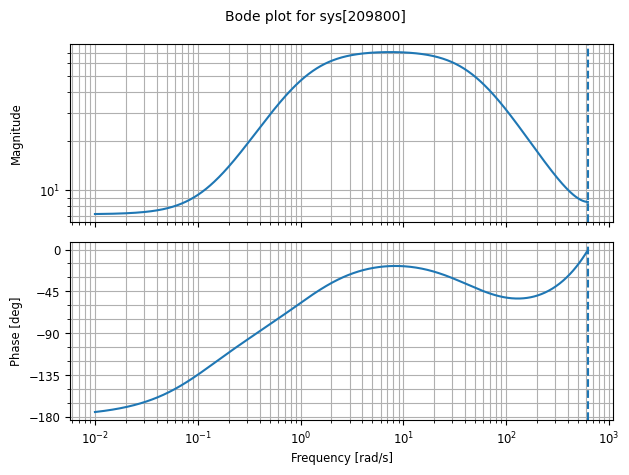

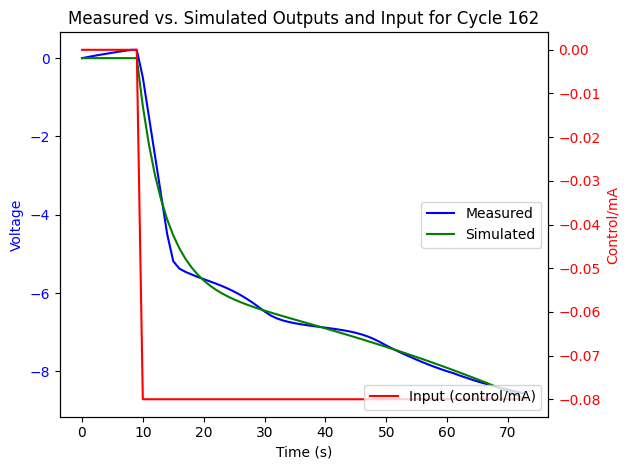

Cycle 163: G_hat_box_jenkins
<TransferFunction>: sys[209808]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 15.19 z^2 - 15.43 z
---------------------
z^2 - 1.82 z + 0.8156

dt = 0.005

Cycle 163: Zeros
[1.01591759+0.j 0.        +0.j]
Cycle 163: Poles
[1.01993158+0.j 0.79962745+0.j]


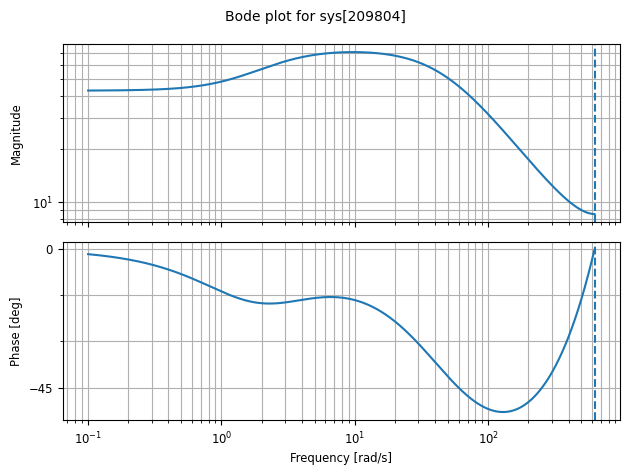

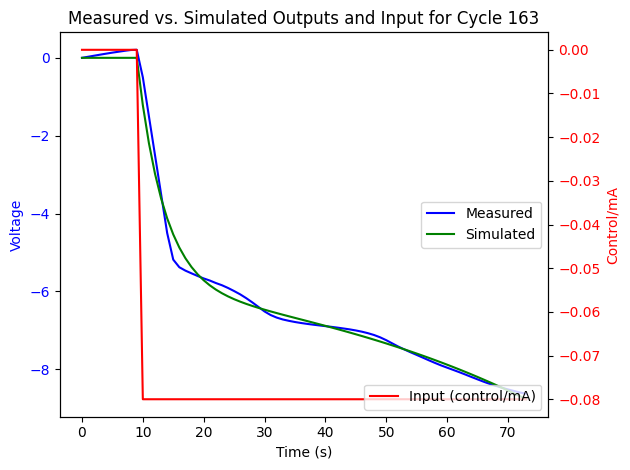

Cycle 164: G_hat_box_jenkins
<TransferFunction>: sys[209812]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 15.03 z^2 - 15.35 z
----------------------
z^2 - 1.828 z + 0.8236

dt = 0.005

Cycle 164: Zeros
[1.02114336+0.j 0.        +0.j]
Cycle 164: Poles
[1.02458856+0.j 0.80382194+0.j]


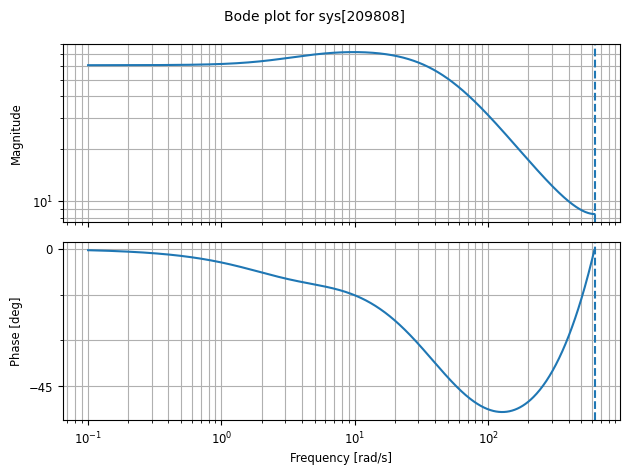

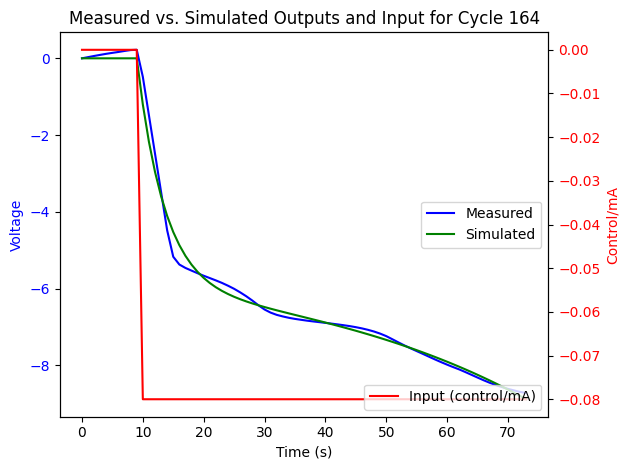

Cycle 165: G_hat_box_jenkins
<TransferFunction>: sys[209816]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.94 z^2 - 15.31 z
----------------------
z^2 - 1.834 z + 0.8291

dt = 0.005

Cycle 165: Zeros
[1.0244698+0.j 0.       +0.j]
Cycle 165: Poles
[1.02755019+0.j 0.80690402+0.j]


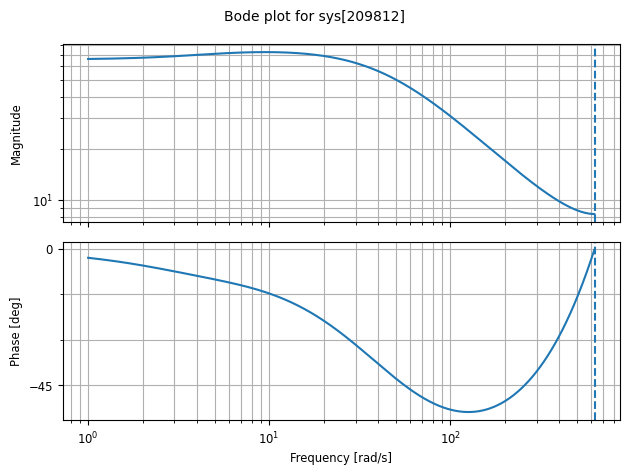

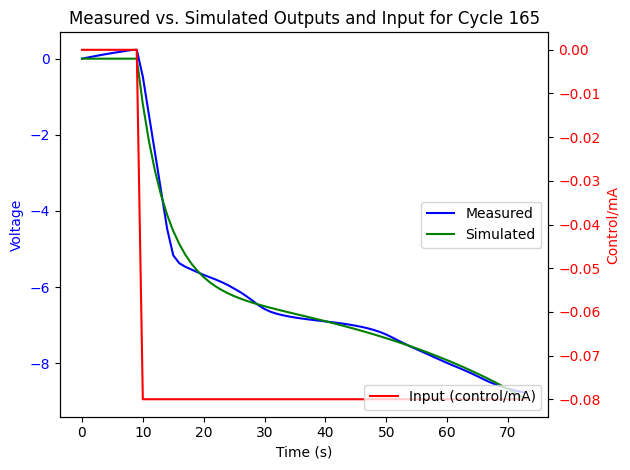

Cycle 166: G_hat_box_jenkins
<TransferFunction>: sys[209820]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.85 z^2 - 15.25 z
---------------------
z^2 - 1.84 z + 0.8343

dt = 0.005

Cycle 166: Zeros
[1.02747801+0.j 0.        +0.j]
Cycle 166: Poles
[1.03027054+0.j 0.80974376+0.j]


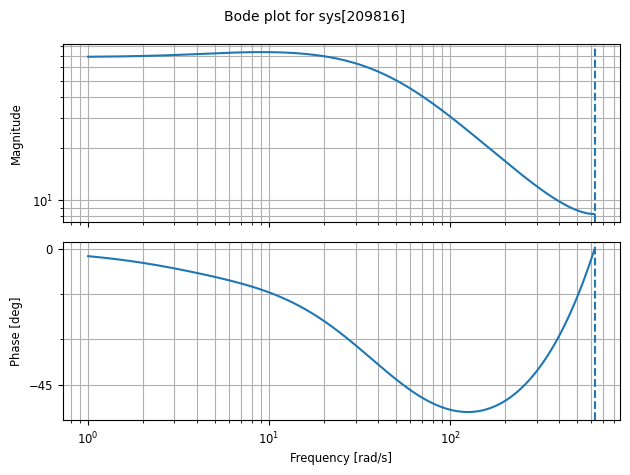

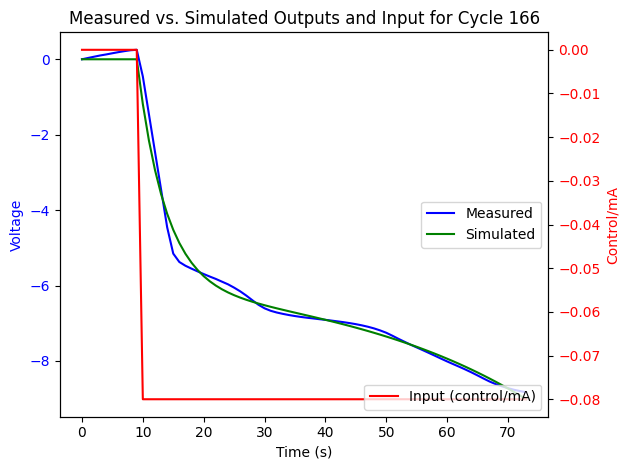

Cycle 167: G_hat_box_jenkins
<TransferFunction>: sys[209824]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.86 z^2 - 15.26 z
---------------------
z^2 - 1.84 z + 0.8344

dt = 0.005

Cycle 167: Zeros
[1.02723337+0.j 0.        +0.j]
Cycle 167: Poles
[1.03009202+0.j 0.81006273+0.j]


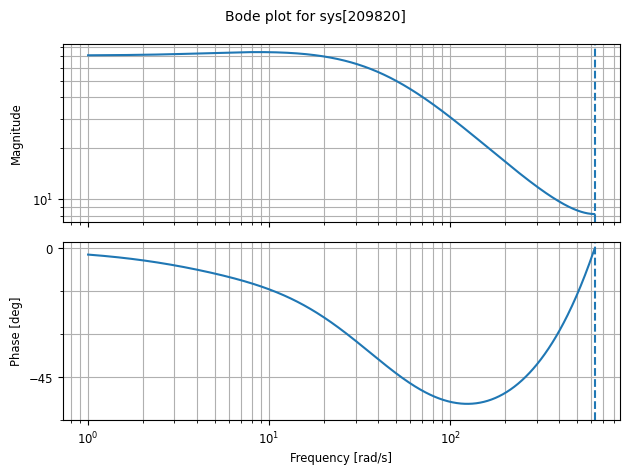

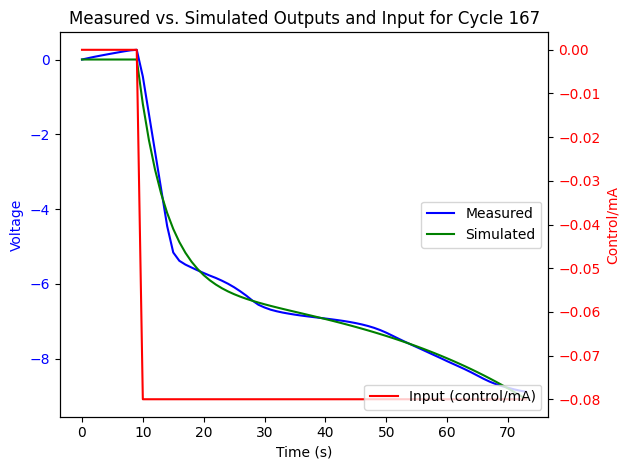

Cycle 168: G_hat_box_jenkins
<TransferFunction>: sys[209828]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.83 z^2 - 15.22 z
----------------------
z^2 - 1.839 z + 0.8339

dt = 0.005

Cycle 168: Zeros
[1.02614291+0.j 0.        +0.j]
Cycle 168: Poles
[1.02918309+0.j 0.81022427+0.j]


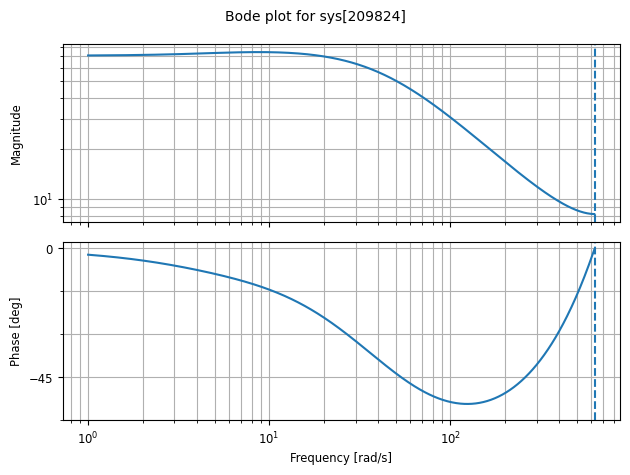

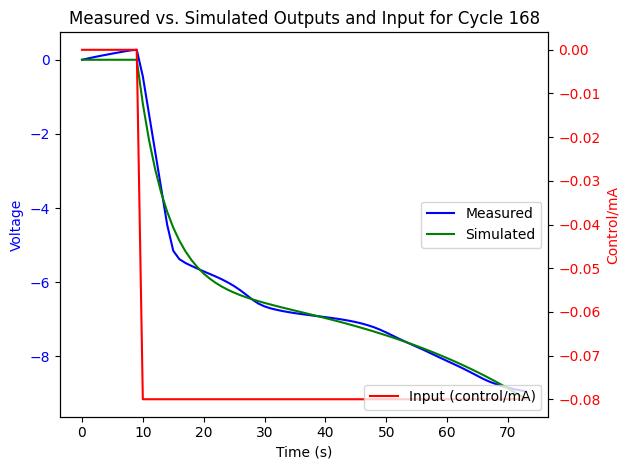

Cycle 169: G_hat_box_jenkins
<TransferFunction>: sys[209832]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.8 z^2 - 15.18 z
---------------------
z^2 - 1.84 z + 0.8341

dt = 0.005

Cycle 169: Zeros
[1.02593005+0.j 0.        +0.j]
Cycle 169: Poles
[1.02898658+0.j 0.81059768+0.j]


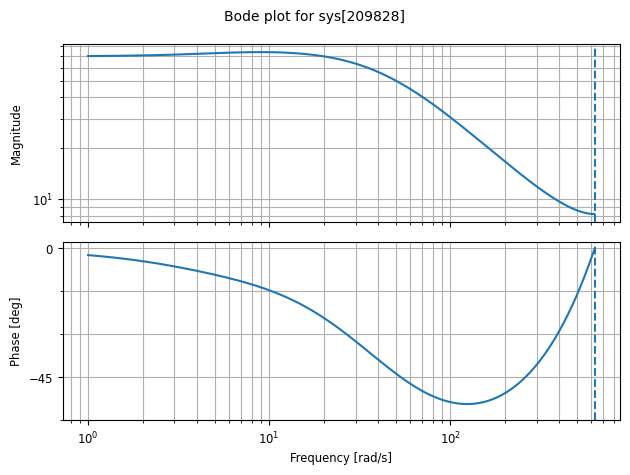

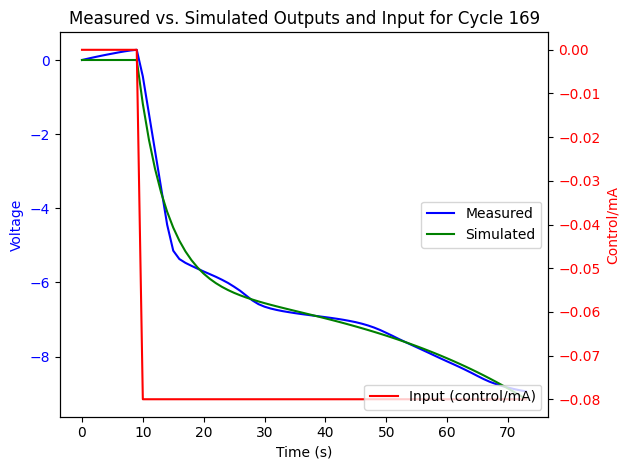

Cycle 170: G_hat_box_jenkins
<TransferFunction>: sys[209836]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.72 z^2 - 15.11 z
---------------------
z^2 - 1.841 z + 0.835

dt = 0.005

Cycle 170: Zeros
[1.02634621+0.j 0.        +0.j]
Cycle 170: Poles
[1.02937869+0.j 0.81112961+0.j]


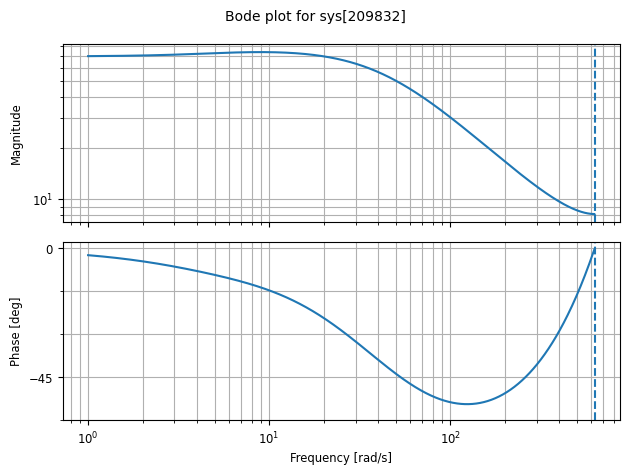

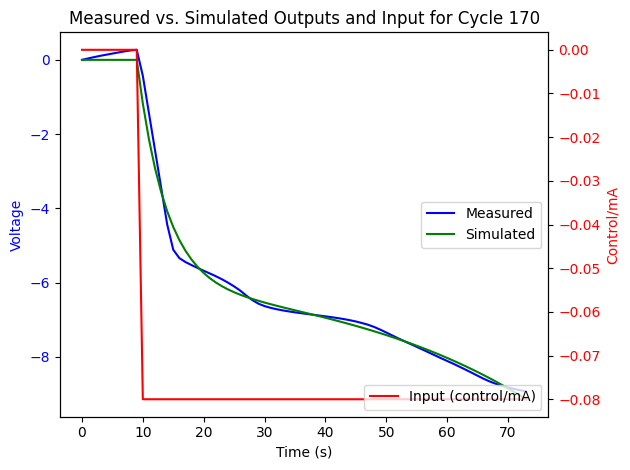

Cycle 171: G_hat_box_jenkins
<TransferFunction>: sys[209840]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.73 z^2 - 15.11 z
----------------------
z^2 - 1.841 z + 0.8352

dt = 0.005

Cycle 171: Zeros
[1.0263786+0.j 0.       +0.j]
Cycle 171: Poles
[1.02942359+0.j 0.81131721+0.j]


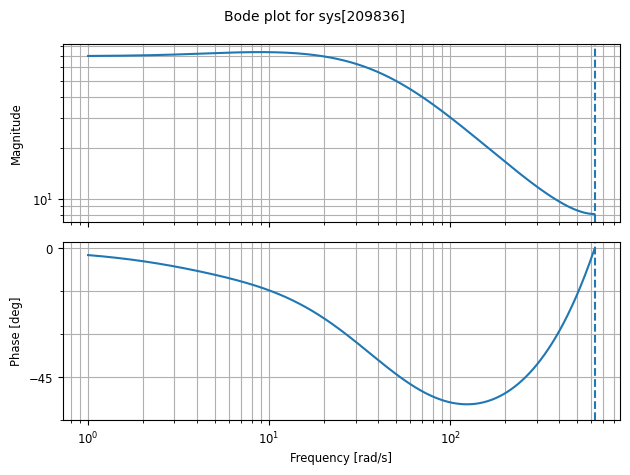

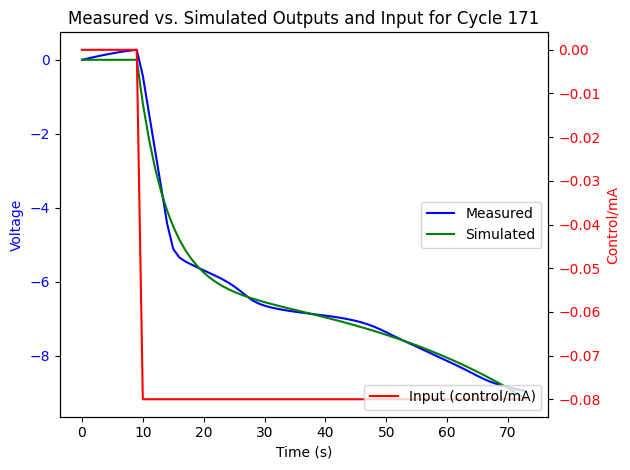

Cycle 172: G_hat_box_jenkins
<TransferFunction>: sys[209844]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.64 z^2 - 15.03 z
---------------------
z^2 - 1.842 z + 0.836

dt = 0.005

Cycle 172: Zeros
[1.02663816+0.j 0.        +0.j]
Cycle 172: Poles
[1.02970414+0.j 0.81186738+0.j]


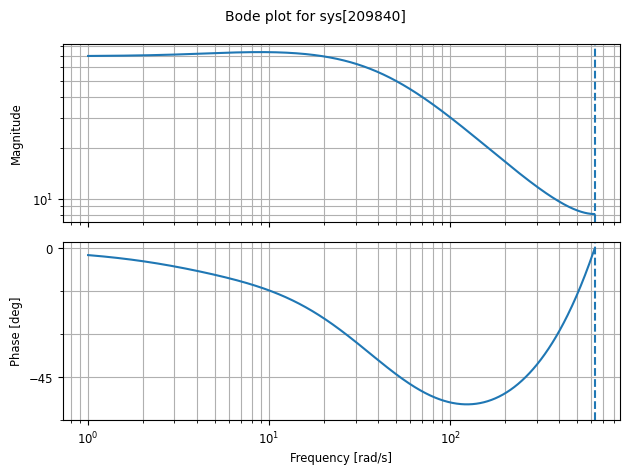

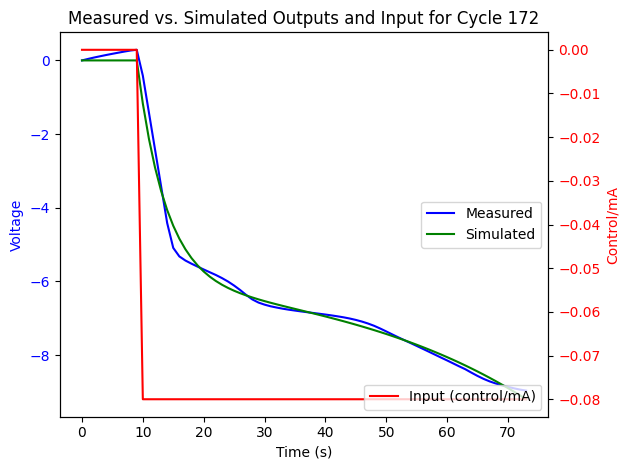

Cycle 173: G_hat_box_jenkins
<TransferFunction>: sys[209848]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


   14.6 z^2 - 15 z
----------------------
z^2 - 1.843 z + 0.8375

dt = 0.005

Cycle 173: Zeros
[1.02721136+0.j 0.        +0.j]
Cycle 173: Poles
[1.03024526+0.j 0.8128849 +0.j]


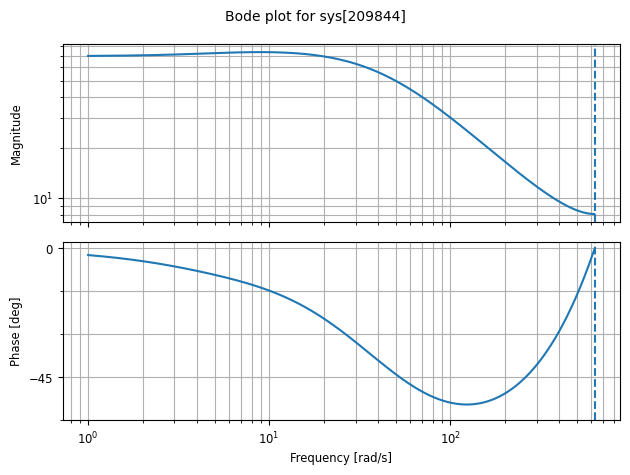

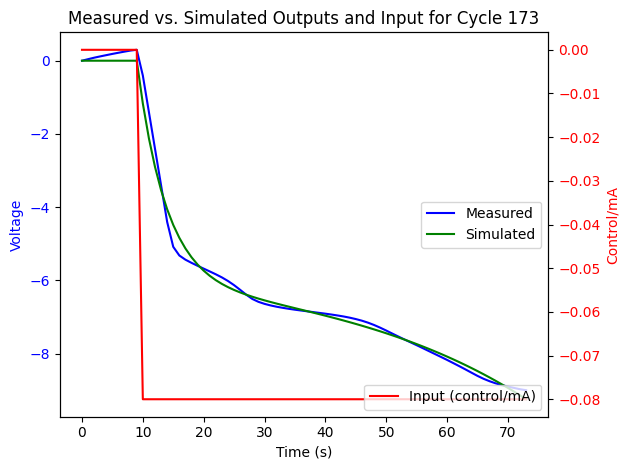

Cycle 174: G_hat_box_jenkins
<TransferFunction>: sys[209852]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


   14.6 z^2 - 15 z
----------------------
z^2 - 1.843 z + 0.8372

dt = 0.005

Cycle 174: Zeros
[1.02689139+0.j 0.        +0.j]
Cycle 174: Poles
[1.02999513+0.j 0.81283359+0.j]


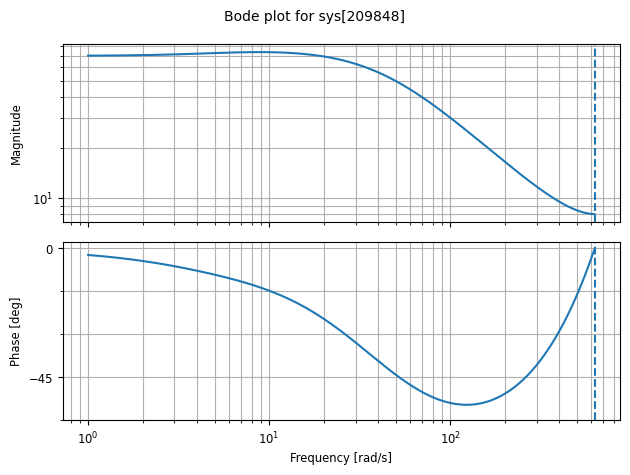

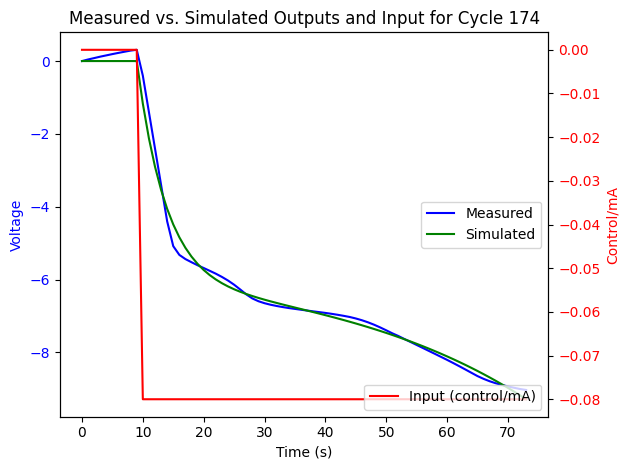

Cycle 175: G_hat_box_jenkins
<TransferFunction>: sys[209856]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.59 z^2 - 14.97 z
----------------------
z^2 - 1.842 z + 0.8361

dt = 0.005

Cycle 175: Zeros
[1.02564914+0.j 0.        +0.j]
Cycle 175: Poles
[1.02895904+0.j 0.81260191+0.j]


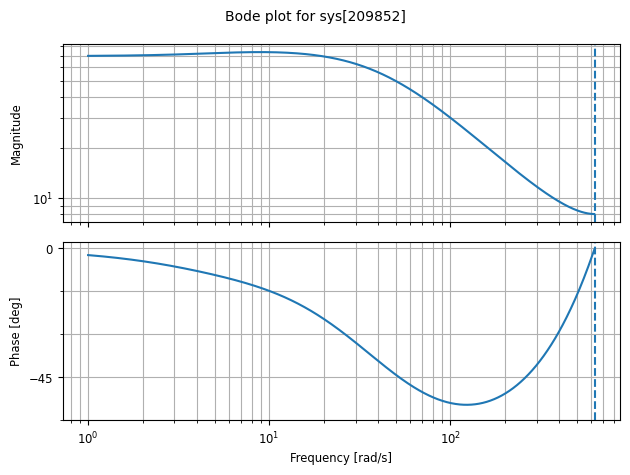

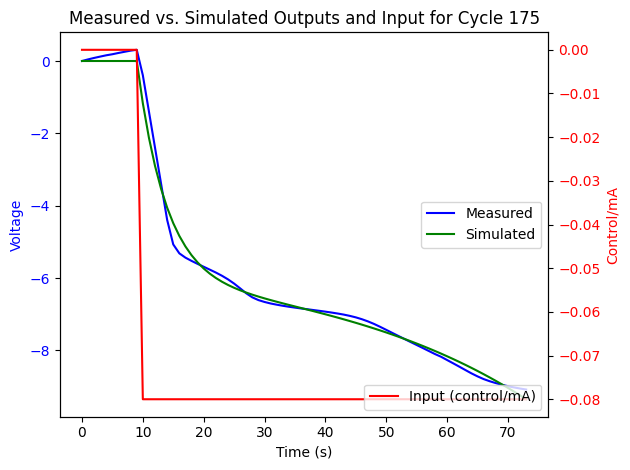

Cycle 176: G_hat_box_jenkins
<TransferFunction>: sys[209860]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 14.63 z^2 - 14.97 z
----------------------
z^2 - 1.838 z + 0.8333

dt = 0.005

Cycle 176: Zeros
[1.02349939+0.j 0.        +0.j]
Cycle 176: Poles
[1.02713792+0.j 0.81125781+0.j]


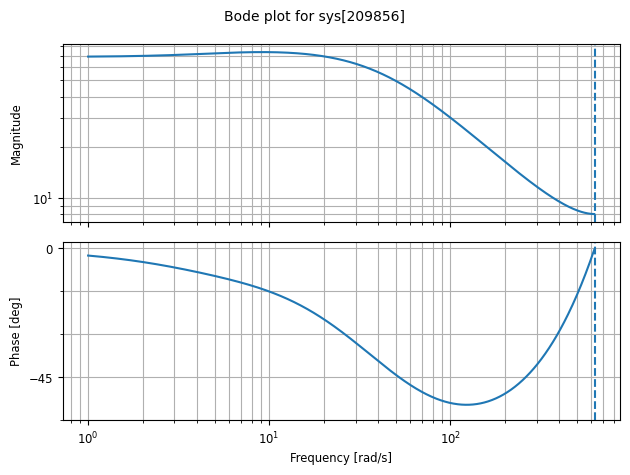

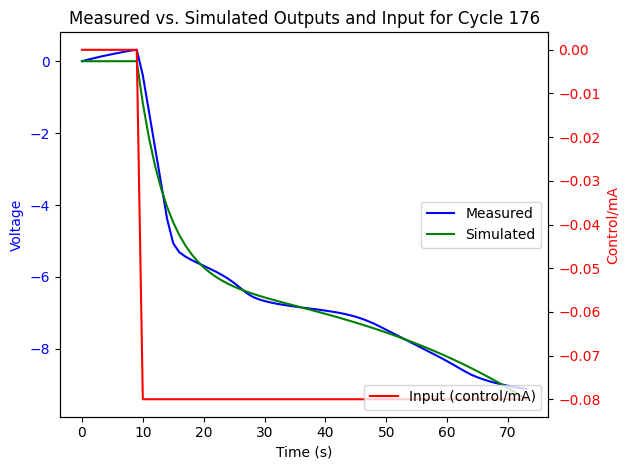

Cycle 177: G_hat_box_jenkins
<TransferFunction>: sys[209864]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.981 z^2 - 9.311 z
----------------------
z^2 - 1.705 z + 0.7132

dt = 0.005

Cycle 177: Zeros
[0.93289612+0.j 0.        +0.j]
Cycle 177: Poles
[0.96854016+0.j 0.73634965+0.j]


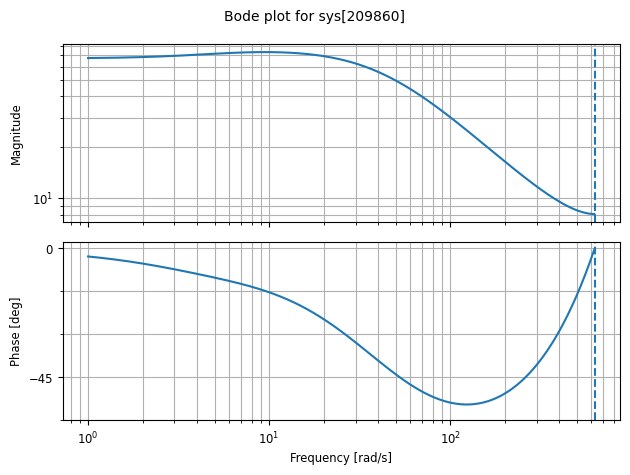

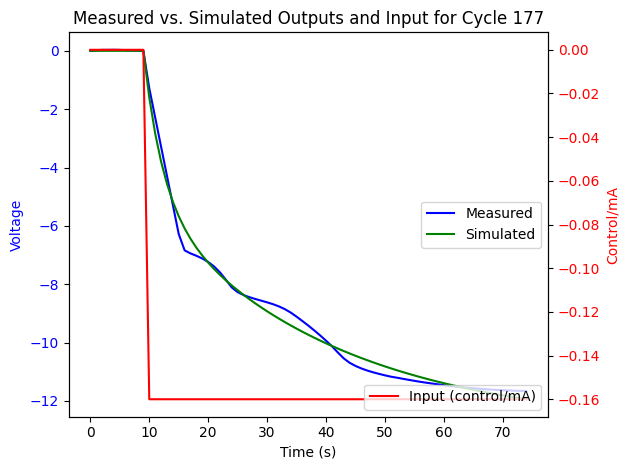

Cycle 178: G_hat_box_jenkins
<TransferFunction>: sys[209868]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.386 z^2 - 8.255 z
----------------------
z^2 - 1.782 z + 0.7828

dt = 0.005

Cycle 178: Zeros
[0.98432912+0.j 0.        +0.j]
Cycle 178: Poles
[0.99766321+0.j 0.78461197+0.j]


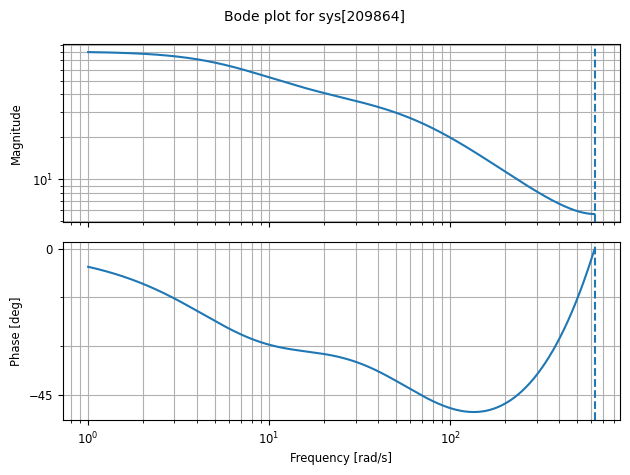

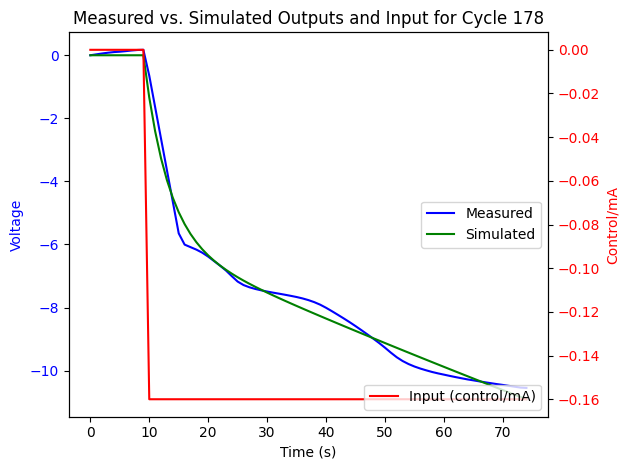

Cycle 179: G_hat_box_jenkins
<TransferFunction>: sys[209872]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.057 z^2 - 7.965 z
----------------------
z^2 - 1.787 z + 0.7873

dt = 0.005

Cycle 179: Zeros
[0.98866585+0.j 0.        +0.j]
Cycle 179: Poles
[1.00075023+0.j 0.78668948+0.j]


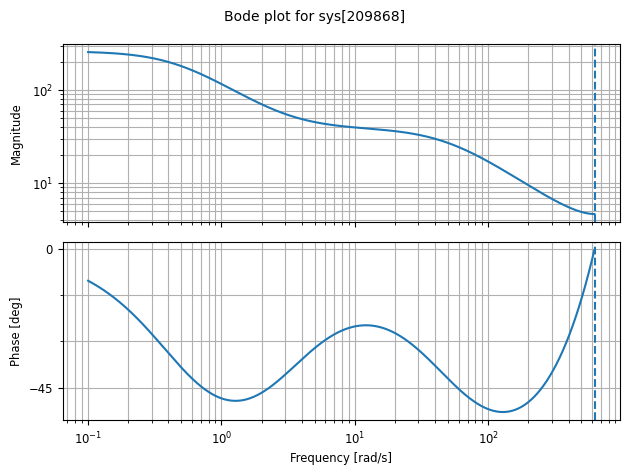

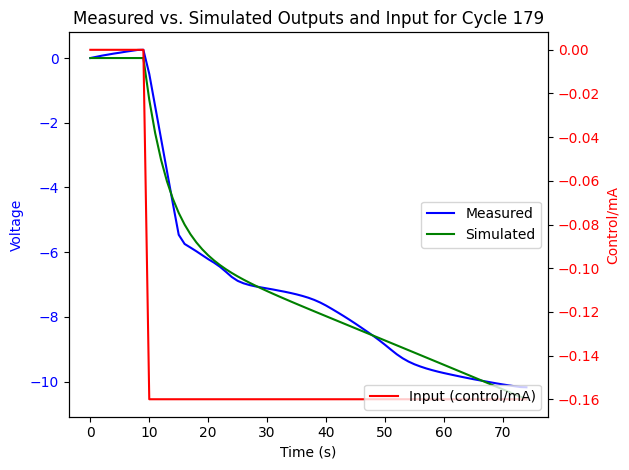

Cycle 180: G_hat_box_jenkins
<TransferFunction>: sys[209876]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  8.06 z^2 - 7.98 z
----------------------
z^2 - 1.791 z + 0.7906

dt = 0.005

Cycle 180: Zeros
[0.99001492+0.j 0.        +0.j]
Cycle 180: Poles
[1.00177505+0.j 0.78921954+0.j]


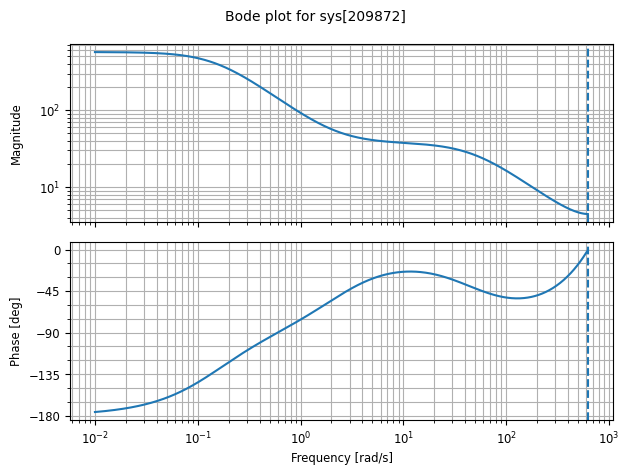

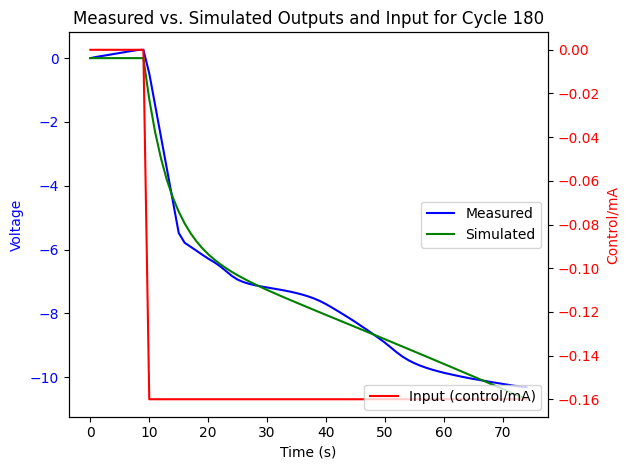

Cycle 181: G_hat_box_jenkins
<TransferFunction>: sys[209880]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  8.02 z^2 - 7.947 z
----------------------
z^2 - 1.792 z + 0.7912

dt = 0.005

Cycle 181: Zeros
[0.99086307+0.j 0.        +0.j]
Cycle 181: Poles
[1.00241651+0.j 0.78924301+0.j]


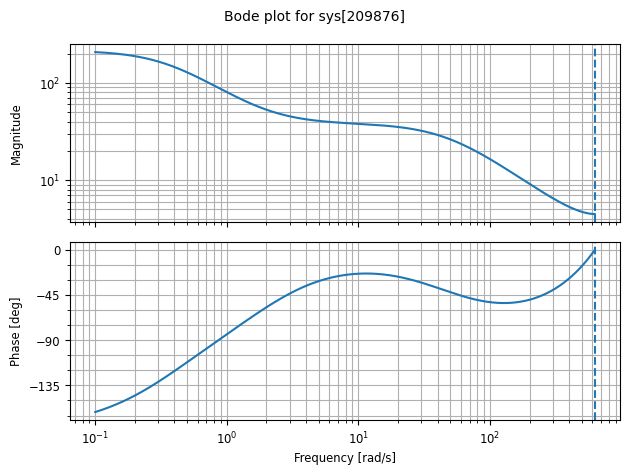

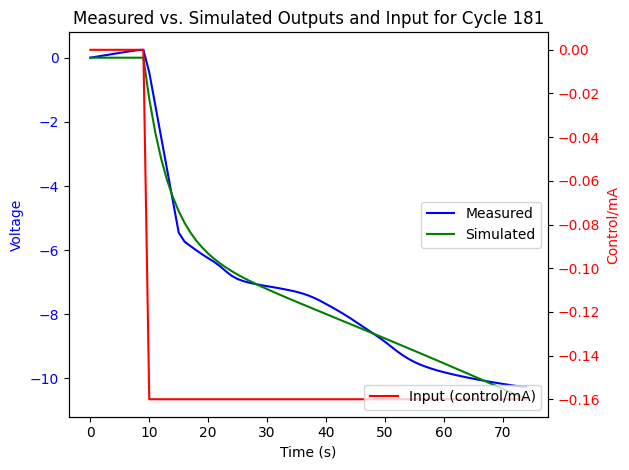

Cycle 182: G_hat_box_jenkins
<TransferFunction>: sys[209884]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 7.975 z^2 - 7.869 z
----------------------
z^2 - 1.791 z + 0.7908

dt = 0.005

Cycle 182: Zeros
[0.98677525+0.j 0.        +0.j]
Cycle 182: Poles
[0.99927989+0.j 0.79140463+0.j]


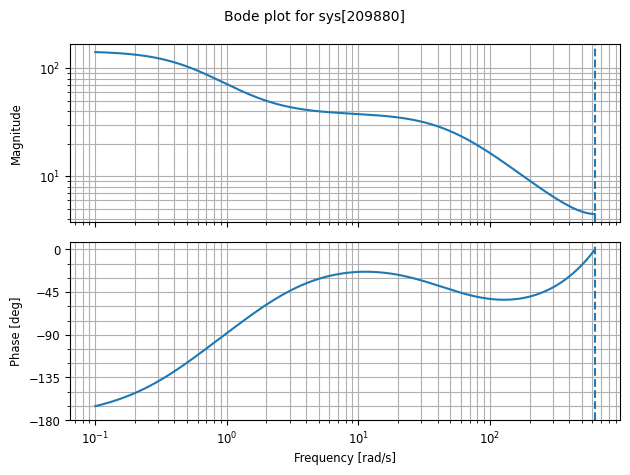

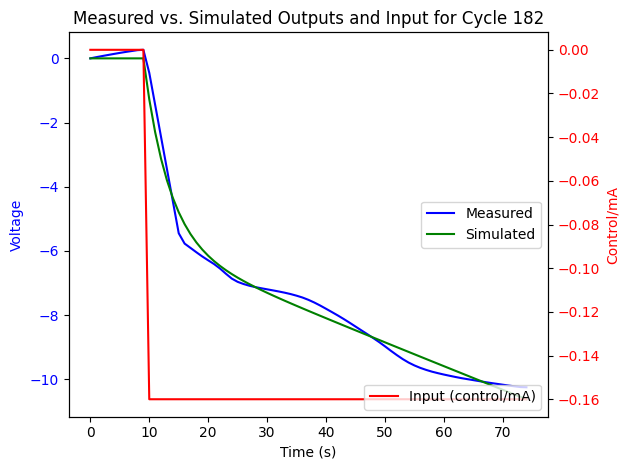

Cycle 183: G_hat_box_jenkins
<TransferFunction>: sys[209888]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.023 z^2 - 7.898 z
---------------------
z^2 - 1.79 z + 0.7904

dt = 0.005

Cycle 183: Zeros
[0.98437406+0.j 0.        +0.j]
Cycle 183: Poles
[0.9973833 +0.j 0.79242563+0.j]


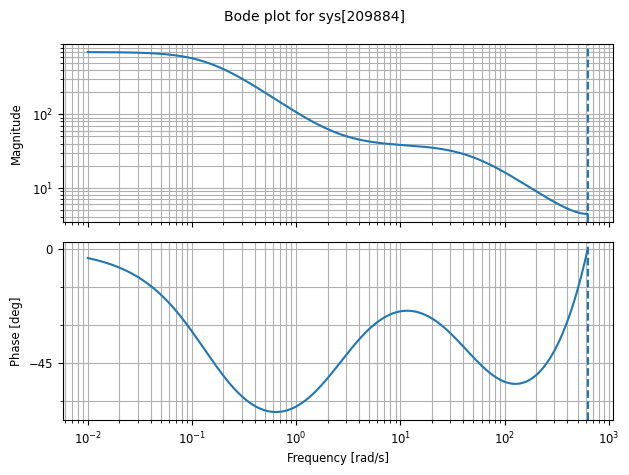

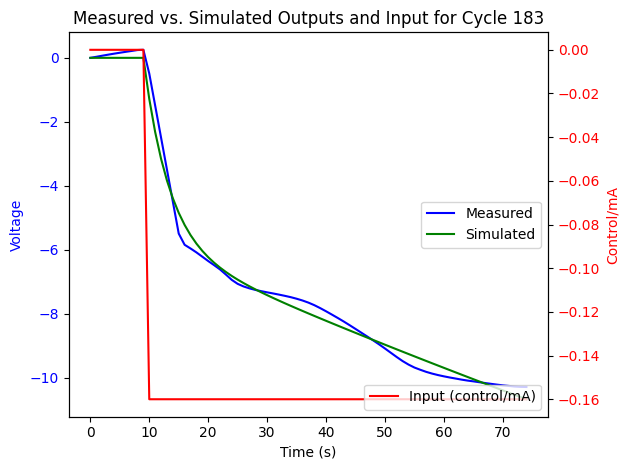

Cycle 184: G_hat_box_jenkins
<TransferFunction>: sys[209892]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  8.1 z^2 - 7.983 z
----------------------
z^2 - 1.792 z + 0.7923

dt = 0.005

Cycle 184: Zeros
[0.98560596+0.j 0.        +0.j]
Cycle 184: Poles
[0.99822881+0.j 0.79368565+0.j]


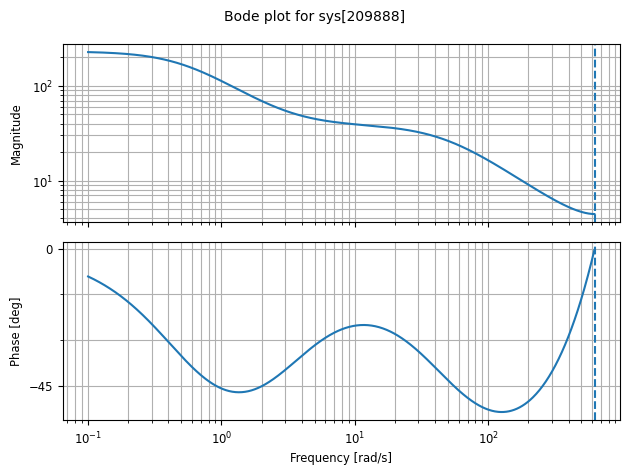

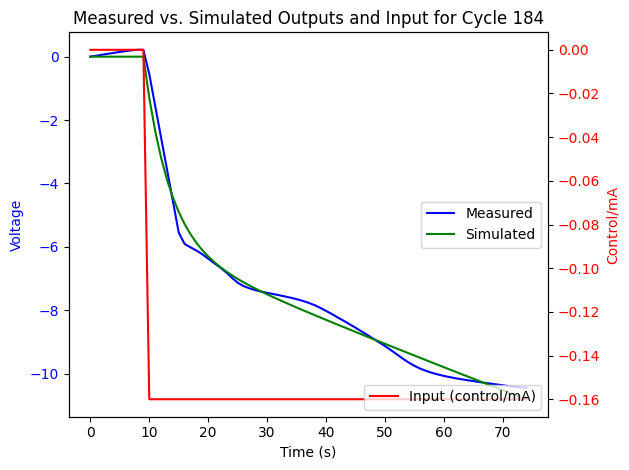

Cycle 185: G_hat_box_jenkins
<TransferFunction>: sys[209896]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.088 z^2 - 7.974 z
----------------------
z^2 - 1.792 z + 0.7927

dt = 0.005

Cycle 185: Zeros
[0.98594762+0.j 0.        +0.j]
Cycle 185: Poles
[0.99863846+0.j 0.79376014+0.j]


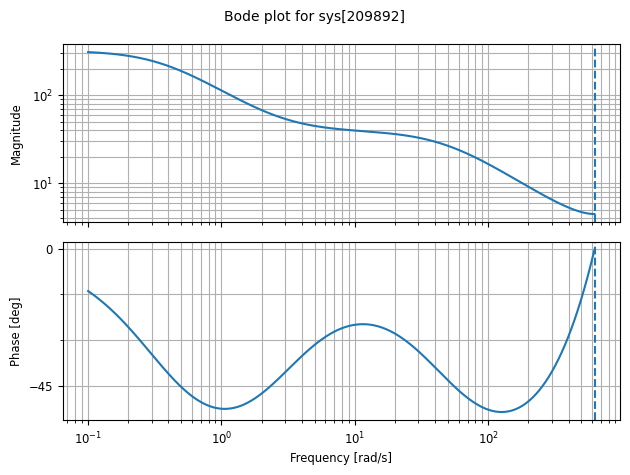

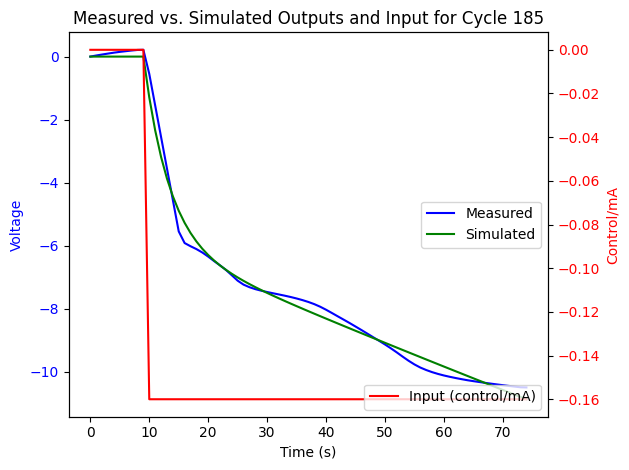

Cycle 186: G_hat_box_jenkins
<TransferFunction>: sys[209900]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.189 z^2 - 8.055 z
----------------------
z^2 - 1.788 z + 0.7883

dt = 0.005

Cycle 186: Zeros
[0.98354262+0.j 0.        +0.j]
Cycle 186: Poles
[0.99716151+0.j 0.79053976+0.j]


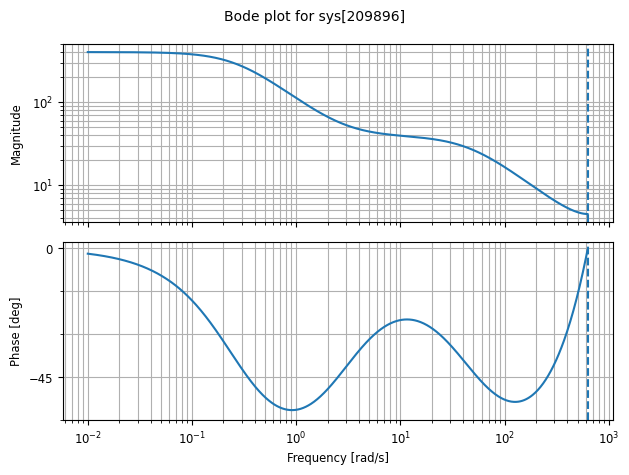

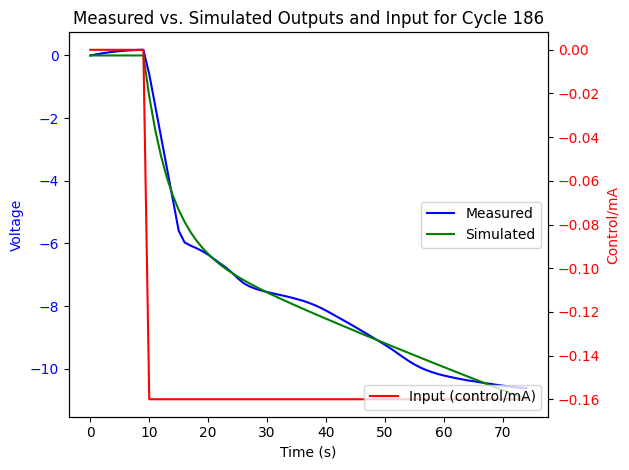

Cycle 187: G_hat_box_jenkins
<TransferFunction>: sys[209904]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.366 z^2 - 8.212 z
---------------------
z^2 - 1.781 z + 0.782

dt = 0.005

Cycle 187: Zeros
[0.981625+0.j 0.      +0.j]
Cycle 187: Poles
[0.99608383+0.j 0.78508755+0.j]


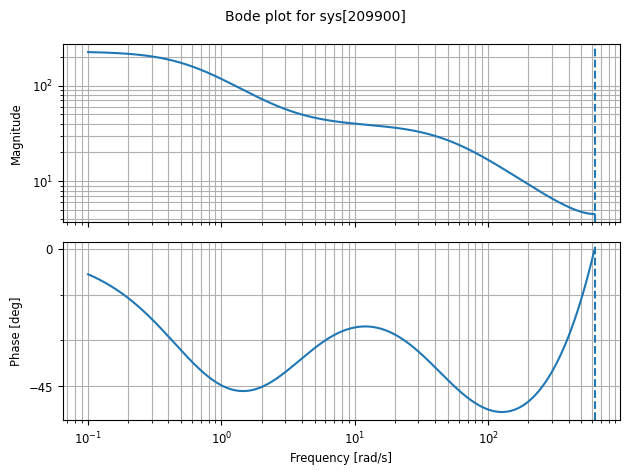

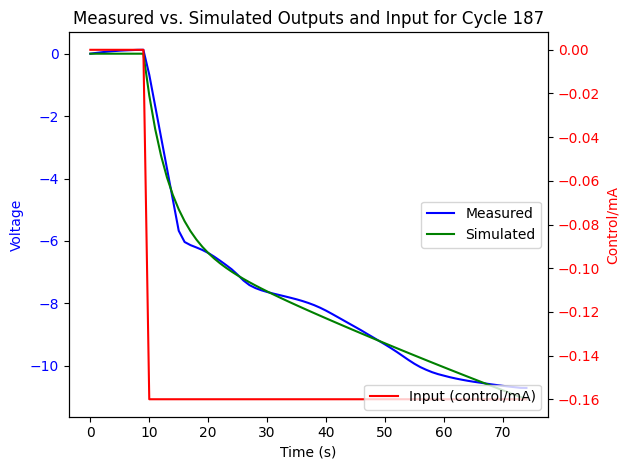

Cycle 188: G_hat_box_jenkins
<TransferFunction>: sys[209908]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.348 z^2 - 8.179 z
----------------------
z^2 - 1.778 z + 0.7792

dt = 0.005

Cycle 188: Zeros
[0.97976231+0.j 0.        +0.j]
Cycle 188: Poles
[0.99505999+0.j 0.7830889 +0.j]


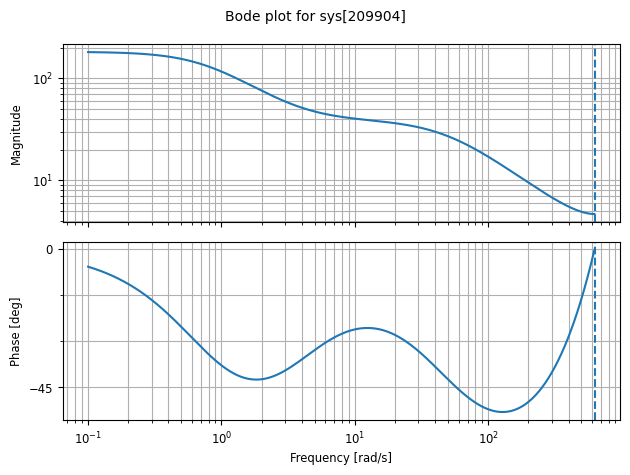

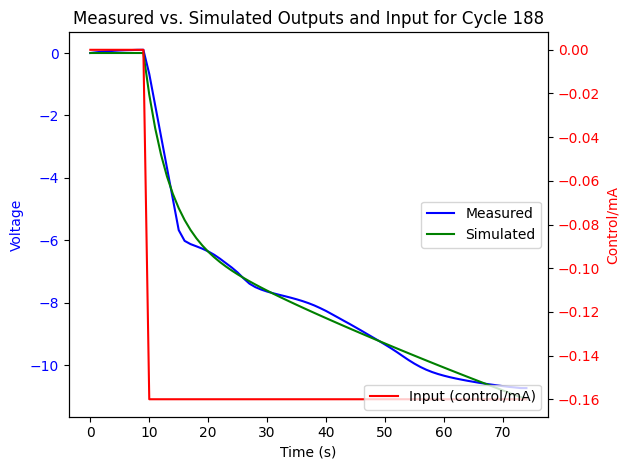

Cycle 189: G_hat_box_jenkins
<TransferFunction>: sys[209912]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.489 z^2 - 8.301 z
----------------------
z^2 - 1.771 z + 0.7726

dt = 0.005

Cycle 189: Zeros
[0.97794501+0.j 0.        +0.j]
Cycle 189: Poles
[0.99434082+0.j 0.77696847+0.j]


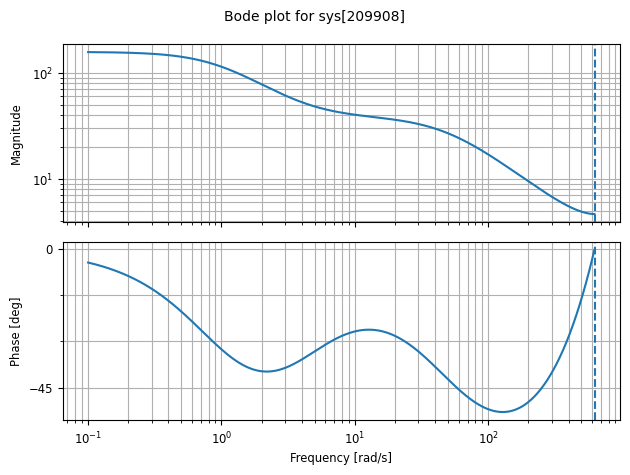

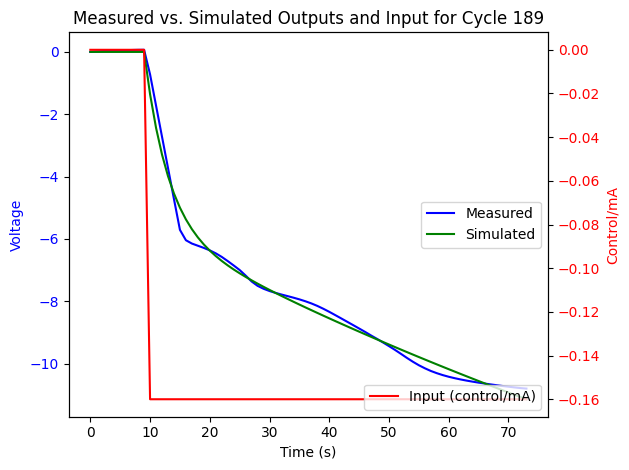

Cycle 190: G_hat_box_jenkins
<TransferFunction>: sys[209916]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.464 z^2 - 8.267 z
----------------------
z^2 - 1.767 z + 0.7689

dt = 0.005

Cycle 190: Zeros
[0.97672917+0.j 0.        +0.j]
Cycle 190: Poles
[0.993985  +0.j 0.77350702+0.j]


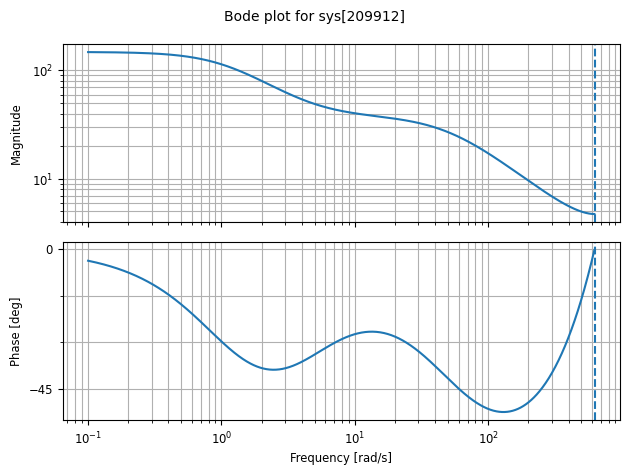

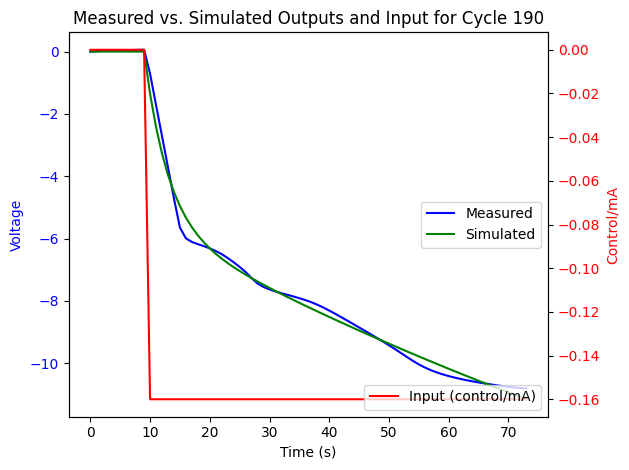

Cycle 191: G_hat_box_jenkins
<TransferFunction>: sys[209920]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.496 z^2 - 8.256 z
----------------------
z^2 - 1.758 z + 0.7602

dt = 0.005

Cycle 191: Zeros
[0.97171511+0.j 0.        +0.j]
Cycle 191: Poles
[0.99148797+0.j 0.76677335+0.j]


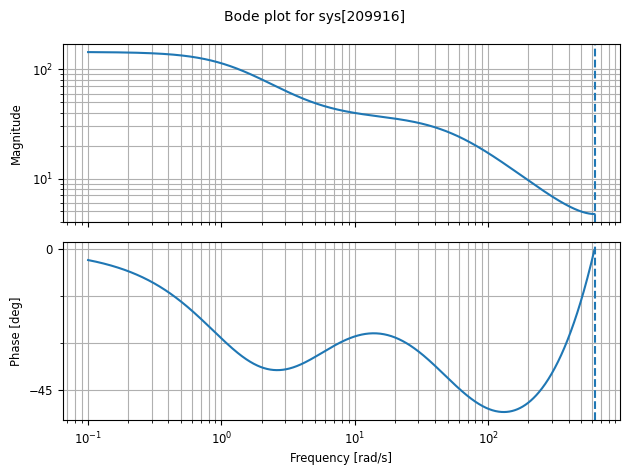

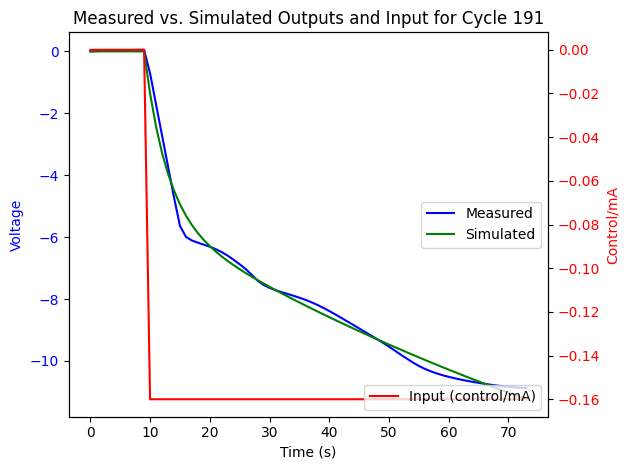

Cycle 192: G_hat_box_jenkins
<TransferFunction>: sys[209924]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.538 z^2 - 8.287 z
----------------------
z^2 - 1.754 z + 0.7564

dt = 0.005

Cycle 192: Zeros
[0.97055968+0.j 0.        +0.j]
Cycle 192: Poles
[0.99108988+0.j 0.76316827+0.j]


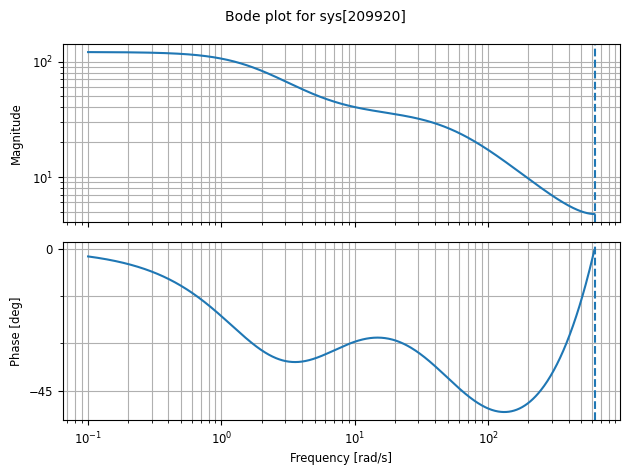

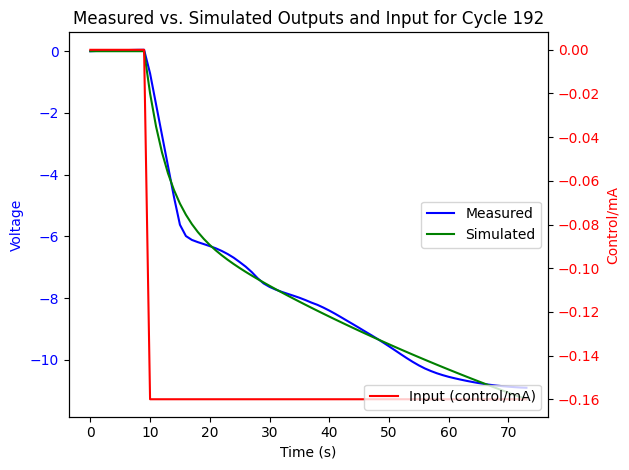

Cycle 193: G_hat_box_jenkins
<TransferFunction>: sys[209928]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.493 z^2 - 8.228 z
---------------------
z^2 - 1.75 z + 0.7527

dt = 0.005

Cycle 193: Zeros
[0.96878191+0.j 0.        +0.j]
Cycle 193: Poles
[0.99047624+0.j 0.75996155+0.j]


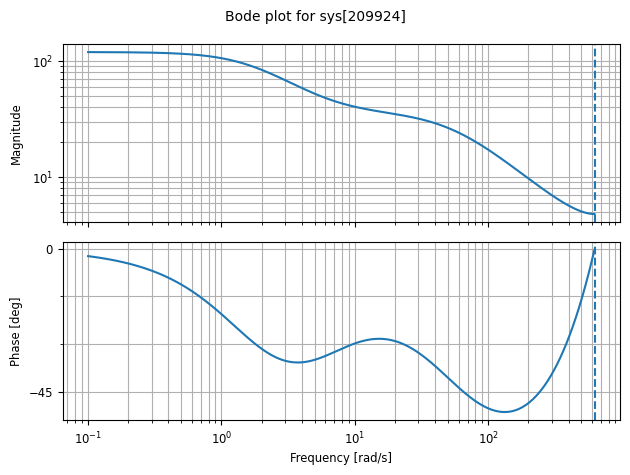

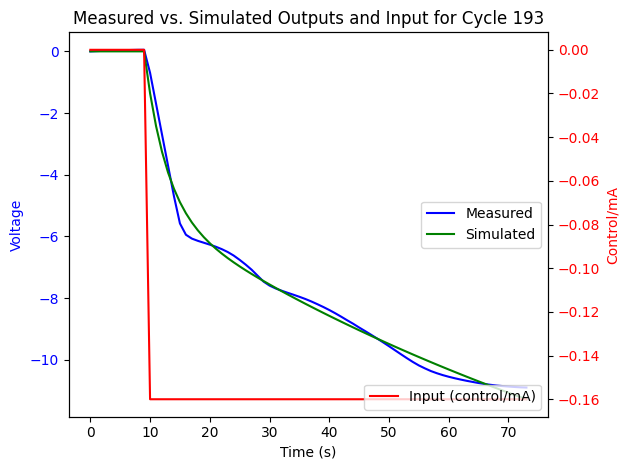

Cycle 194: G_hat_box_jenkins
<TransferFunction>: sys[209932]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.501 z^2 - 8.227 z
----------------------
z^2 - 1.747 z + 0.7494

dt = 0.005

Cycle 194: Zeros
[0.96776988+0.j 0.        +0.j]
Cycle 194: Poles
[0.99018926+0.j 0.75685046+0.j]


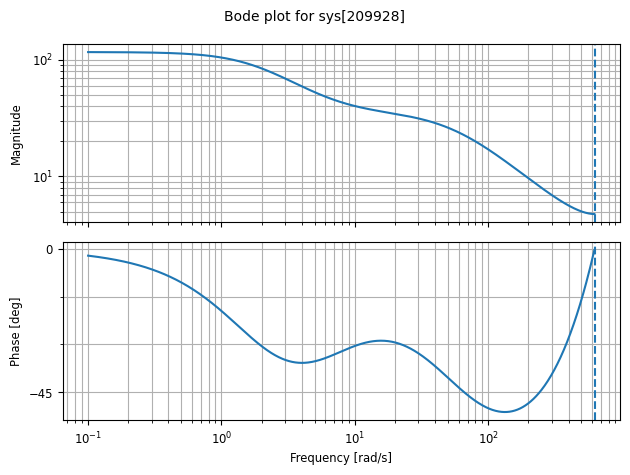

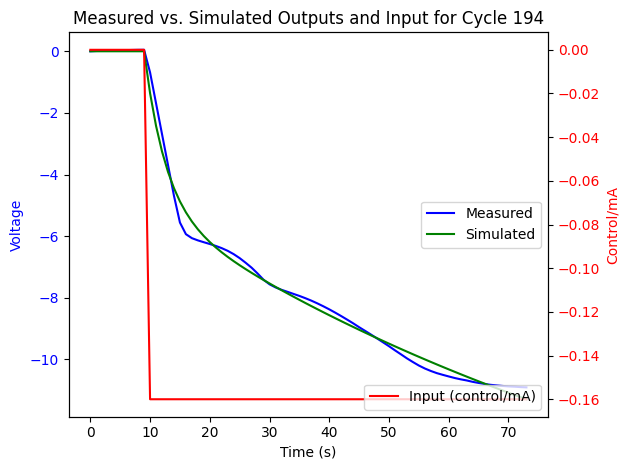

Cycle 195: G_hat_box_jenkins
<TransferFunction>: sys[209936]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.365 z^2 - 8.119 z
----------------------
z^2 - 1.751 z + 0.7534

dt = 0.005

Cycle 195: Zeros
[0.97055075+0.j 0.        +0.j]
Cycle 195: Poles
[0.99186786+0.j 0.75958648+0.j]


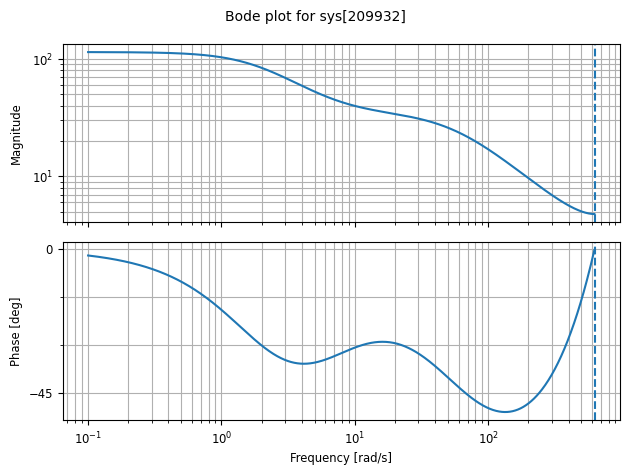

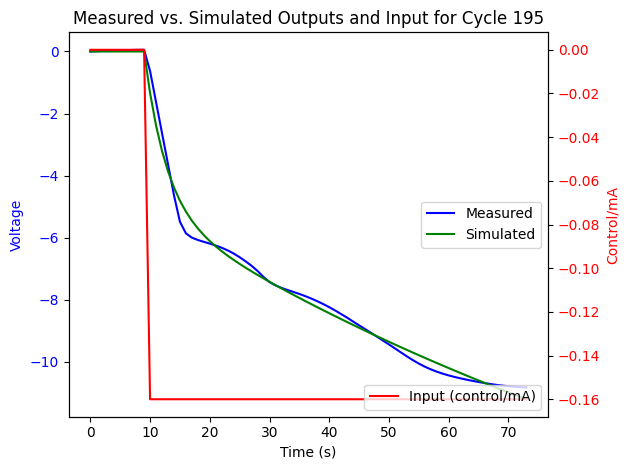

Cycle 196: G_hat_box_jenkins
<TransferFunction>: sys[209940]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.445 z^2 - 8.124 z
---------------------
z^2 - 1.739 z + 0.742

dt = 0.005

Cycle 196: Zeros
[0.96202544+0.j 0.        +0.j]
Cycle 196: Poles
[0.98751507+0.j 0.75136797+0.j]


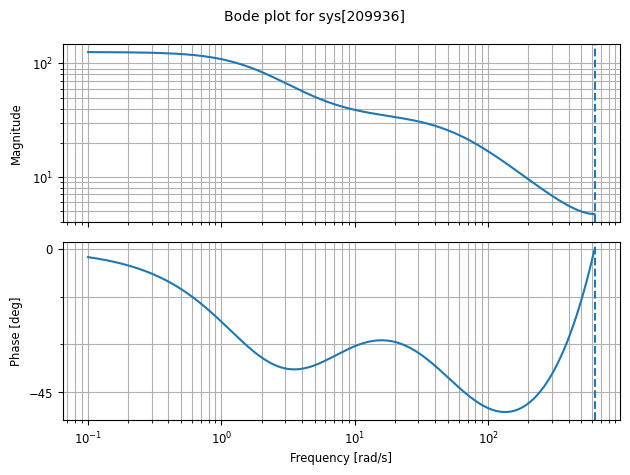

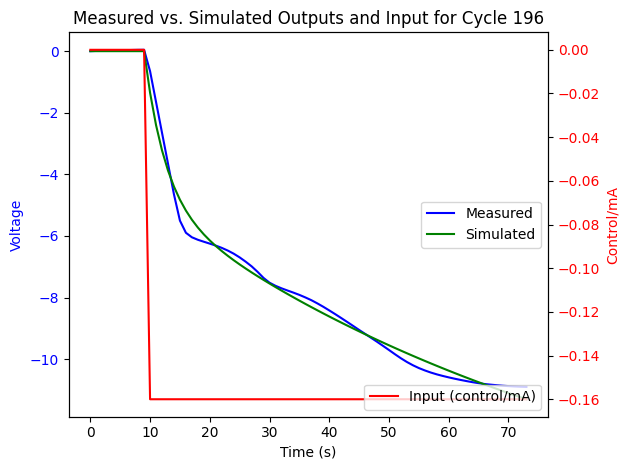

Cycle 197: G_hat_box_jenkins
<TransferFunction>: sys[209944]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  8.52 z^2 - 8.124 z
----------------------
z^2 - 1.725 z + 0.7296

dt = 0.005

Cycle 197: Zeros
[0.95357982+0.j 0.        +0.j]
Cycle 197: Poles
[0.98367085+0.j 0.74171564+0.j]


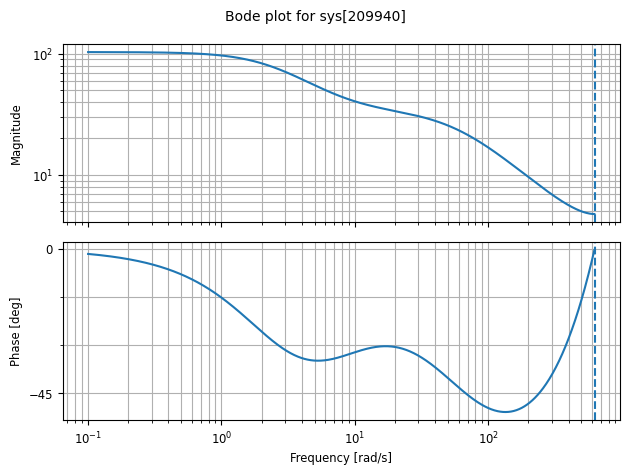

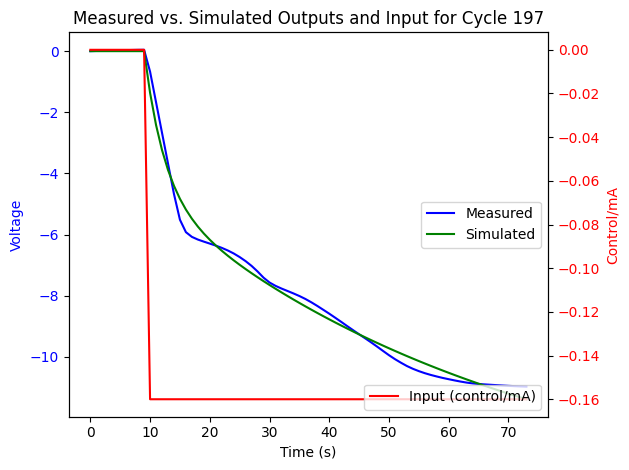

Cycle 198: G_hat_box_jenkins
<TransferFunction>: sys[209948]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.567 z^2 - 8.147 z
----------------------
z^2 - 1.717 z + 0.7219

dt = 0.005

Cycle 198: Zeros
[0.95102862+0.j 0.        +0.j]
Cycle 198: Poles
[0.98321425+0.j 0.73426783+0.j]


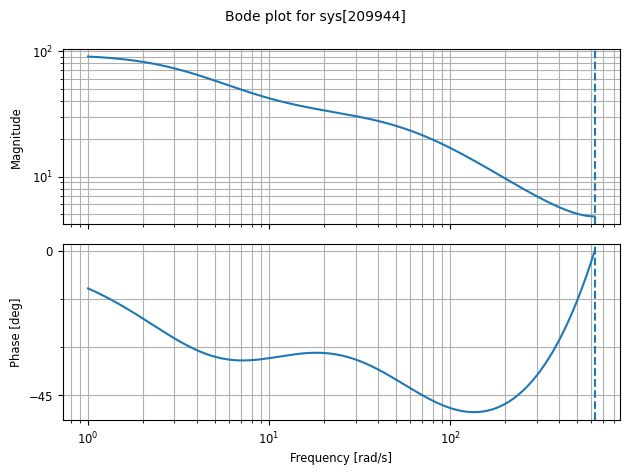

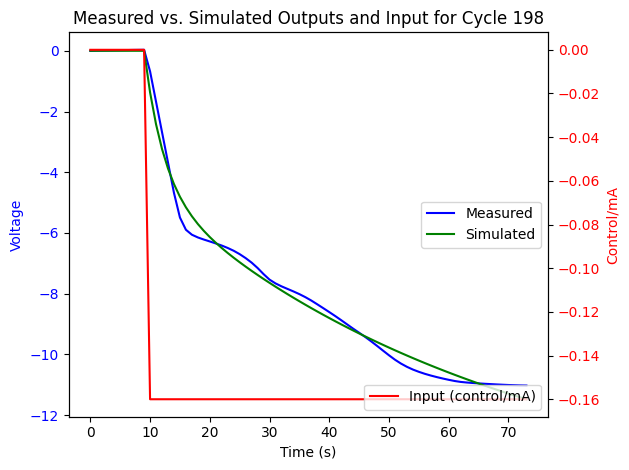

Cycle 199: G_hat_box_jenkins
<TransferFunction>: sys[209952]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.461 z^2 - 8.152 z
----------------------
z^2 - 1.732 z + 0.7345

dt = 0.005

Cycle 199: Zeros
[0.96349487+0.j 0.        +0.j]
Cycle 199: Poles
[0.98945673+0.j 0.74228047+0.j]


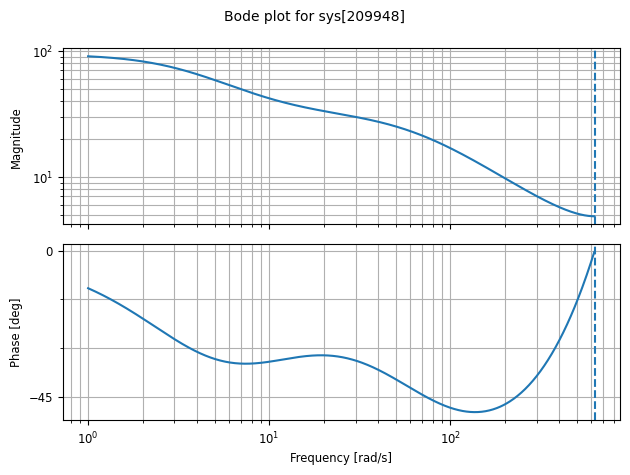

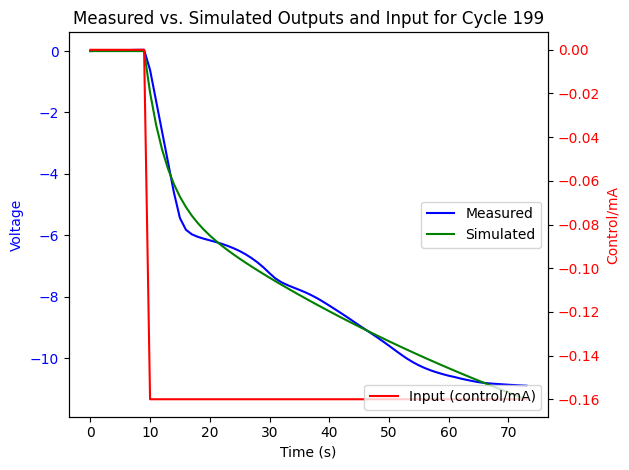

Cycle 200: G_hat_box_jenkins
<TransferFunction>: sys[209956]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.592 z^2 - 8.146 z
---------------------
z^2 - 1.71 z + 0.7148

dt = 0.005

Cycle 200: Zeros
[0.94803151+0.j 0.        +0.j]
Cycle 200: Poles
[0.98241234+0.j 0.72762214+0.j]


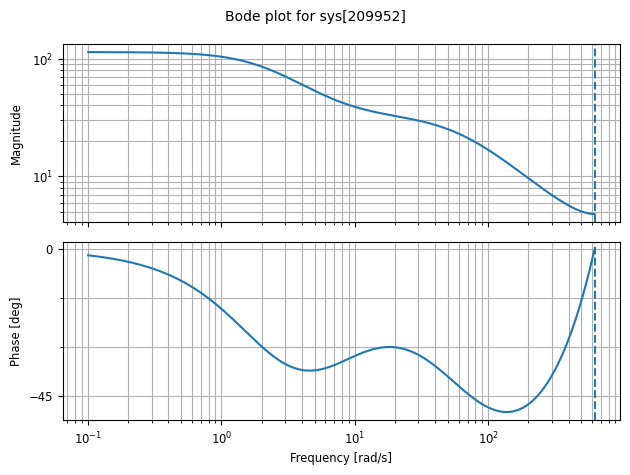

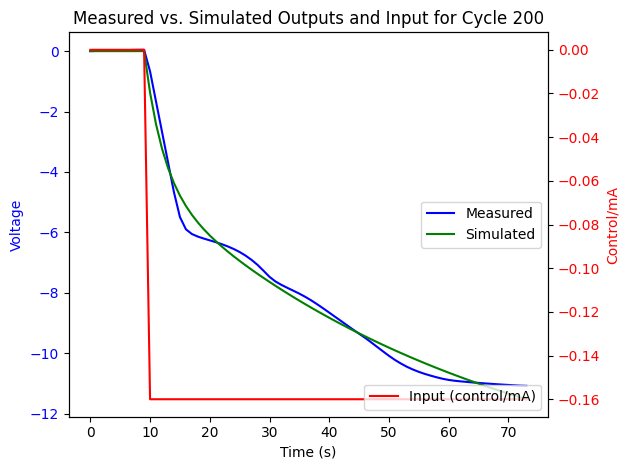

Cycle 201: G_hat_box_jenkins
<TransferFunction>: sys[209960]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.757 z^2 - 8.222 z
----------------------
z^2 - 1.693 z + 0.6995

dt = 0.005

Cycle 201: Zeros
[0.93895341+0.j 0.        +0.j]
Cycle 201: Poles
[0.97896302+0.j 0.71448717+0.j]


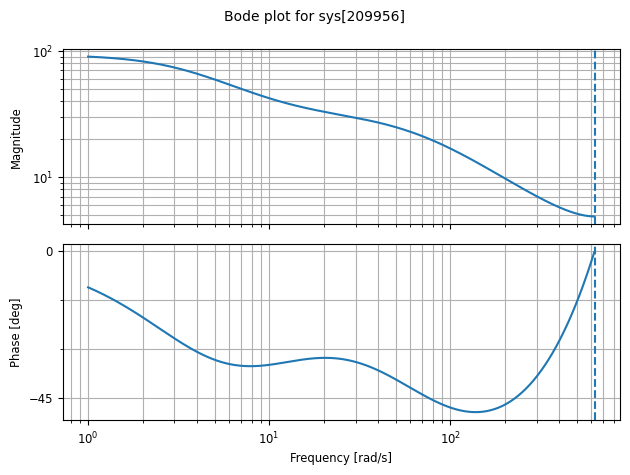

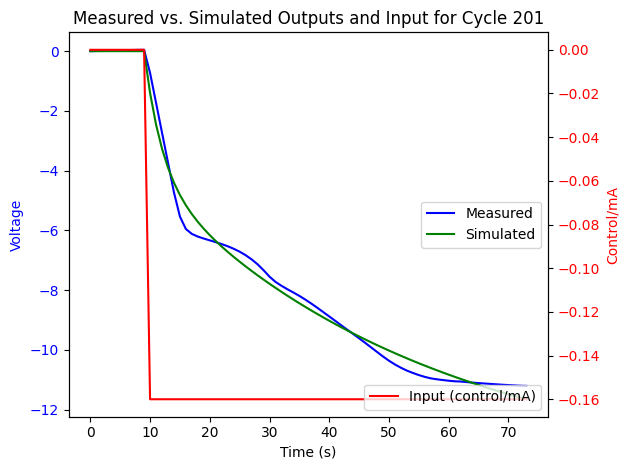

Cycle 202: G_hat_box_jenkins
<TransferFunction>: sys[209964]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.857 z^2 - 8.332 z
----------------------
z^2 - 1.693 z + 0.6989

dt = 0.005

Cycle 202: Zeros
[0.94064818+0.j 0.        +0.j]
Cycle 202: Poles
[0.97983017+0.j 0.71324202+0.j]


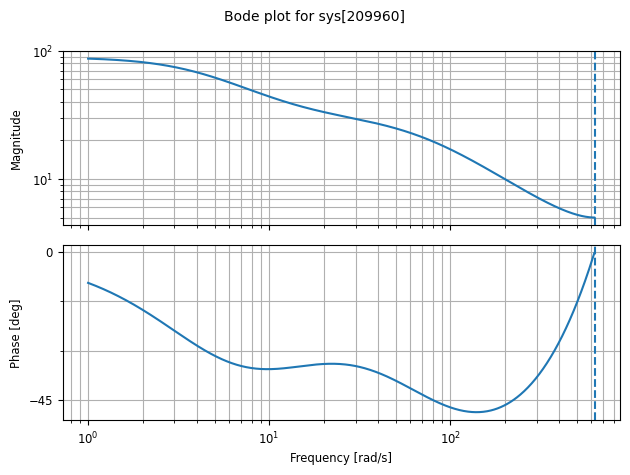

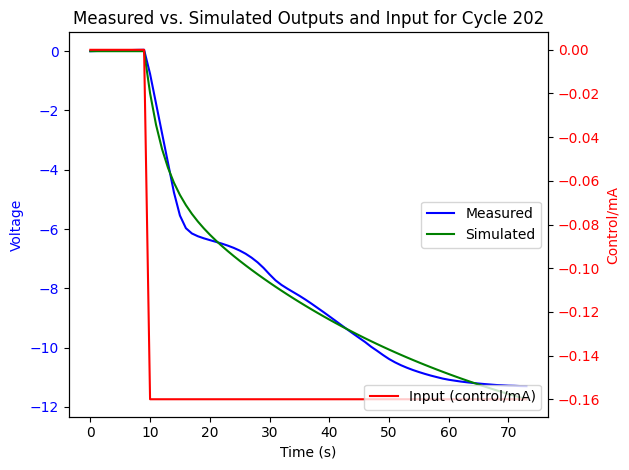

Cycle 203: G_hat_box_jenkins
<TransferFunction>: sys[209968]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.958 z^2 - 8.418 z
----------------------
z^2 - 1.686 z + 0.6915

dt = 0.005

Cycle 203: Zeros
[0.93970756+0.j 0.        +0.j]
Cycle 203: Poles
[0.98019214+0.j 0.70543028+0.j]


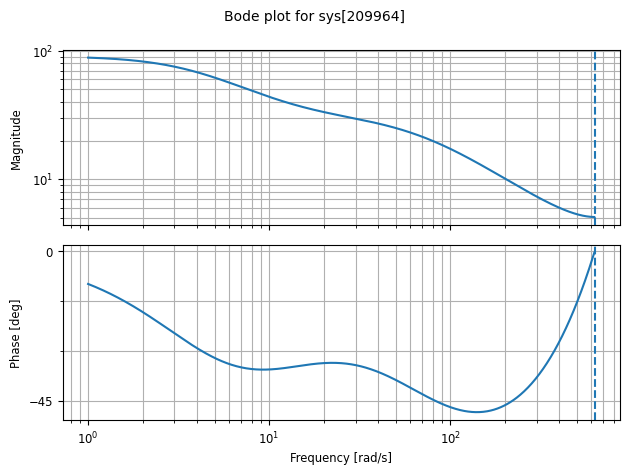

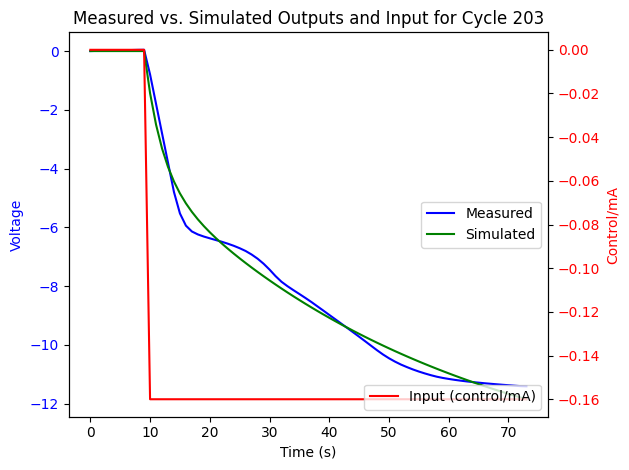

Cycle 204: G_hat_box_jenkins
<TransferFunction>: sys[209972]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.062 z^2 - 8.492 z
---------------------
z^2 - 1.677 z + 0.683

dt = 0.005

Cycle 204: Zeros
[0.93702687+0.j 0.        +0.j]
Cycle 204: Poles
[0.97975322+0.j 0.69708043+0.j]


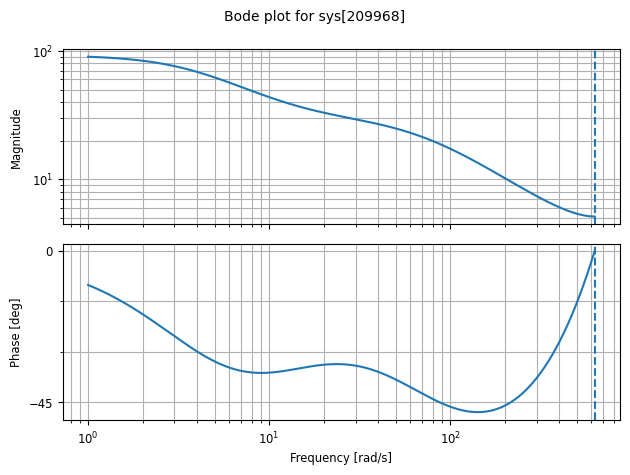

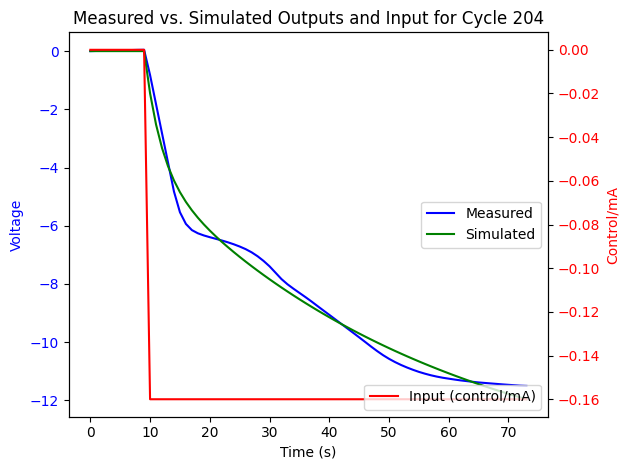

Cycle 205: G_hat_box_jenkins
<TransferFunction>: sys[209976]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.123 z^2 - 8.541 z
---------------------
z^2 - 1.672 z + 0.678

dt = 0.005

Cycle 205: Zeros
[0.93621038+0.j 0.        +0.j]
Cycle 205: Poles
[0.97986324+0.j 0.69194559+0.j]


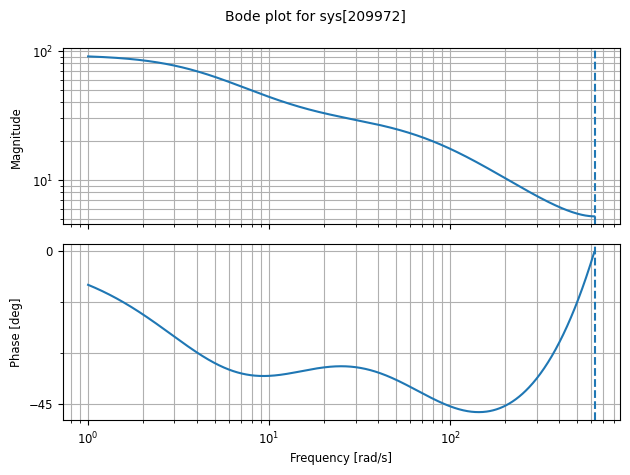

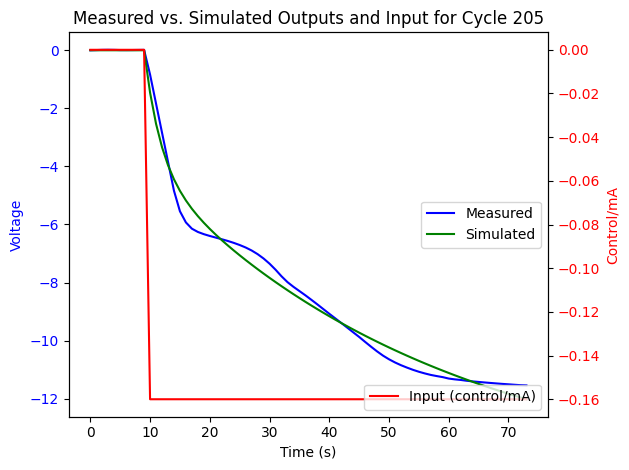

Cycle 206: G_hat_box_jenkins
<TransferFunction>: sys[209980]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.092 z^2 - 8.508 z
----------------------
z^2 - 1.669 z + 0.6749

dt = 0.005

Cycle 206: Zeros
[0.93582362+0.j 0.        +0.j]
Cycle 206: Poles
[0.9803618+0.j 0.6884388+0.j]


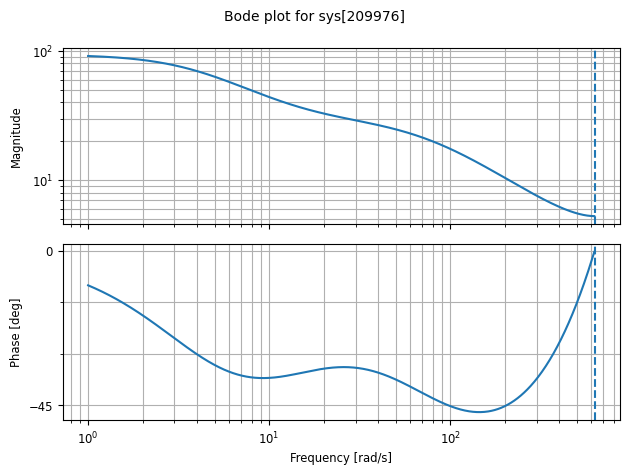

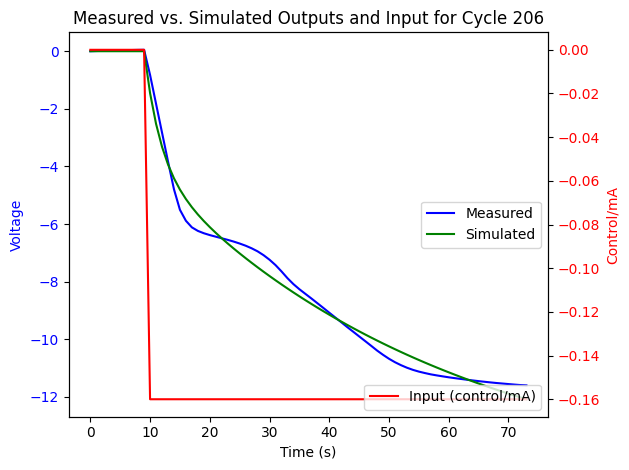

Cycle 207: G_hat_box_jenkins
<TransferFunction>: sys[209984]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  9.239 z^2 - 8.63 z
----------------------
z^2 - 1.662 z + 0.6679

dt = 0.005

Cycle 207: Zeros
[0.93407654+0.j 0.        +0.j]
Cycle 207: Poles
[0.98009229+0.j 0.68145425+0.j]


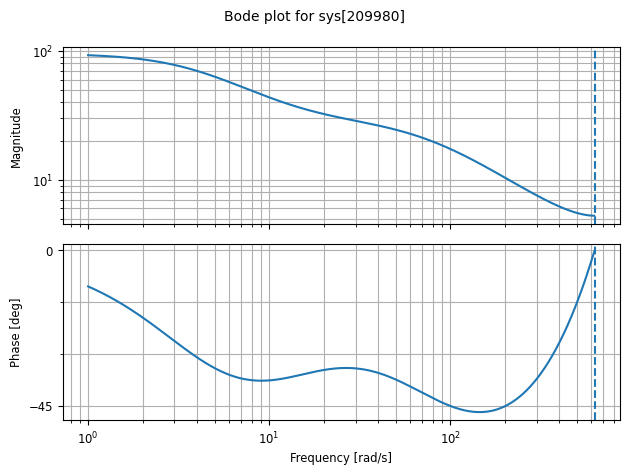

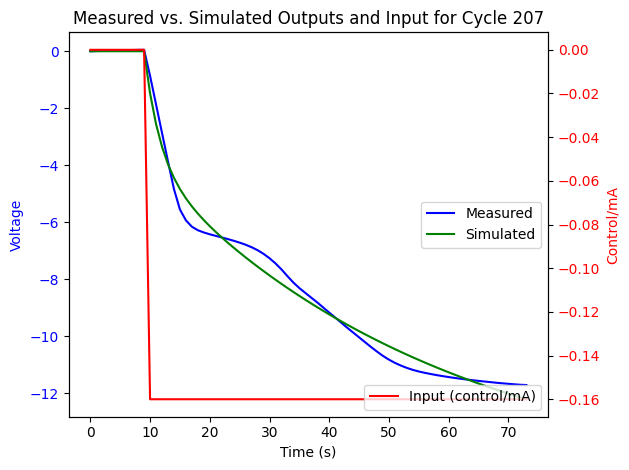

Cycle 208: G_hat_box_jenkins
<TransferFunction>: sys[209988]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.441 z^2 - 8.801 z
----------------------
z^2 - 1.655 z + 0.6615

dt = 0.005

Cycle 208: Zeros
[0.93220456+0.j 0.        +0.j]
Cycle 208: Poles
[0.9795934 +0.j 0.67529288+0.j]


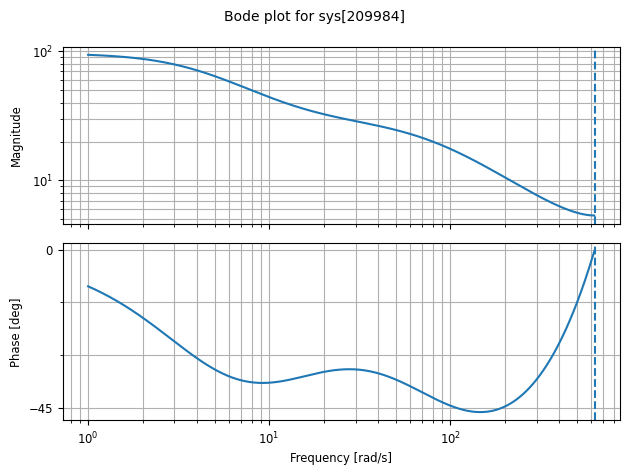

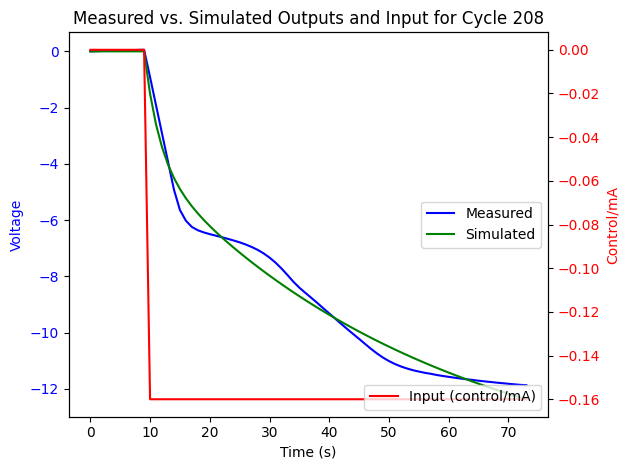

Cycle 209: G_hat_box_jenkins
<TransferFunction>: sys[209992]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  9.55 z^2 - 8.92 z
----------------------
z^2 - 1.654 z + 0.6608

dt = 0.005

Cycle 209: Zeros
[0.93404698+0.j 0.        +0.j]
Cycle 209: Poles
[0.9806529+0.j 0.6737965+0.j]


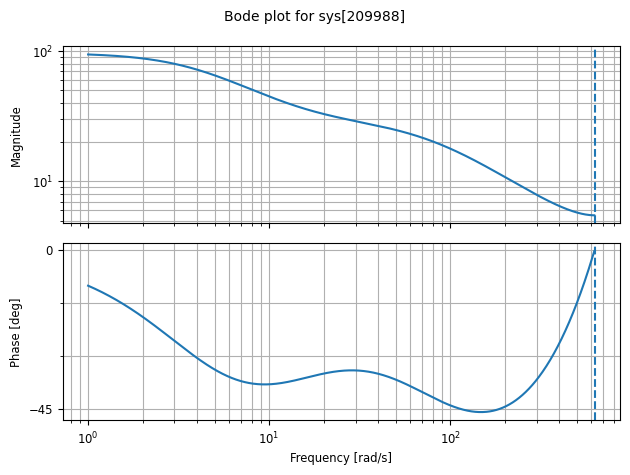

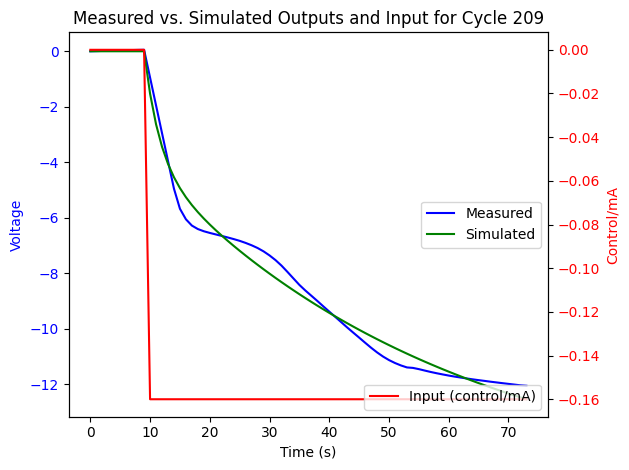

Cycle 210: G_hat_box_jenkins
<TransferFunction>: sys[209996]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.791 z^2 - 9.168 z
----------------------
z^2 - 1.653 z + 0.6591

dt = 0.005

Cycle 210: Zeros
[0.93638833+0.j 0.        +0.j]
Cycle 210: Poles
[0.98158852+0.j 0.6714646 +0.j]


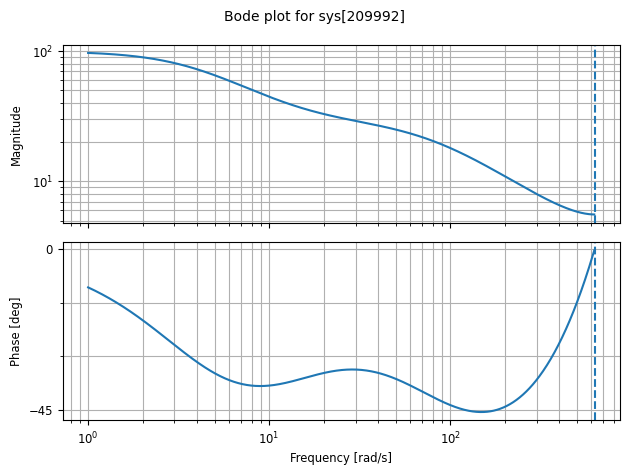

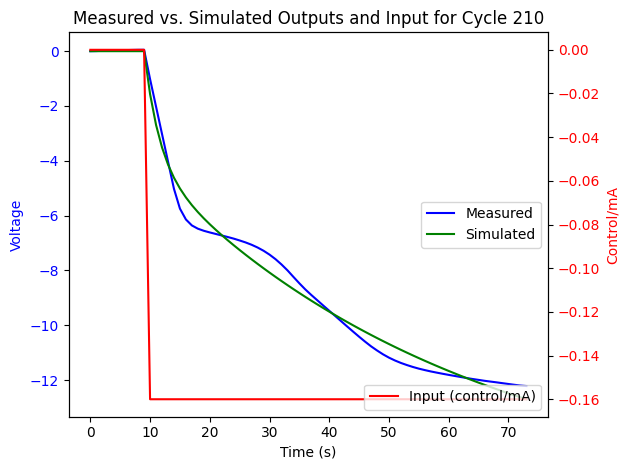

Cycle 211: G_hat_box_jenkins
<TransferFunction>: sys[210000]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.958 z^2 - 9.328 z
----------------------
z^2 - 1.651 z + 0.6565

dt = 0.005

Cycle 211: Zeros
[0.93672661+0.j 0.        +0.j]
Cycle 211: Poles
[0.98181459+0.j 0.66869518+0.j]


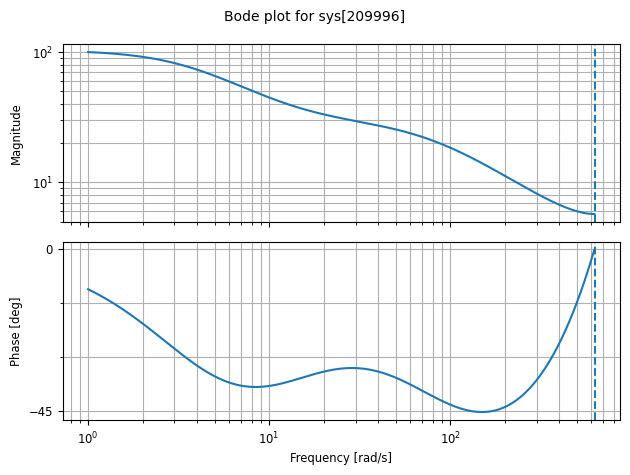

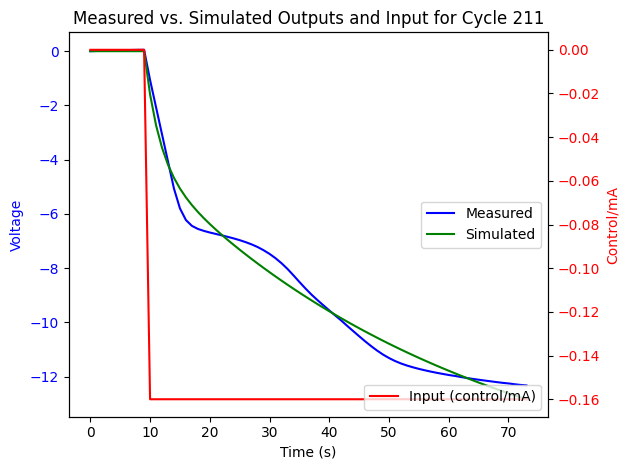

Cycle 212: G_hat_box_jenkins
<TransferFunction>: sys[210004]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  9.85 z^2 - 9.244 z
----------------------
z^2 - 1.655 z + 0.6606

dt = 0.005

Cycle 212: Zeros
[0.93848555+0.j 0.        +0.j]
Cycle 212: Poles
[0.98279818+0.j 0.67219852+0.j]


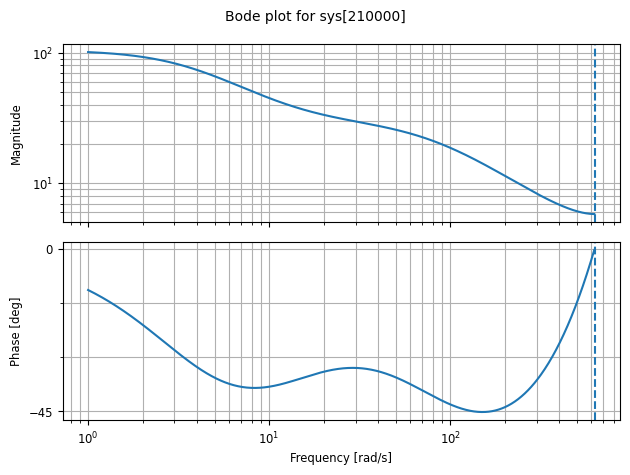

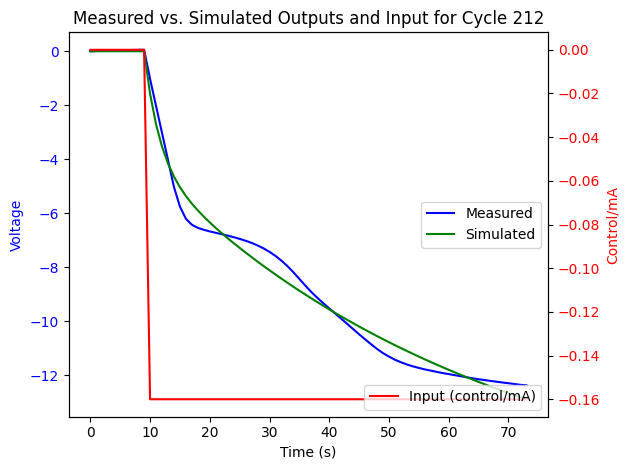

Cycle 213: G_hat_box_jenkins
<TransferFunction>: sys[210008]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.694 z^2 - 9.098 z
----------------------
z^2 - 1.657 z + 0.6626

dt = 0.005

Cycle 213: Zeros
[0.93853037+0.j 0.        +0.j]
Cycle 213: Poles
[0.98329285+0.j 0.67381317+0.j]


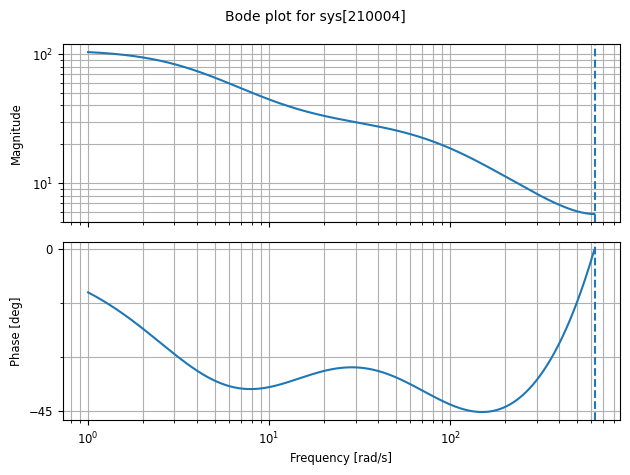

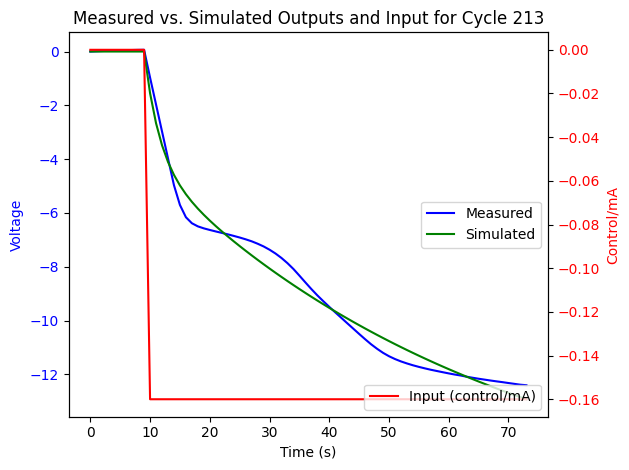

Cycle 214: G_hat_box_jenkins
<TransferFunction>: sys[210012]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.786 z^2 - 9.207 z
----------------------
z^2 - 1.658 z + 0.6627

dt = 0.005

Cycle 214: Zeros
[0.94082618+0.j 0.        +0.j]
Cycle 214: Poles
[0.98447269+0.j 0.67314993+0.j]


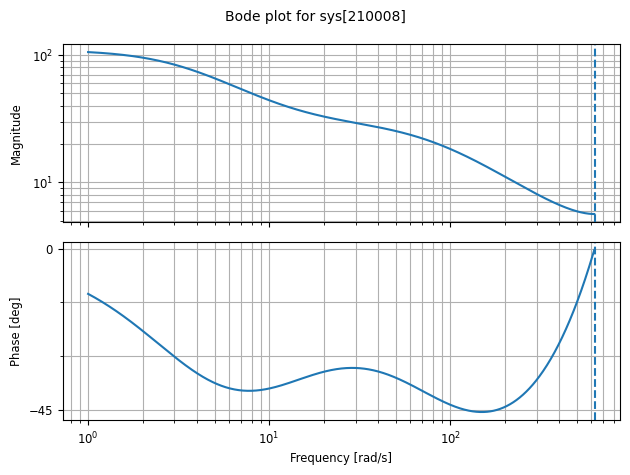

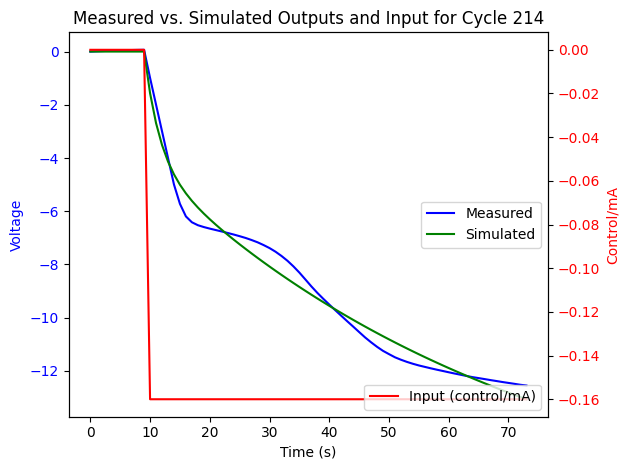

Cycle 215: G_hat_box_jenkins
<TransferFunction>: sys[210016]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.783 z^2 - 9.213 z
----------------------
z^2 - 1.658 z + 0.6628

dt = 0.005

Cycle 215: Zeros
[0.94180574+0.j 0.        +0.j]
Cycle 215: Poles
[0.98530678+0.j 0.67264628+0.j]


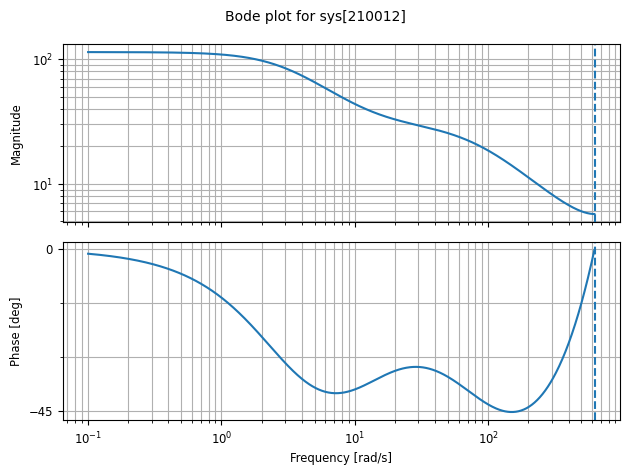

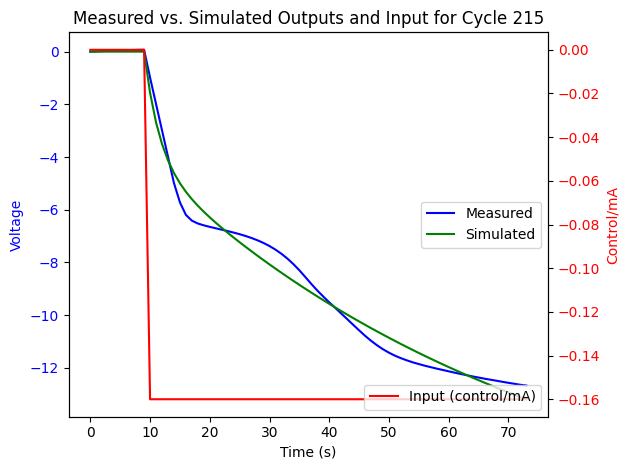

Cycle 216: G_hat_box_jenkins
<TransferFunction>: sys[210020]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.854 z^2 - 9.262 z
----------------------
z^2 - 1.655 z + 0.6601

dt = 0.005

Cycle 216: Zeros
[0.9399141+0.j 0.       +0.j]
Cycle 216: Poles
[0.98403974+0.j 0.67077997+0.j]


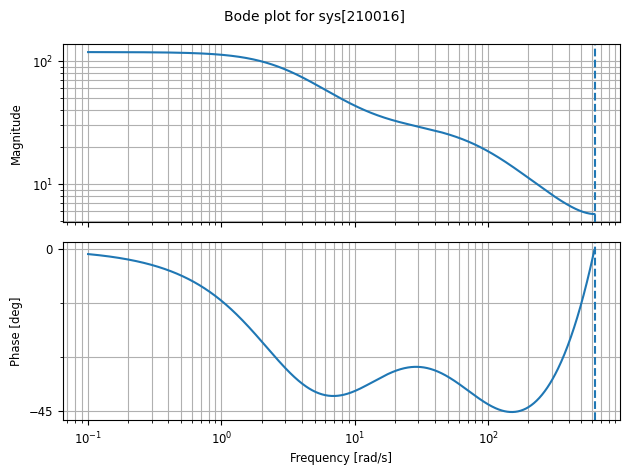

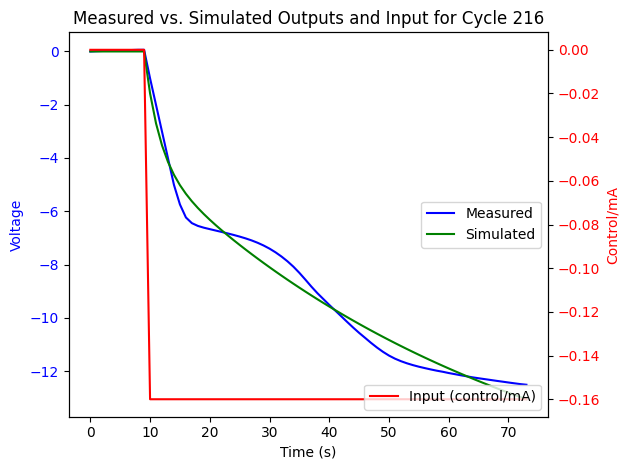

Cycle 217: G_hat_box_jenkins
<TransferFunction>: sys[210024]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.928 z^2 - 9.343 z
----------------------
z^2 - 1.657 z + 0.6619

dt = 0.005

Cycle 217: Zeros
[0.94102009+0.j 0.        +0.j]
Cycle 217: Poles
[0.98448154+0.j 0.67236717+0.j]


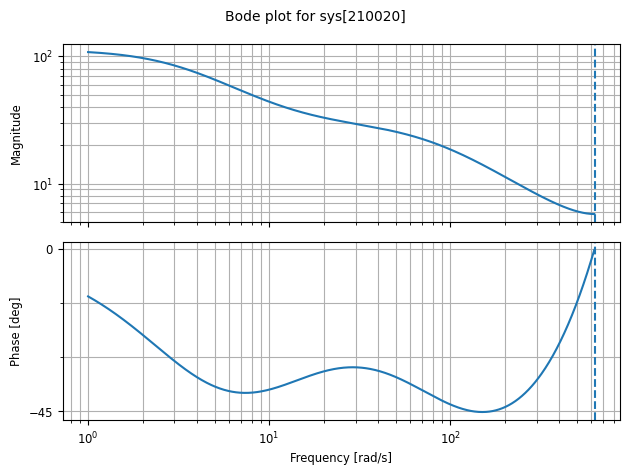

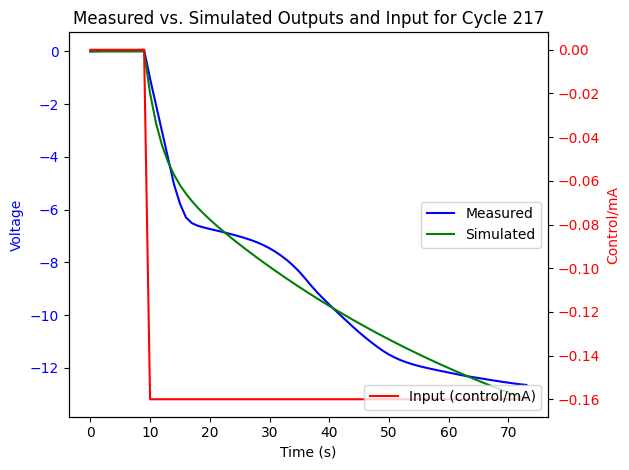

Cycle 218: G_hat_box_jenkins
<TransferFunction>: sys[210028]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 10.05 z^2 - 9.462 z
----------------------
z^2 - 1.655 z + 0.6602

dt = 0.005

Cycle 218: Zeros
[0.941176+0.j 0.      +0.j]
Cycle 218: Poles
[0.98484534+0.j 0.6703495 +0.j]


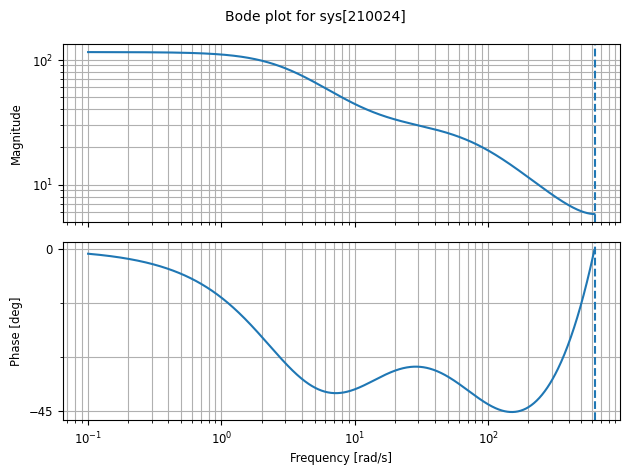

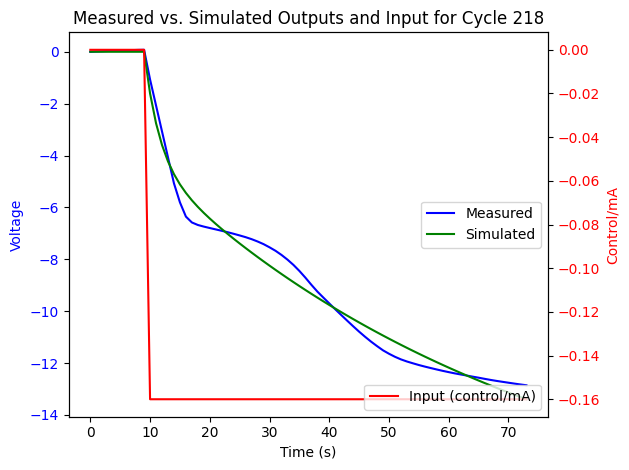

Cycle 219: G_hat_box_jenkins
<TransferFunction>: sys[210032]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.977 z^2 - 9.379 z
----------------------
z^2 - 1.655 z + 0.6596

dt = 0.005

Cycle 219: Zeros
[0.94004919+0.j 0.        +0.j]
Cycle 219: Poles
[0.98459404+0.j 0.66992043+0.j]


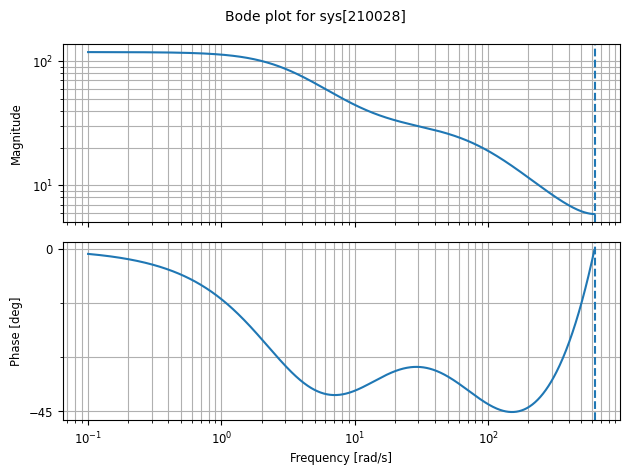

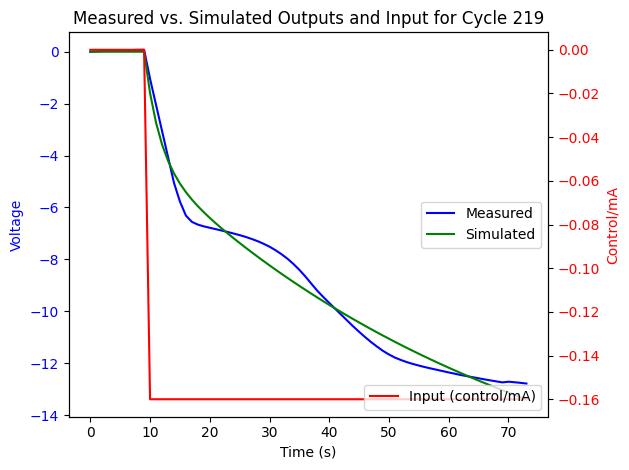

Cycle 220: G_hat_box_jenkins
<TransferFunction>: sys[210036]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  9.37 z^2 - 8.828 z
----------------------
z^2 - 1.664 z + 0.6689

dt = 0.005

Cycle 220: Zeros
[0.94218972+0.j 0.        +0.j]
Cycle 220: Poles
[0.98630434+0.j 0.67817324+0.j]


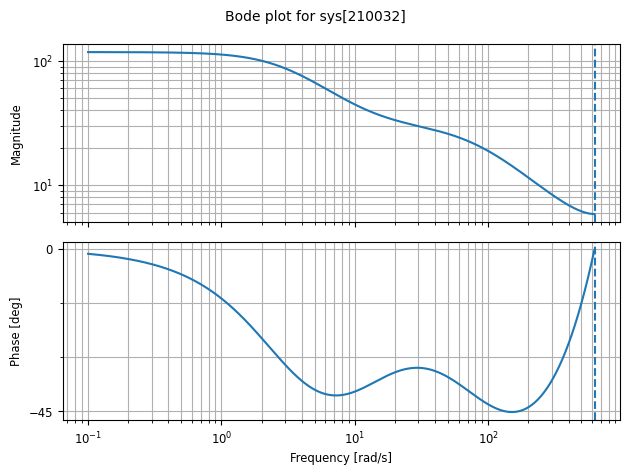

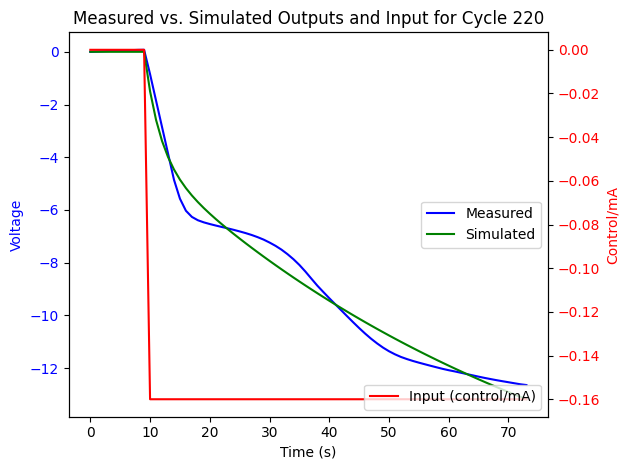

Cycle 221: G_hat_box_jenkins
<TransferFunction>: sys[210040]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.336 z^2 - 8.799 z
----------------------
z^2 - 1.664 z + 0.6681

dt = 0.005

Cycle 221: Zeros
[0.94249617+0.j 0.        +0.j]
Cycle 221: Poles
[0.98682839+0.j 0.67701551+0.j]


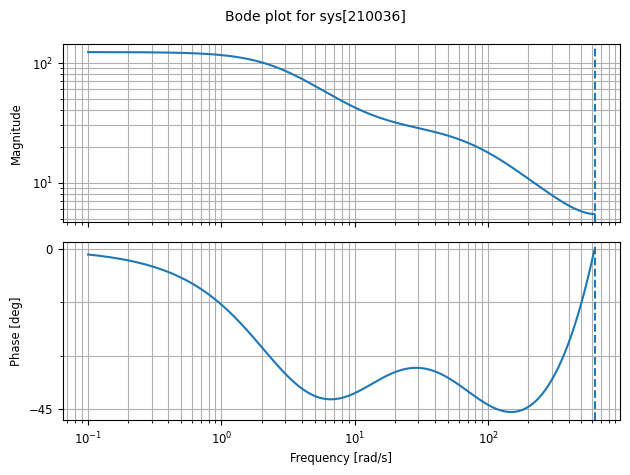

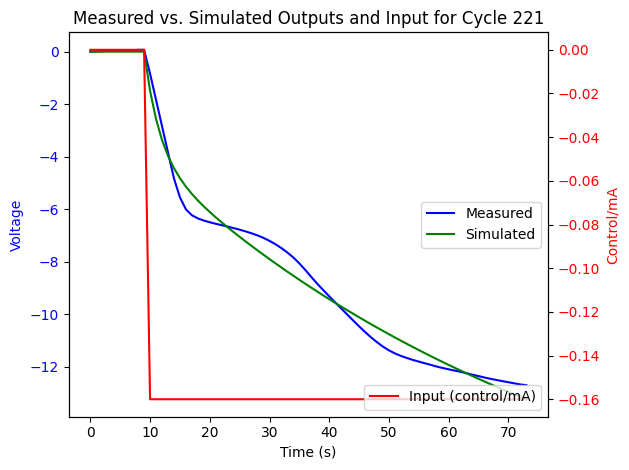

Cycle 222: G_hat_box_jenkins
<TransferFunction>: sys[210044]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.337 z^2 - 8.797 z
----------------------
z^2 - 1.664 z + 0.6678

dt = 0.005

Cycle 222: Zeros
[0.94217325+0.j 0.        +0.j]
Cycle 222: Poles
[0.98691372+0.j 0.67668351+0.j]


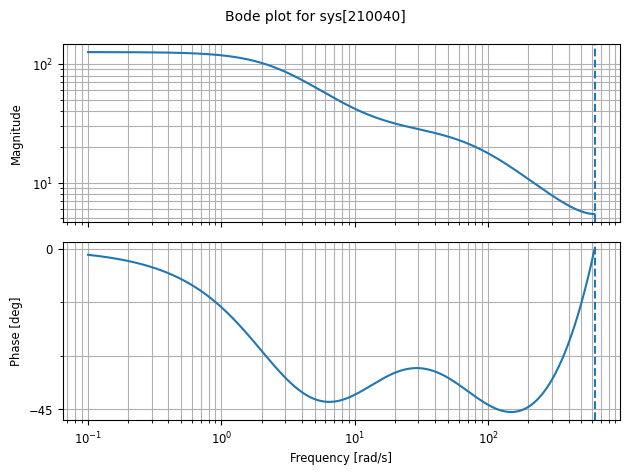

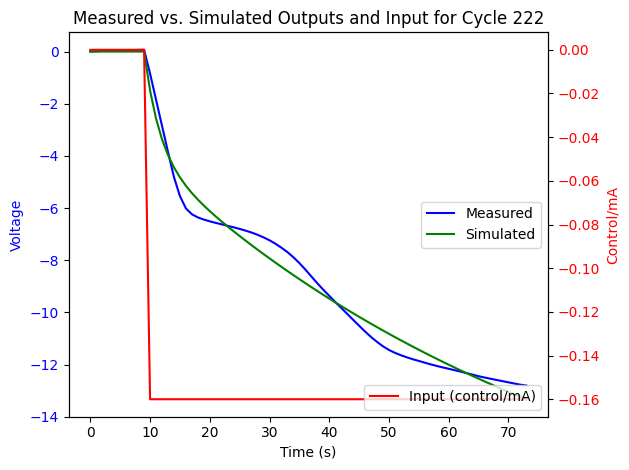

Cycle 223: G_hat_box_jenkins
<TransferFunction>: sys[210048]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.229 z^2 - 8.694 z
----------------------
z^2 - 1.664 z + 0.6686

dt = 0.005

Cycle 223: Zeros
[0.9420039+0.j 0.       +0.j]
Cycle 223: Poles
[0.98703699+0.j 0.67735318+0.j]


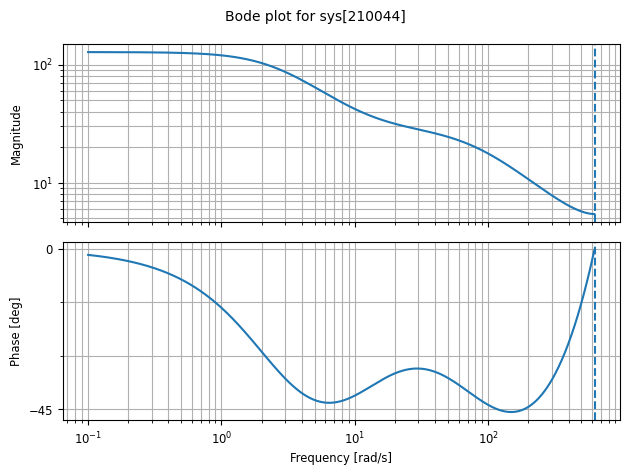

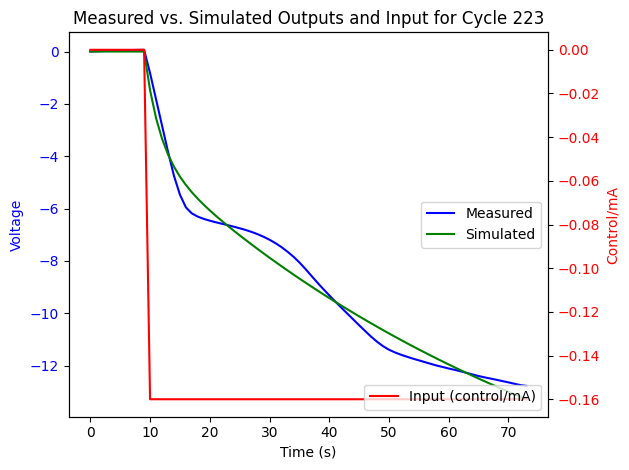

Cycle 224: G_hat_box_jenkins
<TransferFunction>: sys[210052]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.172 z^2 - 8.648 z
----------------------
z^2 - 1.666 z + 0.6696

dt = 0.005

Cycle 224: Zeros
[0.94284494+0.j 0.        +0.j]
Cycle 224: Poles
[0.98757999+0.j 0.67804766+0.j]


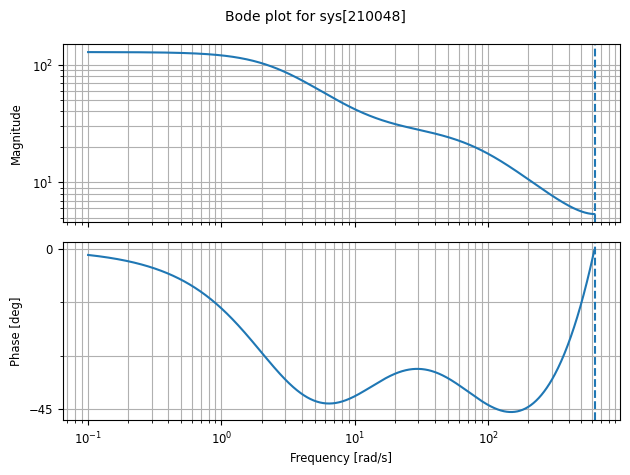

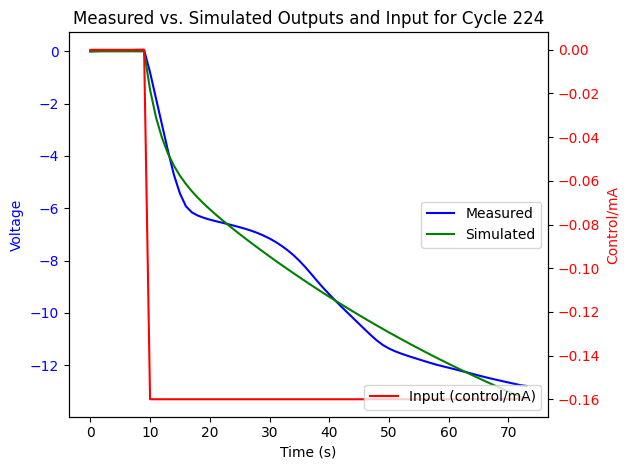

Cycle 225: G_hat_box_jenkins
<TransferFunction>: sys[210056]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.165 z^2 - 8.682 z
---------------------
z^2 - 1.67 z + 0.6738

dt = 0.005

Cycle 225: Zeros
[0.94729243+0.j 0.        +0.j]
Cycle 225: Poles
[0.9895015 +0.j 0.68090802+0.j]


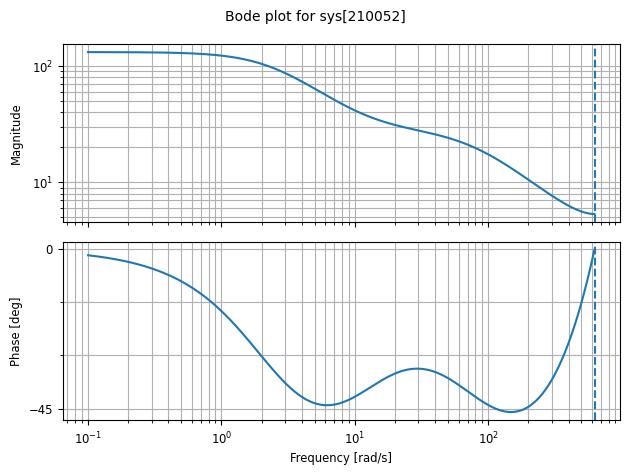

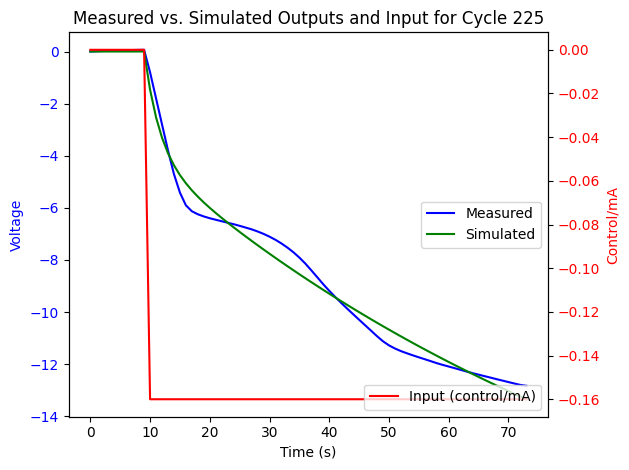

Cycle 226: G_hat_box_jenkins
<TransferFunction>: sys[210060]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.09 z^2 - 8.608 z
---------------------
z^2 - 1.67 z + 0.6735

dt = 0.005

Cycle 226: Zeros
[0.94690815+0.j 0.        +0.j]
Cycle 226: Poles
[0.98946861+0.j 0.68062405+0.j]


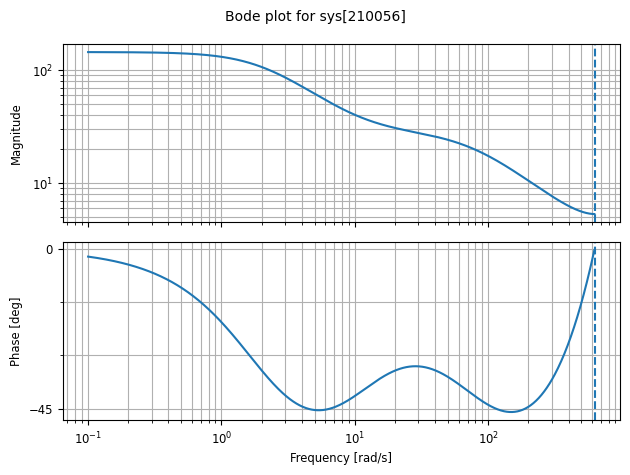

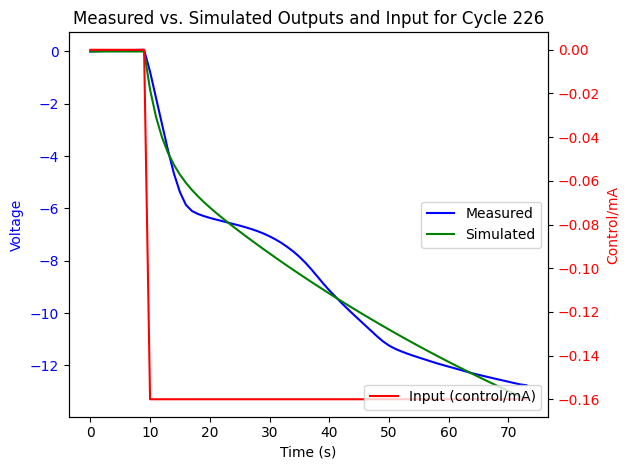

Cycle 227: G_hat_box_jenkins
<TransferFunction>: sys[210064]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.086 z^2 - 8.615 z
----------------------
z^2 - 1.672 z + 0.6752

dt = 0.005

Cycle 227: Zeros
[0.94818644+0.j 0.        +0.j]
Cycle 227: Poles
[0.98983723+0.j 0.68217011+0.j]


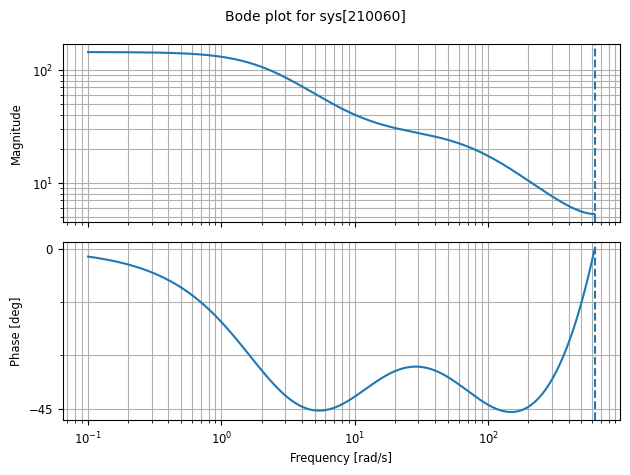

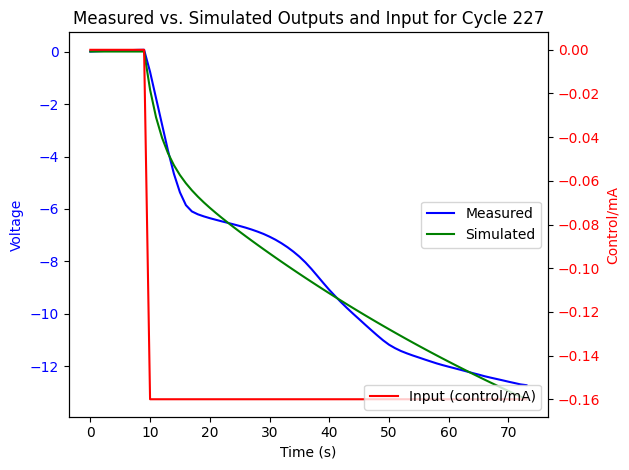

Cycle 228: G_hat_box_jenkins
<TransferFunction>: sys[210068]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.062 z^2 - 8.596 z
----------------------
z^2 - 1.673 z + 0.6765

dt = 0.005

Cycle 228: Zeros
[0.94862411+0.j 0.        +0.j]
Cycle 228: Poles
[0.98999925+0.j 0.6833627 +0.j]


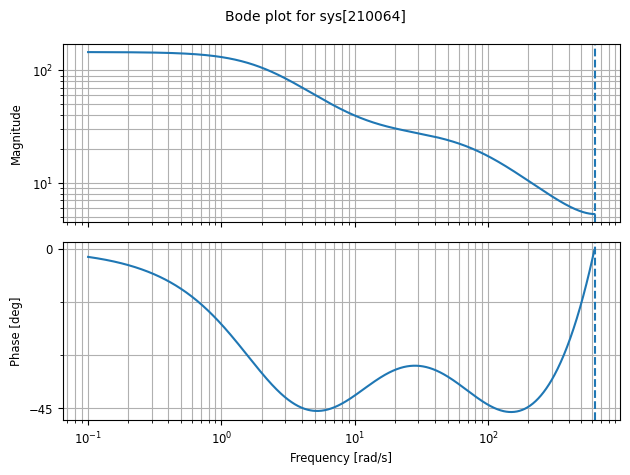

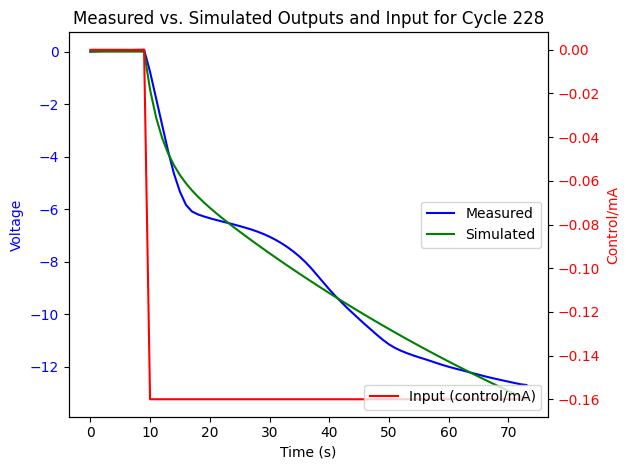

Cycle 229: G_hat_box_jenkins
<TransferFunction>: sys[210072]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  9.07 z^2 - 8.606 z
----------------------
z^2 - 1.674 z + 0.6767

dt = 0.005

Cycle 229: Zeros
[0.94891204+0.j 0.        +0.j]
Cycle 229: Poles
[0.99007391+0.j 0.68349149+0.j]


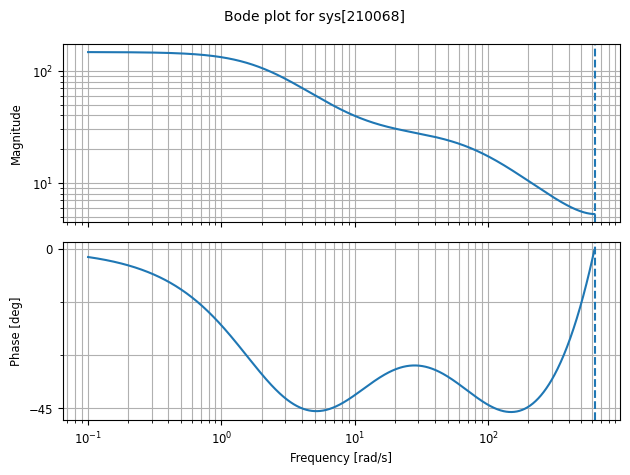

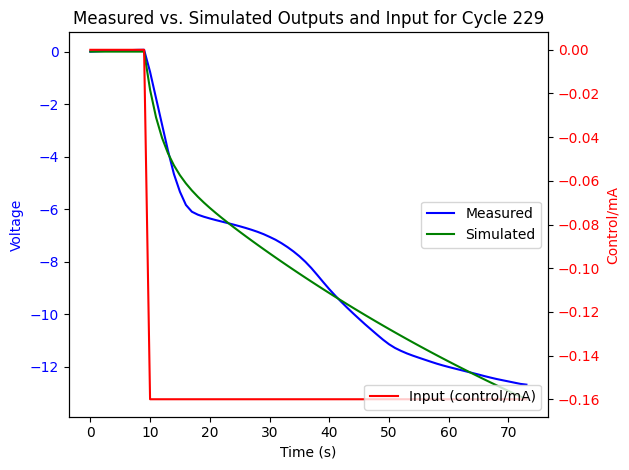

Cycle 230: G_hat_box_jenkins
<TransferFunction>: sys[210076]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.096 z^2 - 8.632 z
---------------------
z^2 - 1.674 z + 0.677

dt = 0.005

Cycle 230: Zeros
[0.94891329+0.j 0.        +0.j]
Cycle 230: Poles
[0.98977998+0.j 0.68400174+0.j]


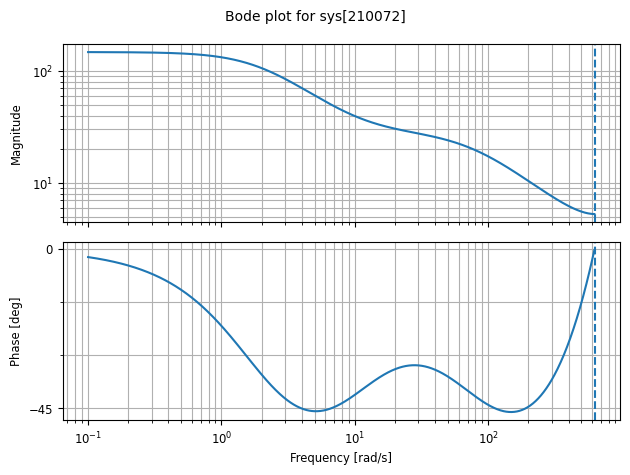

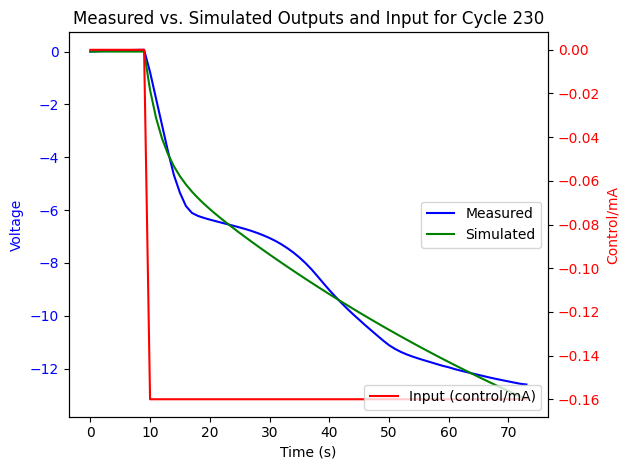

Cycle 231: G_hat_box_jenkins
<TransferFunction>: sys[210080]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.163 z^2 - 8.714 z
----------------------
z^2 - 1.675 z + 0.6783

dt = 0.005

Cycle 231: Zeros
[0.95094982+0.j 0.        +0.j]
Cycle 231: Poles
[0.99053104+0.j 0.68481239+0.j]


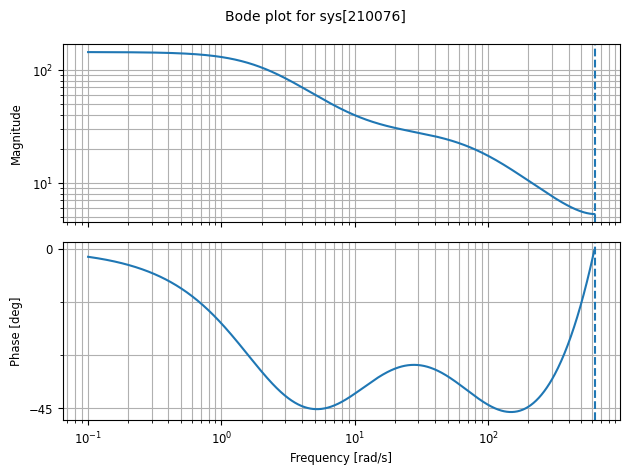

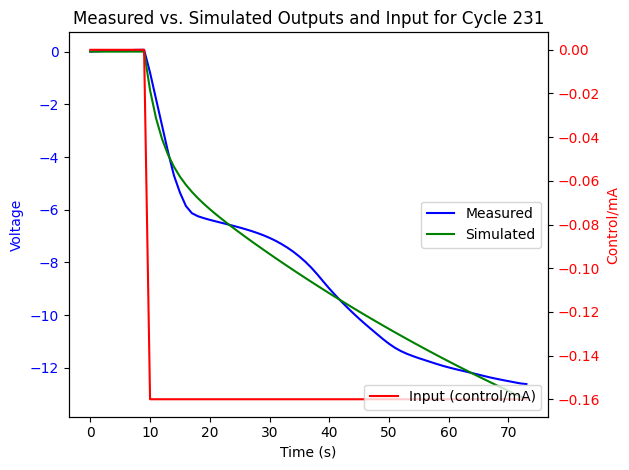

Cycle 232: G_hat_box_jenkins
<TransferFunction>: sys[210084]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.196 z^2 - 8.751 z
----------------------
z^2 - 1.676 z + 0.6793

dt = 0.005

Cycle 232: Zeros
[0.95163087+0.j 0.        +0.j]
Cycle 232: Poles
[0.99053903+0.j 0.68583791+0.j]


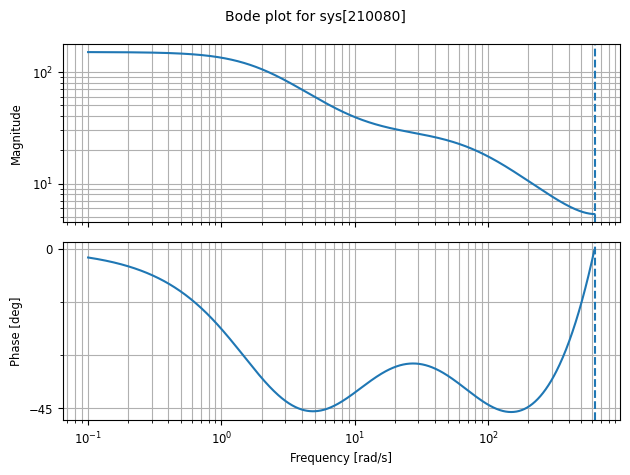

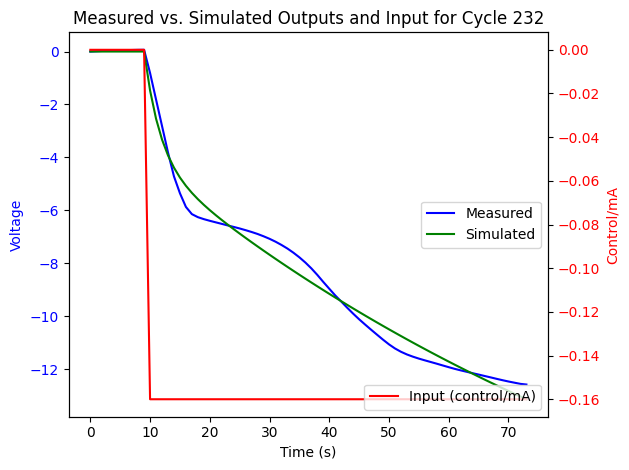

Cycle 233: G_hat_box_jenkins
<TransferFunction>: sys[210088]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.236 z^2 - 8.799 z
----------------------
z^2 - 1.677 z + 0.6801

dt = 0.005

Cycle 233: Zeros
[0.9527531+0.j 0.       +0.j]
Cycle 233: Poles
[0.99104781+0.j 0.68628575+0.j]


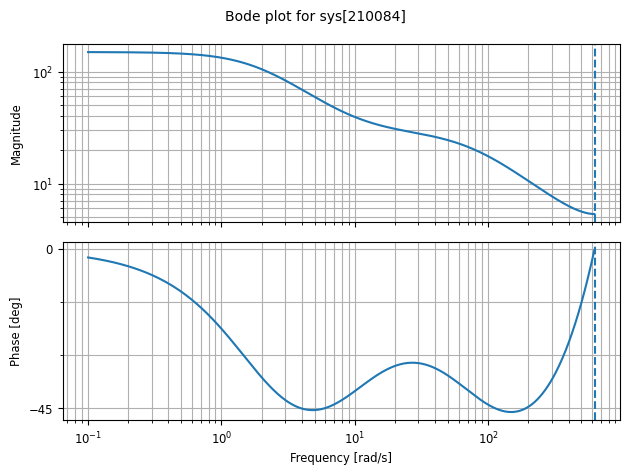

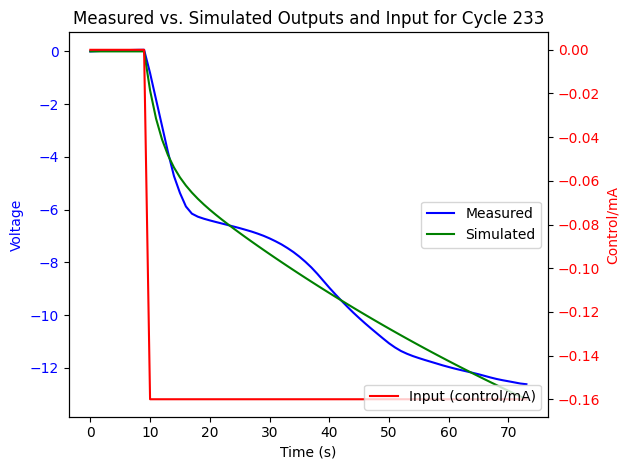

Cycle 234: G_hat_box_jenkins
<TransferFunction>: sys[210092]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.278 z^2 - 8.847 z
----------------------
z^2 - 1.679 z + 0.6815

dt = 0.005

Cycle 234: Zeros
[0.95355064+0.j 0.        +0.j]
Cycle 234: Poles
[0.99122327+0.j 0.68750515+0.j]


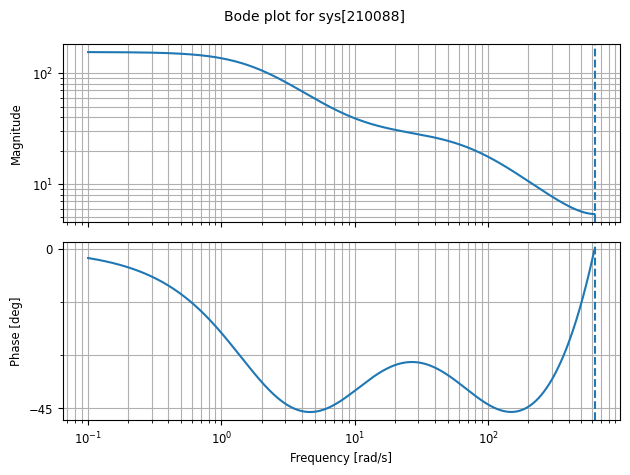

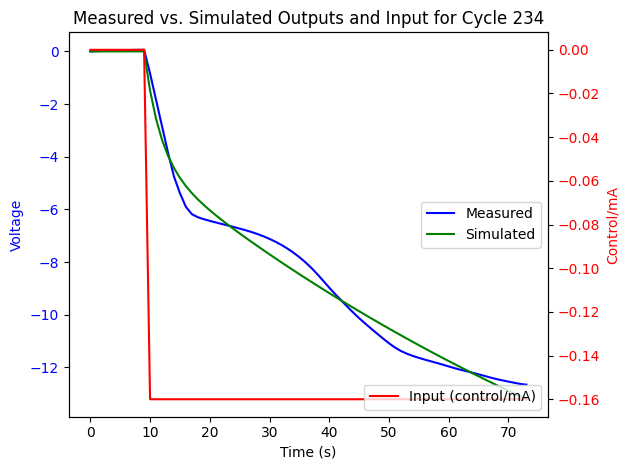

Cycle 235: G_hat_box_jenkins
<TransferFunction>: sys[210096]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.339 z^2 - 8.895 z
----------------------
z^2 - 1.677 z + 0.6801

dt = 0.005

Cycle 235: Zeros
[0.95249873+0.j 0.        +0.j]
Cycle 235: Poles
[0.99047713+0.j 0.68667827+0.j]


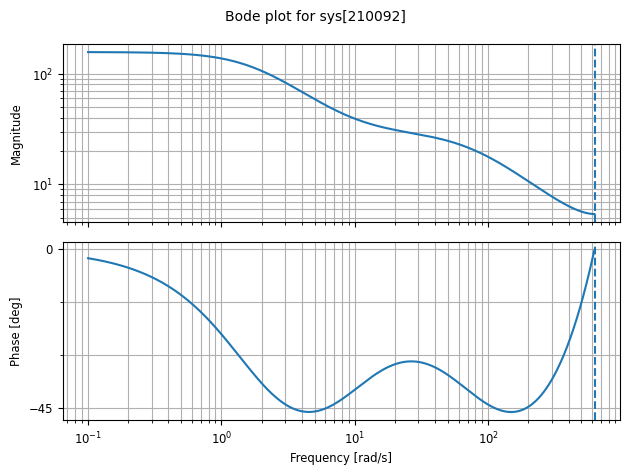

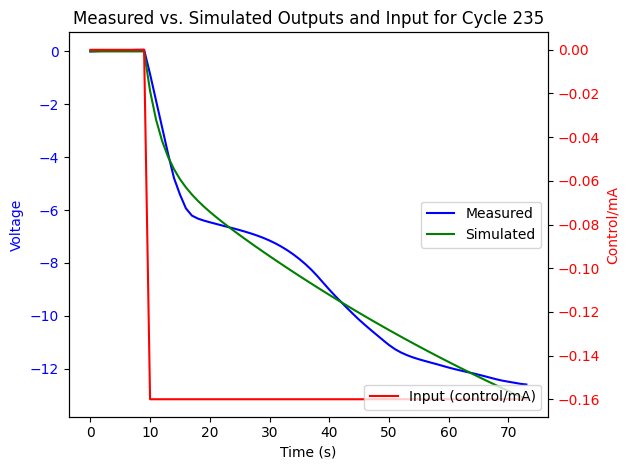

Cycle 236: G_hat_box_jenkins
<TransferFunction>: sys[210100]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


9.356 z^2 - 8.916 z
--------------------
z^2 - 1.677 z + 0.68

dt = 0.005

Cycle 236: Zeros
[0.95294683+0.j 0.        +0.j]
Cycle 236: Poles
[0.99069513+0.j 0.68635505+0.j]


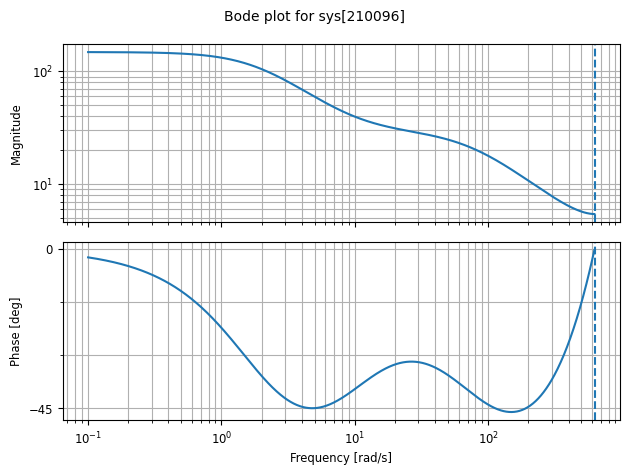

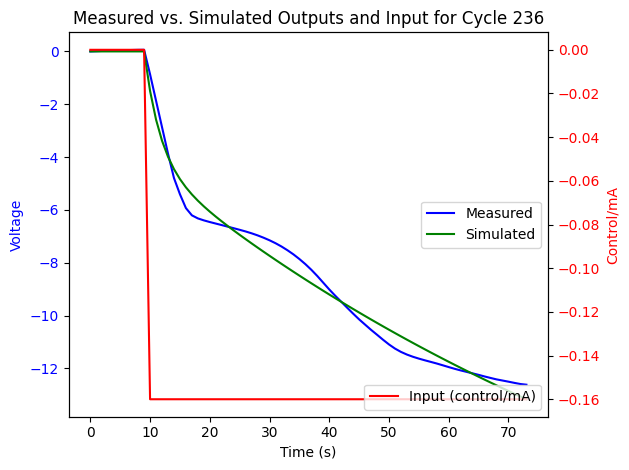

Cycle 237: G_hat_box_jenkins
<TransferFunction>: sys[210104]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


9.421 z^2 - 8.985 z
--------------------
z^2 - 1.677 z + 0.68

dt = 0.005

Cycle 237: Zeros
[0.9537217+0.j 0.       +0.j]
Cycle 237: Poles
[0.99089261+0.j 0.68621992+0.j]


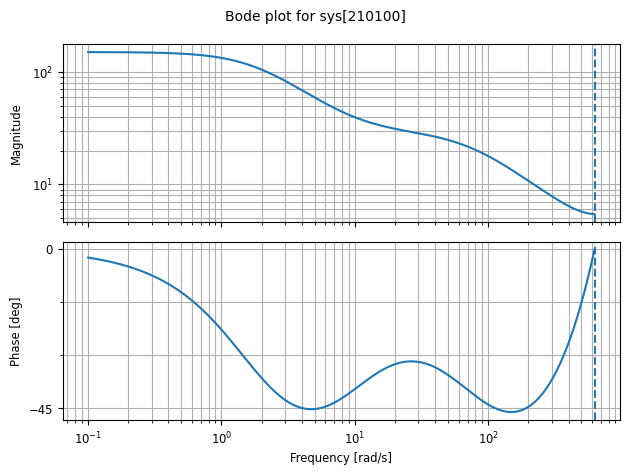

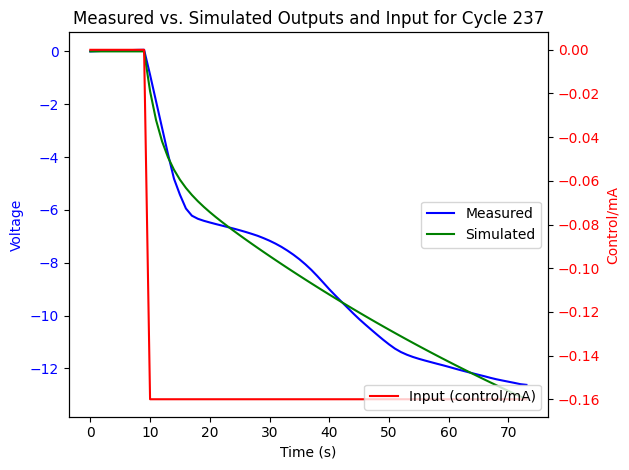

Cycle 238: G_hat_box_jenkins
<TransferFunction>: sys[210108]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  9.43 z^2 - 8.994 z
----------------------
z^2 - 1.678 z + 0.6805

dt = 0.005

Cycle 238: Zeros
[0.95378987+0.j 0.        +0.j]
Cycle 238: Poles
[0.99080756+0.j 0.6868621 +0.j]


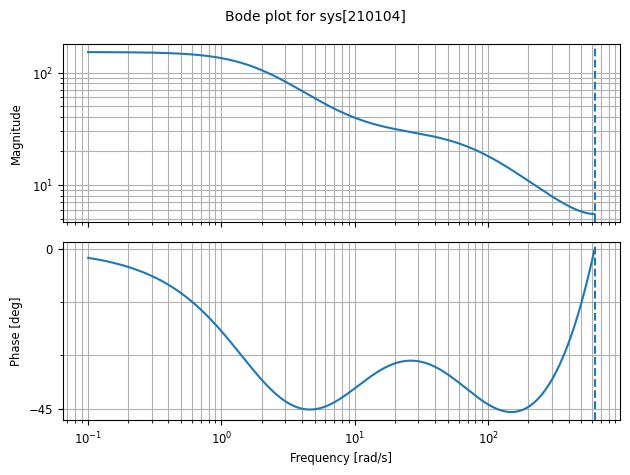

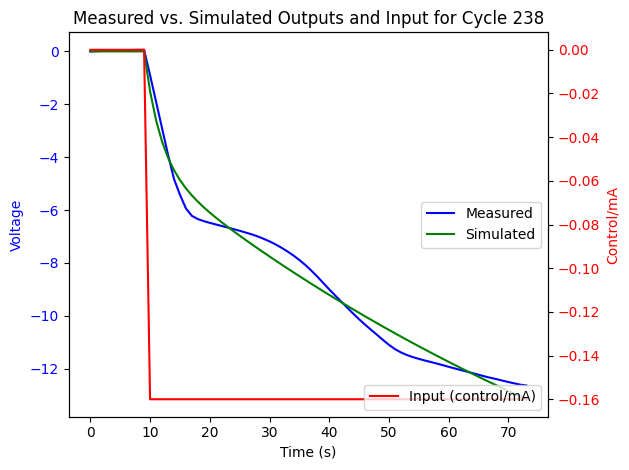

Cycle 239: G_hat_box_jenkins
<TransferFunction>: sys[210112]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.388 z^2 - 8.949 z
----------------------
z^2 - 1.679 z + 0.6815

dt = 0.005

Cycle 239: Zeros
[0.95325768+0.j 0.        +0.j]
Cycle 239: Poles
[0.99082126+0.j 0.68779485+0.j]


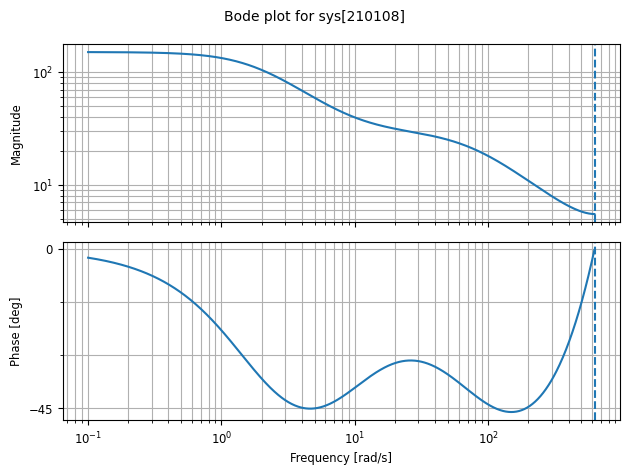

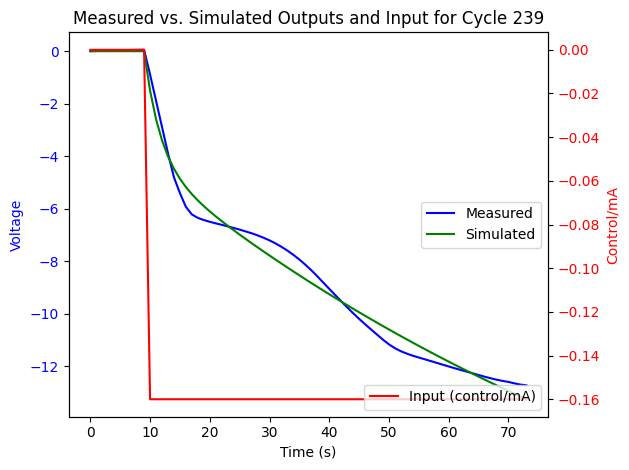

Cycle 240: G_hat_box_jenkins
<TransferFunction>: sys[210116]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.134 z^2 - 8.693 z
----------------------
z^2 - 1.681 z + 0.6839

dt = 0.005

Cycle 240: Zeros
[0.95175101+0.j 0.        +0.j]
Cycle 240: Poles
[0.99048089+0.j 0.69050982+0.j]


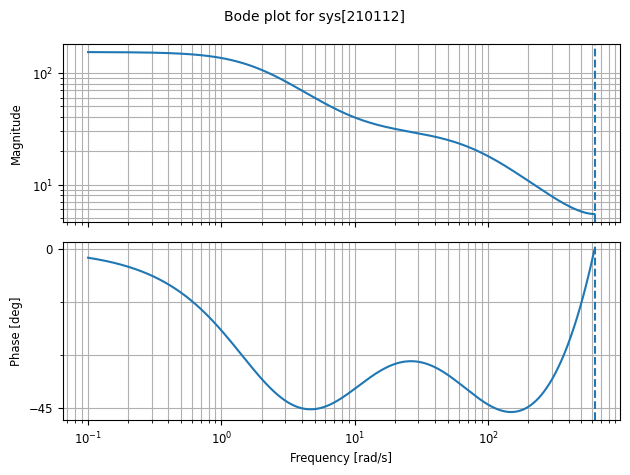

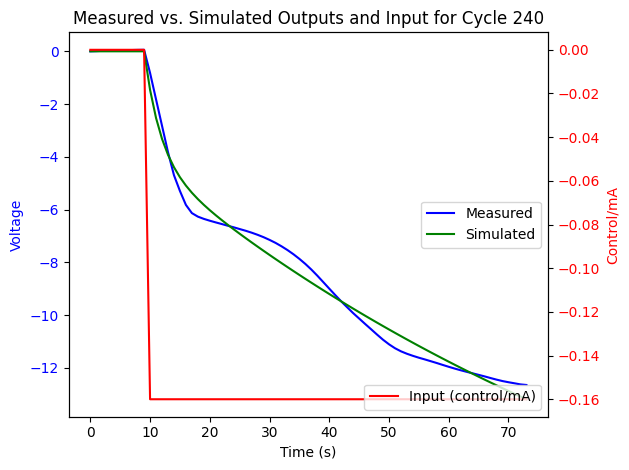

Cycle 241: G_hat_box_jenkins
<TransferFunction>: sys[210120]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.137 z^2 - 8.697 z
----------------------
z^2 - 1.682 z + 0.6846

dt = 0.005

Cycle 241: Zeros
[0.95185646+0.j 0.        +0.j]
Cycle 241: Poles
[0.99038623+0.j 0.69127744+0.j]


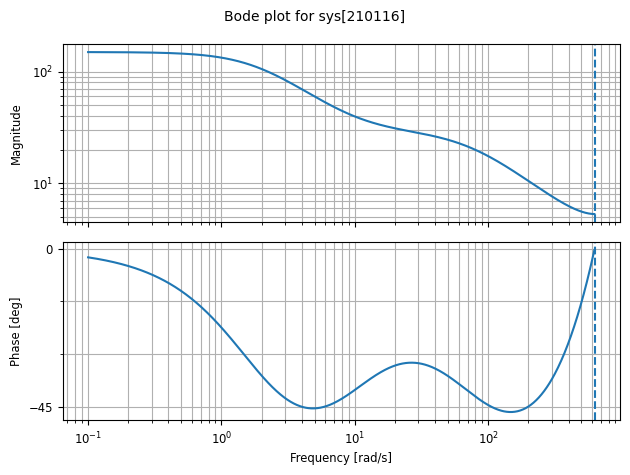

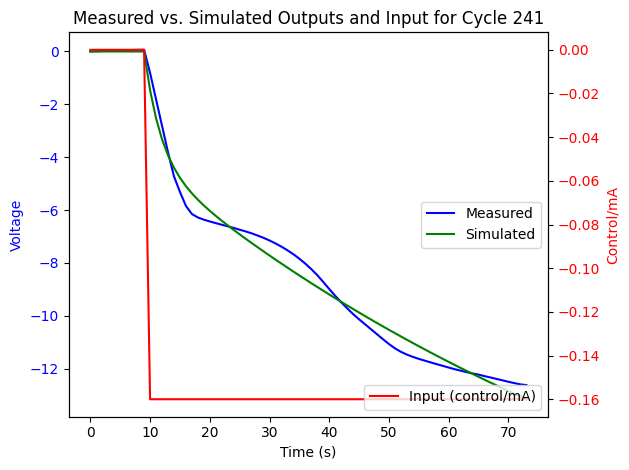

Cycle 242: G_hat_box_jenkins
<TransferFunction>: sys[210124]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  9.111 z^2 - 8.69 z
----------------------
z^2 - 1.685 z + 0.6879

dt = 0.005

Cycle 242: Zeros
[0.95380791+0.j 0.        +0.j]
Cycle 242: Poles
[0.99126912+0.j 0.69393542+0.j]


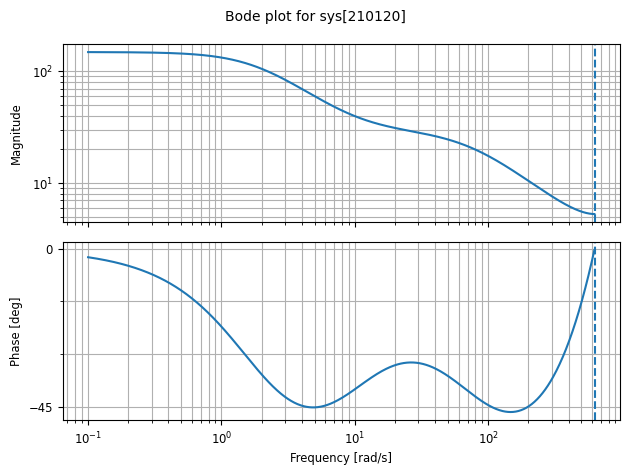

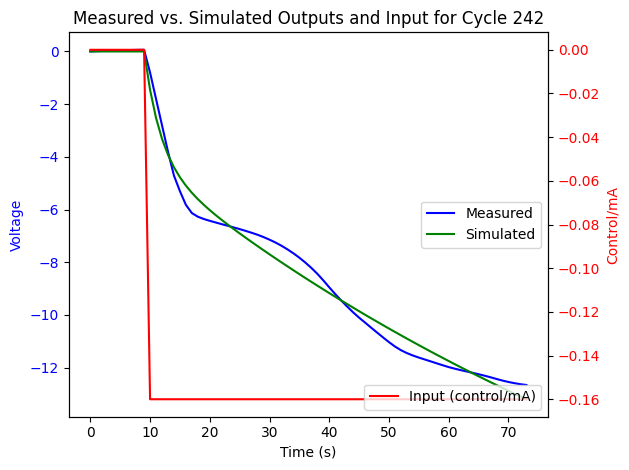

Cycle 243: G_hat_box_jenkins
<TransferFunction>: sys[210128]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  9.1 z^2 - 8.678 z
----------------------
z^2 - 1.685 z + 0.6874

dt = 0.005

Cycle 243: Zeros
[0.95356479+0.j 0.        +0.j]
Cycle 243: Poles
[0.99109587+0.j 0.69357766+0.j]


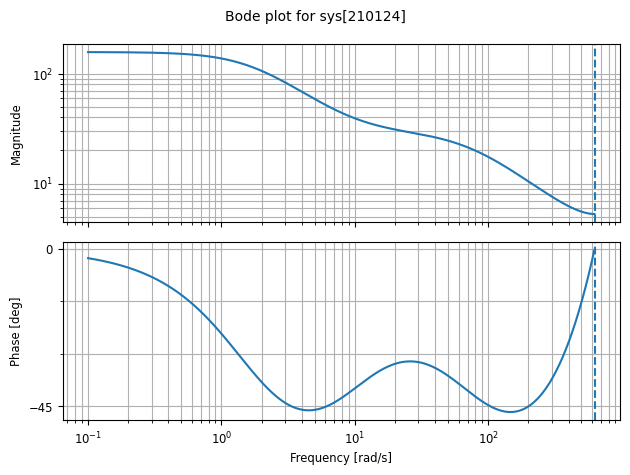

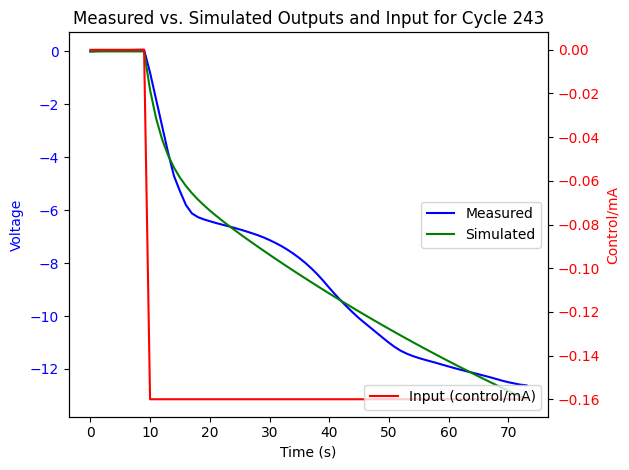

Cycle 244: G_hat_box_jenkins
<TransferFunction>: sys[210132]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.076 z^2 - 8.657 z
----------------------
z^2 - 1.686 z + 0.6883

dt = 0.005

Cycle 244: Zeros
[0.95389505+0.j 0.        +0.j]
Cycle 244: Poles
[0.99129095+0.j 0.6943964 +0.j]


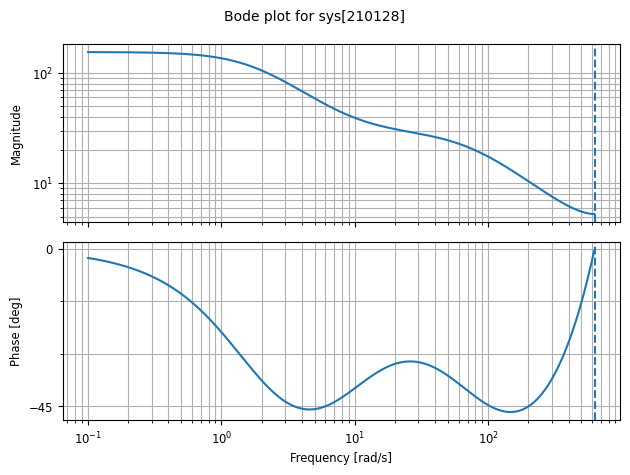

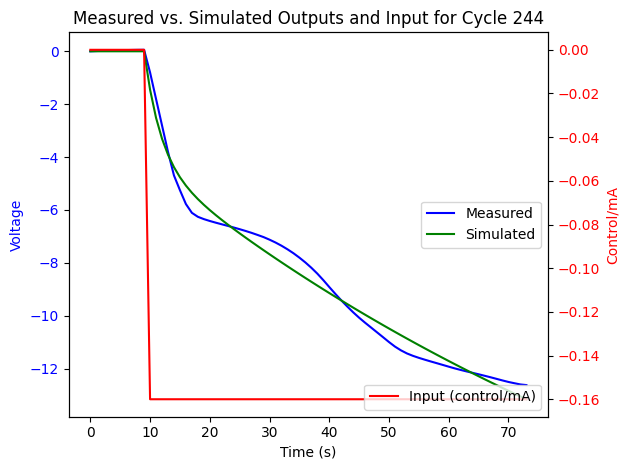

Cycle 245: G_hat_box_jenkins
<TransferFunction>: sys[210136]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.122 z^2 - 8.705 z
----------------------
z^2 - 1.685 z + 0.6874

dt = 0.005

Cycle 245: Zeros
[0.95426326+0.j 0.        +0.j]
Cycle 245: Poles
[0.99146776+0.j 0.69330806+0.j]


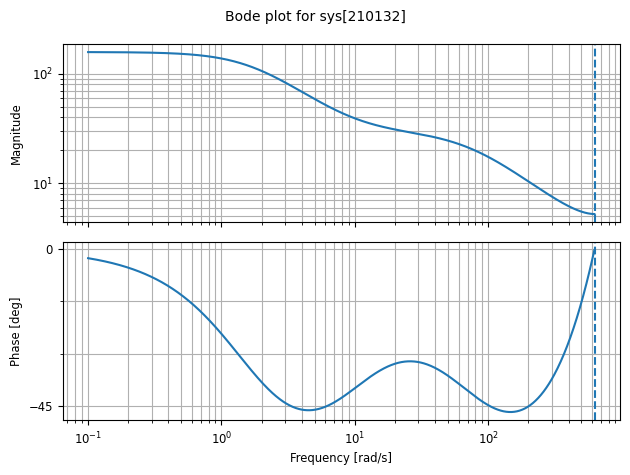

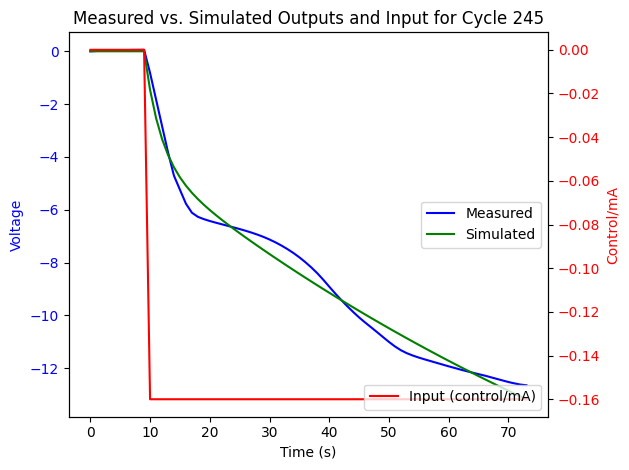

Cycle 246: G_hat_box_jenkins
<TransferFunction>: sys[210140]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.147 z^2 - 8.741 z
----------------------
z^2 - 1.686 z + 0.6882

dt = 0.005

Cycle 246: Zeros
[0.95562123+0.j 0.        +0.j]
Cycle 246: Poles
[0.99208612+0.j 0.6937051 +0.j]


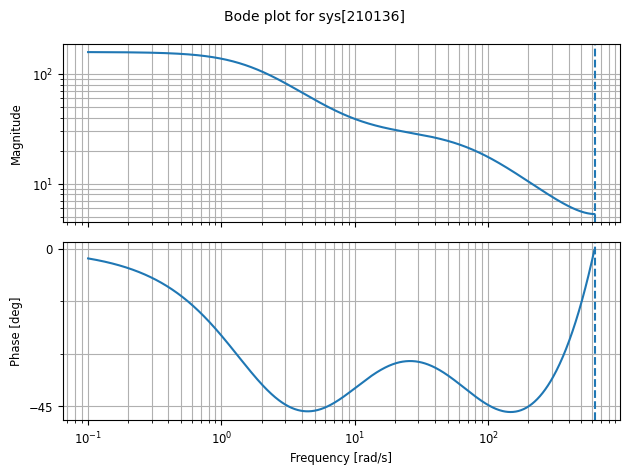

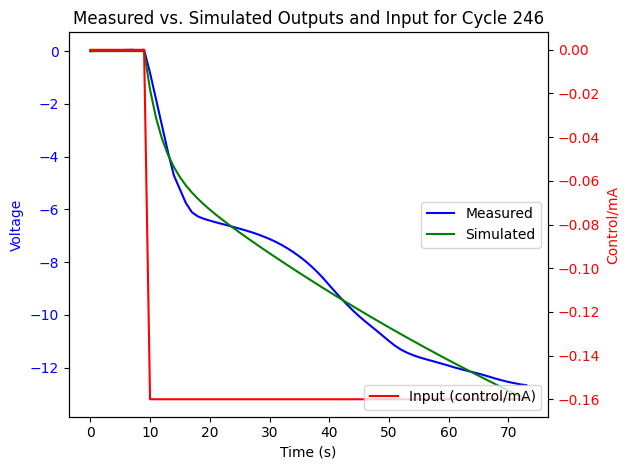

Cycle 247: G_hat_box_jenkins
<TransferFunction>: sys[210144]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.177 z^2 - 8.783 z
----------------------
z^2 - 1.688 z + 0.6905

dt = 0.005

Cycle 247: Zeros
[0.95703999+0.j 0.        +0.j]
Cycle 247: Poles
[0.99254715+0.j 0.69566529+0.j]


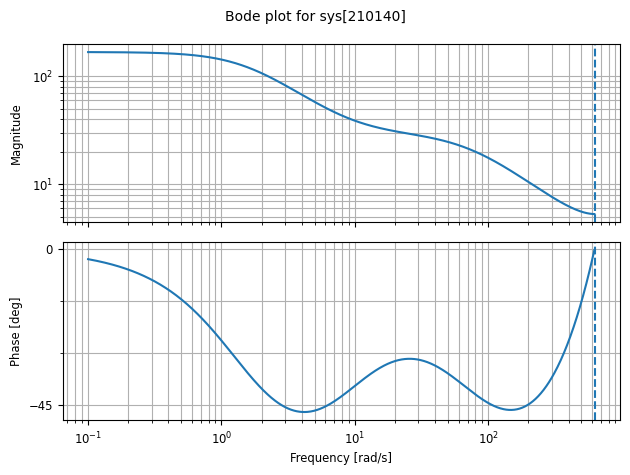

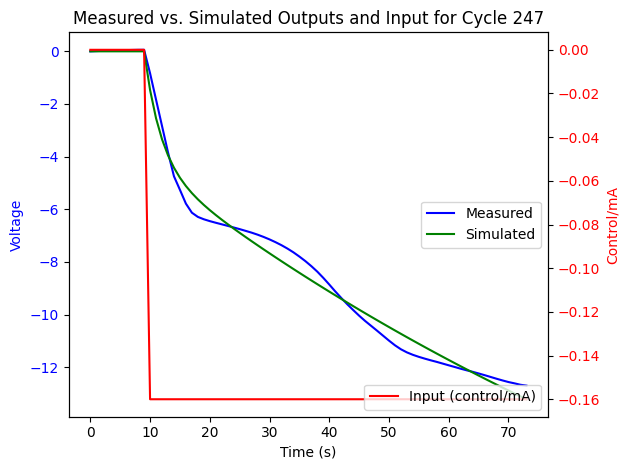

Cycle 248: G_hat_box_jenkins
<TransferFunction>: sys[210148]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.206 z^2 - 8.822 z
----------------------
z^2 - 1.689 z + 0.6912

dt = 0.005

Cycle 248: Zeros
[0.9582095+0.j 0.       +0.j]
Cycle 248: Poles
[0.99317564+0.j 0.6959605 +0.j]


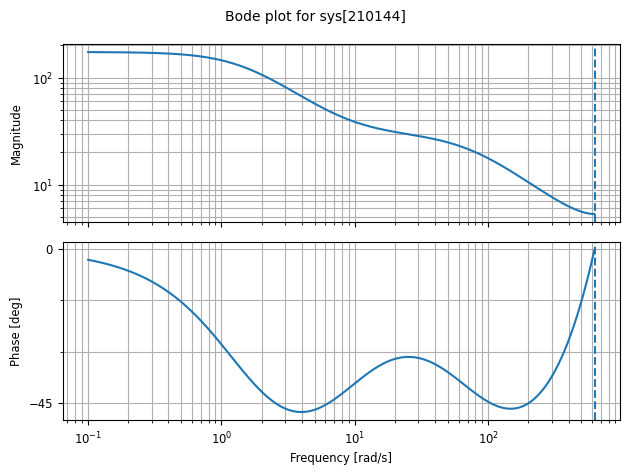

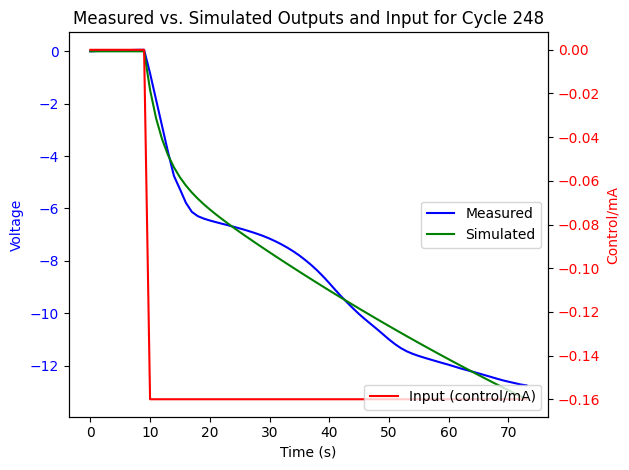

Cycle 249: G_hat_box_jenkins
<TransferFunction>: sys[210152]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.152 z^2 - 8.776 z
----------------------
z^2 - 1.691 z + 0.6925

dt = 0.005

Cycle 249: Zeros
[0.95895877+0.j 0.        +0.j]
Cycle 249: Poles
[0.99379282+0.j 0.69685722+0.j]


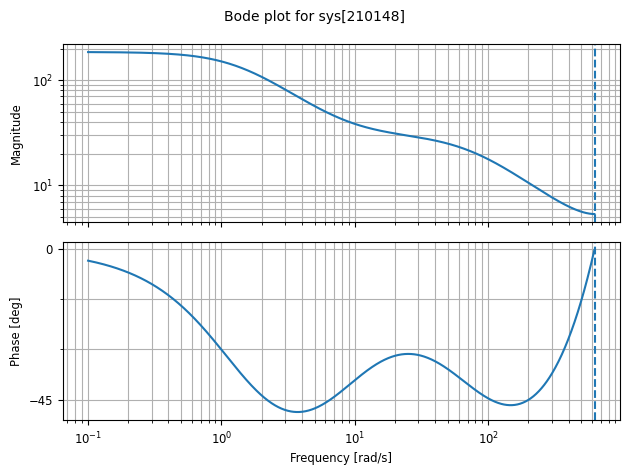

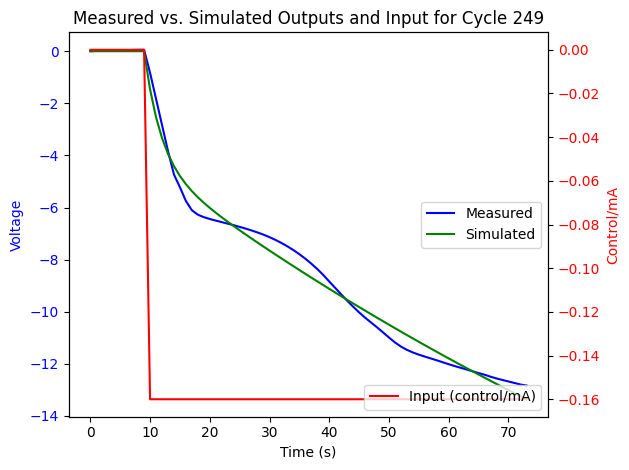

Cycle 250: G_hat_box_jenkins
<TransferFunction>: sys[210156]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.121 z^2 - 8.755 z
----------------------
z^2 - 1.693 z + 0.6949

dt = 0.005

Cycle 250: Zeros
[0.9598151+0.j 0.       +0.j]
Cycle 250: Poles
[0.99424552+0.j 0.69890921+0.j]


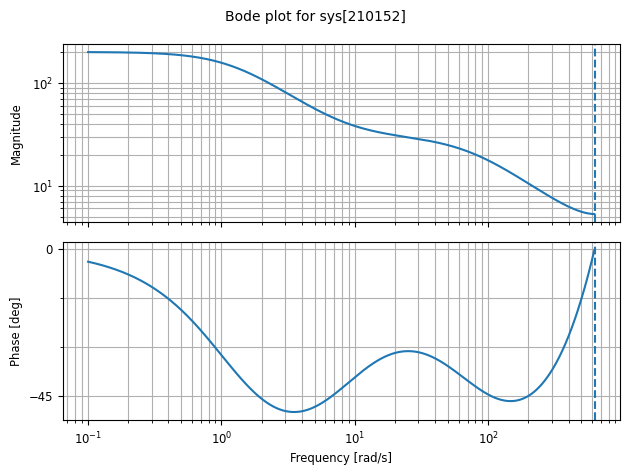

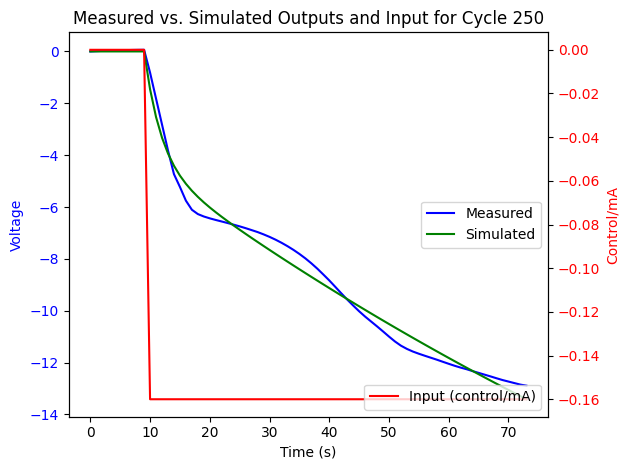

Cycle 251: G_hat_box_jenkins
<TransferFunction>: sys[210160]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 9.166 z^2 - 8.855 z
----------------------
z^2 - 1.696 z + 0.6975

dt = 0.005

Cycle 251: Zeros
[0.96606273+0.j 0.        +0.j]
Cycle 251: Poles
[0.99543163+0.j 0.70071045+0.j]


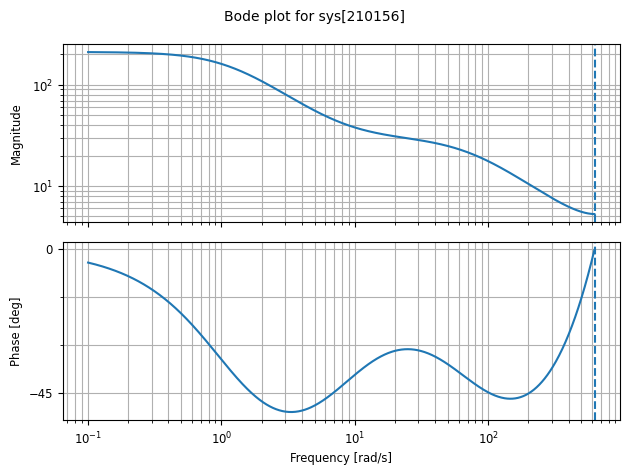

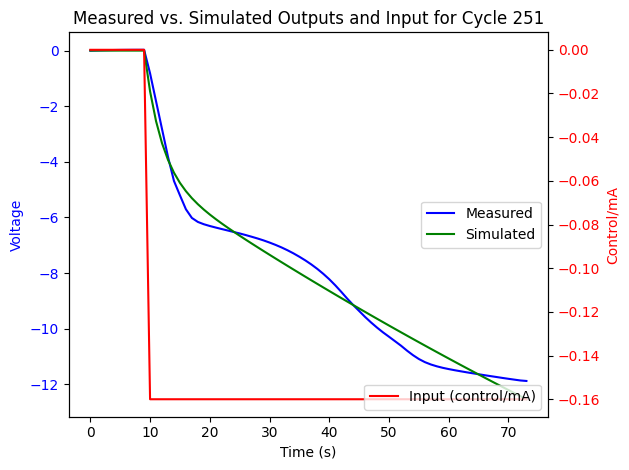

Cycle 252: G_hat_box_jenkins
<TransferFunction>: sys[210164]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.672 z^2 - 8.471 z
---------------------
z^2 - 1.709 z + 0.709

dt = 0.005

Cycle 252: Zeros
[0.97684384+0.j 0.        +0.j]
Cycle 252: Poles
[1.00060865+0.j 0.70854525+0.j]


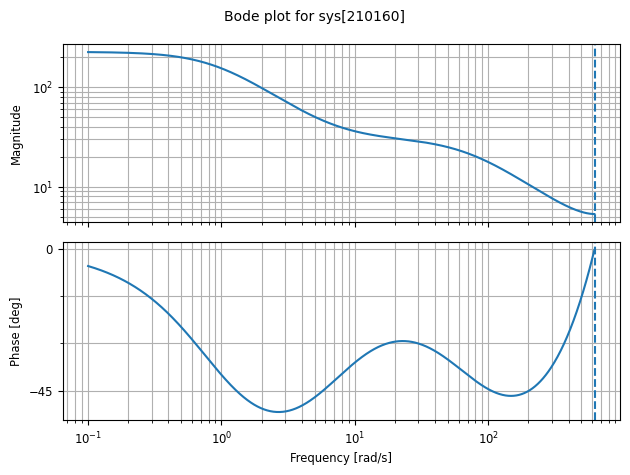

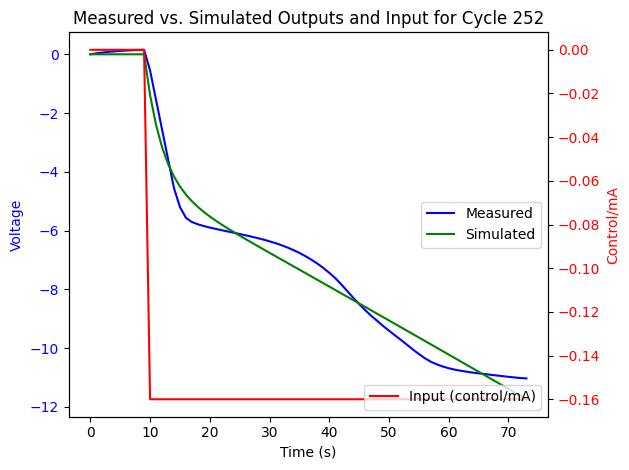

Cycle 253: G_hat_box_jenkins
<TransferFunction>: sys[210168]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


  8.75 z^2 - 8.613 z
----------------------
z^2 - 1.719 z + 0.7173

dt = 0.005

Cycle 253: Zeros
[0.98435073+0.j 0.        +0.j]
Cycle 253: Poles
[1.00436888+0.j 0.71422503+0.j]


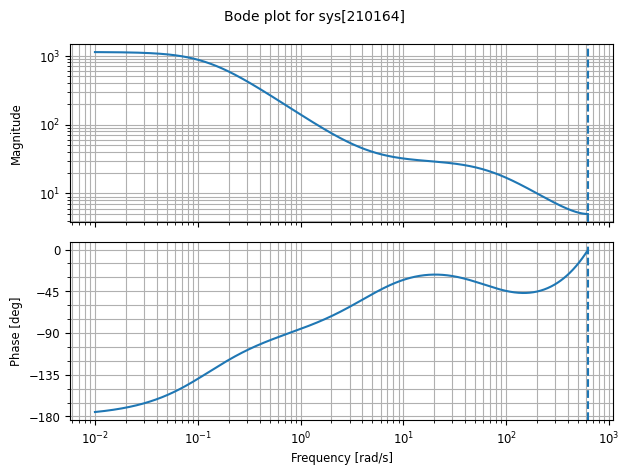

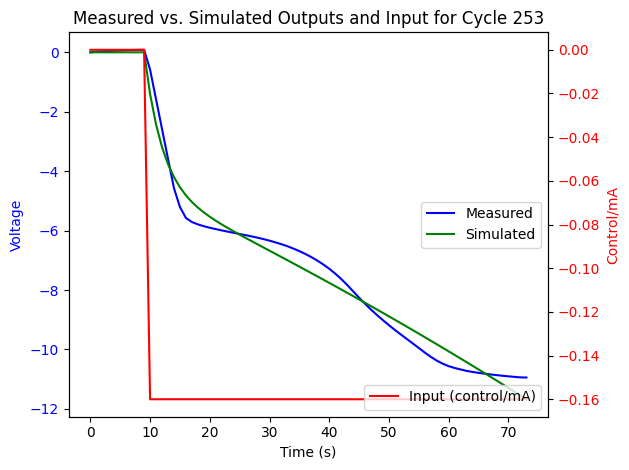

Cycle 254: G_hat_box_jenkins
<TransferFunction>: sys[210172]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.782 z^2 - 8.635 z
---------------------
z^2 - 1.717 z + 0.716

dt = 0.005

Cycle 254: Zeros
[0.98315244+0.j 0.        +0.j]
Cycle 254: Poles
[1.00343407+0.j 0.71353372+0.j]


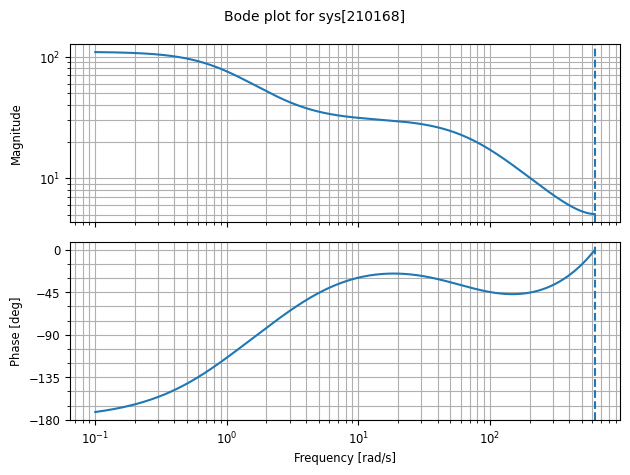

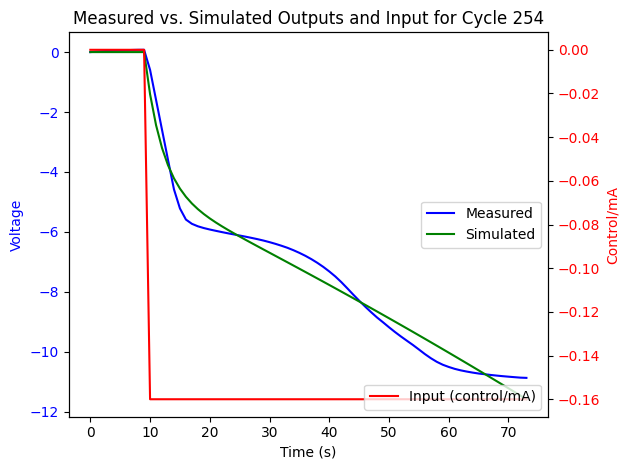

Cycle 255: G_hat_box_jenkins
<TransferFunction>: sys[210176]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.834 z^2 - 8.653 z
----------------------
z^2 - 1.711 z + 0.7109

dt = 0.005

Cycle 255: Zeros
[0.97951712+0.j 0.        +0.j]
Cycle 255: Poles
[1.00141462+0.j 0.70989582+0.j]


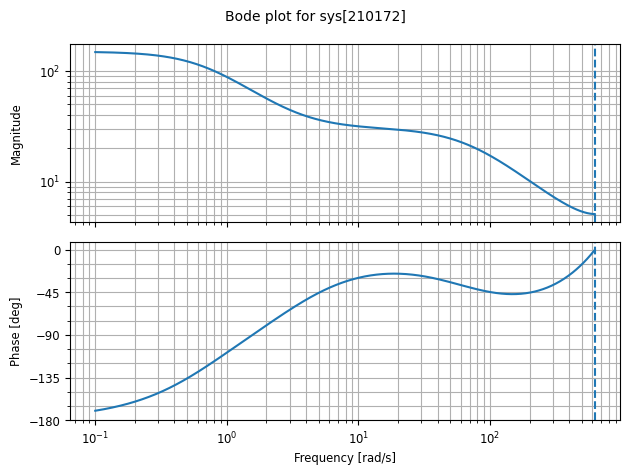

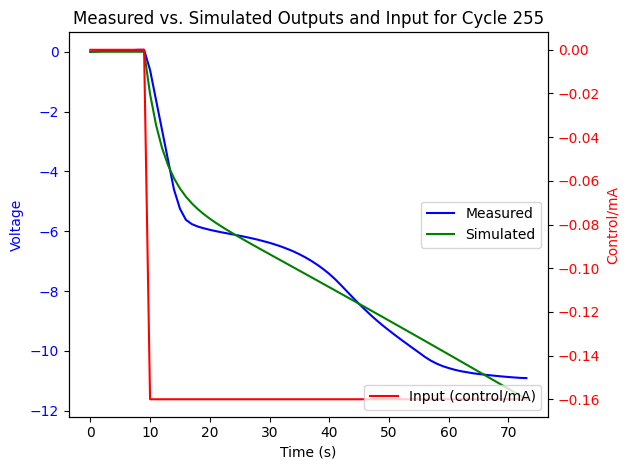

Cycle 256: G_hat_box_jenkins
<TransferFunction>: sys[210180]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.775 z^2 - 8.555 z
----------------------
z^2 - 1.706 z + 0.7062

dt = 0.005

Cycle 256: Zeros
[0.97490031+0.j 0.        +0.j]
Cycle 256: Poles
[0.99896511+0.j 0.7068914 +0.j]


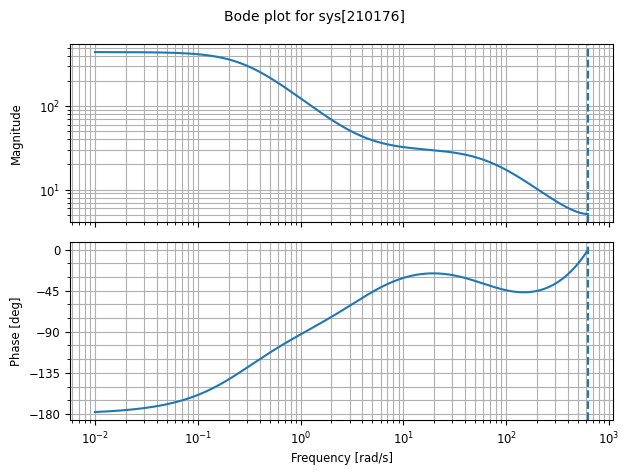

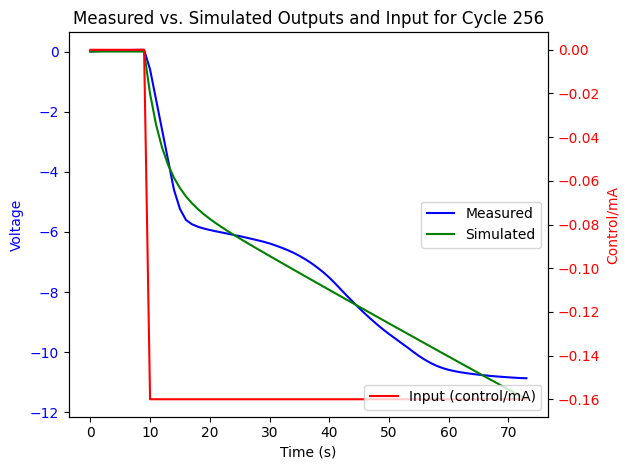

Cycle 257: G_hat_box_jenkins
<TransferFunction>: sys[210184]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.743 z^2 - 8.487 z
----------------------
z^2 - 1.701 z + 0.7019

dt = 0.005

Cycle 257: Zeros
[0.97066494+0.j 0.        +0.j]
Cycle 257: Poles
[0.99677445+0.j 0.70413649+0.j]


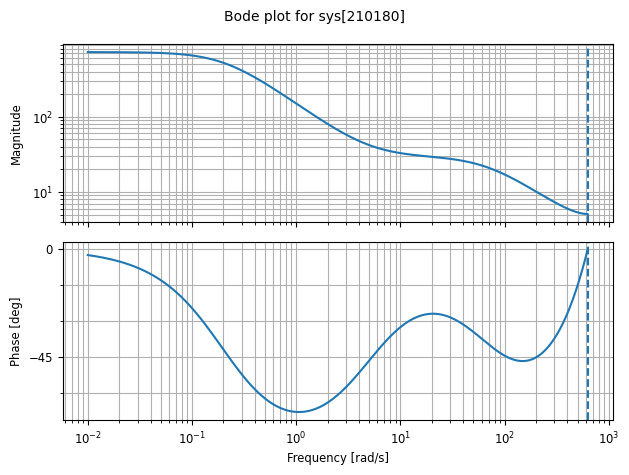

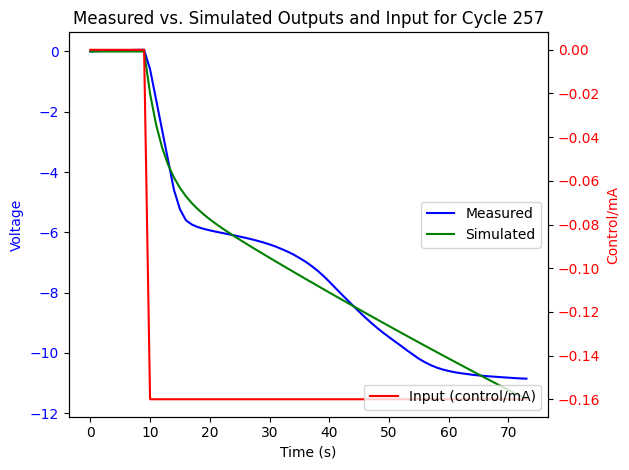

Cycle 258: G_hat_box_jenkins
<TransferFunction>: sys[210188]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.627 z^2 - 8.307 z
----------------------
z^2 - 1.694 z + 0.6956

dt = 0.005

Cycle 258: Zeros
[0.96294107+0.j 0.        +0.j]
Cycle 258: Poles
[0.99318503+0.j 0.70037505+0.j]


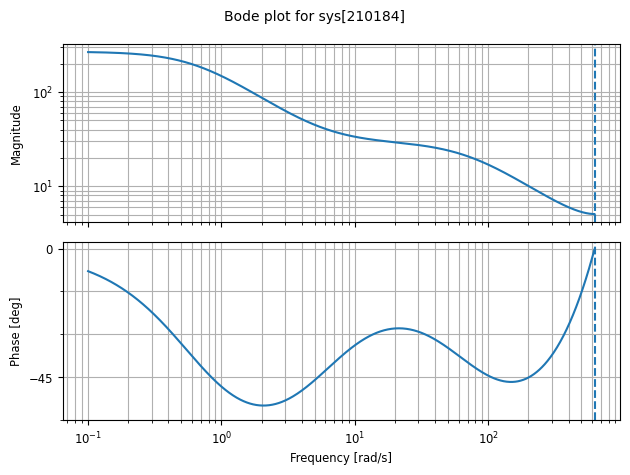

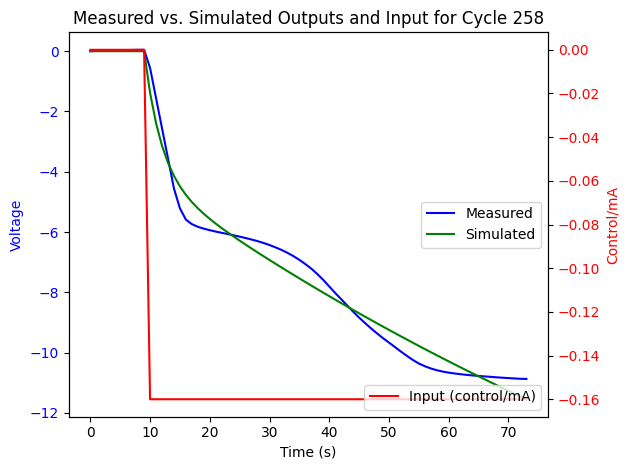

Cycle 259: G_hat_box_jenkins
<TransferFunction>: sys[210192]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.544 z^2 - 8.216 z
----------------------
z^2 - 1.693 z + 0.6947

dt = 0.005

Cycle 259: Zeros
[0.96163784+0.j 0.        +0.j]
Cycle 259: Poles
[0.99286059+0.j 0.69972545+0.j]


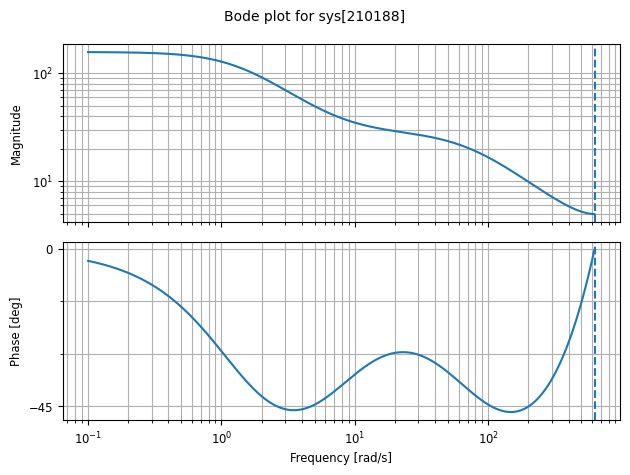

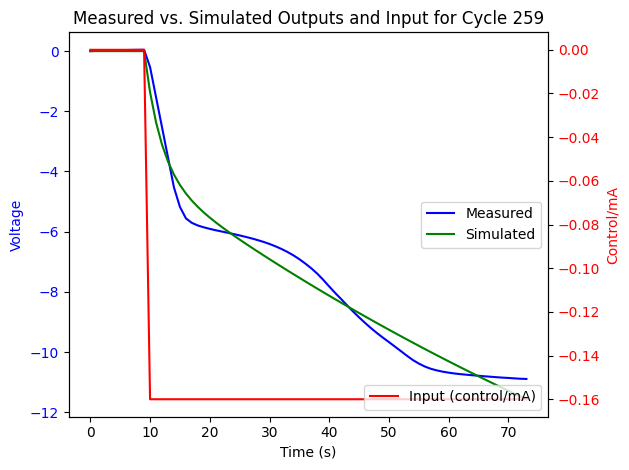

Cycle 260: G_hat_box_jenkins
<TransferFunction>: sys[210196]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.508 z^2 - 8.148 z
----------------------
z^2 - 1.687 z + 0.6901

dt = 0.005

Cycle 260: Zeros
[0.95766374+0.j 0.        +0.j]
Cycle 260: Poles
[0.99114457+0.j 0.6962954 +0.j]


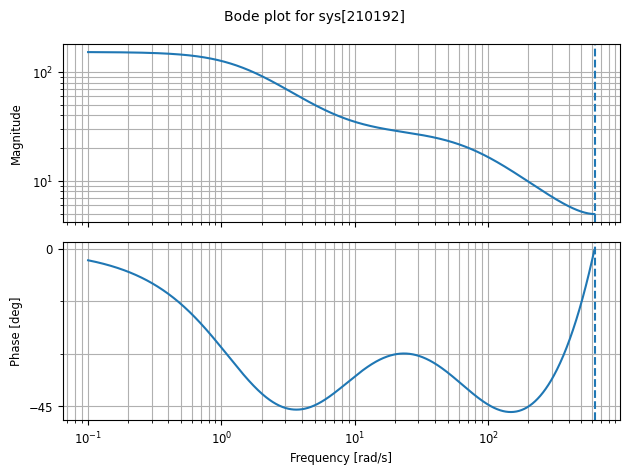

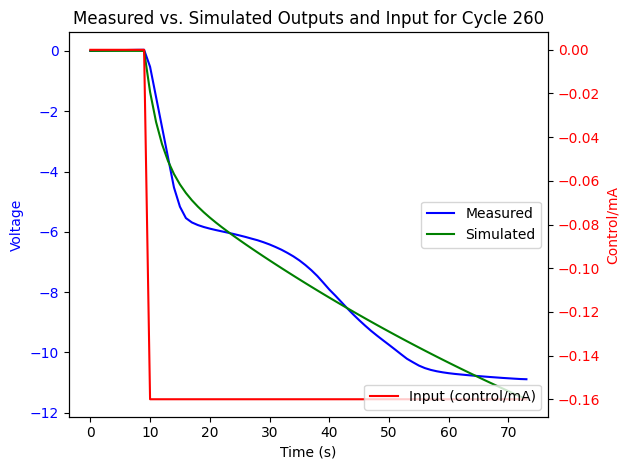

Cycle 261: G_hat_box_jenkins
<TransferFunction>: sys[210200]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.445 z^2 - 8.078 z
----------------------
z^2 - 1.687 z + 0.6902

dt = 0.005

Cycle 261: Zeros
[0.95652927+0.j 0.        +0.j]
Cycle 261: Poles
[0.99064125+0.j 0.69673144+0.j]


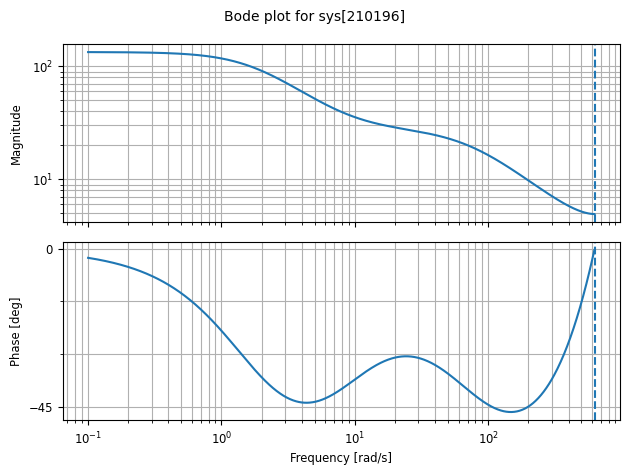

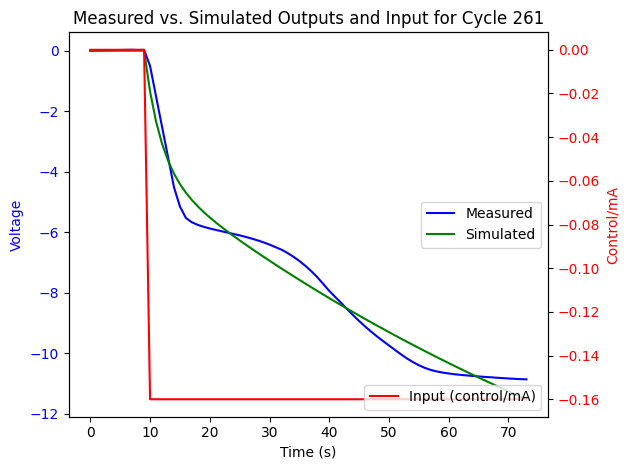

Cycle 262: G_hat_box_jenkins
<TransferFunction>: sys[210204]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.406 z^2 - 8.052 z
---------------------
z^2 - 1.69 z + 0.6924

dt = 0.005

Cycle 262: Zeros
[0.95782859+0.j 0.        +0.j]
Cycle 262: Poles
[0.99123055+0.j 0.69848544+0.j]


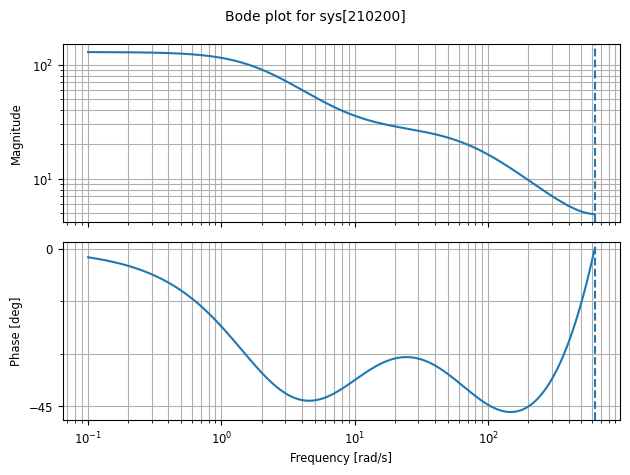

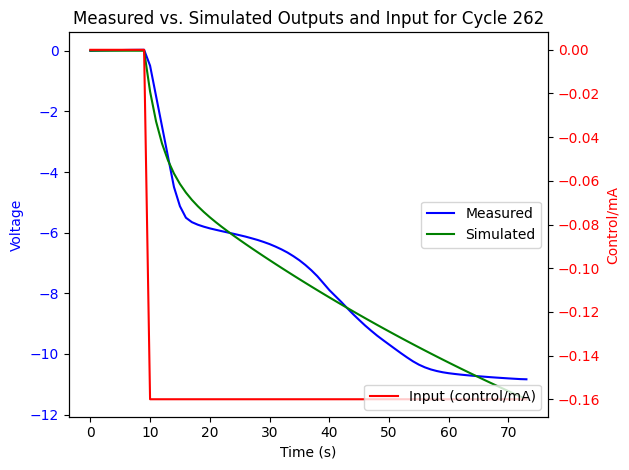

Cycle 263: G_hat_box_jenkins
<TransferFunction>: sys[210208]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.403 z^2 - 8.041 z
----------------------
z^2 - 1.689 z + 0.6916

dt = 0.005

Cycle 263: Zeros
[0.95688293+0.j 0.        +0.j]
Cycle 263: Poles
[0.9907596 +0.j 0.69809246+0.j]


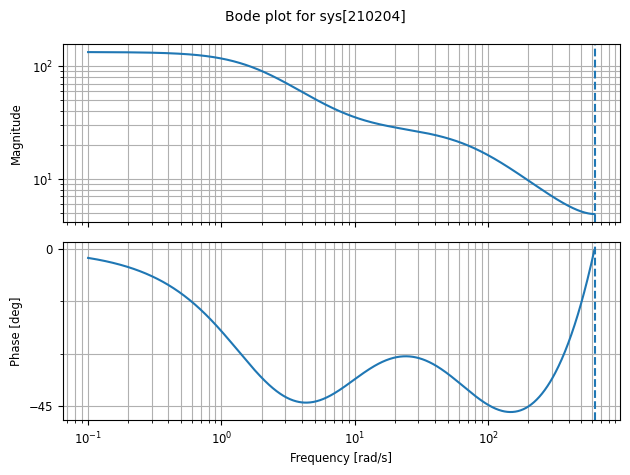

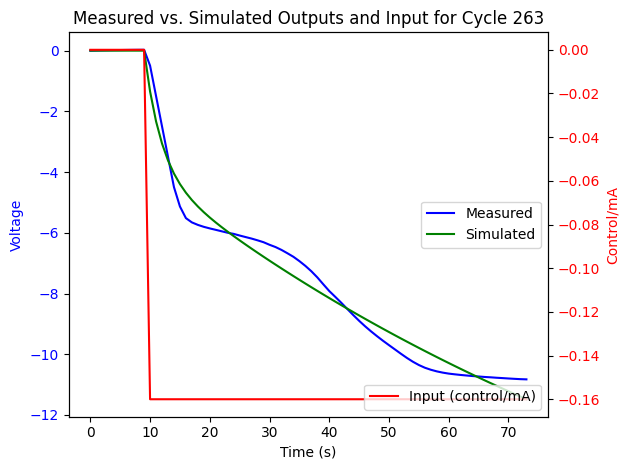

Cycle 264: G_hat_box_jenkins
<TransferFunction>: sys[210212]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.385 z^2 - 8.013 z
----------------------
z^2 - 1.687 z + 0.6901

dt = 0.005

Cycle 264: Zeros
[0.95560023+0.j 0.        +0.j]
Cycle 264: Poles
[0.99016416+0.j 0.69698543+0.j]


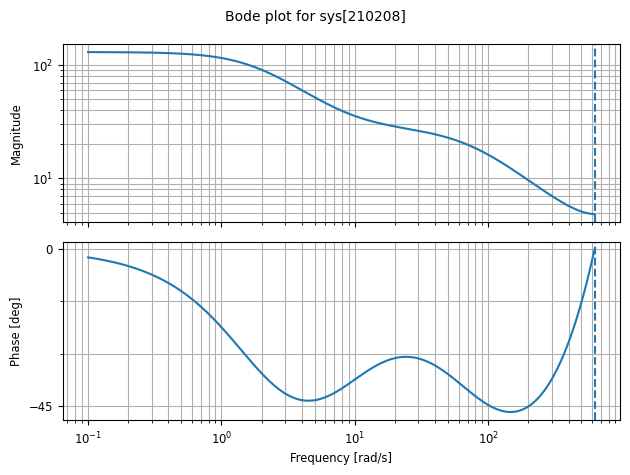

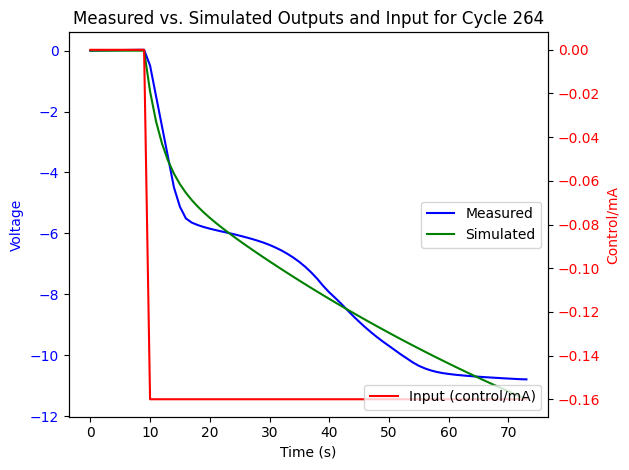

Cycle 265: G_hat_box_jenkins
<TransferFunction>: sys[210216]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.338 z^2 - 7.964 z
----------------------
z^2 - 1.688 z + 0.6914

dt = 0.005

Cycle 265: Zeros
[0.95521923+0.j 0.        +0.j]
Cycle 265: Poles
[0.98996278+0.j 0.69840897+0.j]


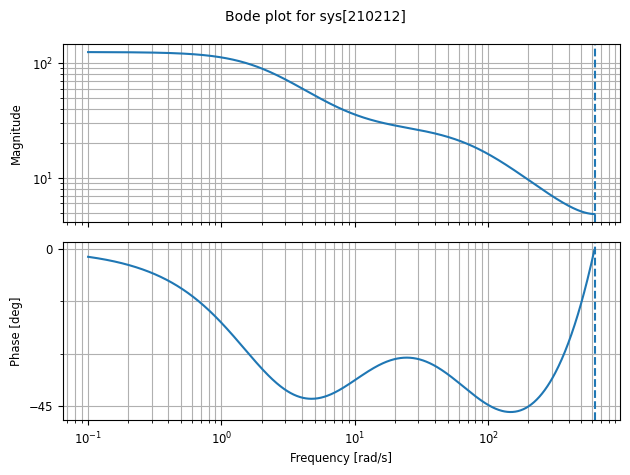

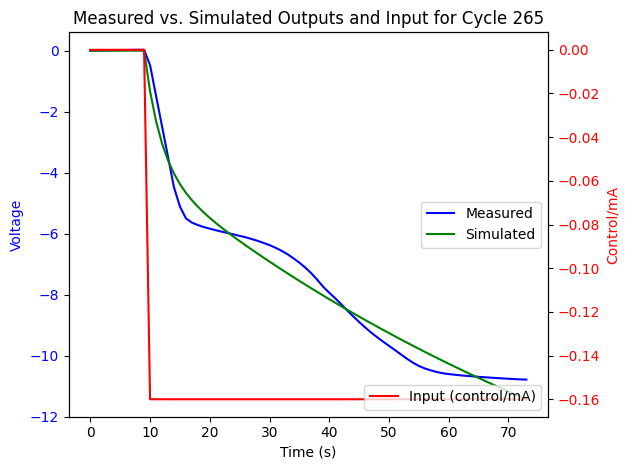

Cycle 266: G_hat_box_jenkins
<TransferFunction>: sys[210220]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.337 z^2 - 7.944 z
----------------------
z^2 - 1.686 z + 0.6893

dt = 0.005

Cycle 266: Zeros
[0.95287234+0.j 0.        +0.j]
Cycle 266: Poles
[0.98884455+0.j 0.69703964+0.j]


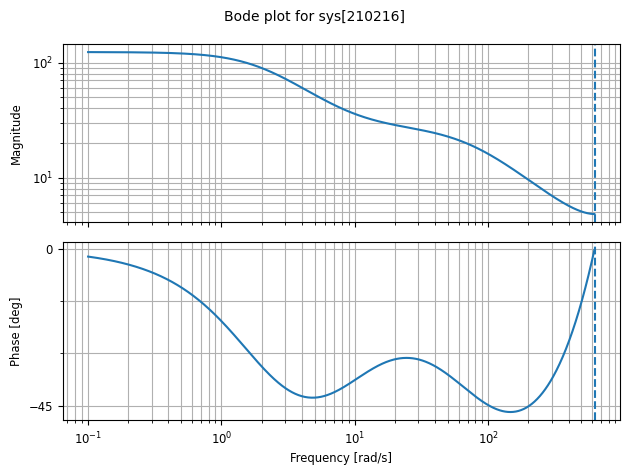

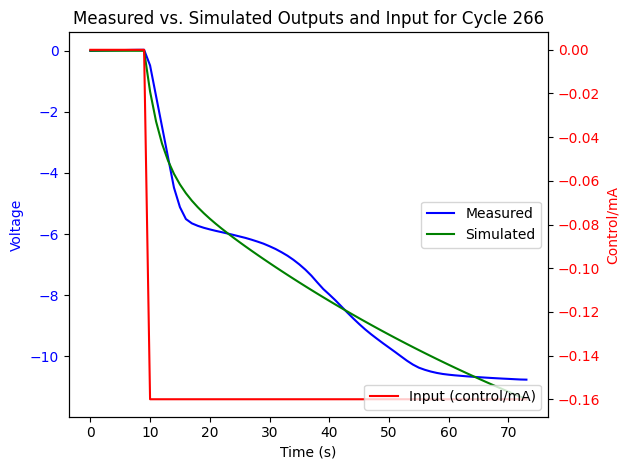

Cycle 267: G_hat_box_jenkins
<TransferFunction>: sys[210224]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.358 z^2 - 7.958 z
----------------------
z^2 - 1.684 z + 0.6879

dt = 0.005

Cycle 267: Zeros
[0.9520995+0.j 0.       +0.j]
Cycle 267: Poles
[0.9885016 +0.j 0.69593587+0.j]


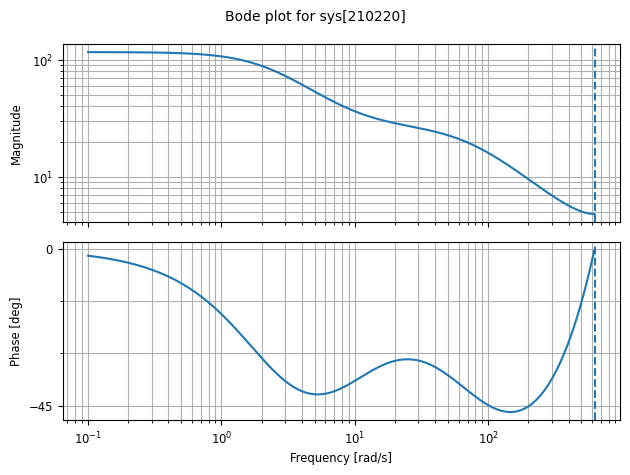

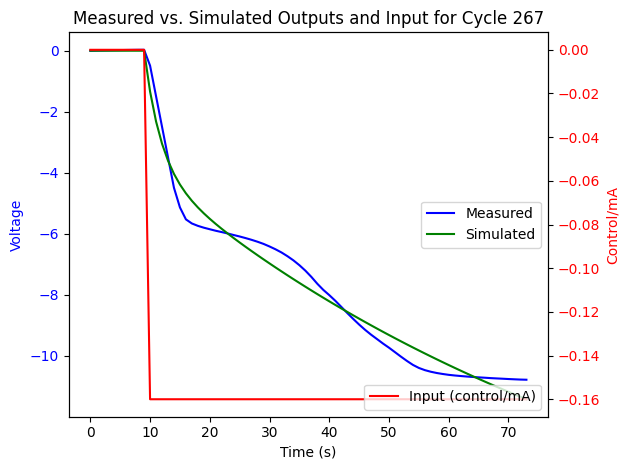

Cycle 268: G_hat_box_jenkins
<TransferFunction>: sys[210228]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 8.371 z^2 - 7.946 z
----------------------
z^2 - 1.681 z + 0.6851

dt = 0.005

Cycle 268: Zeros
[0.94921853+0.j 0.        +0.j]
Cycle 268: Poles
[0.98718143+0.j 0.69394677+0.j]


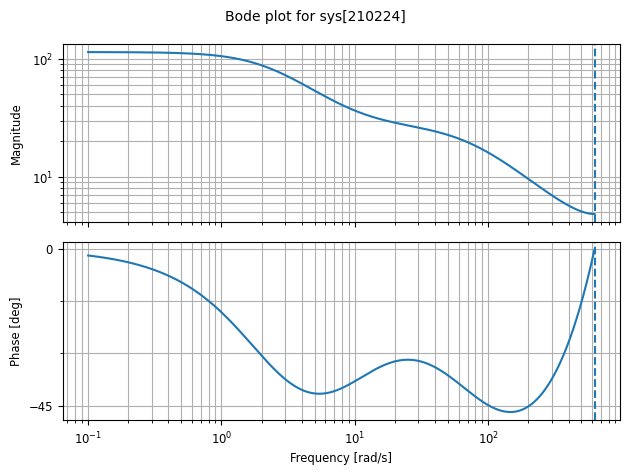

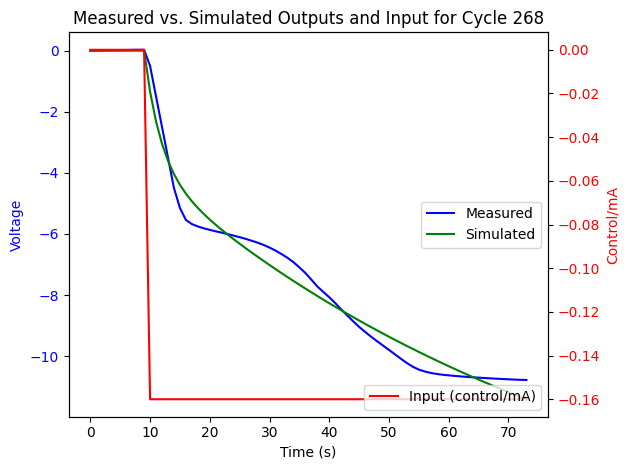

Cycle 269: G_hat_box_jenkins
<TransferFunction>: sys[210232]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 3.105 z^2 - 3.351 z
----------------------
z^2 - 2.001 z + 0.9947

dt = 0.005

Cycle 269: Zeros
[1.07913578+0.j 0.        +0.j]
Cycle 269: Poles
[1.07944904+0.j 0.92147996+0.j]


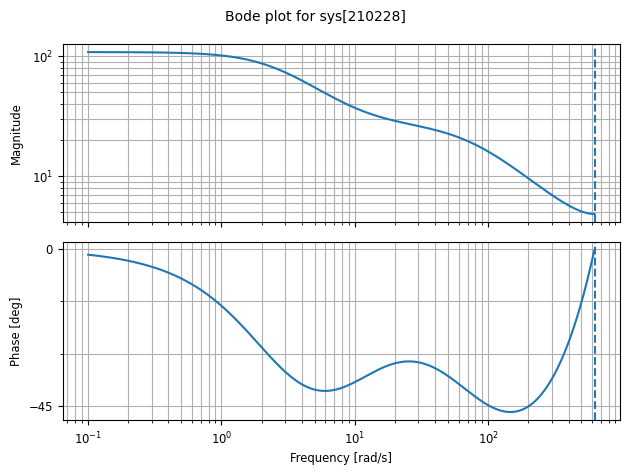

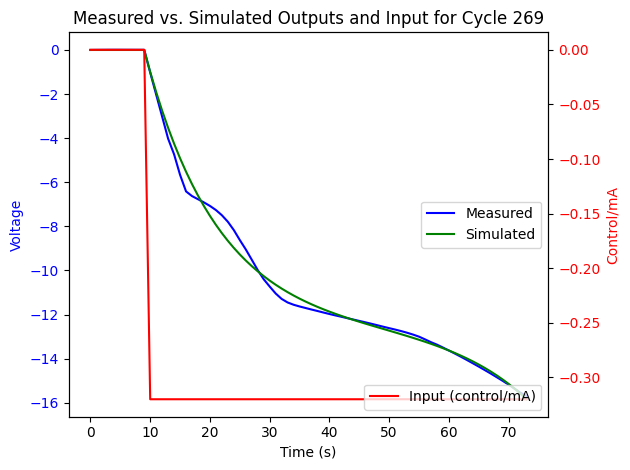

Cycle 270: G_hat_box_jenkins
<TransferFunction>: sys[210236]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


 1.981 z^2 - 1.854 z
----------------------
z^2 - 1.936 z + 0.9425

dt = 0.005

Cycle 270: Zeros
[0.93622417+0.j 0.        +0.j]
Cycle 270: Poles
[0.96802841+0.0734745j 0.96802841-0.0734745j]


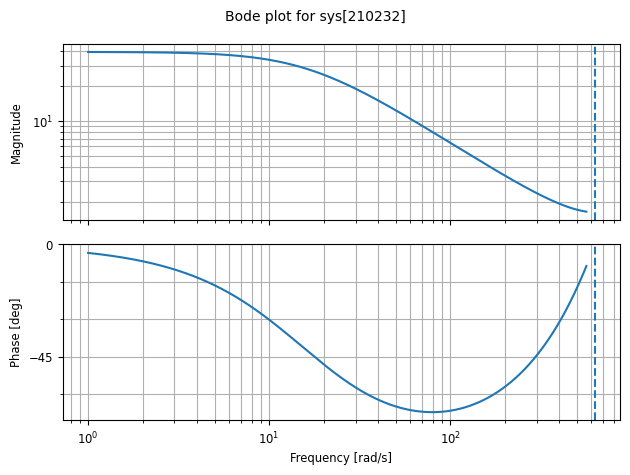

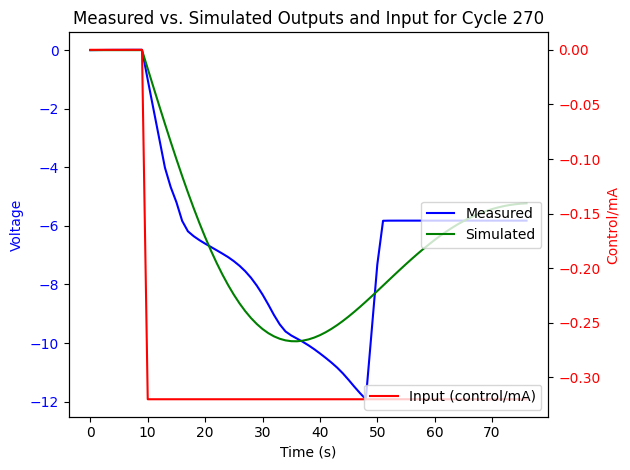

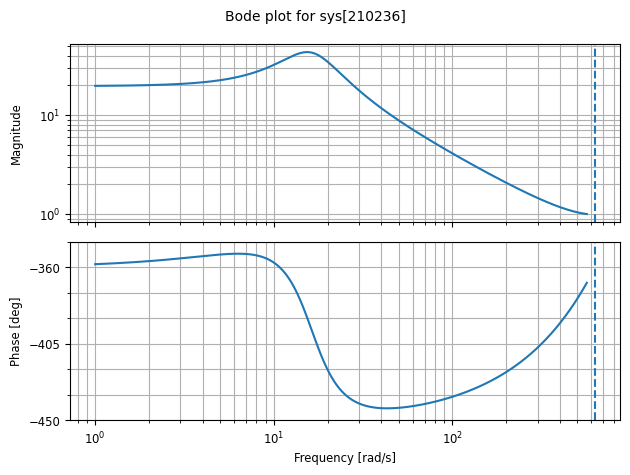

In [12]:
# Define sampling time
Ts = 0.005

# Loop through the arrays in yy and uu, skipping the first one
for i in range(1, len(yy)):
    # Extract the optimized parameters for the current cycle
    G_hat_box_jenkins, H_hat_box_jenkins = sid.theta_2_tf_box_jenkins(
        optimization_results_list[i-1].x, n_bj, Ts
    )
    
    # Print the transfer function
    print(f"Cycle {i}: G_hat_box_jenkins")
    print(G_hat_box_jenkins)
    
    # Print zeros and poles
    print(f"Cycle {i}: Zeros")
    print(G_hat_box_jenkins.zeros())
    print(f"Cycle {i}: Poles")
    print(G_hat_box_jenkins.poles())
    
    # Simulate the system's response using the identified transfer function
    tt, y_sim = ct.forced_response(G_hat_box_jenkins, U=uu[i])
    
    # Plot measured vs. simulated output and input on two y-axes
    fig, ax1 = plt.subplots()

    # Plot measured and simulated output on the left y-axis
    ax1.plot(yy[i], 'b-', label='Measured')
    ax1.plot(y_sim, 'g-', label='Simulated')
    ax1.set_xlabel('Time (s)')
    ax1.set_ylabel('Voltage', color='b')
    ax1.tick_params(axis='y', labelcolor='b')
    ax1.legend(loc='center right')  # Legend location: middle right

    # Create a second y-axis for the input (control/mA)
    ax2 = ax1.twinx()
    ax2.plot(uu[i], 'r-', label='Input (control/mA)')
    ax2.set_ylabel('Control/mA', color='r')
    ax2.tick_params(axis='y', labelcolor='r')
    ax2.legend(loc='lower right')  # Legend location: lower right

    # Add title
    plt.title(f'Measured vs. Simulated Outputs and Input for Cycle {i}')
    
    # Adjust layout to avoid overlapping labels
    fig.tight_layout()

    # Show the plot
    plt.show()

    # Bode plot for the identified transfer function
    out = ct.bode_plot(G_hat_box_jenkins)


In [13]:
# out=ct.bode_plot(G_hat_box_jenkins)

In [14]:
# # # Iterate through all cycles, skipping the first one
# # for i in range(1, len(yy)):
# #     # Define t0
# #     t0 = 10
    
# #     # Simulate the system's response using the identified transfer function
# #     tt, y_sim = ct.forced_response(G_hat_box_jenkins, U=uu[i])
    
# #     # Ensure both yy[i] and y_sim have the same length after t0
# #     min_len = min(len(yy[i][t0:-1]), len(y_sim[t0:-1]))
    
# #     # Calculate the error (epsilon) between measured and simulated outputs
# #     epsilon = yy[i][t0:t0+min_len] - y_sim[t0:t0+min_len]
    
# #     # Plot the error
# #     fig, ax = plt.subplots(1)
# #     ax.plot(epsilon)
# #     ax.set_title(f'Error (epsilon) for Cycle {i}')
# #     ax.set_xlabel('Time (s)')
# #     ax.set_ylabel('Error (Measured - Simulated)')
# #     plt.show()
    
# #     # Perform auto-correlation test on the error signal
# #     sid.auto_correlation_test(epsilon, tau=20)


# # Iterate through all cycles, skipping the first one
# for i in range(1, len(yy)):
#     # Define t0
#     t0 = 10
    
#     # Simulate the system's response using the identified transfer function
#     tt, y_sim = ct.forced_response(G_hat_box_jenkins, U=uu[i])
    
#     # Ensure both yy[i] and y_sim have the same length after t0
#     yy_i_sliced = yy[i][t0:-1]  # Slice yy[i] starting from t0
#     y_sim_sliced = y_sim[t0:-1]  # Slice y_sim starting from t0
#     min_len = min(len(yy_i_sliced), len(y_sim_sliced))
    
#     # Adjust yy_i_sliced and y_sim_sliced to have the same length
#     yy_i_sliced = yy_i_sliced[:min_len]
#     y_sim_sliced = y_sim_sliced[:min_len]
    
#     # Calculate the error (epsilon) between measured and simulated outputs
#     epsilon = yy_i_sliced - y_sim_sliced
    
#     # Plot the error
#     fig, ax = plt.subplots(1)
#     ax.plot(epsilon)
#     ax.set_title(f'Error (epsilon) for Cycle {i}')
#     ax.set_xlabel('Time (s)')
#     ax.set_ylabel('Error (Measured - Simulated)')
#     plt.show()
    
#     # Perform auto-correlation test on the error signal
#     sid.auto_correlation_test(epsilon, tau=20)


In [15]:
# sid.auto_correlation_test(epsilon,tau=20)

Cycle 5: G_hat_box_jenkins
<TransferFunction>: sys[210984]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


      61.45 z^3 - 59.4 z^2
---------------------------------
z^3 - 1.648 z^2 + 0.82 z - 0.1601

dt = 0.005

Cycle 5: Zeros
[0.96672552+0.j 0.        +0.j 0.        +0.j]
Cycle 5: Poles
[0.97626891+0.j         0.33601863+0.22591701j 0.33601863-0.22591701j]


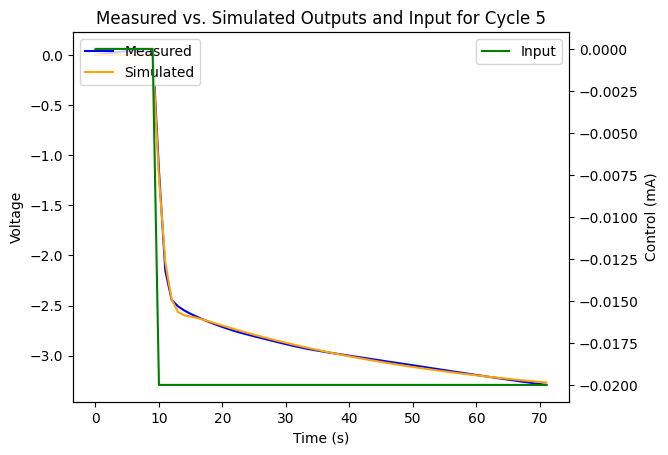

c:\Users\onyer\OneDrive\Desktop\Research work\Battery_Analysis1\env_analysis\Lib\site-packages\scipy\optimize\_lsq\common.py:115: RuntimeWarning: overflow encountered in power
  phi_prime = -np.sum(suf ** 2 / denom**3) / p_norm
c:\Users\onyer\OneDrive\Desktop\Research work\Battery_Analysis1\env_analysis\Lib\site-packages\scipy\optimize\_lsq\common.py:154: RuntimeWarning: divide by zero encountered in scalar divide
  ratio = phi / phi_prime
c:\Users\onyer\OneDrive\Desktop\Research work\Battery_Analysis1\env_analysis\Lib\site-packages\scipy\optimize\_lsq\common.py:166: RuntimeWarning: divide by zero encountered in scalar divide
  p *= Delta / norm(p)
c:\Users\onyer\OneDrive\Desktop\Research work\Battery_Analysis1\env_analysis\Lib\site-packages\scipy\optimize\_lsq\common.py:166: RuntimeWarning: invalid value encountered in multiply
  p *= Delta / norm(p)


Cycle 5: G_hat_box_jenkins
<TransferFunction>: sys[218041]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


      816.5 z^4 - 394.3 z^3 - 367.6 z^2
----------------------------------------------
z^4 + 11.65 z^3 - 16.35 z^2 + 4.584 z - 0.5652

dt = 0.005

Cycle 5: Zeros
[ 0.95457724+0.j -0.47163554+0.j  0.        +0.j  0.        +0.j]
Cycle 5: Poles
[-12.94324833+0.j           0.96817152+0.j
   0.16135517+0.13808763j   0.16135517-0.13808763j]


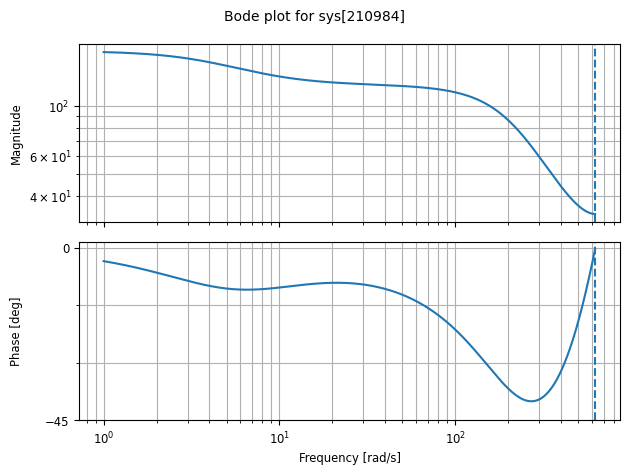

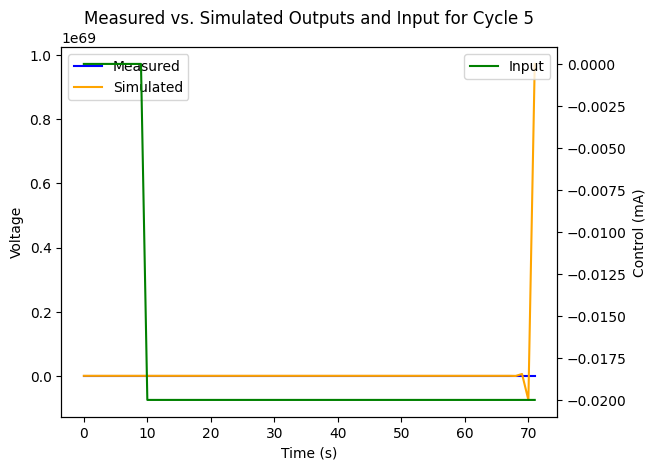

Cycle 102: G_hat_box_jenkins
<TransferFunction>: sys[218881]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


      20.51 z^3 - 17.66 z^2
----------------------------------
z^3 - 1.787 z^2 + 1.154 z - 0.3219

dt = 0.005

Cycle 102: Zeros
[0.86069978+0.j 0.        +0.j 0.        +0.j]
Cycle 102: Poles
[0.90372254+0.j         0.44146845+0.40168496j 0.44146845-0.40168496j]


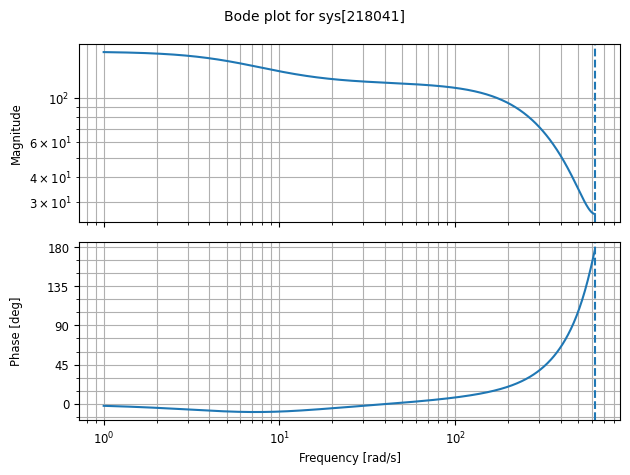

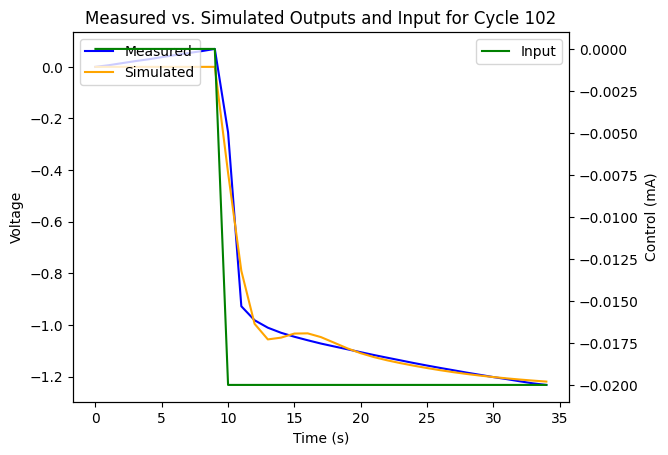

Cycle 126: G_hat_box_jenkins
<TransferFunction>: sys[219721]
Inputs (1): ['u[0]']
Outputs (1): ['y[0]']


       18.02 z^3 - 18.2 z^2
----------------------------------
z^3 - 2.178 z^2 + 1.583 z - 0.4094

dt = 0.005

Cycle 126: Zeros
[1.00966726+0.j 0.        +0.j 0.        +0.j]
Cycle 126: Poles
[1.01660165+0.j         0.58061785+0.25610672j 0.58061785-0.25610672j]


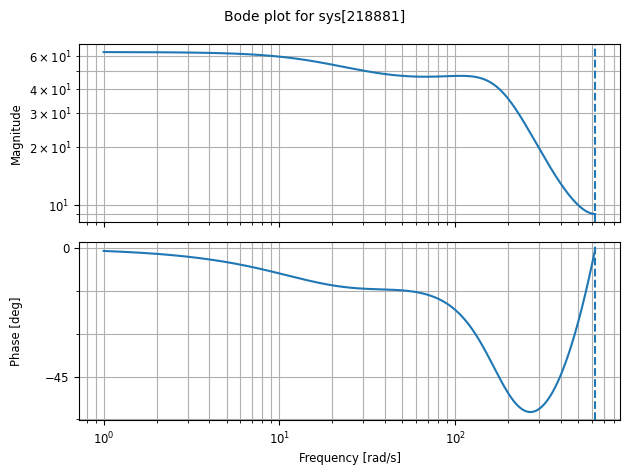

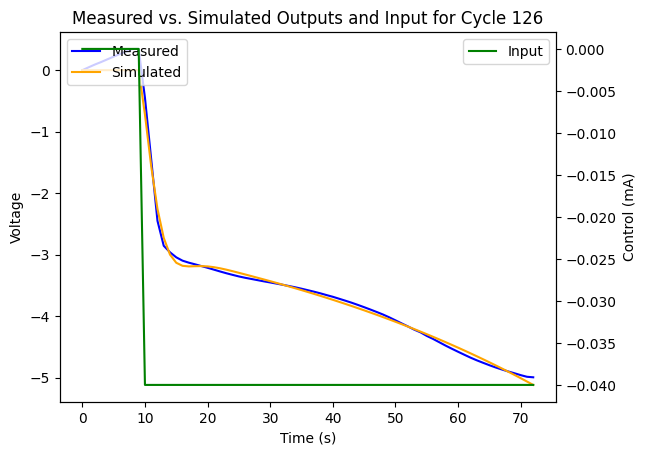

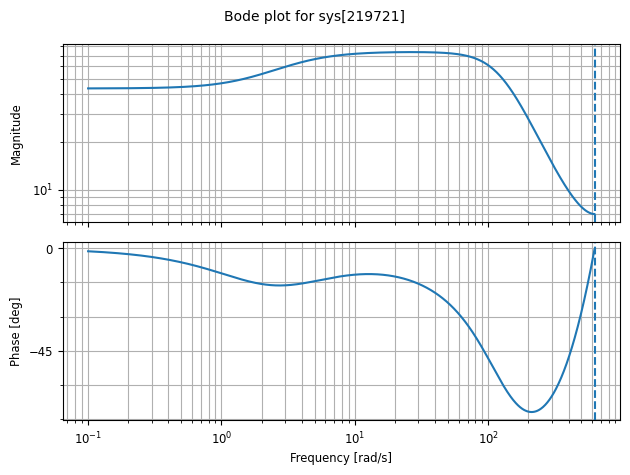

In [16]:
# Define sampling time
Ts = 0.005

# Function to process a single cycle
def process_cycle(cycle_num, nb, nf):
    nc = 0
    nd = 0
    na = nf
    nk = 0
    
    # Adjust input and output signals
    uu[cycle_num] = uu[cycle_num] - uu[cycle_num][0] * np.ones(len(uu[cycle_num]))
    yy[cycle_num] = yy[cycle_num] - yy[cycle_num][0] * np.ones(len(yy[cycle_num]))

    # Calculate the ARX model parameters
    n_arx = [nf, nb, nk]
    theta_arx = sid.V_arx_lin_reg(n_arx, yy[cycle_num], uu[cycle_num])
    
    # Prepare initial guess for Box-Jenkins model
    theta_box_jenkins = np.concatenate((
        theta_arx[n_arx[0]:np.sum(n_arx)], 
        np.zeros(nc + nd), 
        theta_arx[0:n_arx[0]]
    ))

    # Define the structure for the Box-Jenkins model
    n_bj = [nb, nc, nd, nf, nk]
    
    # Perform optimization
    optimization_results = sp.optimize.least_squares(
        sid.V_box_jenkins, 
        theta_box_jenkins, 
        jac=sid.jac_V_bj, 
        args=(n_bj, yy[cycle_num], uu[cycle_num])
    )
    
    # Extract the optimized parameters
    G_hat_box_jenkins, H_hat_box_jenkins = sid.theta_2_tf_box_jenkins(
        optimization_results.x, n_bj, Ts
    )
    
    # Print the transfer function, zeros, and poles
    print(f"Cycle {cycle_num}: G_hat_box_jenkins")
    print(G_hat_box_jenkins)
    print(f"Cycle {cycle_num}: Zeros")
    print(G_hat_box_jenkins.zeros())
    print(f"Cycle {cycle_num}: Poles")
    print(G_hat_box_jenkins.poles())
    
    # Simulate the system's response
    tt, y_sim = ct.forced_response(G_hat_box_jenkins, U=uu[cycle_num])
    
    # Plot measured vs. simulated output with input on a secondary y-axis
    fig, ax1 = plt.subplots()
    
    # Primary y-axis (left): Measured and Simulated outputs
    ax1.plot(yy[cycle_num], label='Measured', color='blue')
    ax1.plot(y_sim, label='Simulated', color='orange')
    ax1.set_xlabel('Time (s)')
    ax1.set_ylabel('Voltage')
    ax1.legend(loc='upper left')
    
    # Secondary y-axis (right): Input
    ax2 = ax1.twinx()
    ax2.plot(uu[cycle_num], label='Input', color='green')
    ax2.set_ylabel('Control (mA)')
    ax2.legend(loc='upper right')
    
    # Title
    plt.title(f'Measured vs. Simulated Outputs and Input for Cycle {cycle_num}')
    
    # Show plot
    plt.show()
    
    # Bode plot
    ct.bode_plot(G_hat_box_jenkins)

# Process cycle 5 with nb=2, nf=3 (2nd order model)
process_cycle(5, nb=2, nf=3)

# Process cycle 5 with nb=3, nf=4 (better fit)
process_cycle(5, nb=3, nf=4)

# Process cycle 102 with nb=2, nf=3 (showing degradation)
process_cycle(102, nb=2, nf=3)

# Process cycle 126 (unstable model fit)
process_cycle(126, nb=2, nf=3)
